## Working for Cross-Border Indicators 
- C02 Emissions Embodied in Final Domestic Demand
- C02 Emissions Embodied in Gross Exports
- C02 Emissions Embodied in Gross Imports
- C02 Emissions Embodied in Production

In [83]:
import pandas as pd
import requests
import numpy as np
import warnings
from matplotlib import pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import explained_variance_score,max_error,mean_absolute_error,mean_squared_error,r2_score
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPRegressor 
warnings.filterwarnings('ignore')
pd.options.display.float_format = "{:.2f}".format
import plotly.graph_objects as go

In [84]:
#resp = requests.get('https://services9.arcgis.com/weJ1QsnbMYJlCHdG/arcgis/rest/services/Indicator_8_Direct_investment_related_Indicators/FeatureServer/0/query?outFields=*&where=1%3D1&f=geojson')

In [3]:
resp = requests.get('https://services9.arcgis.com/weJ1QsnbMYJlCHdG/arcgis/rest/services/Indicator_7_1_Trade_related_Indicators_CO2_emissions_embodied_in_trade/FeatureServer/0/query?outFields=*&where=1%3D1&f=geojson')
txt = resp.json()
Basic_df = pd.DataFrame(txt['features'])
basic_list = Basic_df['properties'].values.tolist()
Actual_df = pd.DataFrame(basic_list)
Actual_df.head(5)

,ObjectId,Country,ISO2,ISO3,Indicator,Code,Unit,F2005,F2006,F2007,...,F2010,F2011,F2012,F2013,F2014,F2015,F2016,F2017,F2018,F2019
0,1,Argentina,AR,ARG,"C02 Emissions Embodied in Final Demand, balance",ECBPDTCEFDB,Millions of metric tons,11.10,8.05,1.59,...,-5.80,-13.37,-13.55,-20.51,-14.60,-21.00,NaN,NaN,NaN,NaN
1,2,Argentina,AR,ARG,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,141.18,153.44,166.89,...,183.06,198.55,203.19,205.33,203.33,216.03,NaN,NaN,NaN,NaN
2,3,Argentina,AR,ARG,C02 Emissions Embodied in Gross Exports,ECBPDTCETX,Millions of metric tons,39.18,40.23,39.51,...,34.34,34.41,30.52,26.57,27.17,21.29,NaN,NaN,NaN,NaN
3,4,Argentina,AR,ARG,"C02 Emissions Embodied in Gross Exports, balance",ECBPDTCETB,Millions of metric tons,11.04,7.99,1.53,...,-5.80,-13.37,-13.54,-20.49,-14.59,-20.95,NaN,NaN,NaN,NaN
4,5,Argentina,AR,ARG,C02 Emissions Embodied in Gross Imports,ECBPDTCETM,Millions of metric tons,28.14,32.24,37.97,...,40.14,47.78,44.06,47.05,41.76,42.24,NaN,NaN,NaN,NaN


In [4]:
Actual_df.to_csv("working on.csv")

In [5]:
Actual_df.shape

(396, 22)

In [6]:
Actual_df.isnull().sum()

ObjectId       0
Country        0
ISO2          12
ISO3           0
Indicator      0
Code           0
Unit           0
F2005          0
F2006          0
F2007          0
F2008          0
F2009          0
F2010          0
F2011          0
F2012          0
F2013          0
F2014          0
F2015          0
F2016        225
F2017        225
F2018        225
F2019        225
dtype: int64

In [7]:
Actual_df['Indicator'].unique()

array(['C02 Emissions Embodied in Final Demand, balance',
       'C02 Emissions Embodied in Final Domestic Demand',
       'C02 Emissions Embodied in Gross Exports',
       'C02 Emissions Embodied in Gross Exports, balance',
       'C02 Emissions Embodied in Gross Imports',
       'C02 Emissions Embodied in Production'], dtype=object)

### Working for C02 Emissions Embodied in Final Domestic Demand

In [8]:
CO2_FINAL_DF=Actual_df[Actual_df['Indicator']=='C02 Emissions Embodied in Final Domestic Demand']

In [9]:
CO2_FINAL_DF.head()

,ObjectId,Country,ISO2,ISO3,Indicator,Code,Unit,F2005,F2006,F2007,...,F2010,F2011,F2012,F2013,F2014,F2015,F2016,F2017,F2018,F2019
1,2,Argentina,AR,ARG,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,141.18,153.44,166.89,...,183.06,198.55,203.19,205.33,203.33,216.03,NaN,NaN,NaN,NaN
7,8,Australia,AU,AUS,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,418.42,420.98,444.59,...,446.21,450.35,469.37,448.02,423.10,426.40,NaN,NaN,NaN,NaN
13,14,Austria,AT,AUT,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,95.26,95.39,94.53,...,89.74,90.34,86.19,86.53,82.95,83.44,NaN,NaN,NaN,NaN
19,20,Belgium,BE,BEL,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,131.71,129.89,129.69,...,127.70,122.48,117.93,117.66,112.33,117.83,NaN,NaN,NaN,NaN
25,26,Brazil,BR,BRA,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,312.82,330.87,363.68,...,458.99,486.29,510.59,542.57,555.96,475.38,NaN,NaN,NaN,NaN


In [10]:
CO2_FINAL_DF.shape

(66, 22)

In [11]:
CO2_FINAL_DF.columns

Index(['ObjectId', 'Country', 'ISO2', 'ISO3', 'Indicator', 'Code', 'Unit',
       'F2005', 'F2006', 'F2007', 'F2008', 'F2009', 'F2010', 'F2011', 'F2012',
       'F2013', 'F2014', 'F2015', 'F2016', 'F2017', 'F2018', 'F2019'],
      dtype='object')

In [12]:
CO2_FINAL_DF.isnull().sum()

ObjectId      0
Country       0
ISO2          2
ISO3          0
Indicator     0
Code          0
Unit          0
F2005         0
F2006         0
F2007         0
F2008         0
F2009         0
F2010         0
F2011         0
F2012         0
F2013         0
F2014         0
F2015         0
F2016        66
F2017        66
F2018        66
F2019        66
dtype: int64

### Hence the values are not available for each country for year 2016-2019

## selction of relevent columns

In [13]:
CO2_FINAL_DF_FINAL=CO2_FINAL_DF[['Country','F2005', 'F2006', 'F2007', 'F2008', 'F2009', 'F2010', 'F2011', 'F2012',
       'F2013', 'F2014', 'F2015']]

In [14]:
CO2_FINAL_DF_FINAL.head()

,Country,F2005,F2006,F2007,F2008,F2009,F2010,F2011,F2012,F2013,F2014,F2015
1,Argentina,141.18,153.44,166.89,179.93,167.85,183.06,198.55,203.19,205.33,203.33,216.03
7,Australia,418.42,420.98,444.59,441.38,434.03,446.21,450.35,469.37,448.02,423.10,426.40
13,Austria,95.26,95.39,94.53,92.34,86.54,89.74,90.34,86.19,86.53,82.95,83.44
19,Belgium,131.71,129.89,129.69,137.20,128.67,127.70,122.48,117.93,117.66,112.33,117.83
25,Brazil,312.82,330.87,363.68,410.89,385.40,458.99,486.29,510.59,542.57,555.96,475.38


In [15]:
CO2_FINAL_DF_FINAL=CO2_FINAL_DF_FINAL.T
CO2_FINAL_DF_FINAL.columns=CO2_FINAL_DF_FINAL.iloc[0]
CO2_FINAL_DF_FINAL=CO2_FINAL_DF_FINAL.iloc[1:]

In [16]:
CO2_FINAL_DF_FINAL.head()

Country,Argentina,Australia,Austria,Belgium,Brazil,Brunei Darussalam,Bulgaria,Cambodia,Canada,Chile,...,Sweden,Switzerland,Taiwan Province of China,Thailand,Tunisia,Turkey,United Kingdom,United States,Vietnam,World
F2005,141.18,418.42,95.26,131.71,312.82,4.08,39.27,6.16,539.81,61.15,...,82.66,92.42,235.15,196.76,21.6,281.6,737.36,6798.77,78.15,27069.6
F2006,153.44,420.98,95.39,129.89,330.87,5.74,42.33,6.64,553.83,65.12,...,86.17,94.04,242.15,192.62,22.32,309.11,751.51,6741.17,81.58,27924.3
F2007,166.89,444.59,94.53,129.69,363.68,6.36,46.07,7.23,579.08,71.81,...,86.24,92.53,230.72,195.25,23.02,339.3,749.3,6714.57,96.4,28979.7
F2008,179.93,441.38,92.34,137.2,410.89,5.54,45.71,7.04,570.42,79.94,...,82.49,95.08,223.91,209.03,24.18,334.4,697.83,6393.67,106.85,29202.9
F2009,167.85,434.03,86.54,128.67,385.4,6.08,39.56,7.69,530.4,70.01,...,71.74,97.2,207.12,196.47,24.01,299.31,616.99,5873.2,112.55,28815.2


## 3 Models are used for the purpose 
- 1- Linear Regression
- 2- Random Forest Regression
- 3- MLP

### Linear Regression

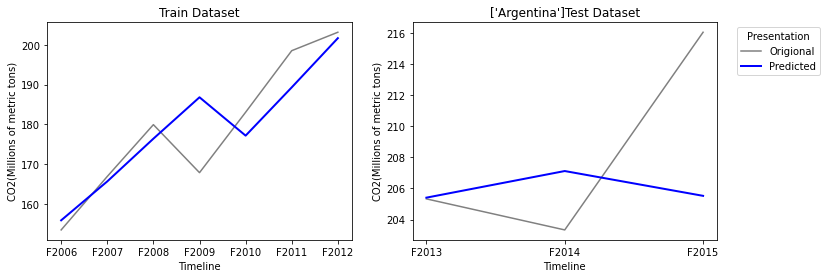

Origional Values:  [array([205.328], dtype=object), array([203.334], dtype=object), array([216.033], dtype=object)]
Predicted Values:  [[205.40652461]
 [207.11672765]
 [205.52320201]]
Explained Variance Score: -0.17964816561064967
        Maximam Error   : 10.50979798706851
    Mean Absolute Error : 4.79035008201032
    Mean Squared Error  : 41.59034943842105
         r2 score       : -0.33760817707871804


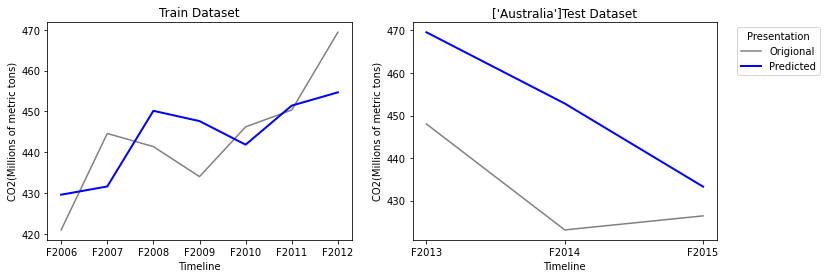

Origional Values:  [array([448.017], dtype=object), array([423.099], dtype=object), array([426.401], dtype=object)]
Predicted Values:  [[469.58687023]
 [452.8302721 ]
 [433.27698409]]
Explained Variance Score: 0.2676633239331133
        Maximam Error   : 29.731272102026367
    Mean Absolute Error : 19.39237547464802
    Mean Squared Error  : 465.49566663328915
         r2 score       : -2.8118535149075923


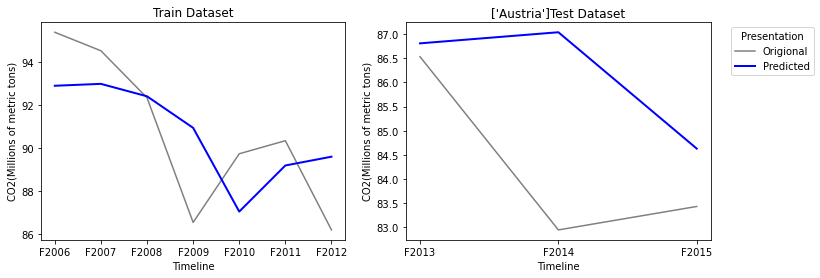

Origional Values:  [array([86.533], dtype=object), array([82.95], dtype=object), array([83.435], dtype=object)]
Predicted Values:  [[86.80958233]
 [87.03928856]
 [84.63274638]]
Explained Variance Score: -0.047443147503038796
        Maximam Error   : 4.0892885644208405
    Mean Absolute Error : 1.8545390920710219
    Mean Squared Error  : 6.077791712694474
         r2 score       : -1.4128095728706214


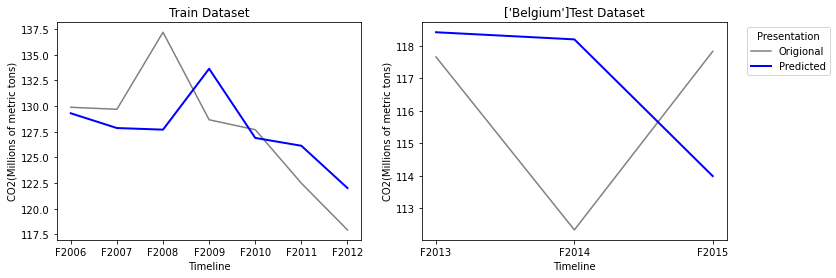

Origional Values:  [array([117.656], dtype=object), array([112.33], dtype=object), array([117.828], dtype=object)]
Predicted Values:  [[118.41666769]
 [118.19695553]
 [113.98764998]]
Explained Variance Score: -1.4132718495978955
        Maximam Error   : 5.866955532529985
    Mean Absolute Error : 3.4893244151556786
    Mean Squared Error  : 16.582690286951067
         r2 score       : -1.545792829052675


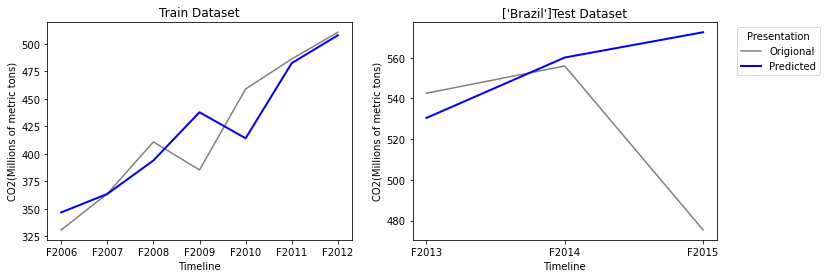

Origional Values:  [array([542.574], dtype=object), array([555.957], dtype=object), array([475.385], dtype=object)]
Predicted Values:  [[530.40701967]
 [560.10468644]
 [572.5302437 ]]
Explained Variance Score: -0.8652920324972373
        Maximam Error   : 97.14524369674609
    Mean Absolute Error : 37.81997015483429
    Mean Squared Error  : 3200.8123619899943
         r2 score       : -1.5754585256655398


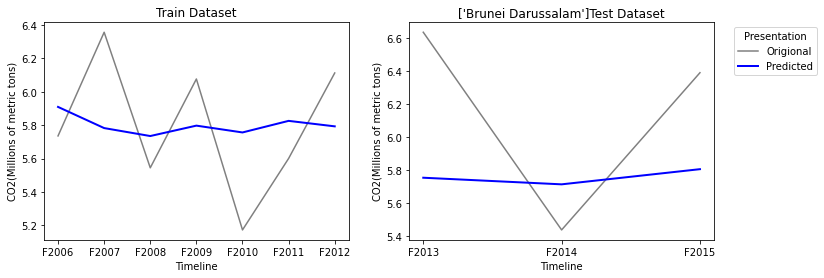

Origional Values:  [array([6.635], dtype=object), array([5.438], dtype=object), array([6.39], dtype=object)]
Predicted Values:  [[5.75405002]
 [5.71399662]
 [5.80584321]]
Explained Variance Score: 0.0969775221468141
        Maximam Error   : 0.8809499798157736
    Mean Absolute Error : 0.5803677994299488
    Mean Squared Error  : 0.39782872136462144
         r2 score       : -0.49239372319624497


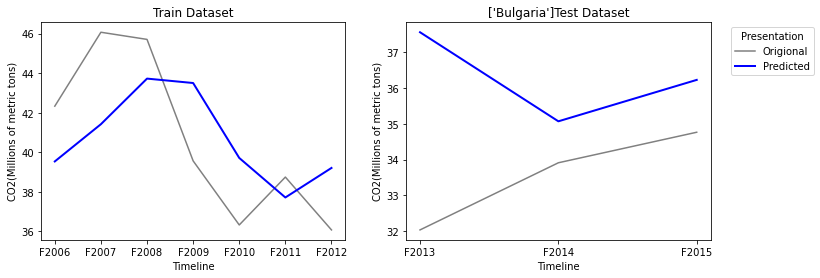

Origional Values:  [array([32.037], dtype=object), array([33.911], dtype=object), array([34.763], dtype=object)]
Predicted Values:  [[37.55389468]
 [35.06812267]
 [36.22403749]]
Explained Variance Score: -2.0465671809372195
        Maximam Error   : 5.516894678062442
    Mean Absolute Error : 2.7116849455158154
    Mean Squared Error  : 11.303230102479596
         r2 score       : -7.717998655765086


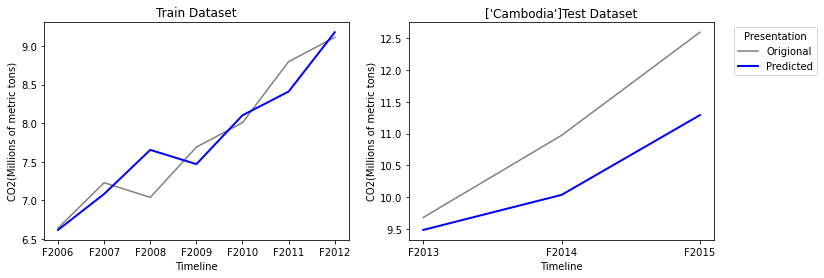

Origional Values:  [array([9.679], dtype=object), array([10.972], dtype=object), array([12.595], dtype=object)]
Predicted Values:  [[ 9.48245083]
 [10.0343093 ]
 [11.29056456]]
Explained Variance Score: 0.8507924578832489
        Maximam Error   : 1.3044354407228607
    Mean Absolute Error : 0.8128917705120262
    Mean Squared Error  : 0.8731490839028321
         r2 score       : 0.38650004714442276


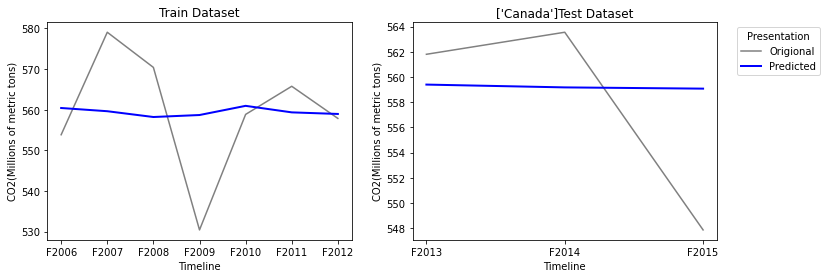

Origional Values:  [array([561.804], dtype=object), array([563.554], dtype=object), array([547.864], dtype=object)]
Predicted Values:  [[559.3996331 ]
 [559.17667259]
 [559.07781754]]
Explained Variance Score: 0.02509429044260958
        Maximam Error   : 11.213817538403987
    Mean Absolute Error : 5.99850394889783
    Mean Squared Error  : 50.23055973897269
         r2 score       : -0.019191981757592735


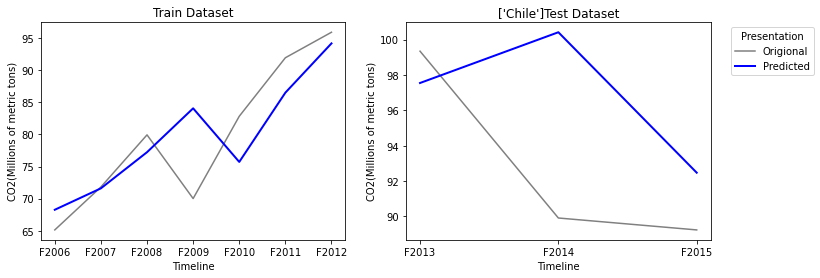

Origional Values:  [array([99.348], dtype=object), array([89.911], dtype=object), array([89.237], dtype=object)]
Predicted Values:  [[ 97.54843014]
 [100.41933611]
 [ 92.47425117]]
Explained Variance Score: -0.1980730116619578
        Maximam Error   : 10.508336105062313
    Mean Absolute Error : 5.181719046487875
    Mean Squared Error  : 41.38112484466537
         r2 score       : -0.9423343967744306


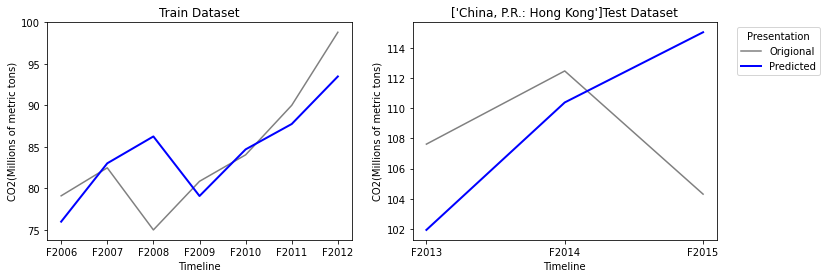

Origional Values:  [array([107.616], dtype=object), array([112.459], dtype=object), array([104.308], dtype=object)]
Predicted Values:  [[101.94026931]
 [110.37514545]
 [115.02089834]]
Explained Variance Score: -3.4155285179521773
        Maximam Error   : 10.71289833955663
    Mean Absolute Error : 6.157494525629555
    Mean Squared Error  : 50.44085315466126
         r2 score       : -3.502025712601432


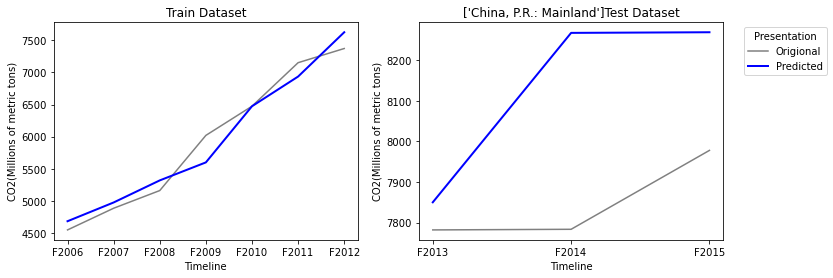

Origional Values:  [array([7782.052], dtype=object), array([7783.586], dtype=object), array([7977.936], dtype=object)]
Predicted Values:  [[7850.04154327]
 [8267.31290898]
 [8268.87434684]]
Explained Variance Score: -2.410752902215053
        Maximam Error   : 483.72690897886514
    Mean Absolute Error : 280.8849330288037
    Mean Squared Error  : 107753.14070852748
         r2 score       : -11.73597210103376


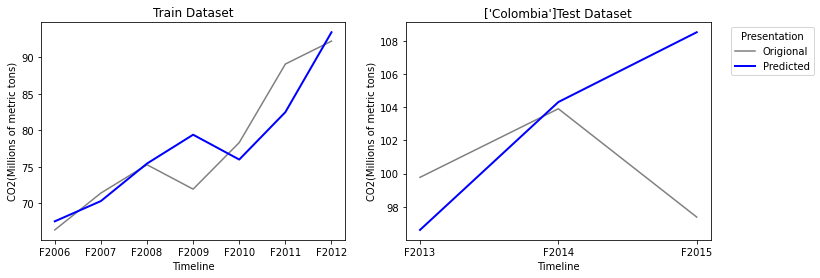

Origional Values:  [array([99.774], dtype=object), array([103.908], dtype=object), array([97.378], dtype=object)]
Predicted Values:  [[ 96.60370542]
 [104.31379702]
 [108.52096686]]
Explained Variance Score: -4.085324537420509
        Maximam Error   : 11.142966856390956
    Mean Absolute Error : 4.906352818766895
    Mean Squared Error  : 44.79371643425021
         r2 score       : -5.157524859121542


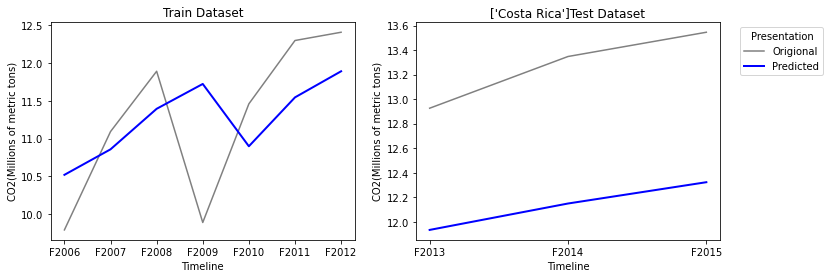

Origional Values:  [array([12.926], dtype=object), array([13.348], dtype=object), array([13.546], dtype=object)]
Predicted Values:  [[11.93275053]
 [12.14826048]
 [12.32215187]]
Explained Variance Score: 0.8397922062904569
        Maximam Error   : 1.2238481307520193
    Mean Absolute Error : 1.1389457091721737
    Mean Squared Error  : 1.3079078958840953
         r2 score       : -18.56357956774421


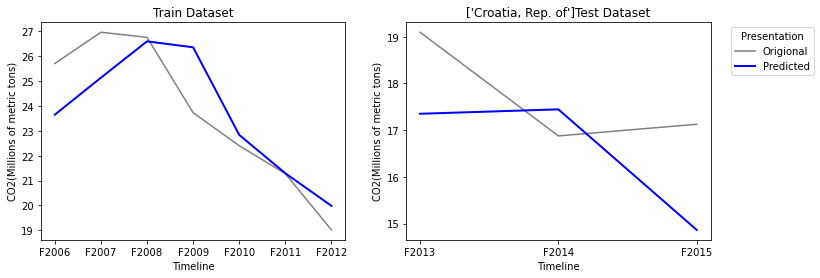

Origional Values:  [array([19.095], dtype=object), array([16.877], dtype=object), array([17.126], dtype=object)]
Predicted Values:  [[17.35076803]
 [17.4449738 ]
 [14.86536395]]
Explained Variance Score: -0.5368317297556462
        Maximam Error   : 2.260636051772977
    Mean Absolute Error : 1.5242806072244501
    Mean Squared Error  : 2.825138257061019
         r2 score       : -1.8702697406248872


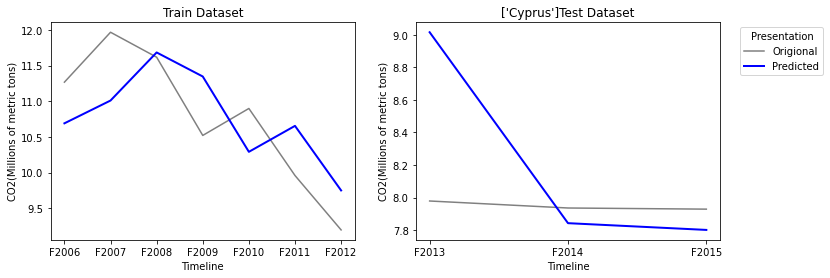

Origional Values:  [array([7.979], dtype=object), array([7.936], dtype=object), array([7.929], dtype=object)]
Predicted Values:  [[9.01493671]
 [7.84287707]
 [7.80146494]]
Explained Variance Score: -596.9141453646688
        Maximam Error   : 1.0359367105017698
    Mean Absolute Error : 0.4188648978228926
    Mean Squared Error  : 0.36603397943163013
         r2 score       : -748.0463426295313


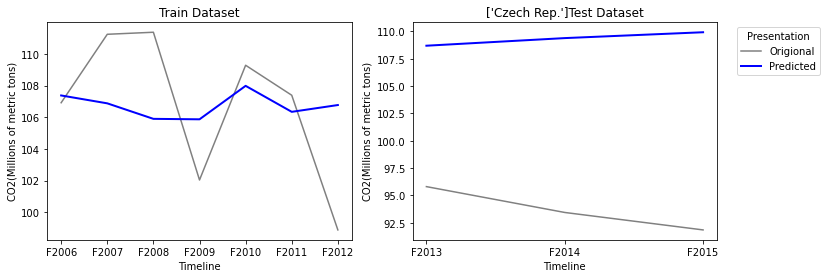

Origional Values:  [array([95.808], dtype=object), array([93.444], dtype=object), array([91.848], dtype=object)]
Predicted Values:  [[108.69415367]
 [109.39026315]
 [109.92576683]]
Explained Variance Score: -0.7155766907018415
        Maximam Error   : 18.07776683357281
    Mean Absolute Error : 15.636727882739445
    Mean Squared Error  : 249.0473061346605
         r2 score       : -93.10909825642523


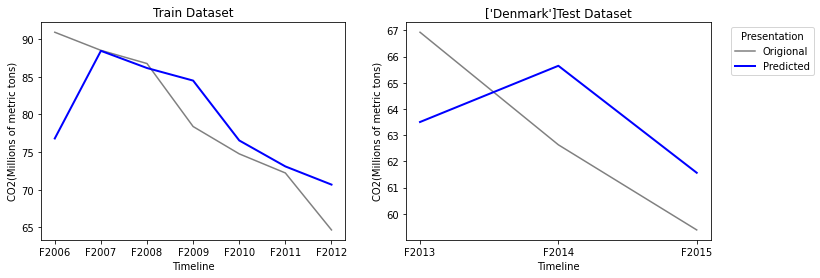

Origional Values:  [array([66.926], dtype=object), array([62.631], dtype=object), array([59.383], dtype=object)]
Predicted Values:  [[63.50081541]
 [65.64590747]
 [61.56386476]]
Explained Variance Score: 0.14314462900479497
        Maximam Error   : 3.425184588933327
    Mean Absolute Error : 2.8736522733949266
    Mean Squared Error  : 8.525909207927894
         r2 score       : 0.10664611570695182


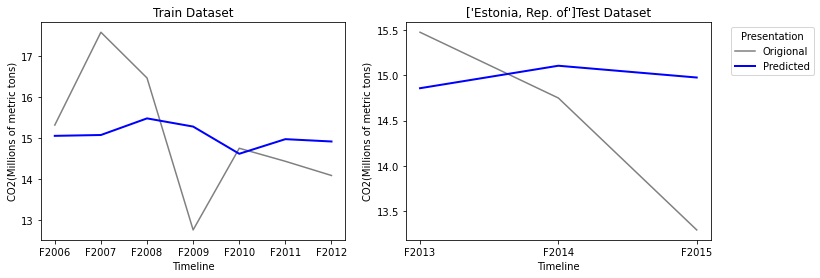

Origional Values:  [array([15.476], dtype=object), array([14.749], dtype=object), array([13.291], dtype=object)]
Predicted Values:  [[14.85728442]
 [15.10576271]
 [14.97561594]]
Explained Variance Score: -0.07963502215669793
        Maximam Error   : 1.68461594283281
    Mean Absolute Error : 0.8866980788431166
    Mean Squared Error  : 1.1160064923590205
         r2 score       : -0.35209451349935206


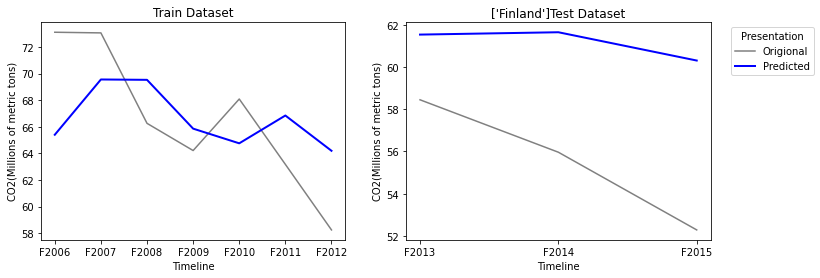

Origional Values:  [array([58.446], dtype=object), array([55.964], dtype=object), array([52.286], dtype=object)]
Predicted Values:  [[61.53283467]
 [61.64400015]
 [60.30461799]]
Explained Variance Score: 0.36640913979113177
        Maximam Error   : 8.018617986067952
    Mean Absolute Error : 5.595150935896605
    Mean Squared Error  : 35.36306146987139
         r2 score       : -4.522256271528982


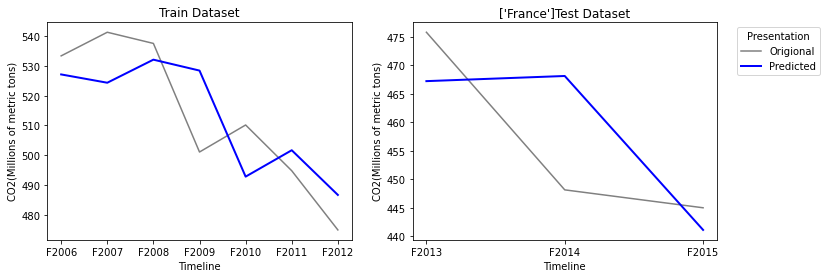

Origional Values:  [array([475.829], dtype=object), array([448.16], dtype=object), array([445.014], dtype=object)]
Predicted Values:  [[467.2462545 ]
 [468.14962528]
 [441.12760763]]
Explained Variance Score: 0.18349468796633173
        Maximam Error   : 19.989625283544285
    Mean Absolute Error : 10.819587719573576
    Mean Squared Error  : 162.78422834299548
         r2 score       : 0.15070826478349542


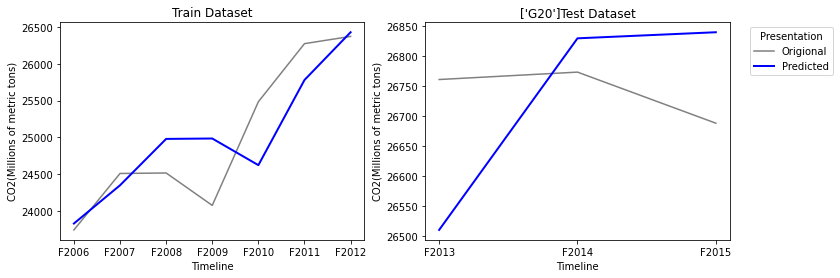

Origional Values:  [array([26760.591], dtype=object), array([26772.893], dtype=object), array([26687.974], dtype=object)]
Predicted Values:  [[26510.50346801]
 [26829.09465804]
 [26839.20188268]]
Explained Variance Score: -19.88486841679963
        Maximam Error   : 250.0875319948791
    Mean Absolute Error : 152.50569090747013
    Mean Squared Error  : 29524.090842353082
         r2 score       : -20.028880159430624


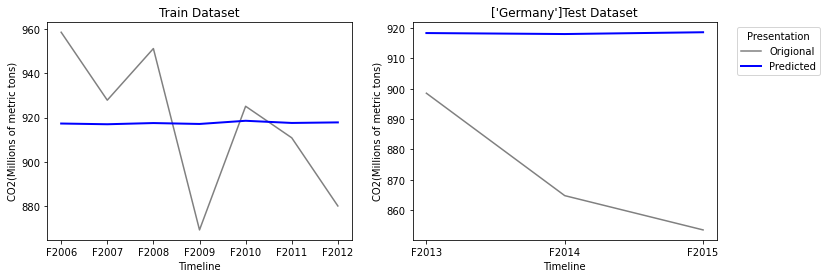

Origional Values:  [array([898.539], dtype=object), array([864.752], dtype=object), array([853.444], dtype=object)]
Predicted Values:  [[918.38915785]
 [918.06407854]
 [918.65617851]]
Explained Variance Score: -0.004854441246785246
        Maximam Error   : 65.2121785143288
    Mean Absolute Error : 46.124804966686305
    Mean Squared Error  : 2496.2782371038065
         r2 score       : -5.801866059899281


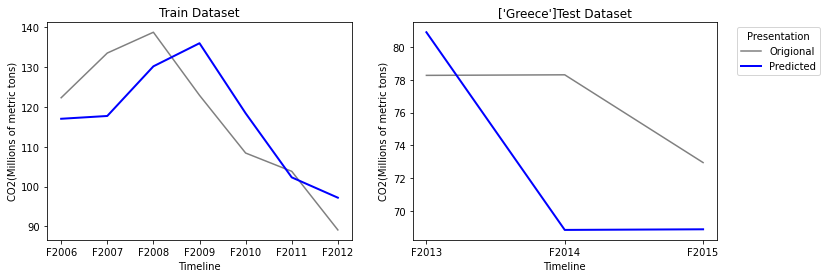

Origional Values:  [array([78.272], dtype=object), array([78.306], dtype=object), array([72.95], dtype=object)]
Predicted Values:  [[80.90384929]
 [68.84041137]
 [68.87816861]]
Explained Variance Score: -2.865529970613938
        Maximam Error   : 9.465588625258434
    Mean Absolute Error : 5.389756432229234
    Mean Squared Error  : 37.70126984004797
         r2 score       : -4.951623378389537


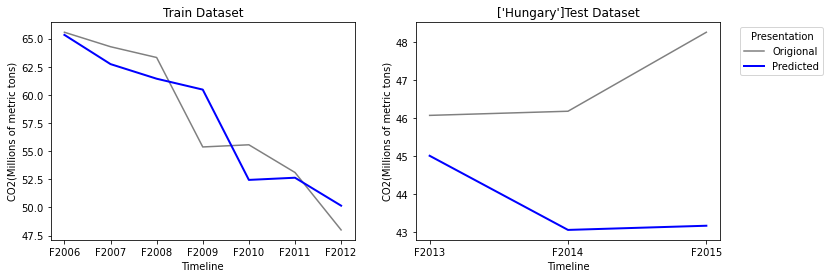

Origional Values:  [array([46.072], dtype=object), array([46.181], dtype=object), array([48.26], dtype=object)]
Predicted Values:  [[45.00908893]
 [43.05774279]
 [43.16777731]]
Explained Variance Score: -1.670316752995229
        Maximam Error   : 5.092222692903874
    Mean Absolute Error : 3.0927969916844993
    Mean Squared Error  : 12.271749173070058
         r2 score       : -11.108332427882837


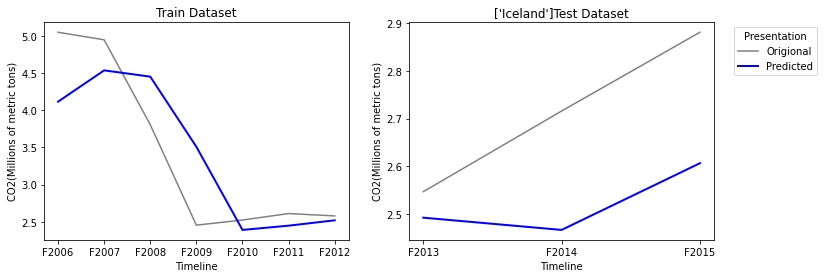

Origional Values:  [array([2.547], dtype=object), array([2.716], dtype=object), array([2.881], dtype=object)]
Predicted Values:  [[2.49259094]
 [2.46695421]
 [2.60671572]]
Explained Variance Score: 0.48091006291283844
        Maximam Error   : 0.2742842828744907
    Mean Absolute Error : 0.1925797129288466
    Mean Squared Error  : 0.04673867341531692
         r2 score       : -1.5137028405173427


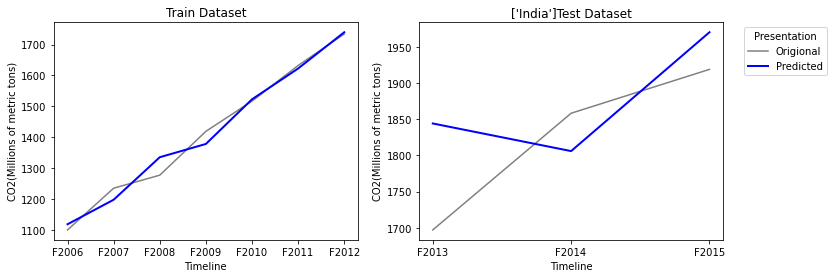

Origional Values:  [array([1696.941], dtype=object), array([1858.186], dtype=object), array([1918.813], dtype=object)]
Predicted Values:  [[1844.05459448]
 [1805.88446312]
 [1970.13796133]]
Explained Variance Score: 0.24362212060746513
        Maximam Error   : 147.113594480988
    Mean Absolute Error : 83.58003089746983
    Mean Squared Error  : 9004.037365600214
         r2 score       : -0.027040480568370162


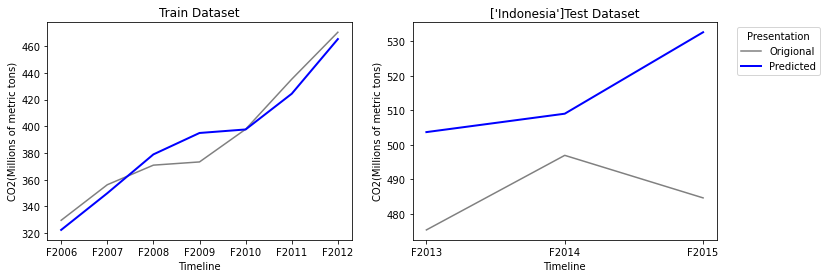

Origional Values:  [array([475.289], dtype=object), array([496.938], dtype=object), array([484.588], dtype=object)]
Predicted Values:  [[503.68854064]
 [509.03185888]
 [532.68295202]]
Explained Variance Score: -1.7553162460194316
        Maximam Error   : 48.09495202014324
    Mean Absolute Error : 29.529450510915183
    Mean Squared Error  : 1088.639913566763
         r2 score       : -12.845035503554957


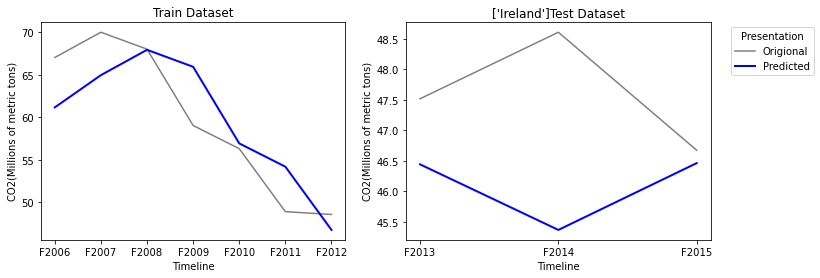

Origional Values:  [array([47.516], dtype=object), array([48.607], dtype=object), array([46.672], dtype=object)]
Predicted Values:  [[46.44131261]
 [45.36618918]
 [46.46138961]]
Explained Variance Score: -1.5892054995278895
        Maximam Error   : 3.240810817766011
    Mean Absolute Error : 1.5087028685427721
    Mean Squared Error  : 3.9007214968119777
         r2 score       : -5.217013592961821


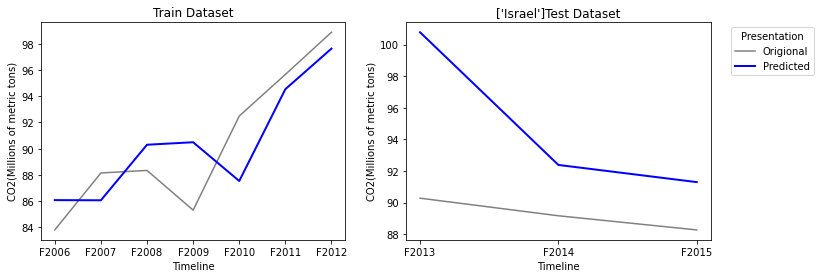

Origional Values:  [array([90.278], dtype=object), array([89.165], dtype=object), array([88.27], dtype=object)]
Predicted Values:  [[100.77582907]
 [ 92.38072697]
 [ 91.29487588]]
Explained Variance Score: -16.936925508925682
        Maximam Error   : 10.497829070925746
    Mean Absolute Error : 5.579477304595419
    Mean Squared Error  : 43.23172973102598
         r2 score       : -63.08014936766146


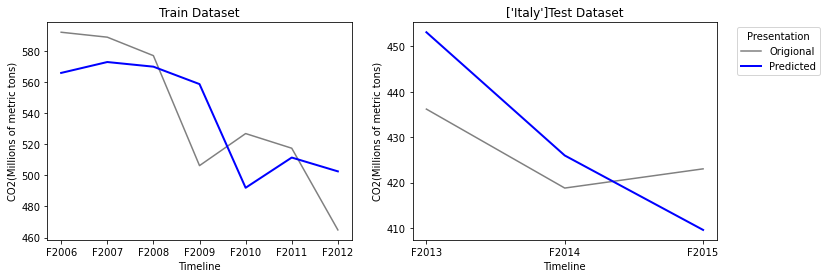

Origional Values:  [array([436.164], dtype=object), array([418.783], dtype=object), array([423.012], dtype=object)]
Predicted Values:  [[453.08232126]
 [425.95496885]
 [409.56919952]]
Explained Variance Score: -1.9247030134538132
        Maximam Error   : 16.9183212596605
    Mean Absolute Error : 12.511030194754653
    Mean Squared Error  : 172.79187203015167
         r2 score       : -2.154679751758699


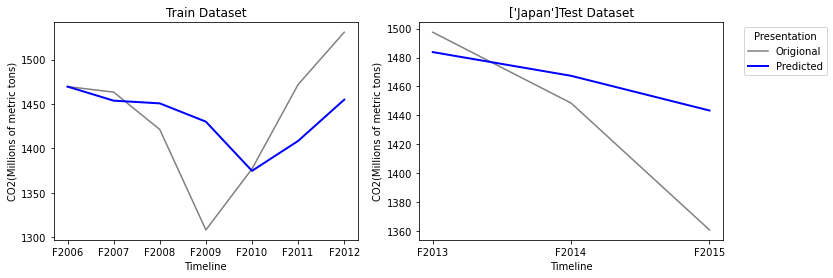

Origional Values:  [array([1497.445], dtype=object), array([1448.543], dtype=object), array([1361.019], dtype=object)]
Predicted Values:  [[1483.74325614]
 [1467.37606372]
 [1443.42739541]]
Explained Variance Score: 0.49980670657018234
        Maximam Error   : 82.40839540930642
    Mean Absolute Error : 38.31440099663473
    Mean Squared Error  : 2444.521902621587
         r2 score       : 0.23246000327142857


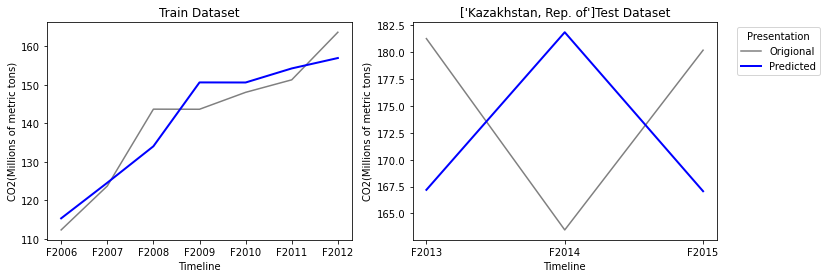

Origional Values:  [array([181.262], dtype=object), array([163.473], dtype=object), array([180.186], dtype=object)]
Predicted Values:  [[167.19836087]
 [181.85315413]
 [167.07038593]]
Explained Variance Score: -2.426665782206629
        Maximam Error   : 18.380154132145606
    Mean Absolute Error : 15.186469111512062
    Mean Squared Error  : 235.87844799777758
         r2 score       : -2.556369529824089


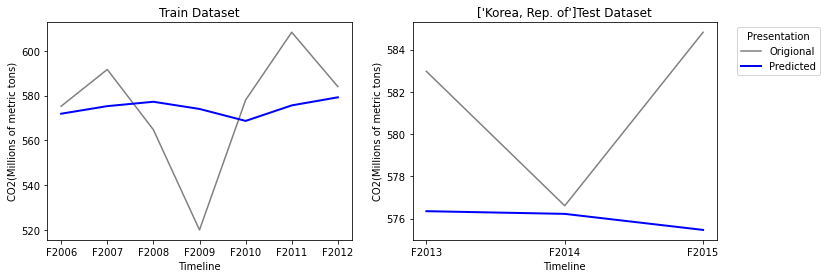

Origional Values:  [array([582.966], dtype=object), array([576.605], dtype=object), array([584.818], dtype=object)]
Predicted Values:  [[576.34744124]
 [576.22005817]
 [575.46065448]]
Explained Variance Score: -0.1393621985092497
        Maximam Error   : 9.357345517228055
    Mean Absolute Error : 5.453615369512704
    Mean Squared Error  : 43.83780512904712
         r2 score       : -2.543384448256002


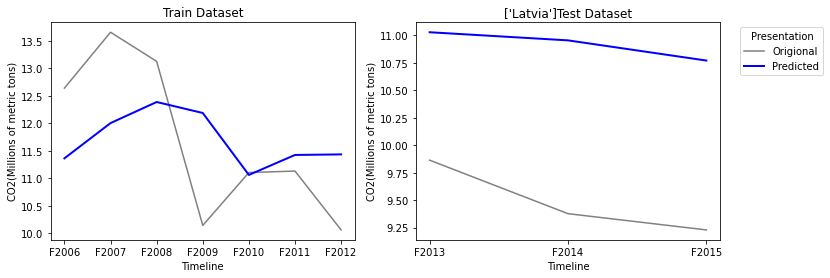

Origional Values:  [array([9.864], dtype=object), array([9.377], dtype=object), array([9.229], dtype=object)]
Predicted Values:  [[11.02926731]
 [10.95529758]
 [10.77150547]]
Explained Variance Score: 0.5256157873651193
        Maximam Error   : 1.5782975837535531
    Mean Absolute Error : 1.4286901189701482
    Mean Squared Error  : 2.076064757738454
         r2 score       : -27.211745799694416


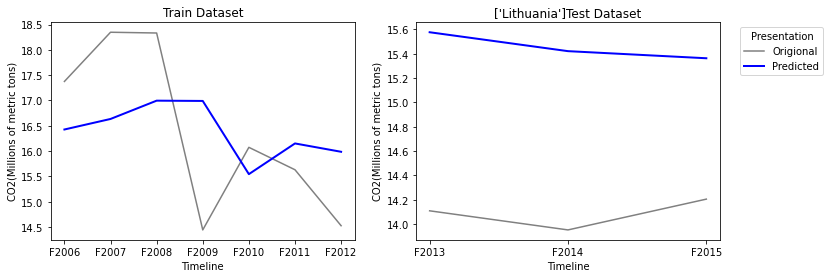

Origional Values:  [array([14.109], dtype=object), array([13.952], dtype=object), array([14.205], dtype=object)]
Predicted Values:  [[15.57633502]
 [15.4209471 ]
 [15.3625837 ]]
Explained Variance Score: -0.9708569259907125
        Maximam Error   : 1.4689471028688317
    Mean Absolute Error : 1.3646219407393143
    Mean Squared Error  : 1.883625891233179
         r2 score       : -172.2087481976684


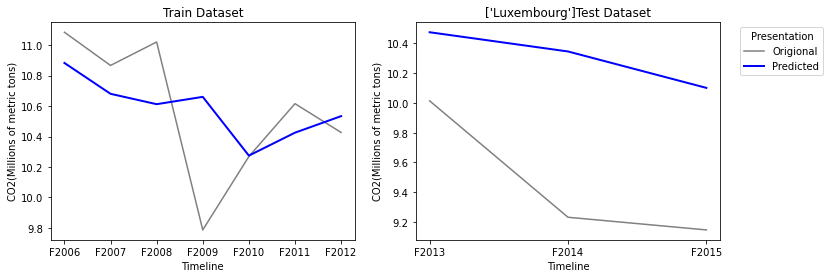

Origional Values:  [array([10.014], dtype=object), array([9.232], dtype=object), array([9.147], dtype=object)]
Predicted Values:  [[10.47499441]
 [10.3458495 ]
 [10.10131848]]
Explained Variance Score: 0.4928347225340687
        Maximam Error   : 1.1138495048146133
    Mean Absolute Error : 0.8430541305050264
    Mean Squared Error  : 0.7879667745749034
         r2 score       : -4.17476965114375


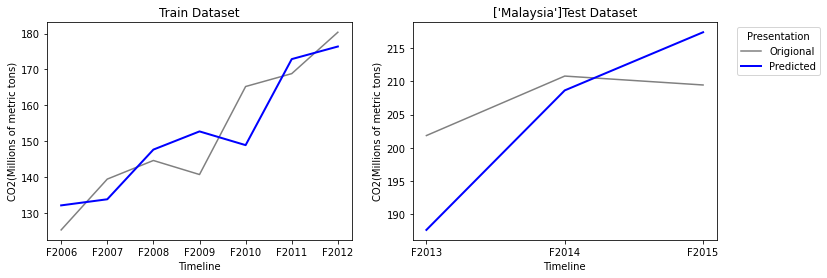

Origional Values:  [array([201.847], dtype=object), array([210.804], dtype=object), array([209.462], dtype=object)]
Predicted Values:  [[187.63979925]
 [208.64792305]
 [217.40285558]]
Explained Variance Score: -4.268744726711009
        Maximam Error   : 14.207200750210063
    Mean Absolute Error : 8.101377760256847
    Mean Squared Error  : 89.8501361078378
         r2 score       : -4.775377314941789


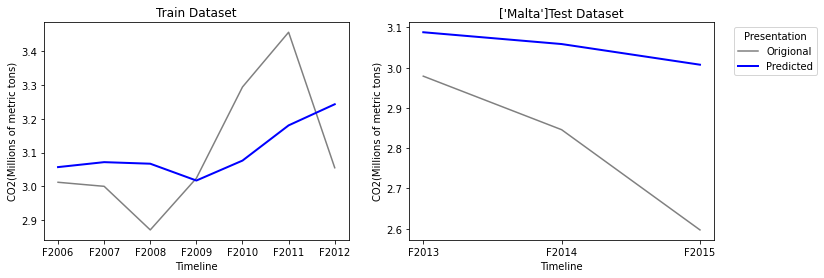

Origional Values:  [array([2.979], dtype=object), array([2.846], dtype=object), array([2.597], dtype=object)]
Predicted Values:  [[3.08815242]
 [3.05882352]
 [3.00749793]]
Explained Variance Score: 0.3766699471475775
        Maximam Error   : 0.410497933138108
    Mean Absolute Error : 0.24415795811711508
    Mean Squared Error  : 0.07523888479461298
         r2 score       : -2.0013650001840153


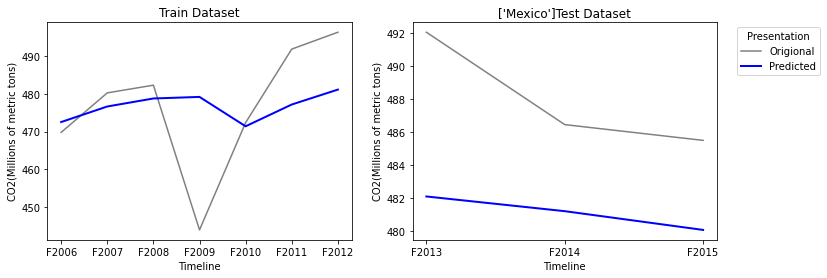

Origional Values:  [array([492.039], dtype=object), array([486.441], dtype=object), array([485.486], dtype=object)]
Predicted Values:  [[482.08553003]
 [481.19452954]
 [480.05861045]]
Explained Variance Score: 0.4324622432876565
        Maximam Error   : 9.953469969511048
    Mean Absolute Error : 6.875776660527113
    Mean Squared Error  : 52.01785802394886
         r2 score       : -5.22625041717568


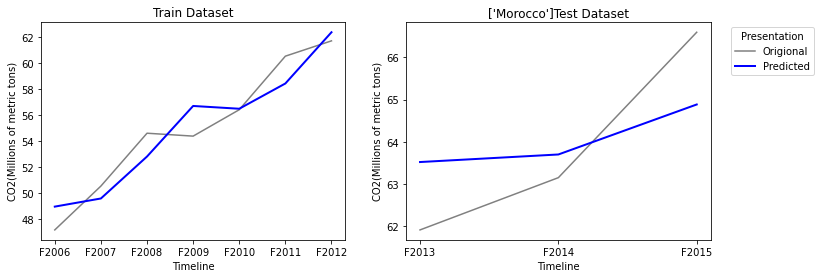

Origional Values:  [array([61.914], dtype=object), array([63.151], dtype=object), array([66.593], dtype=object)]
Predicted Values:  [[63.52071316]
 [63.69962678]
 [64.8831356 ]]
Explained Variance Score: 0.5117738665918252
        Maximam Error   : 1.709864400645941
    Mean Absolute Error : 1.2884014499738707
    Mean Squared Error  : 1.935384936837097
         r2 score       : 0.5061474068572329


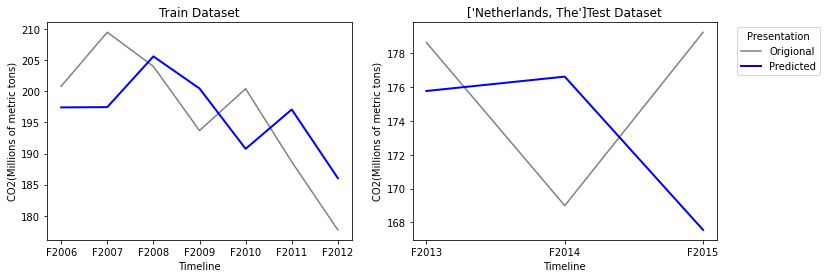

Origional Values:  [array([178.633], dtype=object), array([168.994], dtype=object), array([179.238], dtype=object)]
Predicted Values:  [[175.76709313]
 [176.61549126]
 [167.5593344 ]]
Explained Variance Score: -1.825940512410439
        Maximam Error   : 11.678665601678262
    Mean Absolute Error : 7.388687913146508
    Mean Squared Error  : 67.56392717798256
         r2 score       : -2.0677427987422448


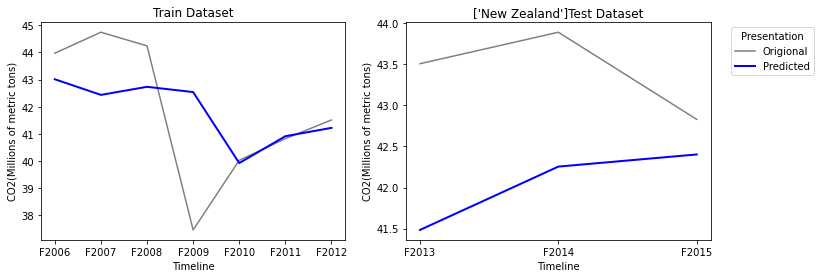

Origional Values:  [array([43.508], dtype=object), array([43.891], dtype=object), array([42.83], dtype=object)]
Predicted Values:  [[41.48378473]
 [42.25494103]
 [42.40269133]]
Explained Variance Score: -1.4027872141531588
        Maximam Error   : 2.0242152693764766
    Mean Absolute Error : 1.3625276353255014
    Mean Squared Error  : 2.318909703349192
         r2 score       : -11.049107802545763


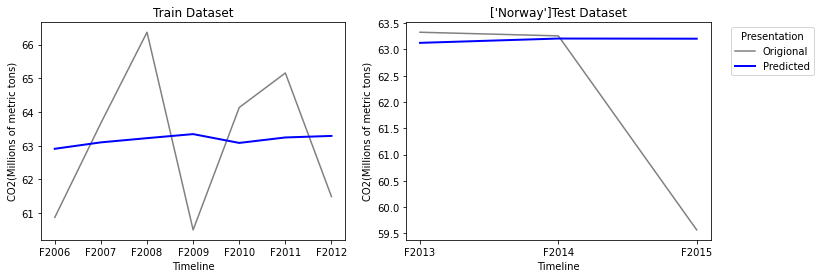

Origional Values:  [array([63.328], dtype=object), array([63.259], dtype=object), array([59.565], dtype=object)]
Predicted Values:  [[63.12608909]
 [63.208187  ]
 [63.20510833]]
Explained Variance Score: -0.021440650307775533
        Maximam Error   : 3.640108327632113
    Mean Absolute Error : 1.2976107447840235
    Mean Squared Error  : 4.431246203945084
         r2 score       : -0.43403107421494624


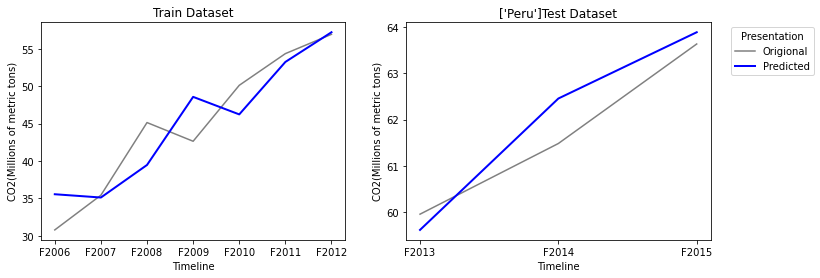

Origional Values:  [array([59.951], dtype=object), array([61.481], dtype=object), array([63.635], dtype=object)]
Predicted Values:  [[59.61036476]
 [62.45462785]
 [63.88894641]]
Explained Variance Score: 0.8735550552790002
        Maximam Error   : 0.9736278468952051
    Mean Absolute Error : 0.5227365013333625
    Mean Squared Error  : 0.37615744482145236
         r2 score       : 0.835279327791174


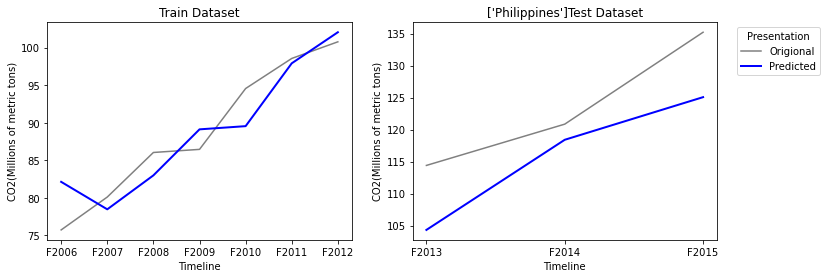

Origional Values:  [array([114.402], dtype=object), array([120.849], dtype=object), array([135.202], dtype=object)]
Predicted Values:  [[104.33048452]
 [118.40765301]
 [125.06518713]]
Explained Variance Score: 0.8273422731672979
        Maximam Error   : 10.136812867646142
    Mean Absolute Error : 7.549891780685708
    Mean Squared Error  : 70.05019143953847
         r2 score       : 0.07315464070835842


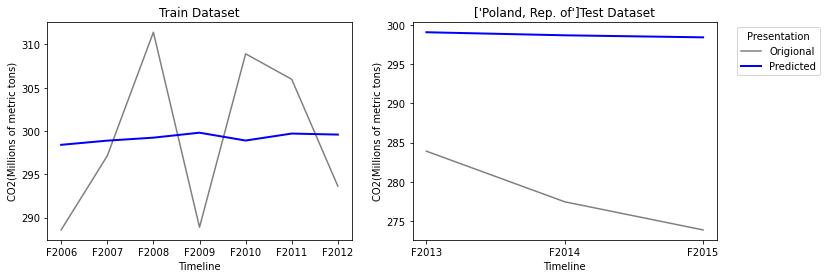

Origional Values:  [array([283.896], dtype=object), array([277.432], dtype=object), array([273.84], dtype=object)]
Predicted Values:  [[299.0867623 ]
 [298.69596981]
 [298.43640521]]
Explained Variance Score: 0.12421500114060657
        Maximam Error   : 24.596405209985903
    Mean Absolute Error : 20.35037910419315
    Mean Squared Error  : 429.2996067738971
         r2 score       : -23.797662778927894


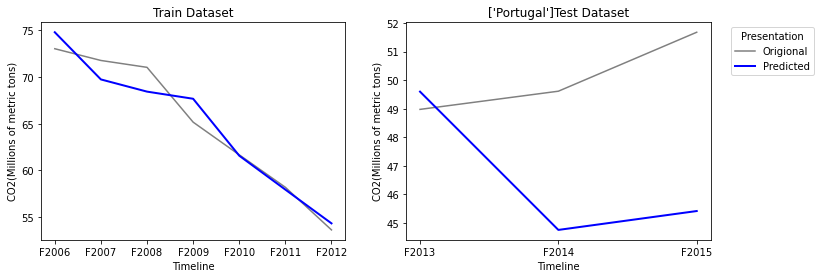

Origional Values:  [array([48.975], dtype=object), array([49.611], dtype=object), array([51.674], dtype=object)]
Predicted Values:  [[49.59575225]
 [44.75768134]
 [45.41826809]]
Explained Variance Score: -5.631880456190142
        Maximam Error   : 6.255731908177069
    Mean Absolute Error : 3.9099342751089097
    Mean Squared Error  : 21.024739037148265
         r2 score       : -14.84107206559884


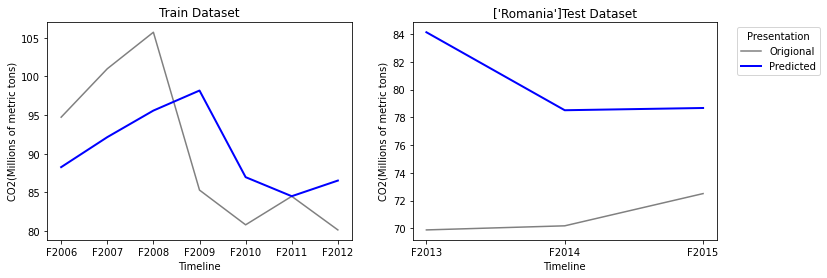

Origional Values:  [array([69.888], dtype=object), array([70.183], dtype=object), array([72.506], dtype=object)]
Predicted Values:  [[84.13401102]
 [78.51340174]
 [78.67527617]]
Explained Variance Score: -7.502567820277013
        Maximam Error   : 14.246011023523721
    Mean Absolute Error : 9.581896309660246
    Mean Squared Error  : 103.46813054603744
         r2 score       : -74.4796296974374


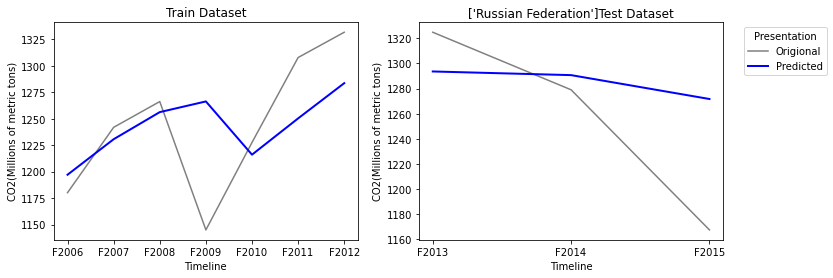

Origional Values:  [array([1324.769], dtype=object), array([1278.977], dtype=object), array([1167.53], dtype=object)]
Predicted Values:  [[1293.56910957]
 [1290.65570575]
 [1271.65946655]]
Explained Variance Score: 0.2686367019756183
        Maximam Error   : 104.12946655213887
    Mean Absolute Error : 49.00268757638264
    Mean Squared Error  : 3984.2570450732983
         r2 score       : 0.08621320794451337


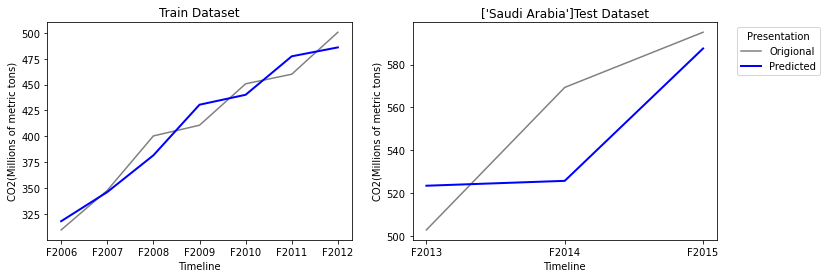

Origional Values:  [array([502.969], dtype=object), array([569.349], dtype=object), array([595.054], dtype=object)]
Predicted Values:  [[523.55489638]
 [525.82797378]
 [587.48995898]]
Explained Variance Score: 0.5426914375454851
        Maximam Error   : 43.52102622117616
    Mean Absolute Error : 23.890321206413415
    Mean Squared Error  : 791.6911898711245
         r2 score       : 0.4740253036602301


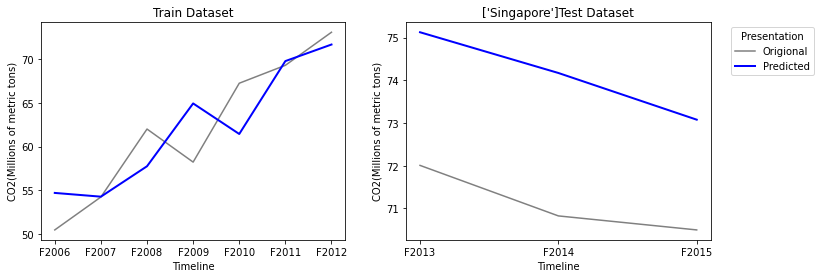

Origional Values:  [array([72.008], dtype=object), array([70.825], dtype=object), array([70.497], dtype=object)]
Predicted Values:  [[75.12592457]
 [74.17207521]
 [73.07866069]]
Explained Variance Score: 0.7556989542820238
        Maximam Error   : 3.3470752137563835
    Mean Absolute Error : 3.0155534913028674
    Mean Squared Error  : 9.19644600976158
         r2 score       : -20.83740834581418


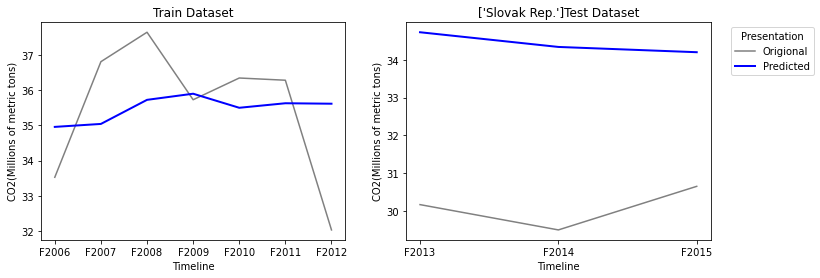

Origional Values:  [array([30.164], dtype=object), array([29.494], dtype=object), array([30.648], dtype=object)]
Predicted Values:  [[34.72920785]
 [34.34004711]
 [34.2004659 ]]
Explained Variance Score: -0.3786827650384259
        Maximam Error   : 4.846047106578773
    Mean Absolute Error : 4.321240285217784
    Mean Squared Error  : 18.981769747051136
         r2 score       : -83.78748412974133


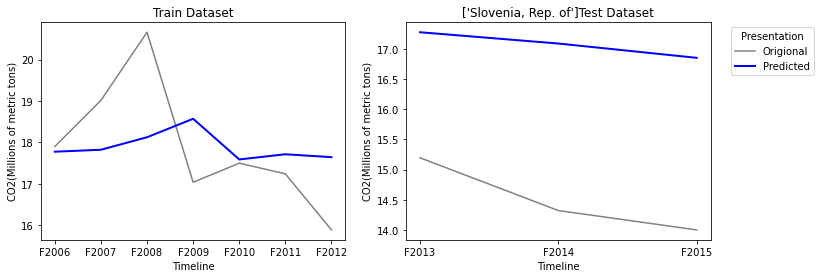

Origional Values:  [array([15.195], dtype=object), array([14.321], dtype=object), array([14.0], dtype=object)]
Predicted Values:  [[17.27507464]
 [17.08805754]
 [16.85116921]]
Explained Variance Score: 0.532185515825517
        Maximam Error   : 2.8511692096809043
    Mean Absolute Error : 2.56610046347239
    Mean Squared Error  : 6.704161267293254
         r2 score       : -25.291492946505507


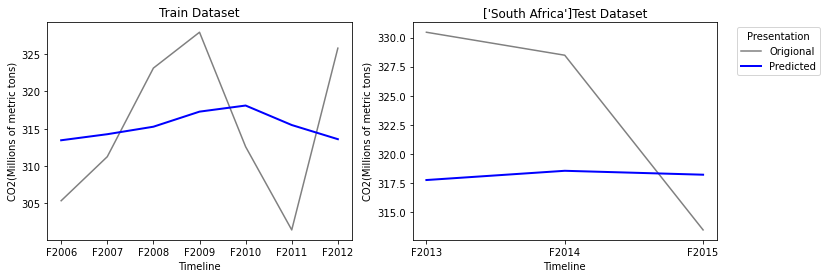

Origional Values:  [array([330.458], dtype=object), array([328.481], dtype=object), array([313.451], dtype=object)]
Predicted Values:  [[317.74284012]
 [318.53789322]
 [318.20138712]]
Explained Variance Score: -0.018458611258797664
        Maximam Error   : 12.715159880990598
    Mean Absolute Error : 9.136217927649605
    Mean Squared Error  : 94.36894700959806
         r2 score       : -0.6363060395919762


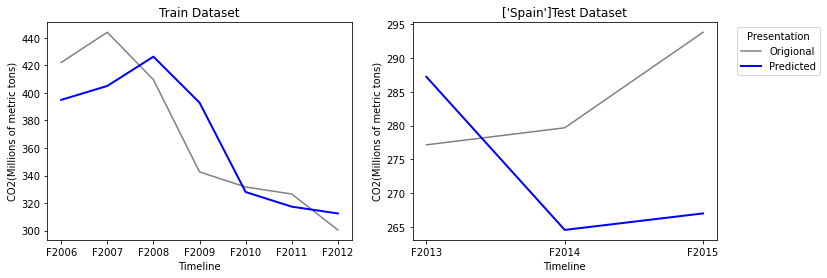

Origional Values:  [array([277.159], dtype=object), array([279.68], dtype=object), array([293.817], dtype=object)]
Predicted Values:  [[287.22088288]
 [264.5705186 ]
 [267.01399365]]
Explained Variance Score: -3.402232374298433
        Maximam Error   : 26.803006352855505
    Mean Absolute Error : 17.324790209198415
    Mean Squared Error  : 349.31302156527227
         r2 score       : -5.499529796772914


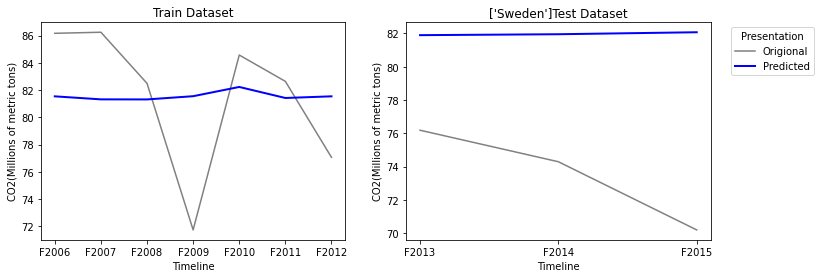

Origional Values:  [array([76.184], dtype=object), array([74.291], dtype=object), array([70.196], dtype=object)]
Predicted Values:  [[81.89403785]
 [81.94964296]
 [82.06912138]]
Explained Variance Score: -0.05931244968225813
        Maximam Error   : 11.87312137880265
    Mean Absolute Error : 8.41393406316197
    Mean Squared Error  : 77.41011851110777
         r2 score       : -11.394737522277635


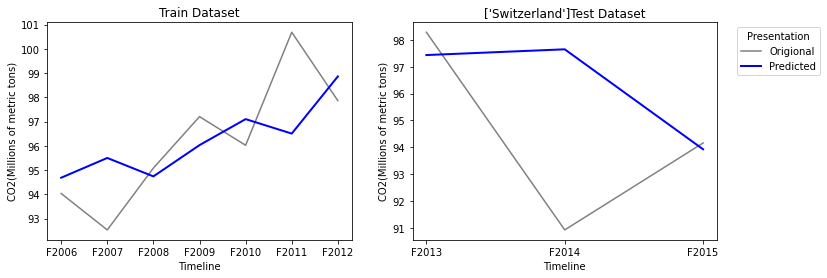

Origional Values:  [array([98.287], dtype=object), array([90.92], dtype=object), array([94.16], dtype=object)]
Predicted Values:  [[97.43670196]
 [97.6505935 ]
 [93.92544219]]
Explained Variance Score: -0.30023522546501424
        Maximam Error   : 6.730593502382774
    Mean Absolute Error : 2.6051497839552886
    Mean Squared Error  : 15.3596376730203
         r2 score       : -0.6898857324386489


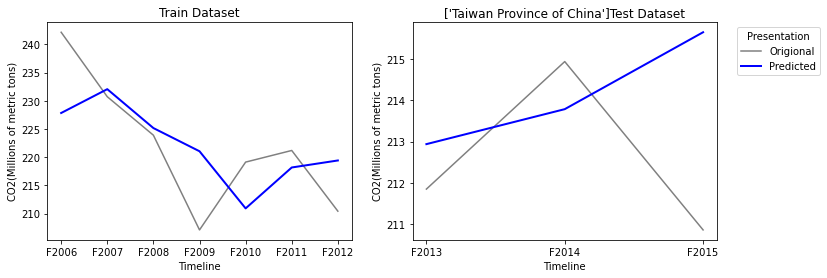

Origional Values:  [array([211.848], dtype=object), array([214.94], dtype=object), array([210.858], dtype=object)]
Predicted Values:  [[212.93795319]
 [213.78602857]
 [215.6510706 ]]
Explained Variance Score: -0.9893030999999208
        Maximam Error   : 4.7930706011682105
    Mean Absolute Error : 2.345665071861049
    Mean Squared Error  : 8.49772459764275
         r2 score       : -1.8114072599894944


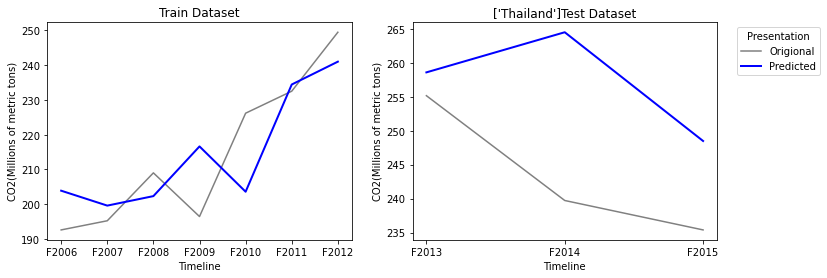

Origional Values:  [array([255.149], dtype=object), array([239.72], dtype=object), array([235.388], dtype=object)]
Predicted Values:  [[258.58171896]
 [264.48996863]
 [248.4804175 ]]
Explained Variance Score: -0.05814120616968932
        Maximam Error   : 24.76996862973479
    Mean Absolute Error : 13.765035031333326
    Mean Squared Error  : 265.58210048012813
         r2 score       : -2.6925300571505946


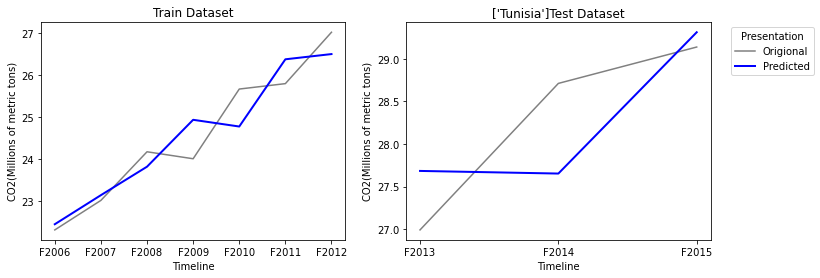

Origional Values:  [array([26.991], dtype=object), array([28.711], dtype=object), array([29.138], dtype=object)]
Predicted Values:  [[27.68352776]
 [27.65266497]
 [29.31153963]]
Explained Variance Score: 0.3739131980243
        Maximam Error   : 1.0583350267111875
    Mean Absolute Error : 0.6414674707015836
    Mean Squared Error  : 0.5432612420609545
         r2 score       : 0.3691434904453734


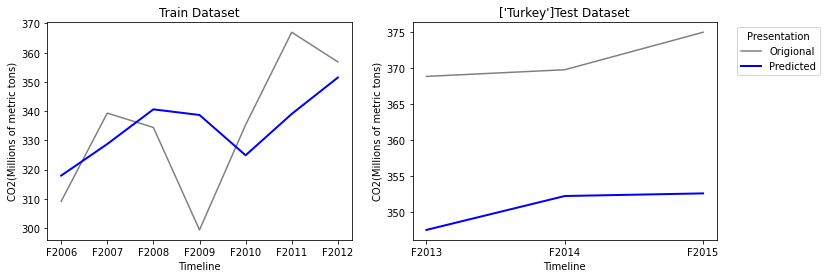

Origional Values:  [array([368.813], dtype=object), array([369.74], dtype=object), array([374.947], dtype=object)]
Predicted Values:  [[347.49422066]
 [352.20260788]
 [352.56718146]]
Explained Variance Score: 0.4073949256923892
        Maximam Error   : 22.37981853914698
    Mean Absolute Error : 20.411996668887962
    Mean Squared Error  : 420.9689176855277
         r2 score       : -56.75652489093273


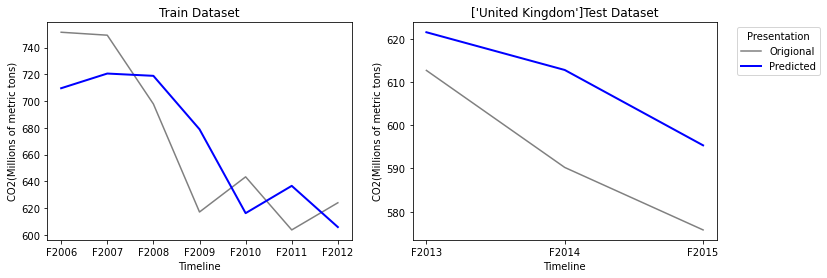

Origional Values:  [array([612.671], dtype=object), array([590.239], dtype=object), array([575.797], dtype=object)]
Predicted Values:  [[621.4957409]
 [612.7713929]
 [595.3491037]]
Explained Variance Score: 0.8494499140859224
        Maximam Error   : 22.53239289625685
    Mean Absolute Error : 16.96974583418728
    Mean Squared Error  : 322.6231802760934
         r2 score       : -0.4017222715203812


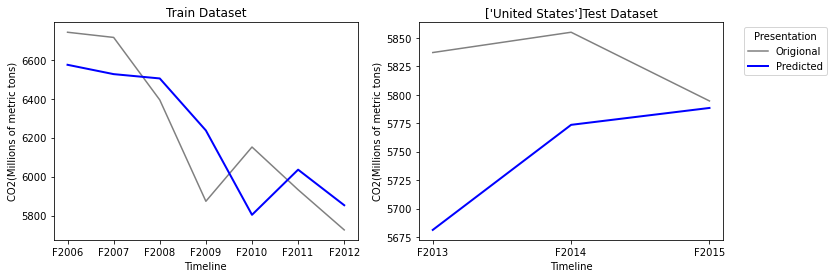

Origional Values:  [array([5837.047], dtype=object), array([5854.868], dtype=object), array([5794.513], dtype=object)]
Predicted Values:  [[5681.25996945]
 [5773.54467202]
 [5788.37791082]]
Explained Variance Score: -4.8227018869582885
        Maximam Error   : 155.78703054876223
    Mean Absolute Error : 81.08181590264515
    Mean Squared Error  : 10306.907293166116
         r2 score       : -15.078149854560763


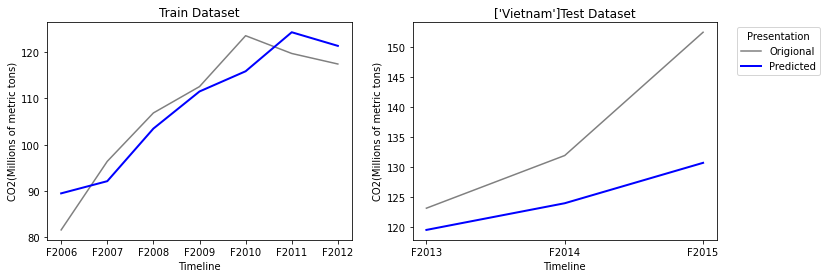

Origional Values:  [array([123.209], dtype=object), array([131.967], dtype=object), array([152.455], dtype=object)]
Predicted Values:  [[119.59774601]
 [124.03294311]
 [130.74861673]]
Explained Variance Score: 0.6036384272598692
        Maximam Error   : 21.706383272271154
    Mean Absolute Error : 11.083898048789138
    Mean Squared Error  : 182.38582960459624
         r2 score       : -0.214296161929876


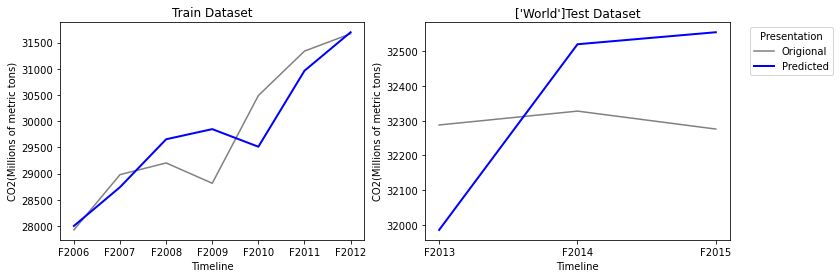

Origional Values:  [array([32287.8], dtype=object), array([32327.8], dtype=object), array([32276.0], dtype=object)]
Predicted Values:  [[31984.90600637]
 [32520.7585233 ]
 [32555.40789394]]
Explained Variance Score: -132.9562192489812
        Maximam Error   : 302.8939936349161
    Mean Absolute Error : 258.4201369571929
    Mean Squared Error  : 69015.51142951909
         r2 score       : -139.45051710028866


In [17]:
i=0
VVIP1=list()
while i<len(CO2_FINAL_DF_FINAL.T):
    series=CO2_FINAL_DF_FINAL[CO2_FINAL_DF_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    # Splitting the data into Train & Test
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=3,shuffle=False)
    # Fitting the model on Train dataset
    Model = LinearRegression()
    Model = Model.fit(X_train, y_train)
    # Predicting and storing results for Test dataset
    train_fit = Model.predict(X_train)
    test_pred = Model.predict(X_test)
    plt.figure(figsize=(12,4))
    # Plotting Regression line on Train Dataset
    plt.subplot(1,2,1)
    plt.plot(y_train, color='gray')
    plt.plot(y_train.index,train_fit, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title("Train Dataset")
    # Plotting Regression line on Test Dataset
    plt.subplot(1,2,2)
    plt.plot(y_test, color='gray')
    plt.plot(y_test.index,test_pred, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title(str(X.columns.values)+"Test Dataset")
    plt.legend(['Origional','Predicted'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()
    pre=test_pred
    y_test=y_test
    y_test=np.array(y_test)
    VVIP1.append(pre)
    exp_rf=explained_variance_score(y_test,pre)
    mxer_rf=max_error(y_test,pre)
    mae_rf=mean_absolute_error(y_test,pre)
    mse_rf=mean_squared_error(y_test,pre)
    r2_rf=r2_score(y_test,pre)
    print("Origional Values: " , list(y_test))
    print("Predicted Values: " , pre)
    print("Explained Variance Score:",exp_rf)
    print("        Maximam Error   :",mxer_rf)
    print("    Mean Absolute Error :",mae_rf)
    print("    Mean Squared Error  :",mse_rf)
    print("         r2 score       :",r2_rf)
    i=i+1

### Random Forest Regression

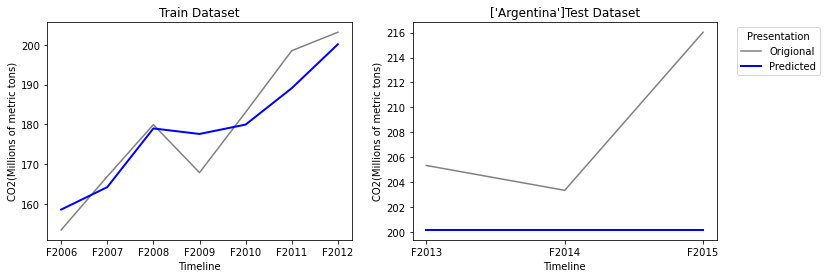

Origional Values:  [array([205.328], dtype=object), array([203.334], dtype=object), array([216.033], dtype=object)]
Predicted Values:  [200.15275 200.15275 200.15275]
Explained Variance Score: 0.0
        Maximam Error   : 15.880250000000132
    Mean Absolute Error : 8.078916666666808
    Mean Squared Error  : 96.36196806250221
         r2 score       : -2.099145791757373


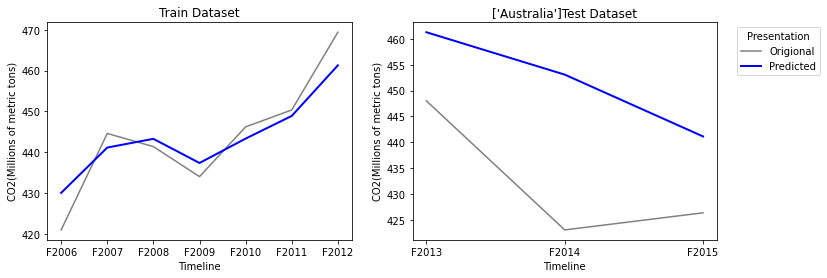

Origional Values:  [array([448.017], dtype=object), array([423.099], dtype=object), array([426.401], dtype=object)]
Predicted Values:  [461.26374 453.08299 441.14518]
Explained Variance Score: 0.5317552955238753
        Maximam Error   : 29.98398999999972
    Mean Absolute Error : 19.32496999999974
    Mean Squared Error  : 430.63554027335675
         r2 score       : -2.526390717463522


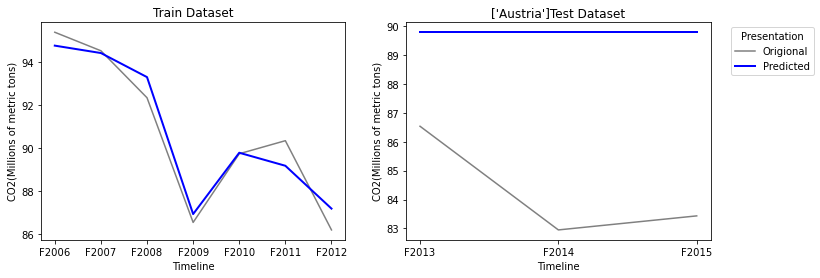

Origional Values:  [array([86.533], dtype=object), array([82.95], dtype=object), array([83.435], dtype=object)]
Predicted Values:  [89.78268 89.78268 89.78268]
Explained Variance Score: 0.0
        Maximam Error   : 6.832679999999982
    Mean Absolute Error : 5.476679999999983
    Mean Squared Error  : 32.51299248906648
         r2 score       : -11.907263563580056


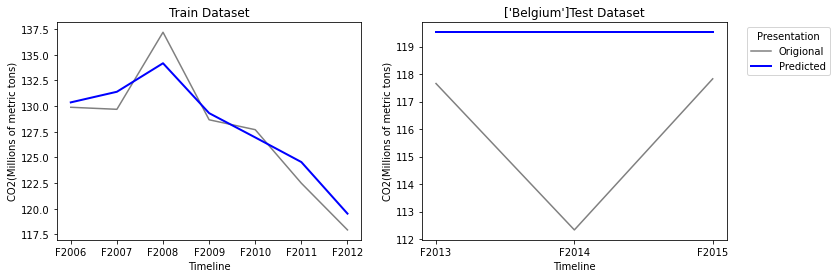

Origional Values:  [array([117.656], dtype=object), array([112.33], dtype=object), array([117.828], dtype=object)]
Predicted Values:  [119.52256 119.52256 119.52256]
Explained Variance Score: 0.0
        Maximam Error   : 7.192559999999943
    Mean Absolute Error : 3.5845599999999394
    Mean Squared Error  : 19.362833060266247
         r2 score       : -1.9726034016180822


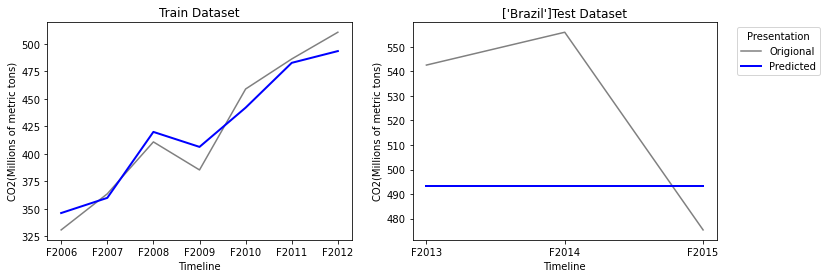

Origional Values:  [array([542.574], dtype=object), array([555.957], dtype=object), array([475.385], dtype=object)]
Predicted Values:  [493.46491 493.46491 493.46491]
Explained Variance Score: -2.220446049250313e-16
        Maximam Error   : 62.49208999999939
    Mean Absolute Error : 43.227029999999786
    Mean Squared Error  : 2214.615726268061
         r2 score       : -0.7819385544187321


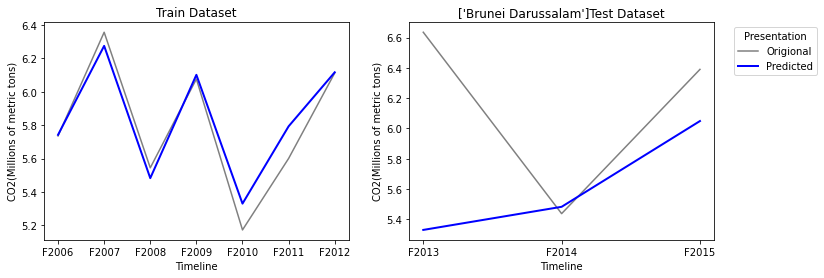

Origional Values:  [array([6.635], dtype=object), array([5.438], dtype=object), array([6.39], dtype=object)]
Predicted Values:  [5.33052 5.48304 6.04904]
Explained Variance Score: -0.20817186039319102
        Maximam Error   : 1.3044799999999963
    Mean Absolute Error : 0.5634933333333322
    Mean Squared Error  : 0.6066501311999961
         r2 score       : -1.275755367469468


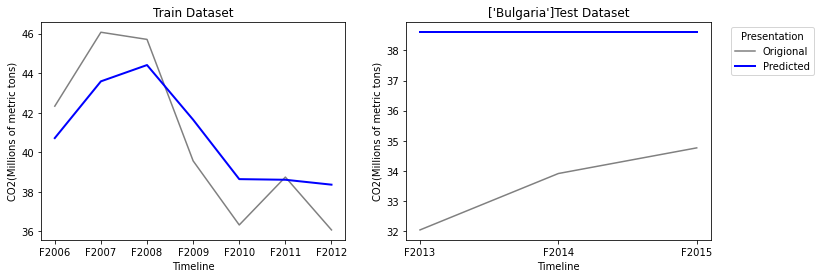

Origional Values:  [array([32.037], dtype=object), array([33.911], dtype=object), array([34.763], dtype=object)]
Predicted Values:  [38.60492 38.60492 38.60492]
Explained Variance Score: 0.0
        Maximam Error   : 6.567920000000008
    Mean Absolute Error : 5.034586666666674
    Mean Squared Error  : 26.643602459733412
         r2 score       : -19.549779870246123


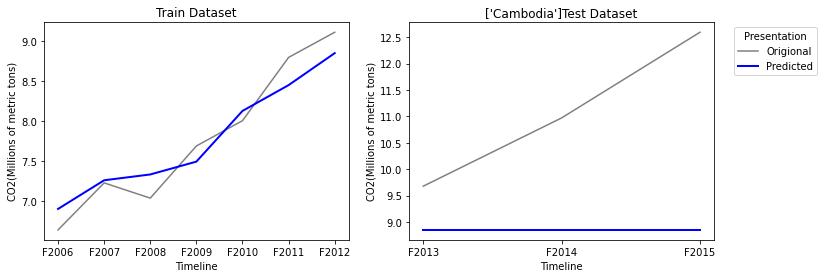

Origional Values:  [array([9.679], dtype=object), array([10.972], dtype=object), array([12.595], dtype=object)]
Predicted Values:  [8.85028 8.85028 8.85028]
Explained Variance Score: 0.0
        Maximam Error   : 3.7447200000000027
    Mean Absolute Error : 2.2317200000000024
    Mean Squared Error  : 6.40380015840001
         r2 score       : -3.4994963262335057


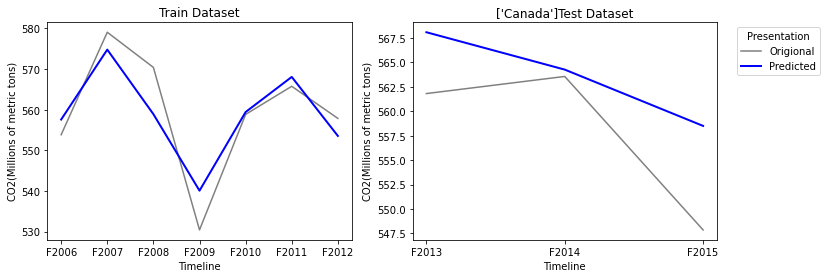

Origional Values:  [array([561.804], dtype=object), array([563.554], dtype=object), array([547.864], dtype=object)]
Predicted Values:  [568.07331 564.25407 558.49834]
Explained Variance Score: 0.6646250705957383
        Maximam Error   : 10.634340000000975
    Mean Absolute Error : 5.867906666667484
    Mean Squared Error  : 50.961177705542696
         r2 score       : -0.03401642283740092


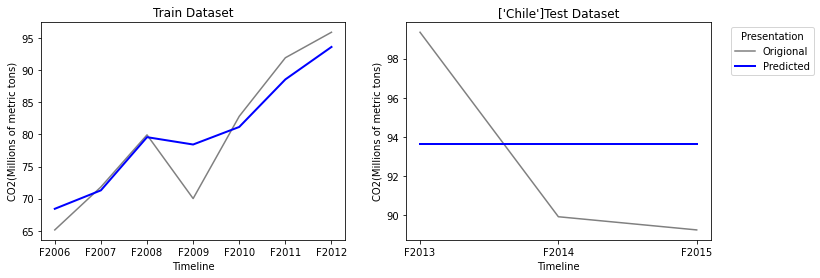

Origional Values:  [array([99.348], dtype=object), array([89.911], dtype=object), array([89.237], dtype=object)]
Predicted Values:  [93.6457 93.6457 93.6457]
Explained Variance Score: 0.0
        Maximam Error   : 5.7022999999999655
    Mean Absolute Error : 4.615233333333346
    Mean Squared Error  : 21.96694835666673
         r2 score       : -0.03107780529126325


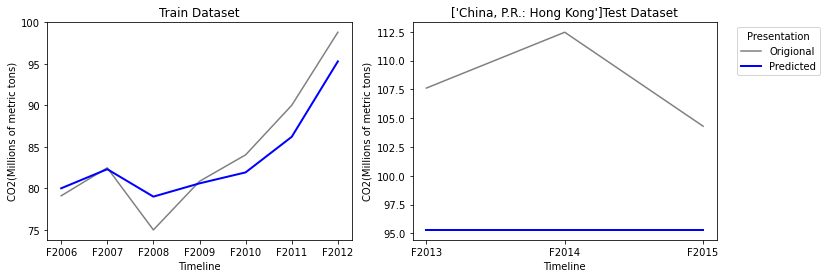

Origional Values:  [array([107.616], dtype=object), array([112.459], dtype=object), array([104.308], dtype=object)]
Predicted Values:  [95.30773 95.30773 95.30773]
Explained Variance Score: 0.0
        Maximam Error   : 17.151269999999926
    Mean Absolute Error : 12.819936666666592
    Mean Squared Error  : 175.55481102623142
         r2 score       : -14.668891856123224


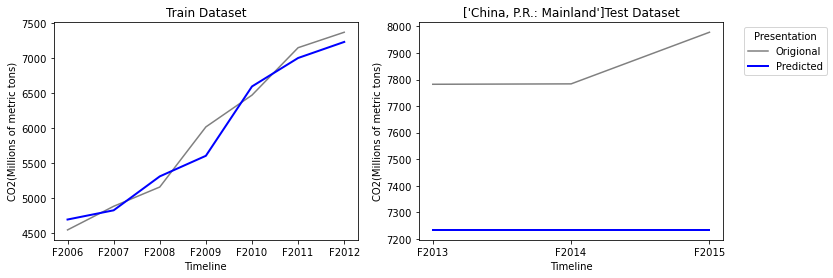

Origional Values:  [array([7782.052], dtype=object), array([7783.586], dtype=object), array([7977.936], dtype=object)]
Predicted Values:  [7233.7791 7233.7791 7233.7791]
Explained Variance Score: 2.220446049250313e-16
        Maximam Error   : 744.15689999999
    Mean Absolute Error : 614.0788999999901
    Mean Squared Error  : 385553.43065986456
         r2 score       : -44.570808461393504


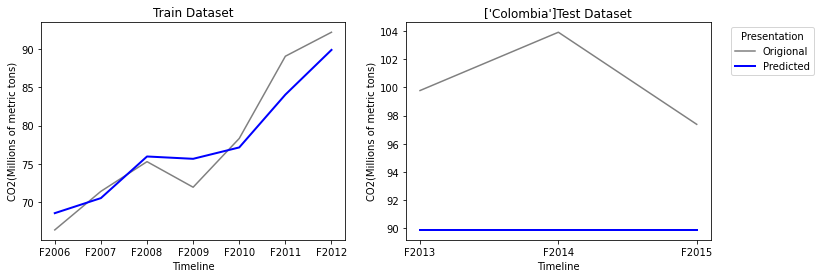

Origional Values:  [array([99.774], dtype=object), array([103.908], dtype=object), array([97.378], dtype=object)]
Predicted Values:  [89.88981 89.88981 89.88981]
Explained Variance Score: 0.0
        Maximam Error   : 14.01818999999989
    Mean Absolute Error : 10.463523333333223
    Mean Squared Error  : 116.75995076943104
         r2 score       : -15.050293582312655


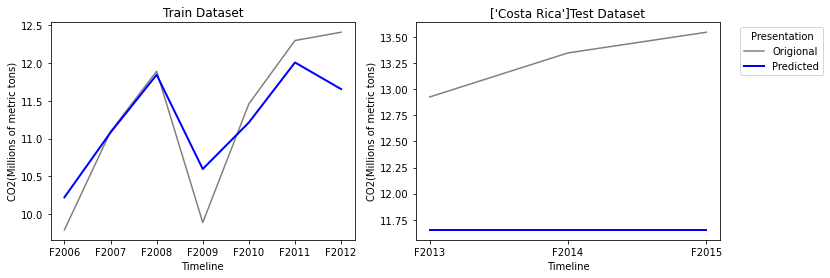

Origional Values:  [array([12.926], dtype=object), array([13.348], dtype=object), array([13.546], dtype=object)]
Predicted Values:  [11.65258 11.65258 11.65258]
Explained Variance Score: 0.0
        Maximam Error   : 1.8934199999999777
    Mean Absolute Error : 1.6207533333333117
    Mean Squared Error  : 2.693695589733263
         r2 score       : -39.292078797648294


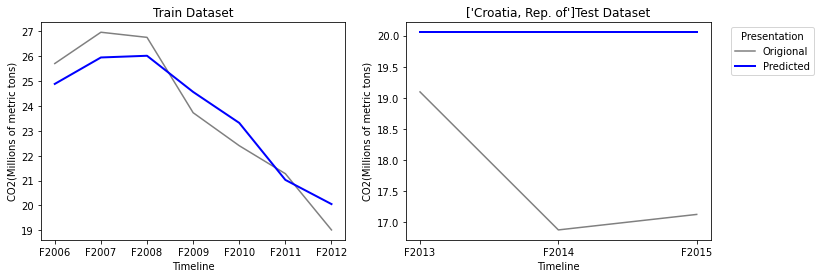

Origional Values:  [array([19.095], dtype=object), array([16.877], dtype=object), array([17.126], dtype=object)]
Predicted Values:  [20.05372 20.05372 20.05372]
Explained Variance Score: 1.1102230246251565e-16
        Maximam Error   : 3.1767199999999782
    Mean Absolute Error : 2.354386666666644
    Mean Squared Error  : 6.527412798399893
         r2 score       : -5.631687986592639


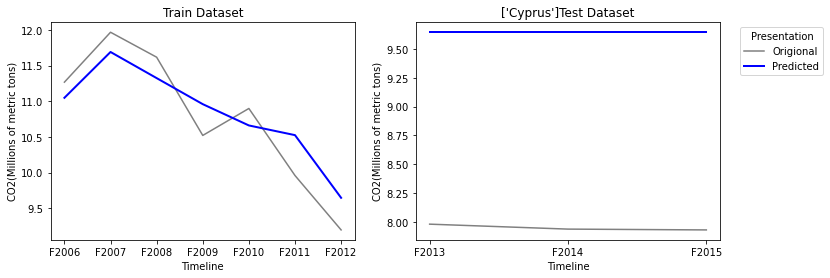

Origional Values:  [array([7.979], dtype=object), array([7.936], dtype=object), array([7.929], dtype=object)]
Predicted Values:  [9.64631 9.64631 9.64631]
Explained Variance Score: 0.0
        Maximam Error   : 1.7173100000000137
    Mean Absolute Error : 1.6983100000000138
    Mean Squared Error  : 2.8847455227667136
         r2 score       : -5902.299159822755


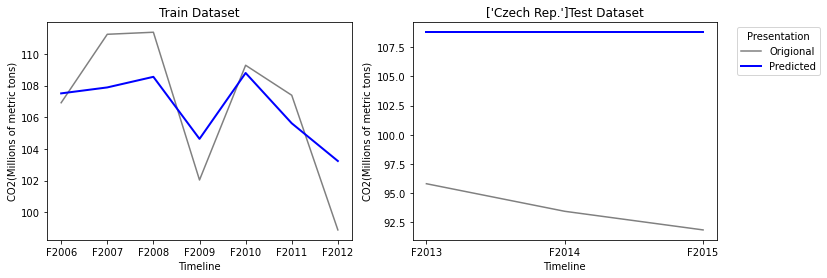

Origional Values:  [array([95.808], dtype=object), array([93.444], dtype=object), array([91.848], dtype=object)]
Predicted Values:  [108.79281 108.79281 108.79281]
Explained Variance Score: 0.0
        Maximam Error   : 16.94481000000006
    Mean Absolute Error : 15.092810000000057
    Mean Squared Error  : 230.43928169610172
         r2 score       : -86.0775650612843


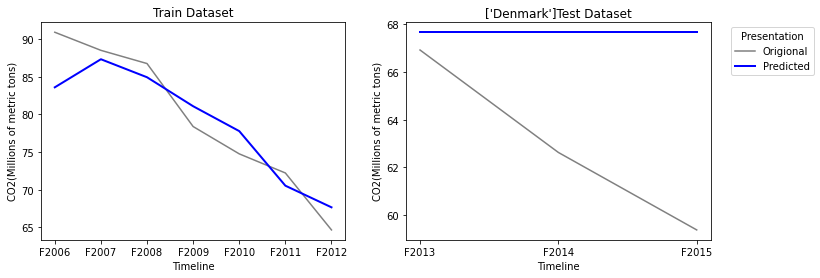

Origional Values:  [array([66.926], dtype=object), array([62.631], dtype=object), array([59.383], dtype=object)]
Predicted Values:  [67.67072 67.67072 67.67072]
Explained Variance Score: 0.0
        Maximam Error   : 8.287719999999986
    Mean Absolute Error : 4.690719999999987
    Mean Squared Error  : 31.546562785066545
         r2 score       : -2.3054825840660147


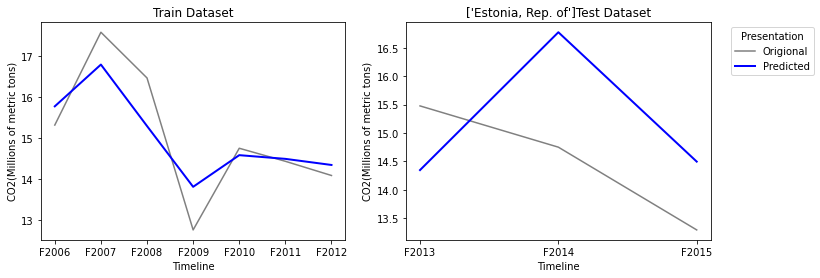

Origional Values:  [array([15.476], dtype=object), array([14.749], dtype=object), array([13.291], dtype=object)]
Predicted Values:  [14.34537 16.774   14.49458]
Explained Variance Score: -1.1648016249539772
        Maximam Error   : 2.024999999999965
    Mean Absolute Error : 1.4530699999999868
    Mean Squared Error  : 2.2758513377666145
         r2 score       : -1.7573012598070736


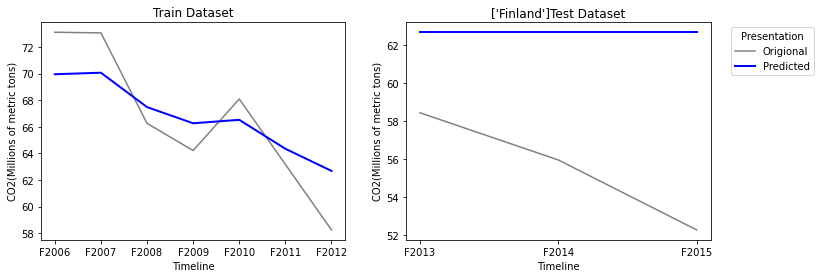

Origional Values:  [array([58.446], dtype=object), array([55.964], dtype=object), array([52.286], dtype=object)]
Predicted Values:  [62.682 62.682 62.682]
Explained Variance Score: 0.0
        Maximam Error   : 10.395999999999916
    Mean Absolute Error : 7.1166666666665845
    Mean Squared Error  : 57.05067866666548
         r2 score       : -7.908970404906629


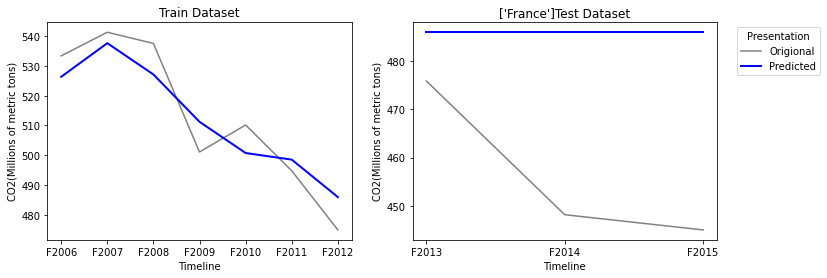

Origional Values:  [array([475.829], dtype=object), array([448.16], dtype=object), array([445.014], dtype=object)]
Predicted Values:  [485.92909 485.92909 485.92909]
Explained Variance Score: 0.0
        Maximam Error   : 40.915090000000305
    Mean Absolute Error : 29.594756666666967
    Mean Squared Error  : 1067.5201890481178
         r2 score       : -4.569557216716316


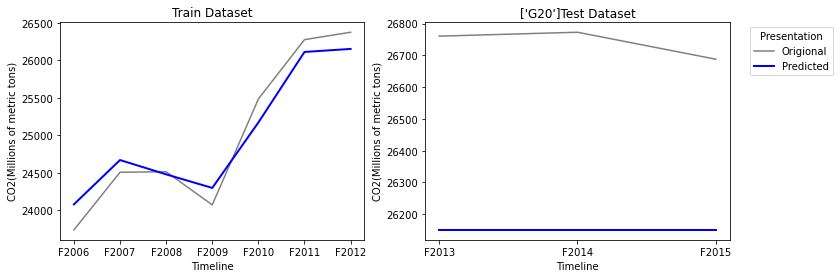

Origional Values:  [array([26760.591], dtype=object), array([26772.893], dtype=object), array([26687.974], dtype=object)]
Predicted Values:  [26150.44091 26150.44091 26150.44091]
Explained Variance Score: 0.0
        Maximam Error   : 622.452090000017
    Mean Absolute Error : 590.0450900000166
    Mean Squared Error  : 349557.18650579447
         r2 score       : -247.9762080447599


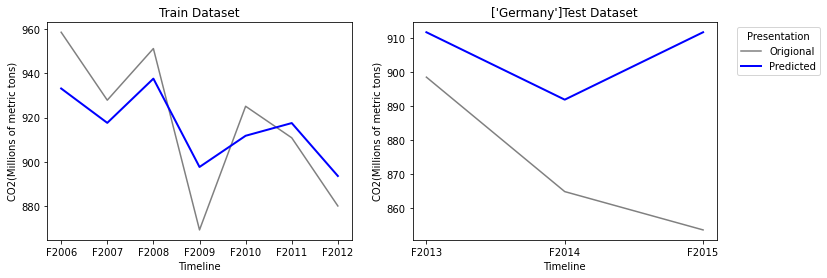

Origional Values:  [array([898.539], dtype=object), array([864.752], dtype=object), array([853.444], dtype=object)]
Predicted Values:  [911.79165 891.89304 911.79165]
Explained Variance Score: 0.03109071156851073
        Maximam Error   : 58.347650000000726
    Mean Absolute Error : 32.91378000000062
    Mean Squared Error  : 1438.905681608909
         r2 score       : -2.9207343050376804


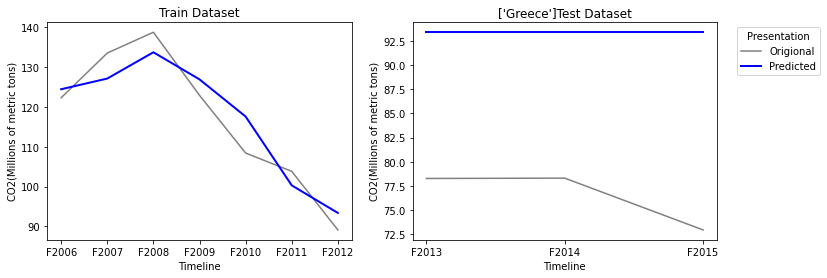

Origional Values:  [array([78.272], dtype=object), array([78.306], dtype=object), array([72.95], dtype=object)]
Predicted Values:  [93.398 93.398 93.398]
Explained Variance Score: 1.1102230246251565e-16
        Maximam Error   : 20.448000000000178
    Mean Absolute Error : 16.888666666666847
    Mean Squared Error  : 291.5616813333393
         r2 score       : -45.02670748831878


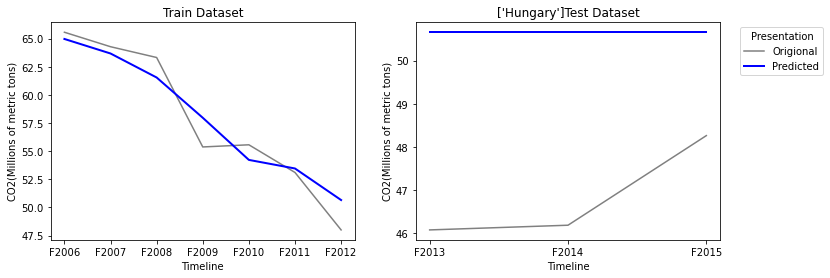

Origional Values:  [array([46.072], dtype=object), array([46.181], dtype=object), array([48.26], dtype=object)]
Predicted Values:  [50.65805 50.65805 50.65805]
Explained Variance Score: 0.0
        Maximam Error   : 4.586050000000043
    Mean Absolute Error : 3.8203833333333796
    Mean Squared Error  : 15.608825035833682
         r2 score       : -14.40097012064765


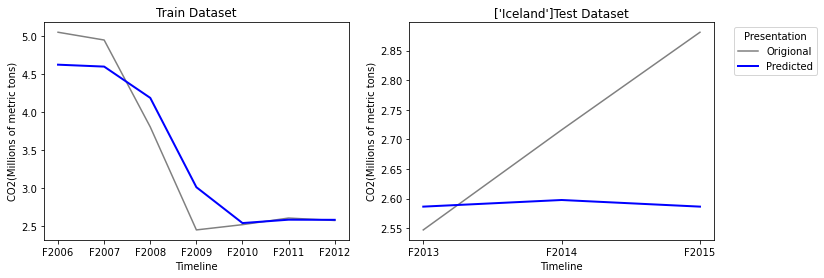

Origional Values:  [array([2.547], dtype=object), array([2.716], dtype=object), array([2.881], dtype=object)]
Predicted Values:  [2.58635 2.59755 2.58635]
Explained Variance Score: -0.0009637747845732125
        Maximam Error   : 0.29464999999999586
    Mean Absolute Error : 0.15081666666666468
    Mean Squared Error  : 0.03413248249999884
         r2 score       : -0.8357157348423601


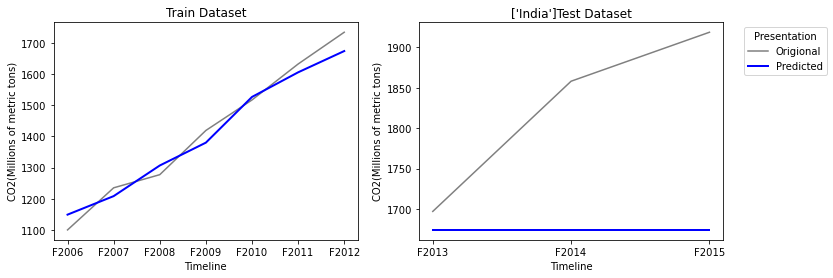

Origional Values:  [array([1696.941], dtype=object), array([1858.186], dtype=object), array([1918.813], dtype=object)]
Predicted Values:  [1674.03025 1674.03025 1674.03025]
Explained Variance Score: 0.0
        Maximam Error   : 244.78274999999985
    Mean Absolute Error : 150.61641666666642
    Mean Squared Error  : 31452.279140395764
         r2 score       : -2.587586609395336


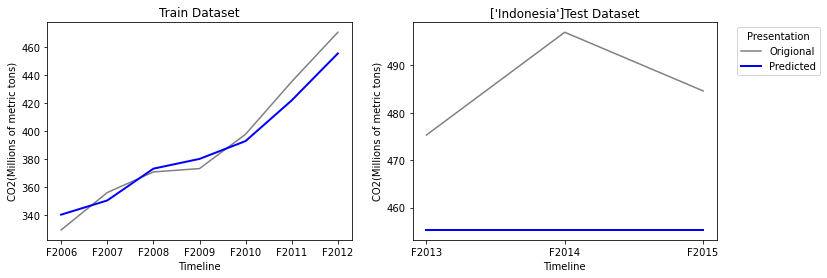

Origional Values:  [array([475.289], dtype=object), array([496.938], dtype=object), array([484.588], dtype=object)]
Predicted Values:  [455.31025 455.31025 455.31025]
Explained Variance Score: 2.220446049250313e-16
        Maximam Error   : 41.62774999999937
    Mean Absolute Error : 30.29474999999938
    Mean Squared Error  : 996.4022222291288
         r2 score       : -11.671980854886527


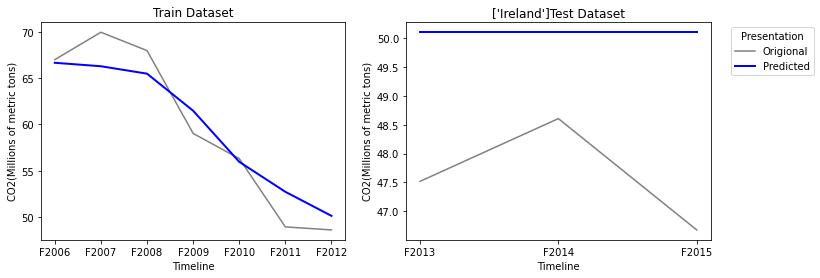

Origional Values:  [array([47.516], dtype=object), array([48.607], dtype=object), array([46.672], dtype=object)]
Predicted Values:  [50.10816 50.10816 50.10816]
Explained Variance Score: 2.220446049250313e-16
        Maximam Error   : 3.4361600000000436
    Mean Absolute Error : 2.5098266666667093
    Mean Squared Error  : 6.9266567856002155
         r2 score       : -10.039783133723555


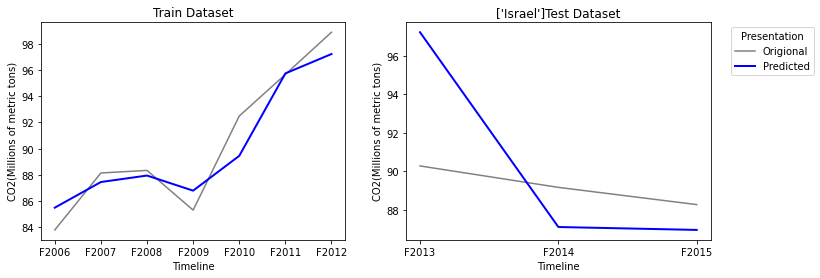

Origional Values:  [array([90.278], dtype=object), array([89.165], dtype=object), array([88.27], dtype=object)]
Predicted Values:  [97.22132 87.10632 86.95549]
Explained Variance Score: -23.66815747301612
        Maximam Error   : 6.943319999999915
    Mean Absolute Error : 3.4388366666665795
    Mean Squared Error  : 18.058597501632743
         r2 score       : -25.767321883135804


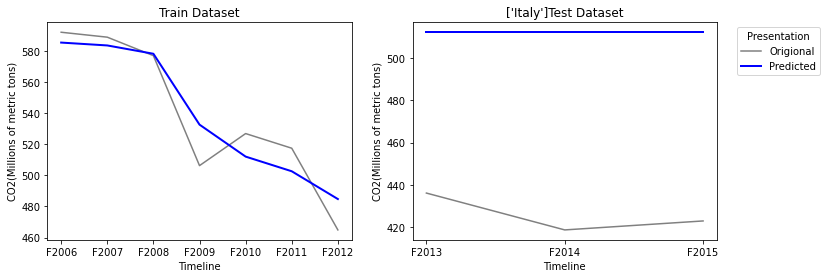

Origional Values:  [array([436.164], dtype=object), array([418.783], dtype=object), array([423.012], dtype=object)]
Predicted Values:  [512.01389 512.01389 512.01389]
Explained Variance Score: 0.0
        Maximam Error   : 93.23089000000016
    Mean Absolute Error : 86.02755666666684
    Mean Squared Error  : 7455.51369559213
         r2 score       : -135.1161136696293


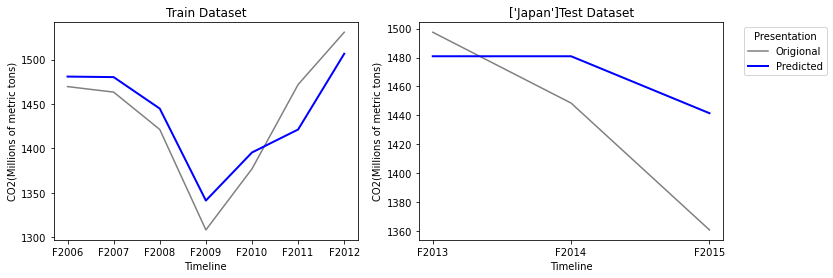

Origional Values:  [array([1497.445], dtype=object), array([1448.543], dtype=object), array([1361.019], dtype=object)]
Predicted Values:  [1480.87309 1480.87309 1441.56621]
Explained Variance Score: 0.506403002784128
        Maximam Error   : 80.5472100000004
    Mean Absolute Error : 43.14973666666682
    Mean Squared Error  : 2602.5719864134667
         r2 score       : 0.18283485543926015


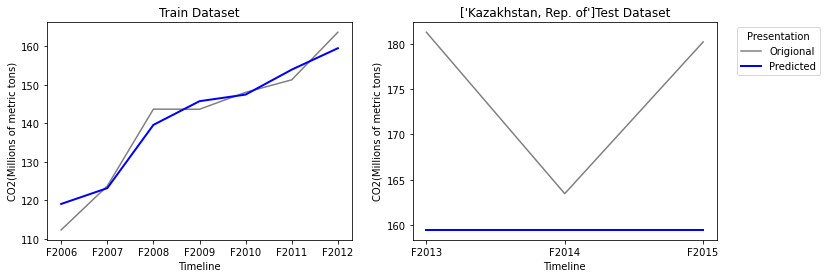

Origional Values:  [array([181.262], dtype=object), array([163.473], dtype=object), array([180.186], dtype=object)]
Predicted Values:  [159.47543 159.47543 159.47543]
Explained Variance Score: 0.0
        Maximam Error   : 21.786569999999813
    Mean Absolute Error : 15.498236666666486
    Mean Squared Error  : 306.520969331561
         r2 score       : -3.621455859304189


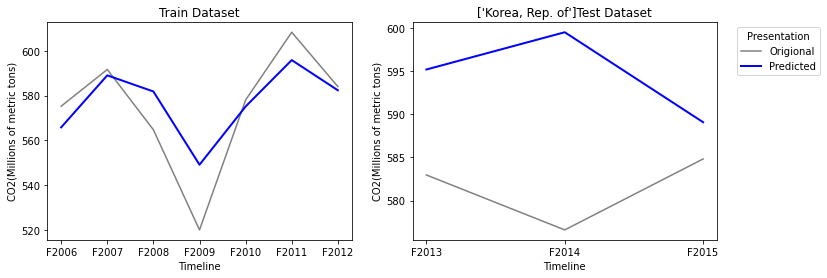

Origional Values:  [array([582.966], dtype=object), array([576.605], dtype=object), array([584.818], dtype=object)]
Predicted Values:  [595.1753  599.48922 589.07653]
Explained Variance Score: -3.7068318534039992
        Maximam Error   : 22.884219999998777
    Mean Absolute Error : 13.117349999998888
    Mean Squared Error  : 230.29653641973587
         r2 score       : -17.614735916516263


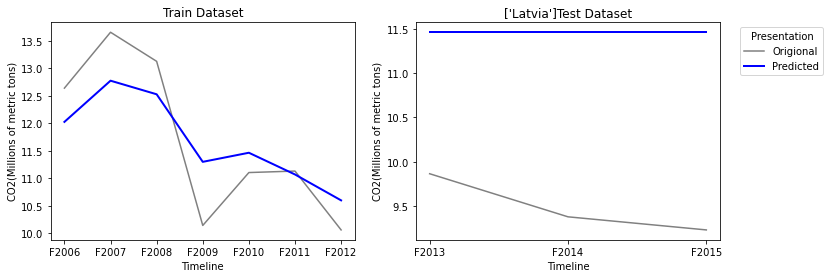

Origional Values:  [array([9.864], dtype=object), array([9.377], dtype=object), array([9.229], dtype=object)]
Predicted Values:  [11.46313 11.46313 11.46313]
Explained Variance Score: 0.0
        Maximam Error   : 2.234129999999995
    Mean Absolute Error : 1.973129999999994
    Mean Squared Error  : 3.9668306635666433
         r2 score       : -52.90545641403062


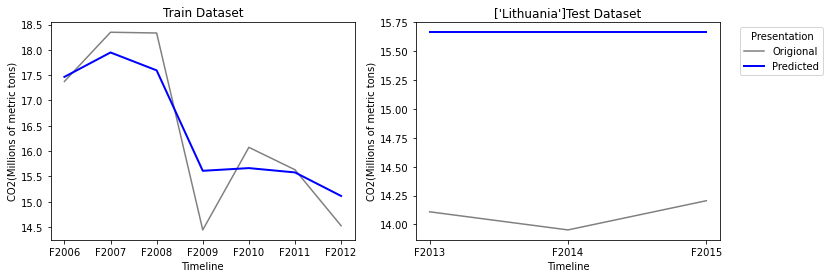

Origional Values:  [array([14.109], dtype=object), array([13.952], dtype=object), array([14.205], dtype=object)]
Predicted Values:  [15.66478 15.66478 15.66478]
Explained Variance Score: 0.0
        Maximam Error   : 1.7127800000000217
    Mean Absolute Error : 1.576113333333355
    Mean Squared Error  : 2.4950081284000682
         r2 score       : -228.42837889123362


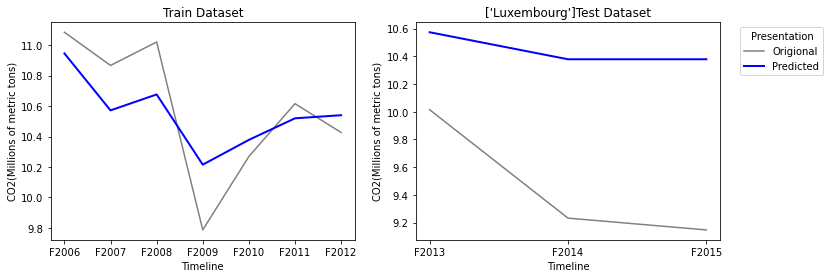

Origional Values:  [array([10.014], dtype=object), array([9.232], dtype=object), array([9.147], dtype=object)]
Predicted Values:  [10.57308 10.37818 10.37818]
Explained Variance Score: 0.4135963684602906
        Maximam Error   : 1.2311800000000002
    Mean Absolute Error : 0.9788133333333319
    Mean Squared Error  : 1.0473677437333322
         r2 score       : -5.878318970723229


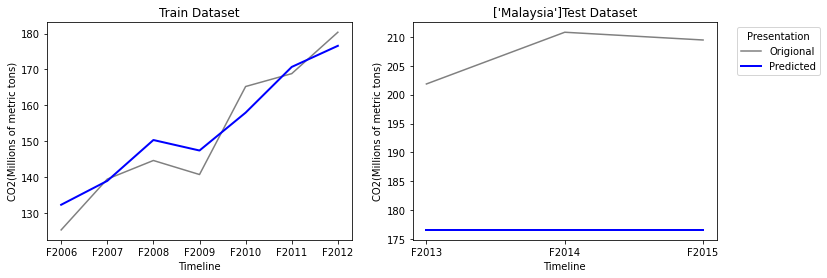

Origional Values:  [array([201.847], dtype=object), array([210.804], dtype=object), array([209.462], dtype=object)]
Predicted Values:  [176.57566 176.57566 176.57566]
Explained Variance Score: 0.0
        Maximam Error   : 34.2283400000002
    Mean Absolute Error : 30.7953400000002
    Mean Squared Error  : 963.9104143822789
         r2 score       : -60.95812919168118


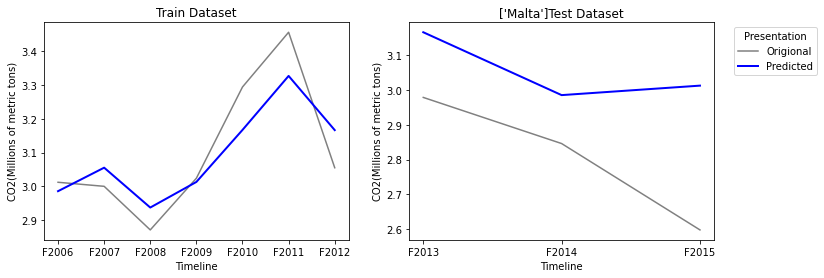

Origional Values:  [array([2.979], dtype=object), array([2.846], dtype=object), array([2.597], dtype=object)]
Predicted Values:  [3.16692 2.98566 3.01299]
Explained Variance Score: 0.42067769996542537
        Maximam Error   : 0.4159900000000003
    Mean Absolute Error : 0.2478566666666667
    Mean Squared Error  : 0.07595550736666674
         r2 score       : -2.029951892613048


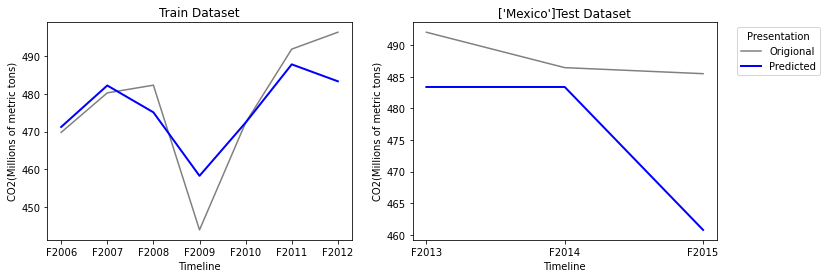

Origional Values:  [array([492.039], dtype=object), array([486.441], dtype=object), array([485.486], dtype=object)]
Predicted Values:  [483.38275 483.38275 460.7755 ]
Explained Variance Score: -9.079558222107591
        Maximam Error   : 24.710499999999513
    Mean Absolute Error : 12.141666666666234
    Mean Squared Error  : 231.63078912498884
         r2 score       : -26.724926634930128


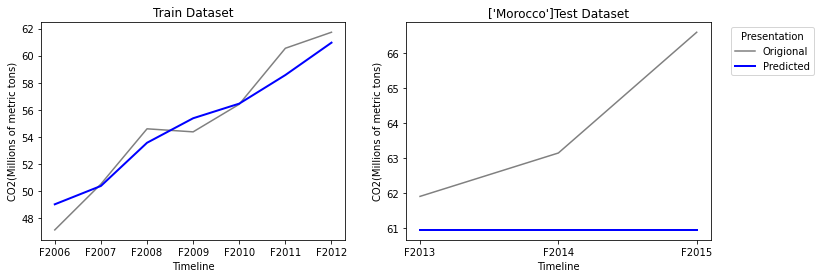

Origional Values:  [array([61.914], dtype=object), array([63.151], dtype=object), array([66.593], dtype=object)]
Predicted Values:  [60.95818 60.95818 60.95818]
Explained Variance Score: 0.0
        Maximam Error   : 5.63482000000004
    Mean Absolute Error : 2.9278200000000396
    Mean Squared Error  : 12.491082619066901
         r2 score       : -2.1873522549307545


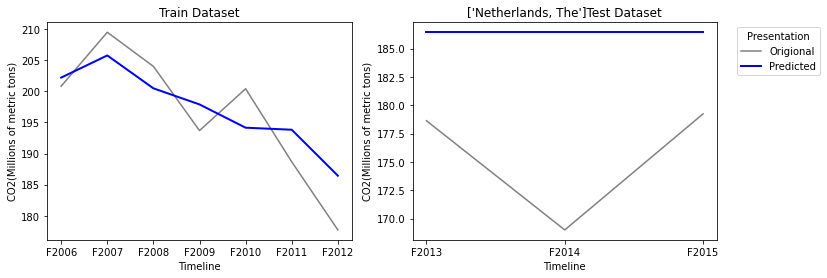

Origional Values:  [array([178.633], dtype=object), array([168.994], dtype=object), array([179.238], dtype=object)]
Predicted Values:  [186.44066 186.44066 186.44066]
Explained Variance Score: 0.0
        Maximam Error   : 17.446659999999923
    Mean Absolute Error : 10.818993333333253
    Mean Squared Error  : 139.0746036355983
         r2 score       : -5.314687905383805


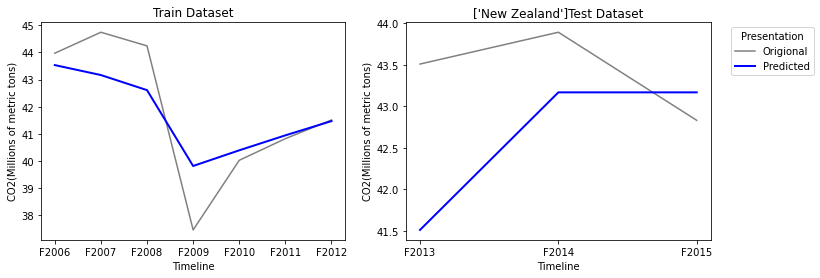

Origional Values:  [array([43.508], dtype=object), array([43.891], dtype=object), array([42.83], dtype=object)]
Predicted Values:  [41.50983 43.16686 43.16686]
Explained Variance Score: -3.7348692055973354
        Maximam Error   : 1.9981700000000089
    Mean Absolute Error : 1.0197233333333362
    Mean Squared Error  : 1.5435122493666835
         r2 score       : -7.020124914871904


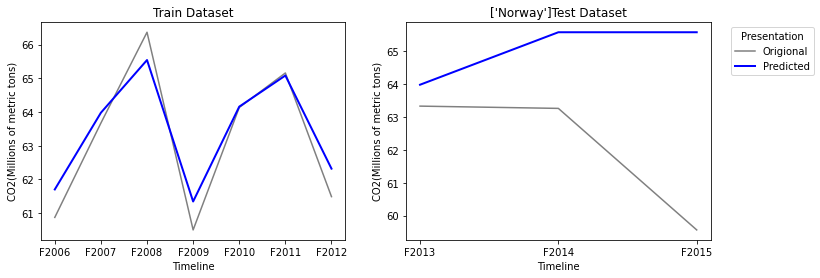

Origional Values:  [array([63.328], dtype=object), array([63.259], dtype=object), array([59.565], dtype=object)]
Predicted Values:  [63.97815 65.57365 65.57365]
Explained Variance Score: -0.6227544056457852
        Maximam Error   : 6.008650000000131
    Mean Absolute Error : 2.9911500000000593
    Mean Squared Error  : 13.961391489167355
         r2 score       : -3.5181577175561944


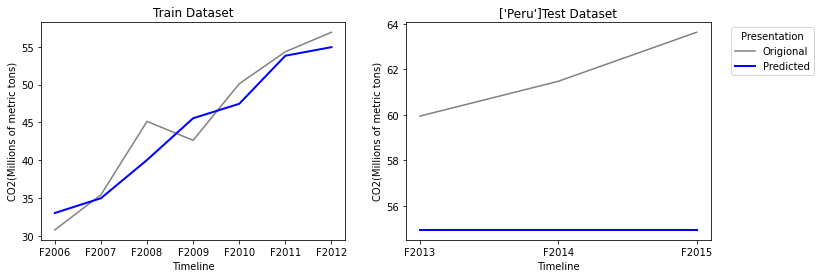

Origional Values:  [array([59.951], dtype=object), array([61.481], dtype=object), array([63.635], dtype=object)]
Predicted Values:  [54.94803 54.94803 54.94803]
Explained Variance Score: 0.0
        Maximam Error   : 8.686969999999938
    Mean Absolute Error : 6.74096999999994
    Mean Squared Error  : 47.72428454089919
         r2 score       : -19.89863257656273


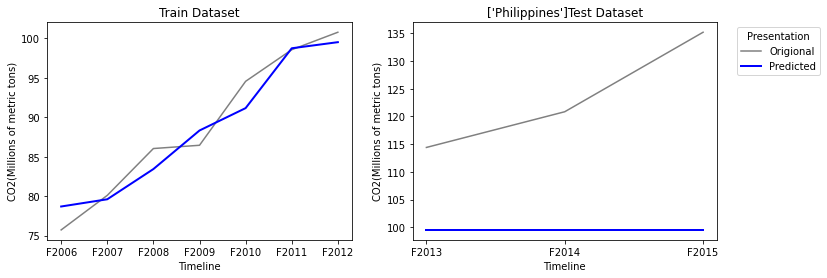

Origional Values:  [array([114.402], dtype=object), array([120.849], dtype=object), array([135.202], dtype=object)]
Predicted Values:  [99.51291 99.51291 99.51291]
Explained Variance Score: 2.220446049250313e-16
        Maximam Error   : 35.68908999999982
    Mean Absolute Error : 23.97142333333316
    Mean Squared Error  : 650.2082941814249
         r2 score       : -7.6030106078316635


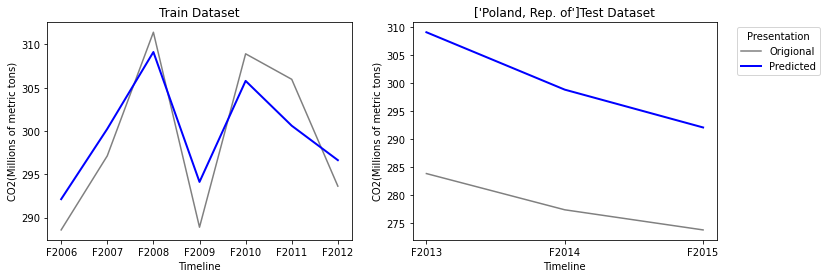

Origional Values:  [array([283.896], dtype=object), array([277.432], dtype=object), array([273.84], dtype=object)]
Predicted Values:  [309.11886 298.87553 292.12593]
Explained Variance Score: 0.5354901248141751
        Maximam Error   : 25.222860000000423
    Mean Absolute Error : 21.65077333333369
    Mean Squared Error  : 476.79762713514884
         r2 score       : -26.541294203228997


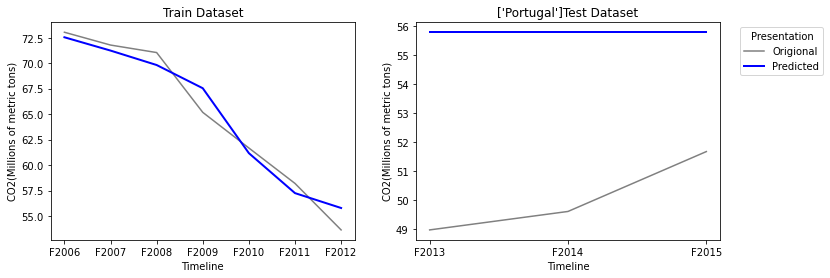

Origional Values:  [array([48.975], dtype=object), array([49.611], dtype=object), array([51.674], dtype=object)]
Predicted Values:  [55.78484 55.78484 55.78484]
Explained Variance Score: 0.0
        Maximam Error   : 6.809839999999902
    Mean Absolute Error : 5.698173333333237
    Mean Squared Error  : 33.79640889226557
         r2 score       : -24.46387604977572


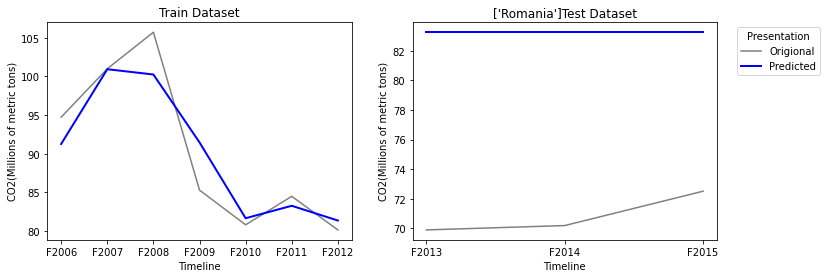

Origional Values:  [array([69.888], dtype=object), array([70.183], dtype=object), array([72.506], dtype=object)]
Predicted Values:  [83.25616 83.25616 83.25616]
Explained Variance Score: 0.0
        Maximam Error   : 13.368160000000032
    Mean Absolute Error : 12.397160000000033
    Mean Squared Error  : 155.06038473226747
         r2 score       : -112.11599386756247


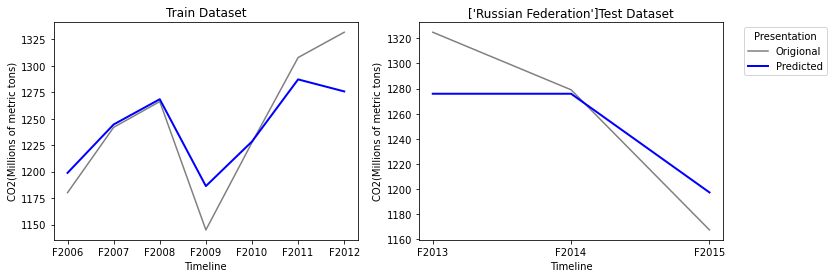

Origional Values:  [array([1324.769], dtype=object), array([1278.977], dtype=object), array([1167.53], dtype=object)]
Predicted Values:  [1275.84838 1275.84838 1197.3529 ]
Explained Variance Score: 0.7608841348979841
        Maximam Error   : 48.92061999999942
    Mean Absolute Error : 27.290713333333162
    Mean Squared Error  : 1097.4735628995911
         r2 score       : 0.7482951438467562


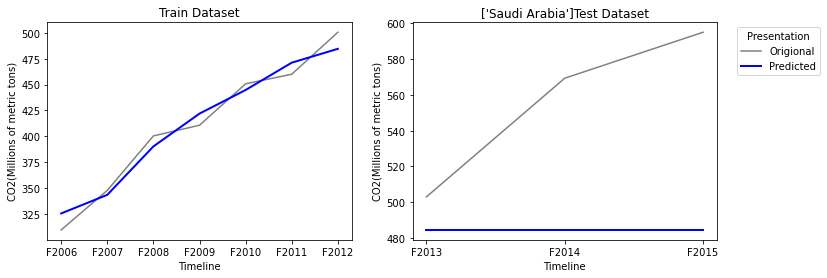

Origional Values:  [array([502.969], dtype=object), array([569.349], dtype=object), array([595.054], dtype=object)]
Predicted Values:  [484.50298 484.50298 484.50298]
Explained Variance Score: 0.0
        Maximam Error   : 110.55102000000011
    Mean Absolute Error : 71.2876866666668
    Mean Squared Error  : 6587.1230091737525
         r2 score       : -3.376277099997628


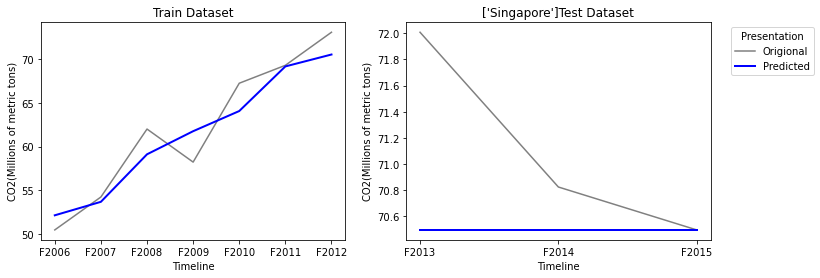

Origional Values:  [array([72.008], dtype=object), array([70.825], dtype=object), array([70.497], dtype=object)]
Predicted Values:  [70.49889 70.49889 70.49889]
Explained Variance Score: 0.0
        Maximam Error   : 1.509110000000021
    Mean Absolute Error : 0.612370000000008
    Mean Squared Error  : 0.7945880987666939
         r2 score       : -0.8867880876019267


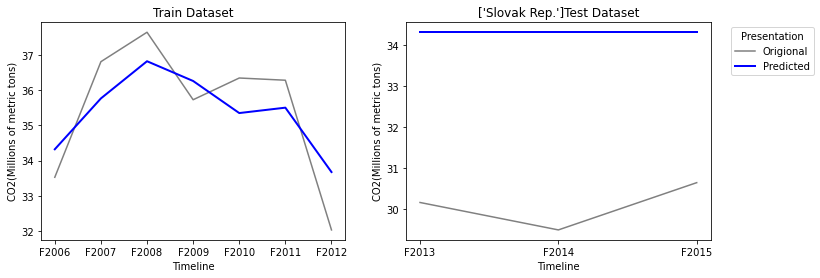

Origional Values:  [array([30.164], dtype=object), array([29.494], dtype=object), array([30.648], dtype=object)]
Predicted Values:  [34.32075 34.32075 34.32075]
Explained Variance Score: 0.0
        Maximam Error   : 4.826749999999969
    Mean Absolute Error : 4.218749999999968
    Mean Squared Error  : 18.021726229166397
         r2 score       : -79.49917615734277


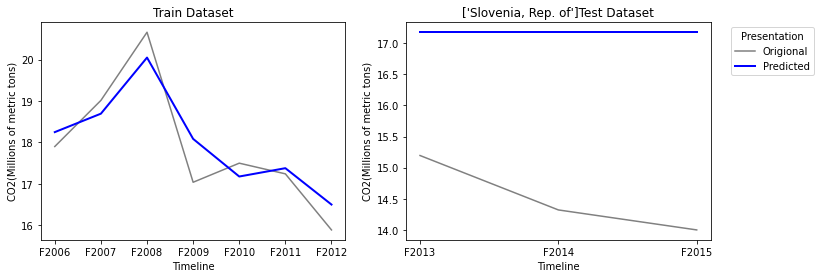

Origional Values:  [array([15.195], dtype=object), array([14.321], dtype=object), array([14.0], dtype=object)]
Predicted Values:  [17.17476 17.17476 17.17476]
Explained Variance Score: 0.0
        Maximam Error   : 3.1747600000000133
    Mean Absolute Error : 2.66942666666668
    Mean Squared Error  : 7.380832284266738
         r2 score       : -27.945171842425907


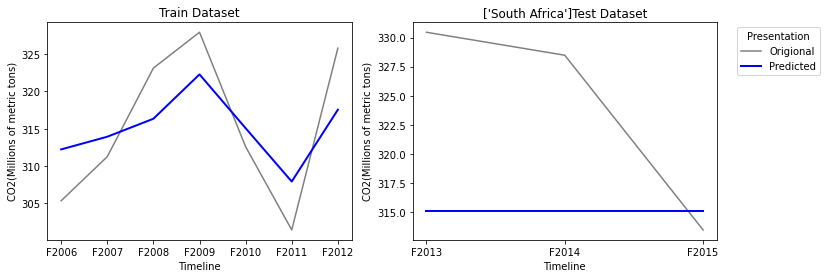

Origional Values:  [array([330.458], dtype=object), array([328.481], dtype=object), array([313.451], dtype=object)]
Predicted Values:  [315.07176 315.07176 315.07176]
Explained Variance Score: 0.0
        Maximam Error   : 15.386239999999646
    Mean Absolute Error : 10.13874666666654
    Mean Squared Error  : 139.7236538975933
         r2 score       : -1.4227319048419322


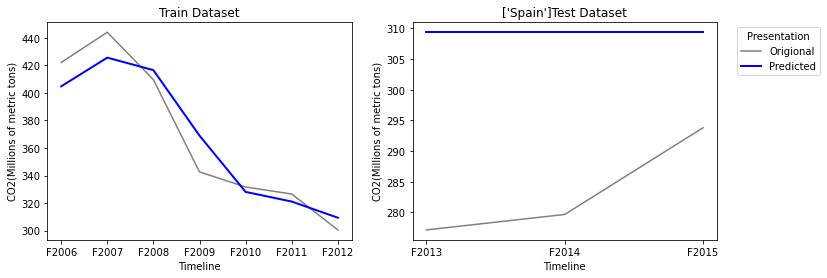

Origional Values:  [array([277.159], dtype=object), array([279.68], dtype=object), array([293.817], dtype=object)]
Predicted Values:  [309.38435 309.38435 309.38435]
Explained Variance Score: 0.0
        Maximam Error   : 32.22534999999954
    Mean Absolute Error : 25.832349999999526
    Mean Squared Error  : 721.0546591891424
         r2 score       : -12.41638001784612


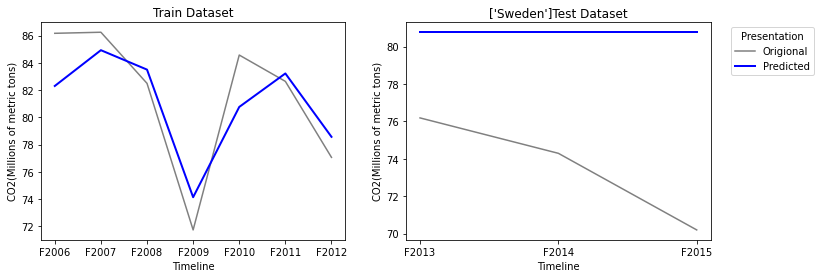

Origional Values:  [array([76.184], dtype=object), array([74.291], dtype=object), array([70.196], dtype=object)]
Predicted Values:  [80.76352 80.76352 80.76352]
Explained Variance Score: 0.0
        Maximam Error   : 10.567519999999988
    Mean Absolute Error : 7.206519999999988
    Mean Squared Error  : 58.17933251039983
         r2 score       : -8.315546462885791


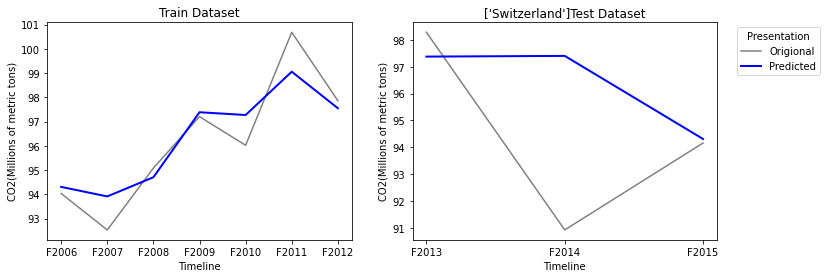

Origional Values:  [array([98.287], dtype=object), array([90.92], dtype=object), array([94.16], dtype=object)]
Predicted Values:  [97.37921 97.40557 94.30818]
Explained Variance Score: -0.17281810352597682
        Maximam Error   : 6.485569999999953
    Mean Absolute Error : 2.513846666666685
    Mean Squared Error  : 14.302886073799838
         r2 score       : -0.5736206558612775


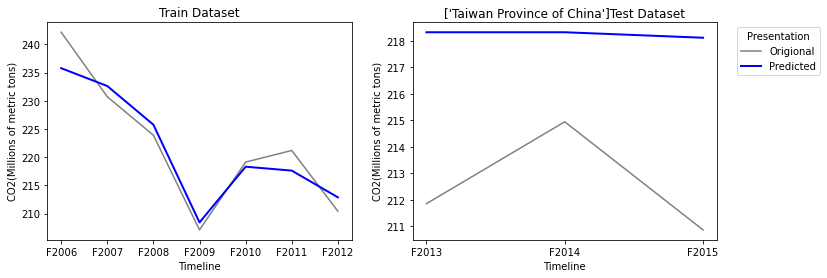

Origional Values:  [array([211.848], dtype=object), array([214.94], dtype=object), array([210.858], dtype=object)]
Predicted Values:  [218.32003 218.32003 218.11248]
Explained Variance Score: 0.07422754172211321
        Maximam Error   : 7.2544800000001715
    Mean Absolute Error : 5.702180000000074
    Mean Squared Error  : 35.31308506406765
         r2 score       : -10.683064399296525


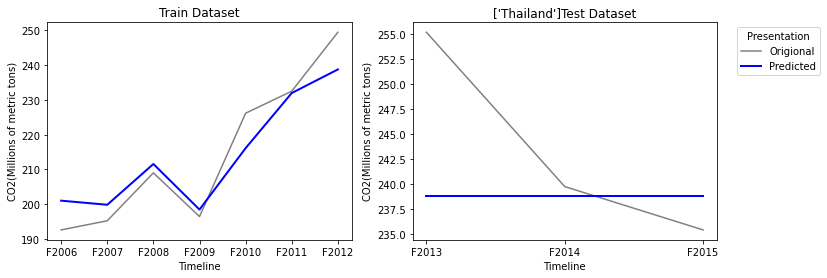

Origional Values:  [array([255.149], dtype=object), array([239.72], dtype=object), array([235.388], dtype=object)]
Predicted Values:  [238.75499 238.75499 238.75499]
Explained Variance Score: 0.0
        Maximam Error   : 16.394009999999554
    Mean Absolute Error : 6.908669999999849
    Mean Squared Error  : 93.67714328009583
         r2 score       : -0.3024434500834845


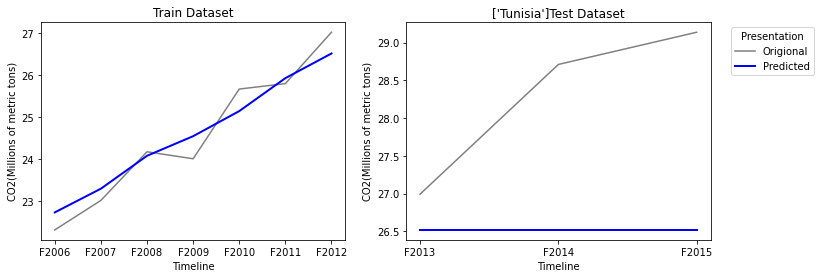

Origional Values:  [array([26.991], dtype=object), array([28.711], dtype=object), array([29.138], dtype=object)]
Predicted Values:  [26.51741 26.51741 26.51741]
Explained Variance Score: 0.0
        Maximam Error   : 2.6205899999999964
    Mean Absolute Error : 1.7625899999999948
    Mean Squared Error  : 3.9678721747666486
         r2 score       : -3.607650604773598


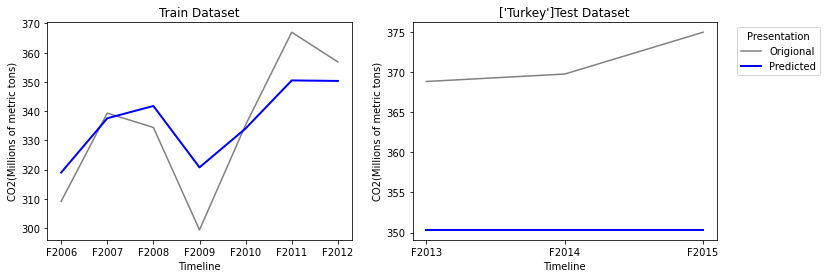

Origional Values:  [array([368.813], dtype=object), array([369.74], dtype=object), array([374.947], dtype=object)]
Predicted Values:  [350.32522 350.32522 350.32522]
Explained Variance Score: 0.0
        Maximam Error   : 24.62177999999966
    Mean Absolute Error : 20.841446666666325
    Mean Squared Error  : 441.65458071505236
         r2 score       : -59.59457768166793


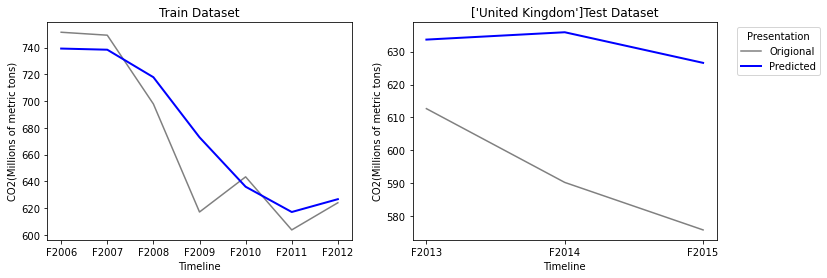

Origional Values:  [array([612.671], dtype=object), array([590.239], dtype=object), array([575.797], dtype=object)]
Predicted Values:  [633.66782 635.90291 626.59235]
Explained Variance Score: 0.2648899974425639
        Maximam Error   : 50.79535000000044
    Mean Absolute Error : 39.15202666666661
    Mean Squared Error  : 1702.0755694076688
         r2 score       : -6.395120311589886


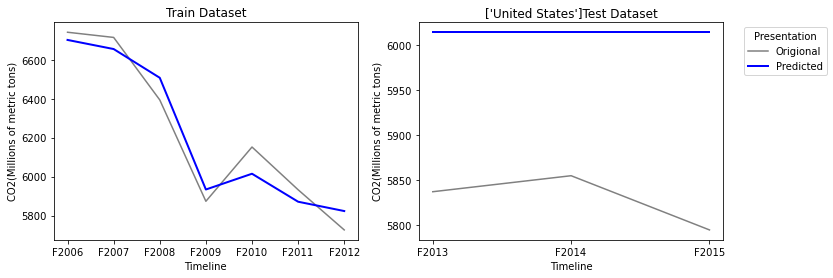

Origional Values:  [array([5837.047], dtype=object), array([5854.868], dtype=object), array([5794.513], dtype=object)]
Predicted Values:  [6014.63618 6014.63618 6014.63618]
Explained Variance Score: 0.0
        Maximam Error   : 220.1231800000014
    Mean Absolute Error : 185.82684666666805
    Mean Squared Error  : 35172.66752229958
         r2 score       : -53.867226717284176


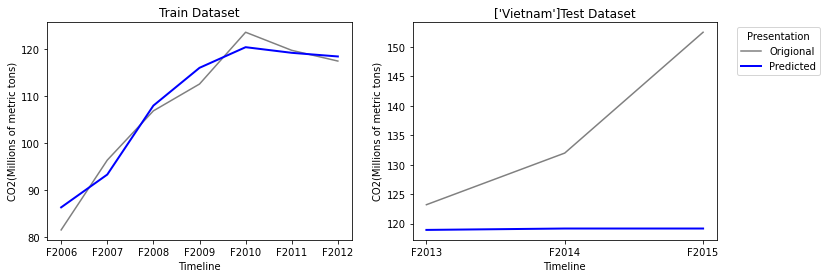

Origional Values:  [array([123.209], dtype=object), array([131.967], dtype=object), array([152.455], dtype=object)]
Predicted Values:  [118.93583 119.17221 119.17221]
Explained Variance Score: 0.0132084349499062
        Maximam Error   : 33.282790000000205
    Mean Absolute Error : 16.783583333333482
    Mean Squared Error  : 429.9035810590397
         r2 score       : -1.862230413468184


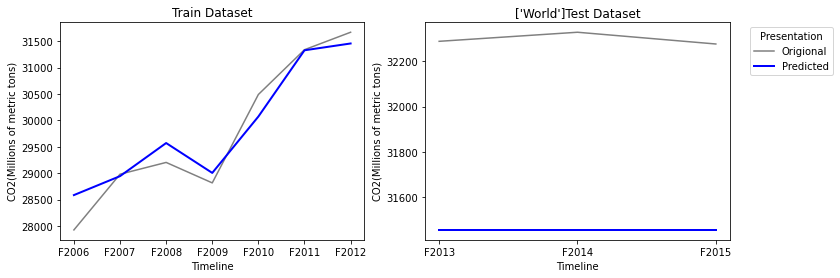

Origional Values:  [array([32287.8], dtype=object), array([32327.8], dtype=object), array([32276.0], dtype=object)]
Predicted Values:  [31456.338 31456.338 31456.338]
Explained Variance Score: 2.220446049250313e-16
        Maximam Error   : 871.4619999999959
    Mean Absolute Error : 840.8619999999961
    Mean Squared Error  : 707540.2897106601
         r2 score       : -1438.8849983258428


In [18]:
i=0
VVIP2=list()
while i<len(CO2_FINAL_DF_FINAL.T):
    series=CO2_FINAL_DF_FINAL[CO2_FINAL_DF_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    # Splitting the data into Train & Test
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=3,shuffle=False)
    # Fitting the model on Train dataset
    Model = RandomForestRegressor()
    Model = Model.fit(X_train, y_train)
    # Predicting and storing results for Test dataset
    train_fit = Model.predict(X_train)
    test_pred = Model.predict(X_test)
    plt.figure(figsize=(12,4))
    # Plotting Regression line on Train Dataset
    plt.subplot(1,2,1)
    plt.plot(y_train, color='gray')
    plt.plot(y_train.index,train_fit, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title("Train Dataset")
    # Plotting Regression line on Test Dataset
    plt.subplot(1,2,2)
    plt.plot(y_test, color='gray')
    plt.plot(y_test.index,test_pred, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title(str(X.columns.values)+"Test Dataset")
    plt.legend(['Origional','Predicted'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()
    pre=test_pred
    y_test=y_test
    y_test=np.array(y_test)
    VVIP2.append(pre)
    exp_rf=explained_variance_score(y_test,pre)
    mxer_rf=max_error(y_test,pre)
    mae_rf=mean_absolute_error(y_test,pre)
    mse_rf=mean_squared_error(y_test,pre)
    r2_rf=r2_score(y_test,pre)
    print("Origional Values: " , list(y_test))
    print("Predicted Values: " , pre)
    print("Explained Variance Score:",exp_rf)
    print("        Maximam Error   :",mxer_rf)
    print("    Mean Absolute Error :",mae_rf)
    print("    Mean Squared Error  :",mse_rf)
    print("         r2 score       :",r2_rf)
    i=i+1

### MLP Regression

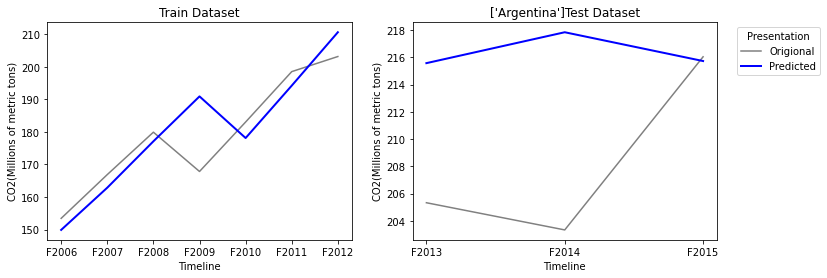

Origional Values:  [array([205.328], dtype=object), array([203.334], dtype=object), array([216.033], dtype=object)]
Predicted Values:  [215.56700541 217.83381547 215.72165694]
Explained Variance Score: -0.2465612019558483
        Maximam Error   : 14.499815469633205
    Mean Absolute Error : 8.350054647418185
    Mean Squared Error  : 105.0596049859563
         r2 score       : -2.3788748737959695


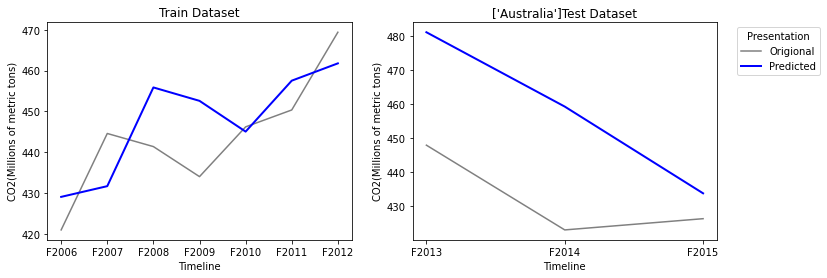

Origional Values:  [array([448.017], dtype=object), array([423.099], dtype=object), array([426.401], dtype=object)]
Predicted Values:  [481.22675449 459.36827336 433.86159392]
Explained Variance Score: -0.36691176569001227
        Maximam Error   : 36.269273364554635
    Mean Absolute Error : 25.64654059400853
    Mean Squared Error  : 824.6694818851441
         r2 score       : -5.753058059372504


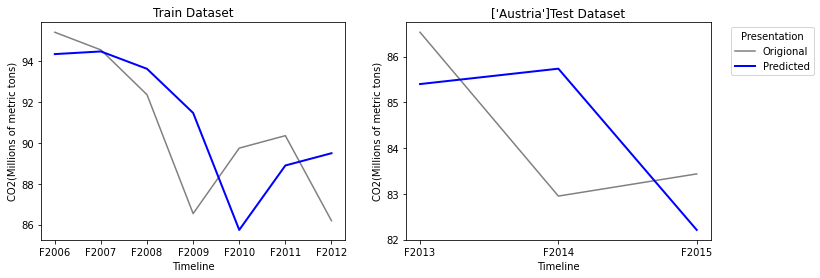

Origional Values:  [array([86.533], dtype=object), array([82.95], dtype=object), array([83.435], dtype=object)]
Predicted Values:  [85.3996316  85.73620103 82.21009496]
Explained Variance Score: -0.3877097063294528
        Maximam Error   : 2.786201033882861
    Mean Absolute Error : 1.7148248237294628
    Mean Squared Error  : 3.5159441606633632
         r2 score       : -0.39578717559674526


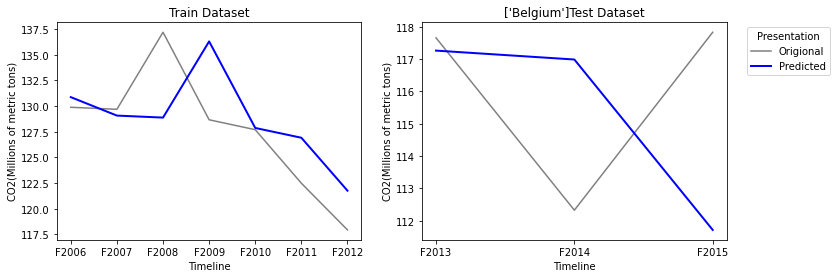

Origional Values:  [array([117.656], dtype=object), array([112.33], dtype=object), array([117.828], dtype=object)]
Predicted Values:  [117.26038918 116.98555764 111.72025984]
Explained Variance Score: -1.9679262333356422
        Maximam Error   : 6.107740160008547
    Mean Absolute Error : 3.7196362063116055
    Mean Squared Error  : 19.711738233957973
         r2 score       : -2.026167707157982


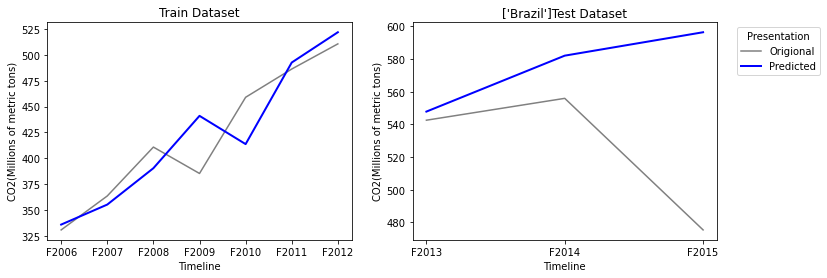

Origional Values:  [array([542.574], dtype=object), array([555.957], dtype=object), array([475.385], dtype=object)]
Predicted Values:  [547.84638085 582.10580262 596.44000638]
Explained Variance Score: -1.042734759429882
        Maximam Error   : 121.05500638193894
    Mean Absolute Error : 50.82539661712766
    Mean Squared Error  : 5121.95748279804
         r2 score       : -3.1212628468378343


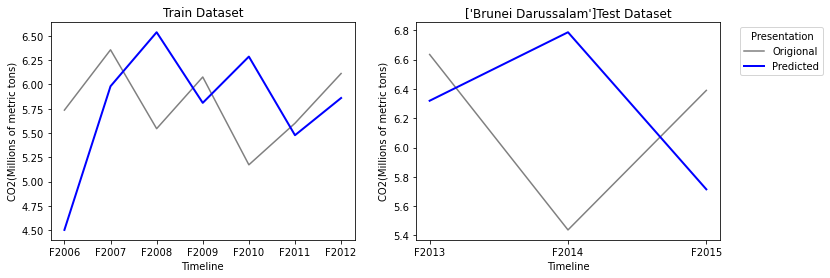

Origional Values:  [array([6.635], dtype=object), array([5.438], dtype=object), array([6.39], dtype=object)]
Predicted Values:  [6.31935121 6.7867617  5.71494111]
Explained Variance Score: -1.9157504322342538
        Maximam Error   : 1.3487616953866235
    Mean Absolute Error : 0.779823125776525
    Mean Squared Error  : 0.7914989263369718
         r2 score       : -1.9691874069072917


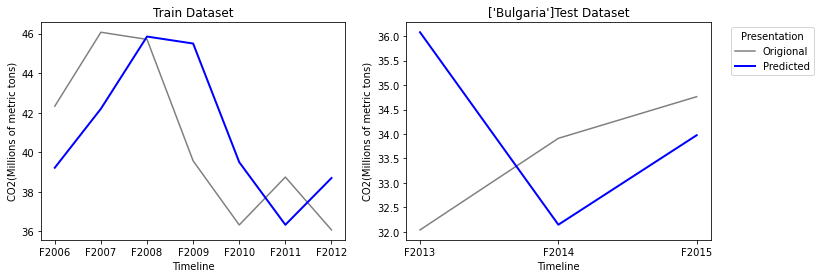

Origional Values:  [array([32.037], dtype=object), array([33.911], dtype=object), array([34.763], dtype=object)]
Predicted Values:  [36.08078286 32.14383414 33.9746842 ]
Explained Variance Score: -3.9768760609458615
        Maximam Error   : 4.043782864939956
    Mean Absolute Error : 2.1997548435352265
    Mean Squared Error  : 6.698832282753956
         r2 score       : -4.166701049767484


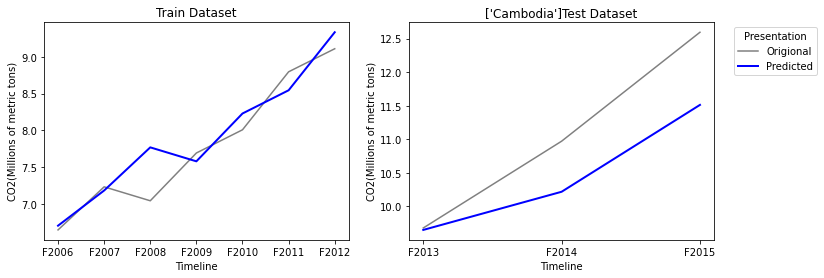

Origional Values:  [array([9.679], dtype=object), array([10.972], dtype=object), array([12.595], dtype=object)]
Predicted Values:  [ 9.65014052 10.21862632 11.51273219]
Explained Variance Score: 0.8639428017211536
        Maximam Error   : 1.0822678052192956
    Mean Absolute Error : 0.6215003209932762
    Mean Squared Error  : 0.579902791072355
         r2 score       : 0.5925434252379068


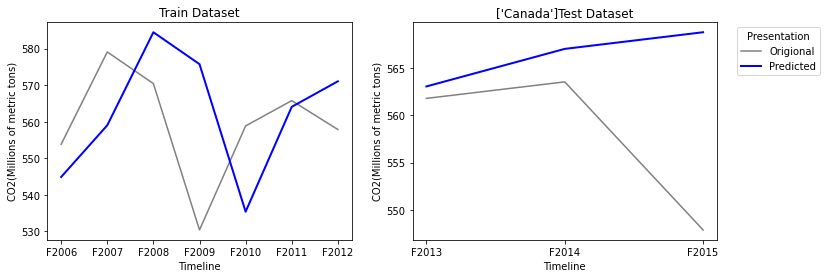

Origional Values:  [array([561.804], dtype=object), array([563.554], dtype=object), array([547.864], dtype=object)]
Predicted Values:  [563.07055389 567.05020387 568.81468005]
Explained Variance Score: -0.5715831968923515
        Maximam Error   : 20.95068004897928
    Mean Absolute Error : 8.571145937031133
    Mean Squared Error  : 150.91953159572964
         r2 score       : -2.0621991332029133


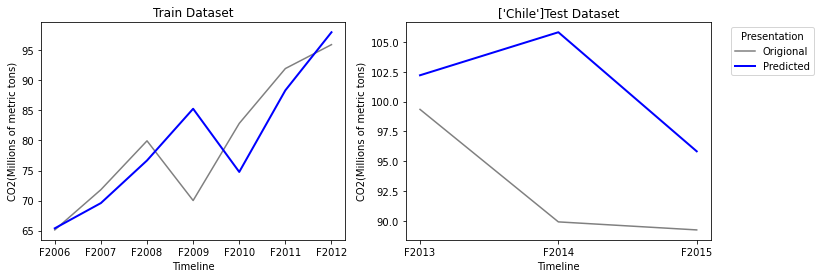

Origional Values:  [array([99.348], dtype=object), array([89.911], dtype=object), array([89.237], dtype=object)]
Predicted Values:  [102.21139407 105.82129494  95.83107955]
Explained Variance Score: -0.41298876945036644
        Maximam Error   : 15.910294937375113
    Mean Absolute Error : 8.45592285518901
    Mean Squared Error  : 101.60613192983733
         r2 score       : -3.769157090614116


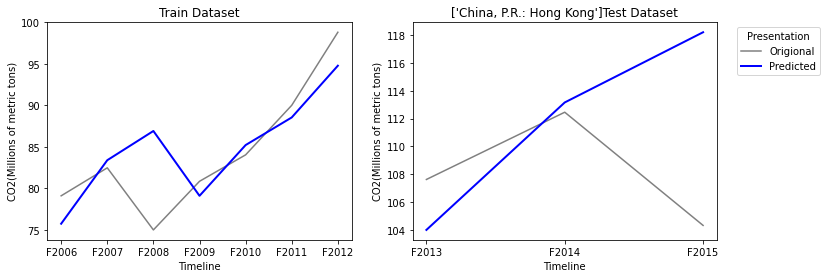

Origional Values:  [array([107.616], dtype=object), array([112.459], dtype=object), array([104.308], dtype=object)]
Predicted Values:  [103.98335232 113.1624363  118.21800393]
Explained Variance Score: -3.9680483009760543
        Maximam Error   : 13.910003932117661
    Mean Absolute Error : 6.08202930404768
    Mean Squared Error  : 69.05972039422424
         r2 score       : -5.1638258965715345


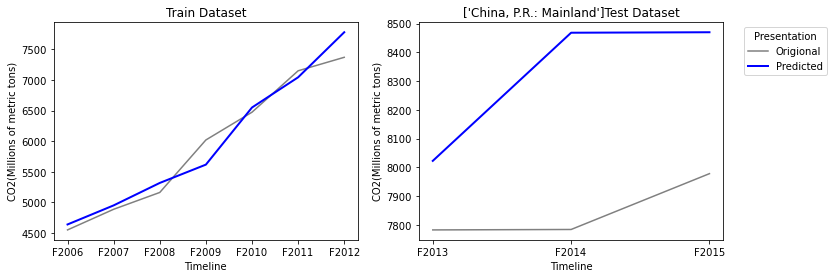

Origional Values:  [array([7782.052], dtype=object), array([7783.586], dtype=object), array([7977.936], dtype=object)]
Predicted Values:  [8022.3585044  8468.4142069  8470.08335633]
Explained Variance Score: -2.9155556502007136
        Maximam Error   : 684.828206903002
    Mean Absolute Error : 472.4273558778289
    Mean Squared Error  : 256315.30312353803
         r2 score       : -29.29540046985422


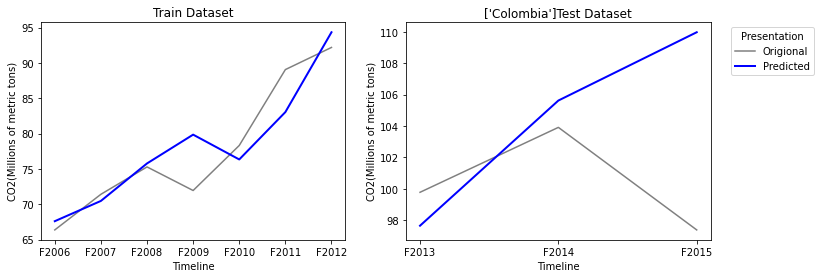

Origional Values:  [array([99.774], dtype=object), array([103.908], dtype=object), array([97.378], dtype=object)]
Predicted Values:  [ 97.64640582 105.61703025 109.96636517]
Explained Variance Score: -4.340310763652383
        Maximam Error   : 12.588365167977571
    Mean Absolute Error : 5.4749965301909596
    Mean Squared Error  : 55.30479298790829
         r2 score       : -6.602419820455701


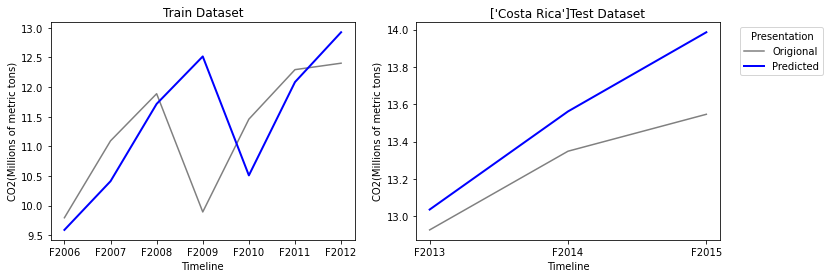

Origional Values:  [array([12.926], dtype=object), array([13.348], dtype=object), array([13.546], dtype=object)]
Predicted Values:  [13.03512532 13.56131885 13.98589565]
Explained Variance Score: 0.7147984445635254
        Maximam Error   : 0.43989565131137454
    Mean Absolute Error : 0.25411327179957627
    Mean Squared Error  : 0.0836404830699588
         r2 score       : -0.2510875198269378


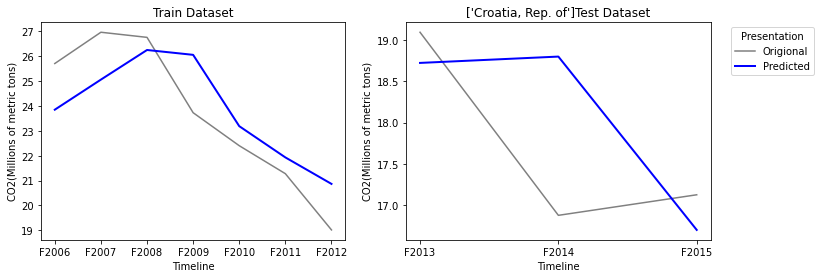

Origional Values:  [array([19.095], dtype=object), array([16.877], dtype=object), array([17.126], dtype=object)]
Predicted Values:  [18.72347447 18.80015846 16.70034268]
Explained Variance Score: -0.21752638132896474
        Maximam Error   : 1.9231584587043713
    Mean Absolute Error : 0.9067804349405565
    Mean Squared Error  : 1.3392512759749025
         r2 score       : -0.3606457676598611


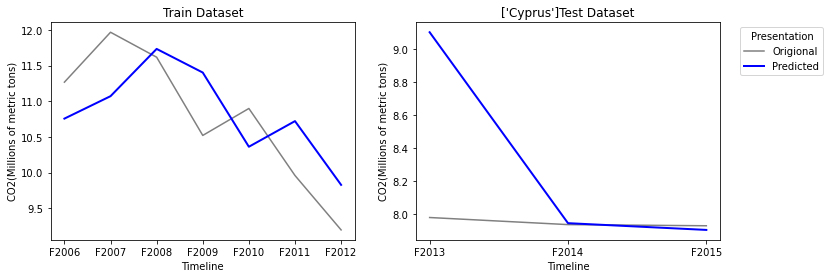

Origional Values:  [array([7.979], dtype=object), array([7.936], dtype=object), array([7.929], dtype=object)]
Predicted Values:  [9.10215    7.94471742 7.90382212]
Explained Variance Score: -581.4842640919936
        Maximam Error   : 1.1231500006684572
    Mean Absolute Error : 0.38568176561163625
    Mean Squared Error  : 0.4207252809847997
         r2 score       : -859.9657864627571


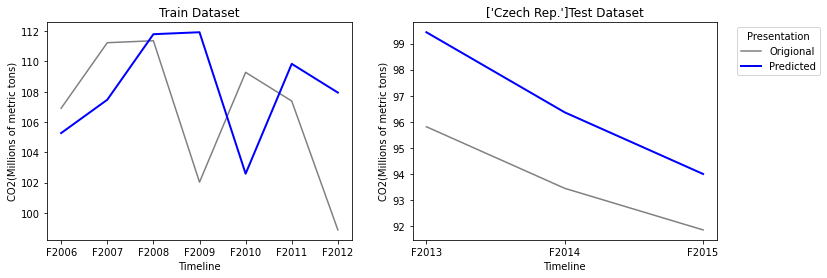

Origional Values:  [array([95.808], dtype=object), array([93.444], dtype=object), array([91.848], dtype=object)]
Predicted Values:  [99.43497098 96.36019656 93.99483154]
Explained Variance Score: 0.8619518620508313
        Maximam Error   : 3.6269709806160364
    Mean Absolute Error : 2.896666361978594
    Mean Squared Error  : 8.756002187346569
         r2 score       : -2.3086865422142857


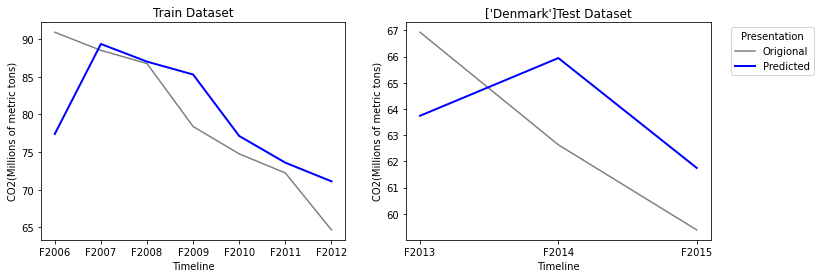

Origional Values:  [array([66.926], dtype=object), array([62.631], dtype=object), array([59.383], dtype=object)]
Predicted Values:  [63.7381317  65.94127989 61.74875819]
Explained Variance Score: 0.13892292891766433
        Maximam Error   : 3.310279892506472
    Mean Absolute Error : 2.9546354601016156
    Mean Squared Error  : 8.905756356195383
         r2 score       : 0.0668453253083322


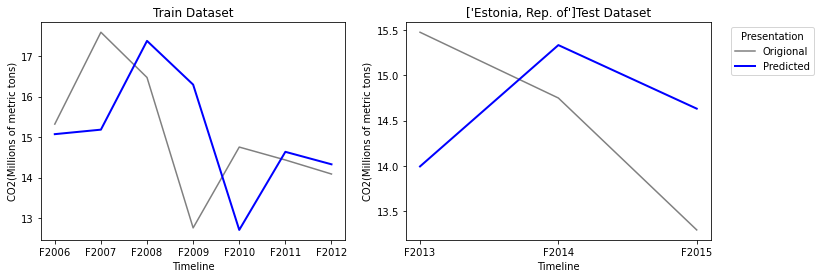

Origional Values:  [array([15.476], dtype=object), array([14.749], dtype=object), array([13.291], dtype=object)]
Predicted Values:  [13.99277392 15.3339243  14.63145   ]
Explained Variance Score: -0.7259447591724015
        Maximam Error   : 1.4832260799542443
    Mean Absolute Error : 1.1362001282252894
    Mean Squared Error  : 1.4463007514647552
         r2 score       : -0.7522615901560434


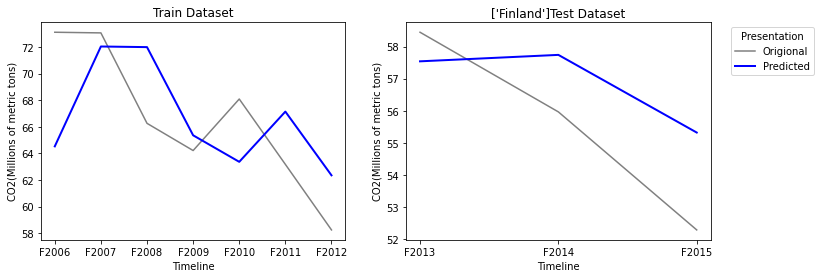

Origional Values:  [array([58.446], dtype=object), array([55.964], dtype=object), array([52.286], dtype=object)]
Predicted Values:  [57.53969341 57.74054537 55.32057179]
Explained Variance Score: 0.5781827937228889
        Maximam Error   : 3.0345717915115102
    Mean Absolute Error : 1.9058079160963288
    Mean Squared Error  : 4.395377011655326
         r2 score       : 0.3136228239450499


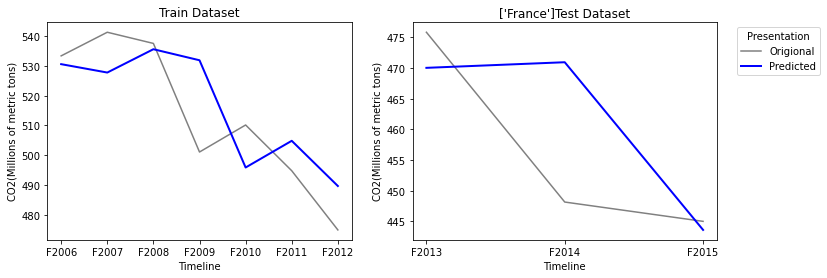

Origional Values:  [array([475.829], dtype=object), array([448.16], dtype=object), array([445.014], dtype=object)]
Predicted Values:  [470.02834171 470.94180584 443.61787184]
Explained Variance Score: 0.17628943764074945
        Maximam Error   : 22.781805840774496
    Mean Absolute Error : 9.992864097224412
    Mean Squared Error  : 184.86916259340765
         r2 score       : 0.035484865547582456


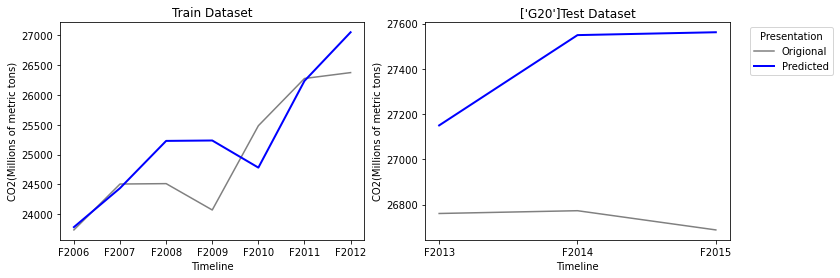

Origional Values:  [array([26760.591], dtype=object), array([26772.893], dtype=object), array([26687.974], dtype=object)]
Predicted Values:  [27150.00754148 27549.19795709 27561.86217171]
Explained Variance Score: -30.174737773759247
        Maximam Error   : 873.8881717072873
    Mean Absolute Error : 679.869890092507
    Mean Squared Error  : 505991.72194483835
         r2 score       : -359.39854162682497


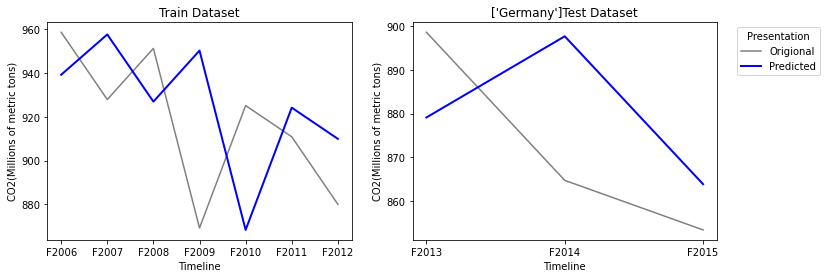

Origional Values:  [array([898.539], dtype=object), array([864.752], dtype=object), array([853.444], dtype=object)]
Predicted Values:  [879.09543563 897.61670009 863.88203905]
Explained Variance Score: -0.25099328335299975
        Maximam Error   : 32.86470008890501
    Mean Absolute Error : 20.915434503491195
    Mean Squared Error  : 522.3644555167008
         r2 score       : -0.42334015818648596


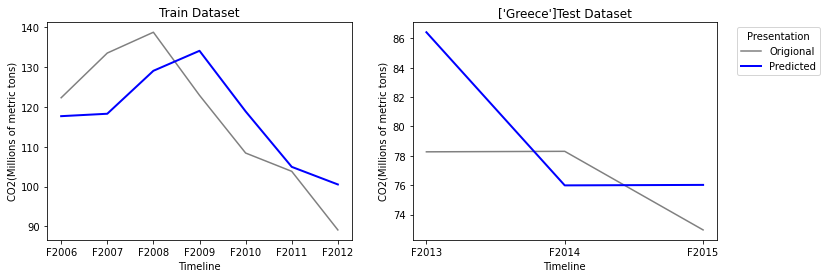

Origional Values:  [array([78.272], dtype=object), array([78.306], dtype=object), array([72.95], dtype=object)]
Predicted Values:  [86.42189859 75.98552351 76.01818822]
Explained Variance Score: -1.8852077697425367
        Maximam Error   : 8.149898591760731
    Mean Absolute Error : 4.51285443416819
    Mean Squared Error  : 27.07307905106387
         r2 score       : -3.2738287301437685


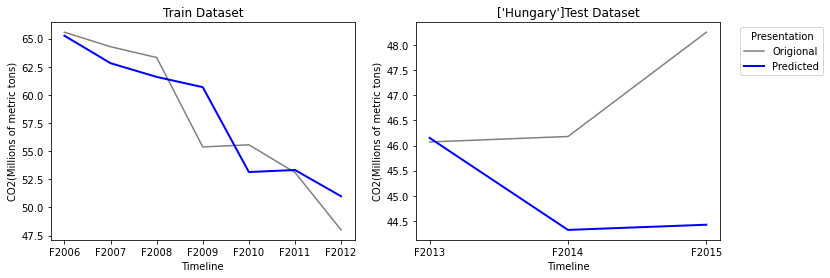

Origional Values:  [array([46.072], dtype=object), array([46.181], dtype=object), array([48.26], dtype=object)]
Predicted Values:  [46.1525345  44.31799181 44.4214399 ]
Explained Variance Score: -1.5258512152050994
        Maximam Error   : 3.8385601006554353
    Mean Absolute Error : 1.927367594800084
    Mean Squared Error  : 6.070609653111386
         r2 score       : -4.989770380989479


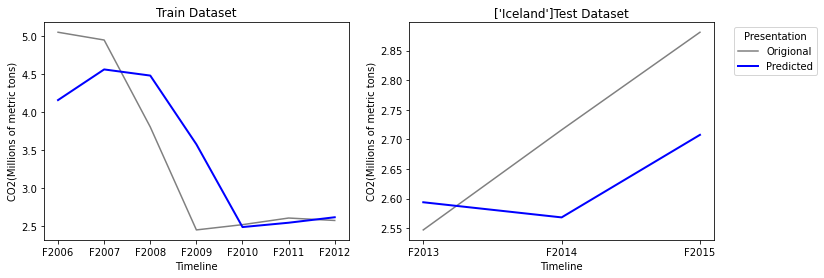

Origional Values:  [array([2.547], dtype=object), array([2.716], dtype=object), array([2.881], dtype=object)]
Predicted Values:  [2.59373352 2.56814613 2.70763869]
Explained Variance Score: 0.4803658580265773
        Maximam Error   : 0.17336130695776086
    Mean Absolute Error : 0.12264956683902477
    Mean Squared Error  : 0.018032977407203814
         r2 score       : 0.03014905603593443


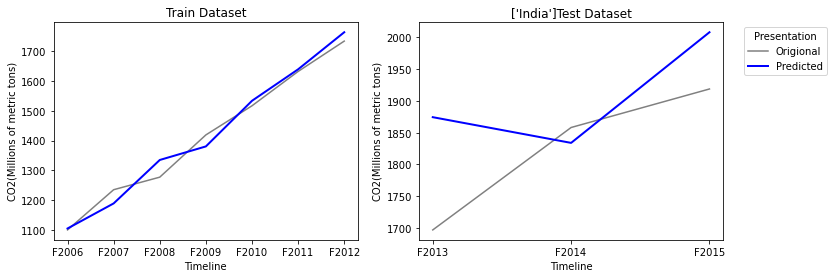

Origional Values:  [array([1696.941], dtype=object), array([1858.186], dtype=object), array([1918.813], dtype=object)]
Predicted Values:  [1874.42324903 1833.94558719 2008.12883782]
Explained Variance Score: 0.2223293004542123
        Maximam Error   : 177.4822490337467
    Mean Absolute Error : 97.01283322357176
    Mean Squared Error  : 13354.955073835547
         r2 score       : -0.5233254727932519


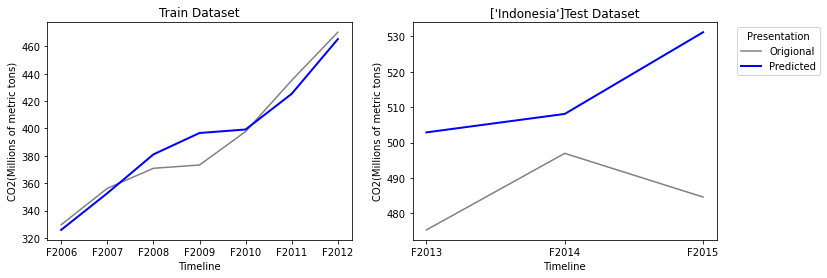

Origional Values:  [array([475.289], dtype=object), array([496.938], dtype=object), array([484.588], dtype=object)]
Predicted Values:  [502.87135005 508.08965567 531.18740631]
Explained Variance Score: -1.6681234134985683
        Maximam Error   : 46.59940631195269
    Mean Absolute Error : 28.444470675013367
    Mean Squared Error  : 1018.883375598291
         r2 score       : -11.95789023840081


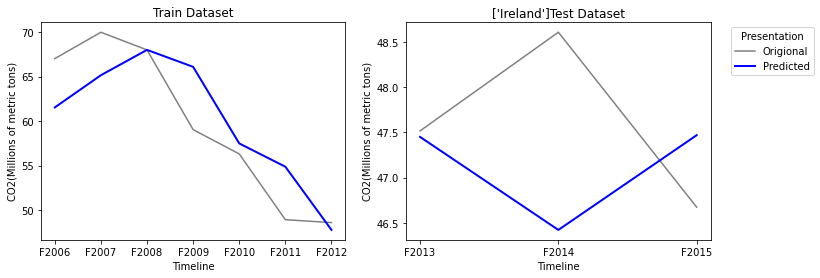

Origional Values:  [array([47.516], dtype=object), array([48.607], dtype=object), array([46.672], dtype=object)]
Predicted Values:  [47.44965612 46.42098179 47.46886572]
Explained Variance Score: -1.5033012565385002
        Maximam Error   : 2.1860182131608
    Mean Absolute Error : 1.016409272621516
    Mean Squared Error  : 1.8060240400097654
         r2 score       : -1.8784613346872194


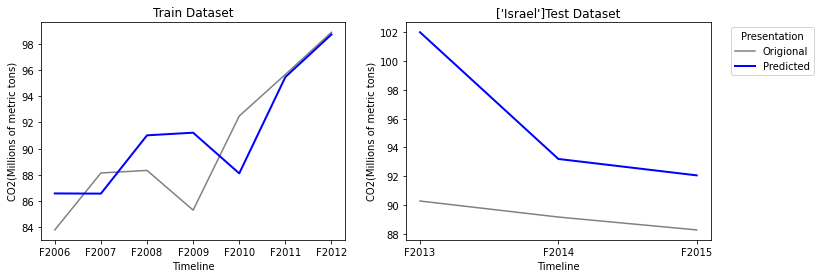

Origional Values:  [array([90.278], dtype=object), array([89.165], dtype=object), array([88.27], dtype=object)]
Predicted Values:  [102.01134664  93.20204664  92.06262178]
Explained Variance Score: -19.149991749799007
        Maximam Error   : 11.733346643372201
    Mean Absolute Error : 6.521005021179202
    Mean Squared Error  : 56.11771633135016
         r2 score       : -82.18037855663732


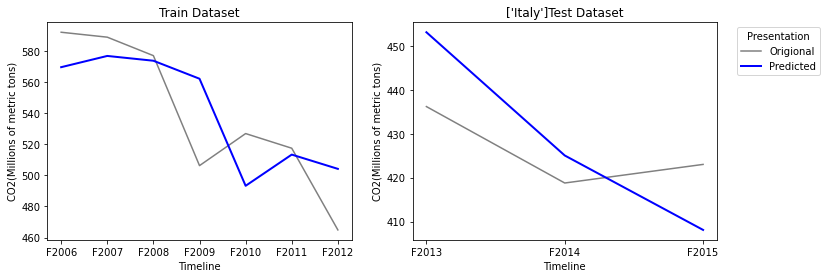

Origional Values:  [array([436.164], dtype=object), array([418.783], dtype=object), array([423.012], dtype=object)]
Predicted Values:  [453.06142583 425.04292303 408.11887101]
Explained Variance Score: -2.187381483283472
        Maximam Error   : 16.89742582763921
    Mean Absolute Error : 12.683492618052165
    Mean Squared Error  : 182.17164239556038
         r2 score       : -2.325927225961292


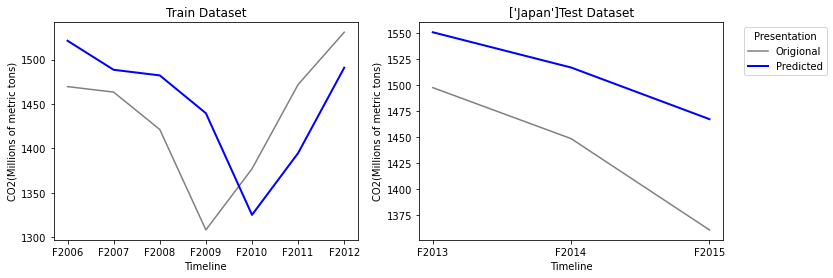

Origional Values:  [array([1497.445], dtype=object), array([1448.543], dtype=object), array([1361.019], dtype=object)]
Predicted Values:  [1550.54364466 1516.71444549 1467.21516368]
Explained Variance Score: 0.8432727741083033
        Maximam Error   : 106.19616367769117
    Mean Absolute Error : 75.82208461118792
    Mean Squared Error  : 6248.145741852262
         r2 score       : -0.9618158287384753


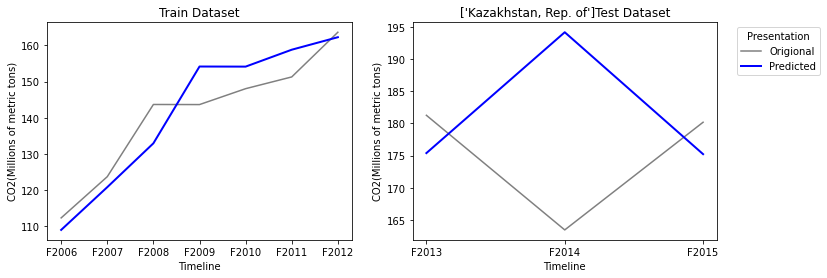

Origional Values:  [array([181.262], dtype=object), array([163.473], dtype=object), array([180.186], dtype=object)]
Predicted Values:  [175.39760688 194.15498916 175.23380552]
Explained Variance Score: -3.3661104315310597
        Maximam Error   : 30.681989158417252
    Mean Absolute Error : 13.832858920075134
    Mean Squared Error  : 333.43326519207864
         r2 score       : -4.027215986133824


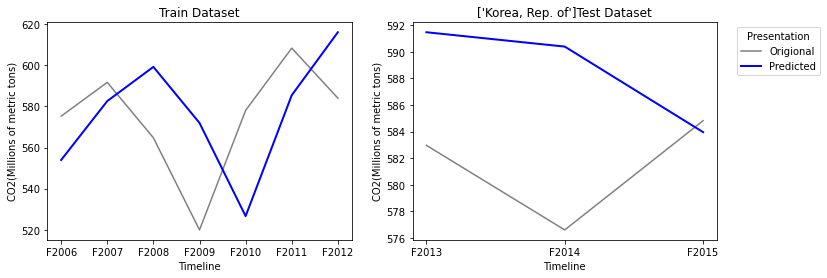

Origional Values:  [array([582.966], dtype=object), array([576.605], dtype=object), array([584.818], dtype=object)]
Predicted Values:  [591.47226669 590.39300189 583.95888439]
Explained Variance Score: -1.9650491933527778
        Maximam Error   : 13.788001892818556
    Mean Absolute Error : 7.717794732178921
    Mean Squared Error  : 87.73454961499505
         r2 score       : -6.091532930660561


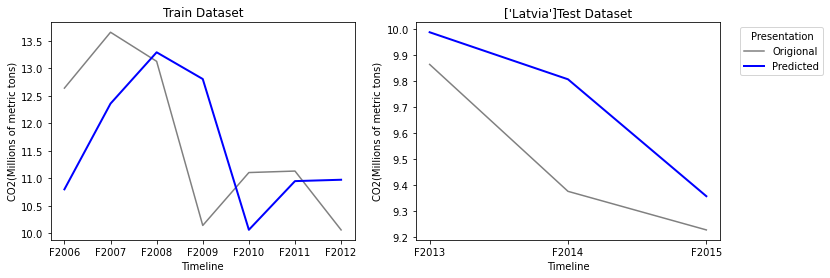

Origional Values:  [array([9.864], dtype=object), array([9.377], dtype=object), array([9.229], dtype=object)]
Predicted Values:  [9.98741846 9.80689688 9.35835604]
Explained Variance Score: 0.7217429591526063
        Maximam Error   : 0.4298968846173281
    Mean Absolute Error : 0.227557126708005
    Mean Squared Error  : 0.07225881054217502
         r2 score       : 0.018071480089668523


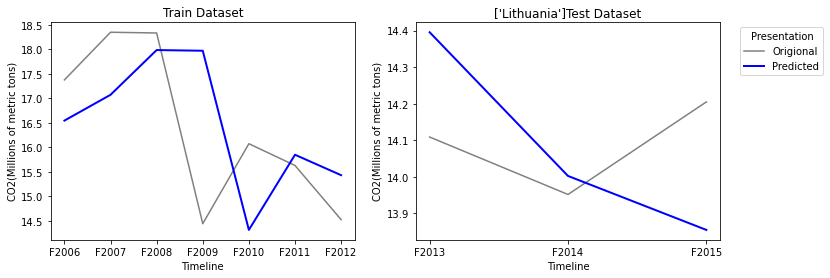

Origional Values:  [array([14.109], dtype=object), array([13.952], dtype=object), array([14.205], dtype=object)]
Predicted Values:  [14.39542765 14.00264385 13.85511501]
Explained Variance Score: -5.343984394190009
        Maximam Error   : 0.3498849948825029
    Mean Absolute Error : 0.22898549587652717
    Mean Squared Error  : 0.06900836827043645
         r2 score       : -5.345661916688064


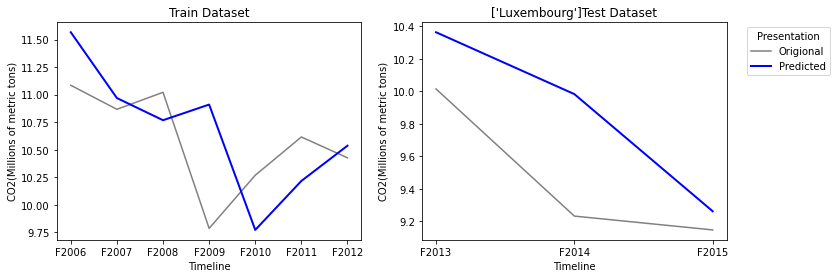

Origional Values:  [array([10.014], dtype=object), array([9.232], dtype=object), array([9.147], dtype=object)]
Predicted Values:  [10.36267582  9.9821565   9.26165744]
Explained Variance Score: 0.5477282540774774
        Maximam Error   : 0.7501564958003275
    Mean Absolute Error : 0.4044965845193804
    Mean Squared Error  : 0.2324853076587964
         r2 score       : -0.5267876174837316


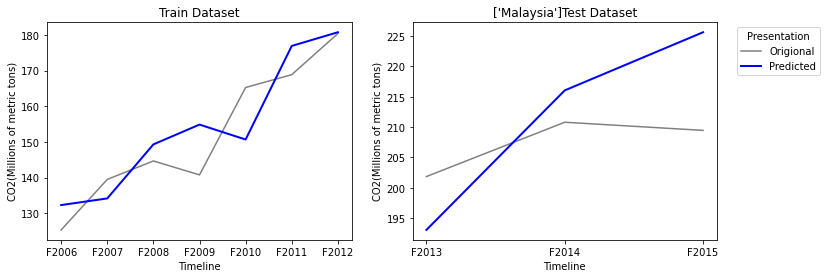

Origional Values:  [array([201.847], dtype=object), array([210.804], dtype=object), array([209.462], dtype=object)]
Predicted Values:  [193.04947349 216.05571275 225.64334059]
Explained Variance Score: -5.719051507523775
        Maximam Error   : 16.18134059032613
    Mean Absolute Error : 10.07685995173363
    Mean Squared Error  : 122.27091428776117
         r2 score       : -6.8593165825280025


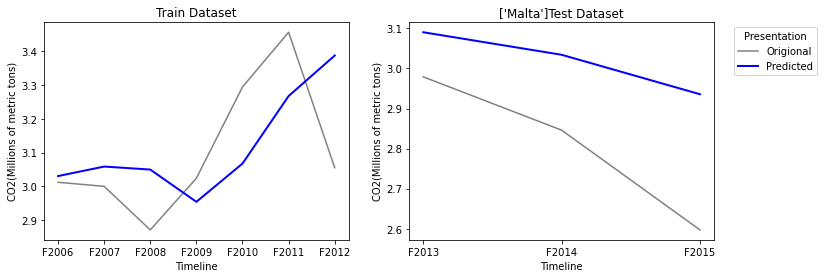

Origional Values:  [array([2.979], dtype=object), array([2.846], dtype=object), array([2.597], dtype=object)]
Predicted Values:  [3.09031451 3.03406453 2.93562708]
Explained Variance Score: 0.6443897515373709
        Maximam Error   : 0.33862707743126386
    Mean Absolute Error : 0.21266870600206556
    Mean Squared Error  : 0.05414249524555385
         r2 score       : -1.1598059393919895


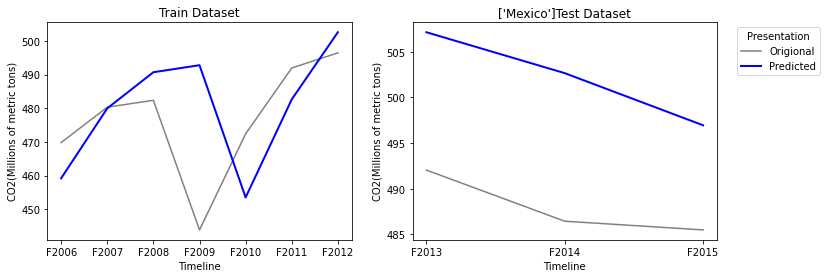

Origional Values:  [array([492.039], dtype=object), array([486.441], dtype=object), array([485.486], dtype=object)]
Predicted Values:  [507.13568917 502.65613474 496.94523843]
Explained Variance Score: 0.5065858682124856
        Maximam Error   : 16.215134744885006
    Mean Absolute Error : 14.257020784735724
    Mean Squared Error  : 207.38492144512256
         r2 score       : -23.82283013401208


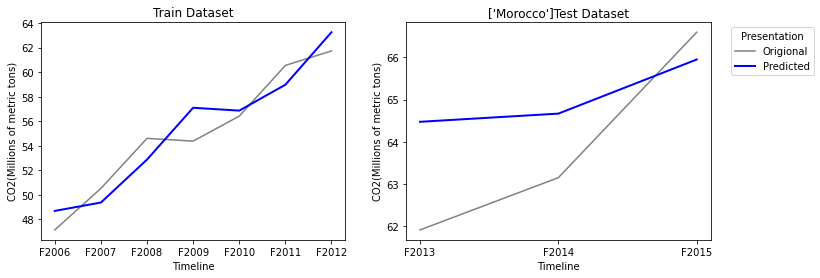

Origional Values:  [array([61.914], dtype=object), array([63.151], dtype=object), array([66.593], dtype=object)]
Predicted Values:  [64.47316496 64.66679375 65.94764302]
Explained Variance Score: 0.5455657510846474
        Maximam Error   : 2.5591649556616574
    Mean Absolute Error : 1.573438561407606
    Mean Squared Error  : 3.087813861931822
         r2 score       : 0.21208186865951262


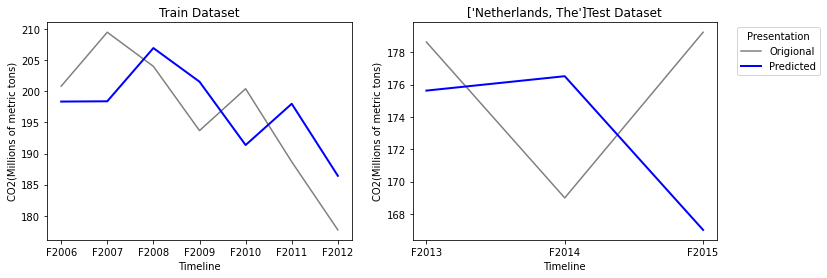

Origional Values:  [array([178.633], dtype=object), array([168.994], dtype=object), array([179.238], dtype=object)]
Predicted Values:  [175.62886506 176.5194058  167.01340117]
Explained Variance Score: -1.956124705104806
        Maximam Error   : 12.224598834584327
    Mean Absolute Error : 7.584713191275426
    Mean Squared Error  : 71.69912528653578
         r2 score       : -2.2555016332082887


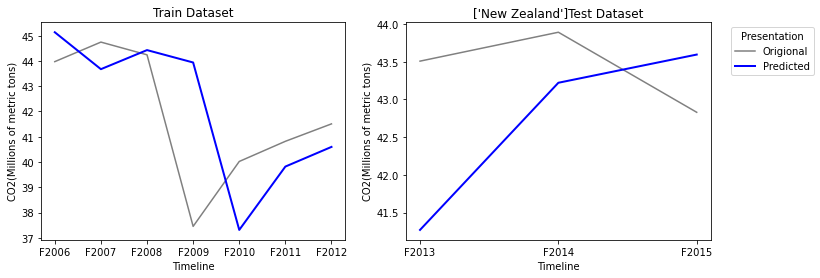

Origional Values:  [array([43.508], dtype=object), array([43.891], dtype=object), array([42.83], dtype=object)]
Predicted Values:  [41.27081313 43.22137896 43.59509918]
Explained Variance Score: -6.811011529113035
        Maximam Error   : 2.2371868675103954
    Mean Absolute Error : 1.2239690278268494
    Mean Squared Error  : 2.012924722112032
         r2 score       : -9.45920284869543


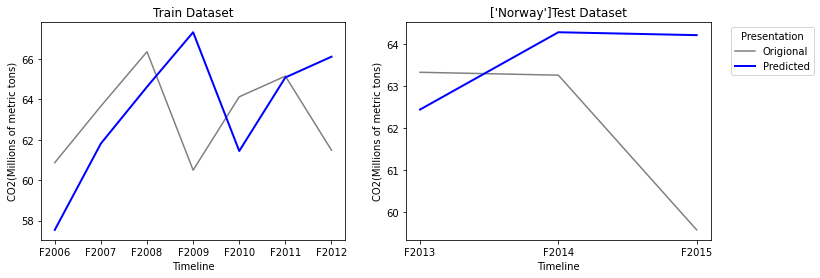

Origional Values:  [array([63.328], dtype=object), array([63.259], dtype=object), array([59.565], dtype=object)]
Predicted Values:  [62.43778029 64.28365141 64.21443124]
Explained Variance Score: -0.7077499592464962
        Maximam Error   : 4.649431242131726
    Mean Absolute Error : 2.1881007880362042
    Mean Squared Error  : 7.819870840901416
         r2 score       : -1.5306510327086684


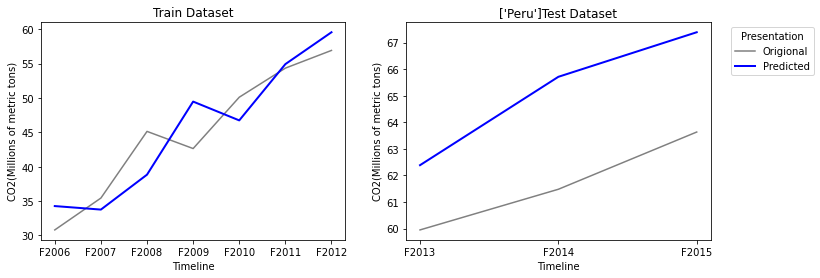

Origional Values:  [array([59.951], dtype=object), array([61.481], dtype=object), array([63.635], dtype=object)]
Predicted Values:  [62.3874927  65.71328203 67.39042695]
Explained Variance Score: 0.7473862183070781
        Maximam Error   : 4.23228203397408
    Mean Absolute Error : 3.4747338949892046
    Mean Squared Error  : 12.650646493771056
         r2 score       : -4.539762732382735


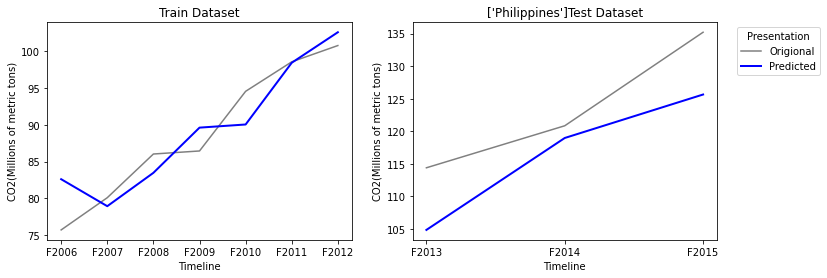

Origional Values:  [array([114.402], dtype=object), array([120.849], dtype=object), array([135.202], dtype=object)]
Predicted Values:  [104.86723095 118.97460289 125.64642117]
Explained Variance Score: 0.8269918621858021
        Maximam Error   : 9.555578827727373
    Mean Absolute Error : 6.988248328953574
    Mean Squared Error  : 61.91142401337495
         r2 score       : 0.1808399826649818


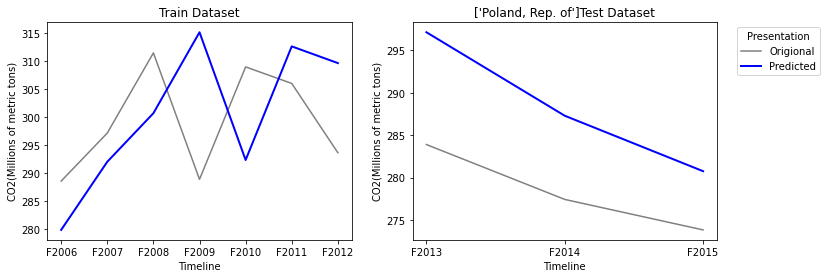

Origional Values:  [array([283.896], dtype=object), array([277.432], dtype=object), array([273.84], dtype=object)]
Predicted Values:  [297.12373468 287.28961669 280.75778987]
Explained Variance Score: 0.6160958592262832
        Maximam Error   : 13.227734675362626
    Mean Absolute Error : 10.001047081274598
    Mean Squared Error  : 106.66712942673577
         r2 score       : -5.161420749946237


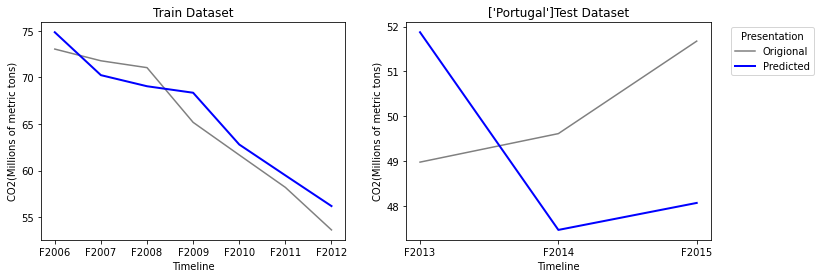

Origional Values:  [array([48.975], dtype=object), array([49.611], dtype=object), array([51.674], dtype=object)]
Predicted Values:  [51.87208232 47.46285448 48.06488731]
Explained Variance Score: -4.853406130437532
        Maximam Error   : 3.6091126888109315
    Mean Absolute Error : 2.884780175649292
    Mean Squared Error  : 8.677769846989651
         r2 score       : -5.538258442683104


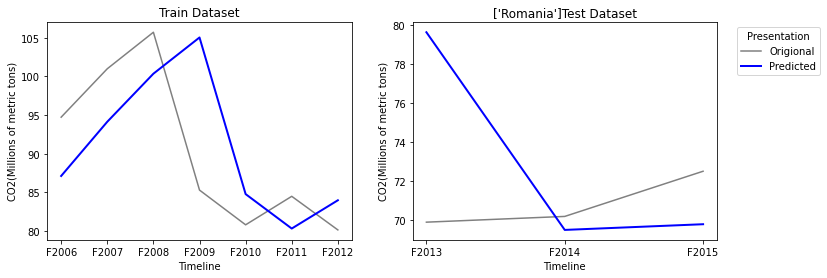

Origional Values:  [array([69.888], dtype=object), array([70.183], dtype=object), array([72.506], dtype=object)]
Predicted Values:  [79.65256321 69.48938597 69.78208707]
Explained Variance Score: -20.8409296731522
        Maximam Error   : 9.764563210330408
    Mean Absolute Error : 4.394030056571272
    Mean Squared Error  : 34.415832258551326
         r2 score       : -24.106226051399936


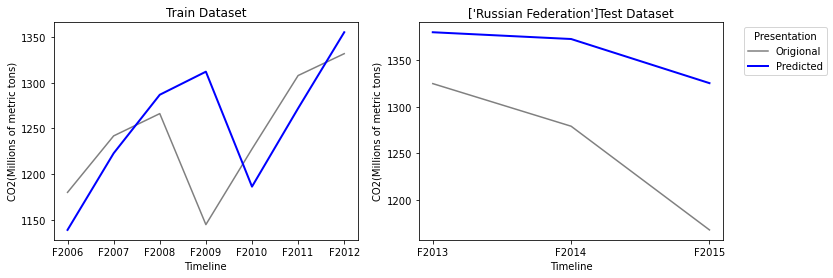

Origional Values:  [array([1324.769], dtype=object), array([1278.977], dtype=object), array([1167.53], dtype=object)]
Predicted Values:  [1379.98118624 1372.70714457 1325.27827996]
Explained Variance Score: 0.5898314749653057
        Maximam Error   : 157.7482799556601
    Mean Absolute Error : 102.23020359097791
    Mean Squared Error  : 12239.415113506599
         r2 score       : -1.8071019883208561


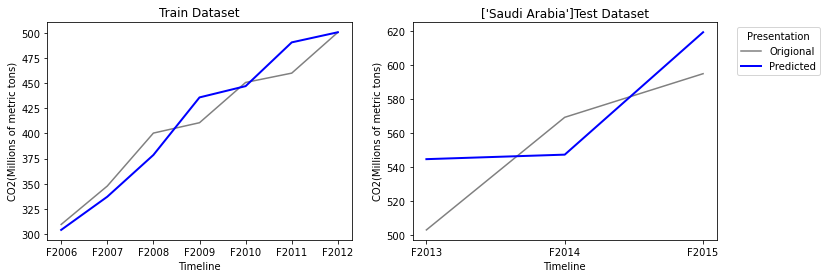

Origional Values:  [array([502.969], dtype=object), array([569.349], dtype=object), array([595.054], dtype=object)]
Predicted Values:  [544.68000034 547.33953382 619.48494967]
Explained Variance Score: 0.5190259710705805
        Maximam Error   : 41.71100033909562
    Mean Absolute Error : 29.38380539524195
    Mean Squared Error  : 940.365150812785
         r2 score       : 0.3752510057263977


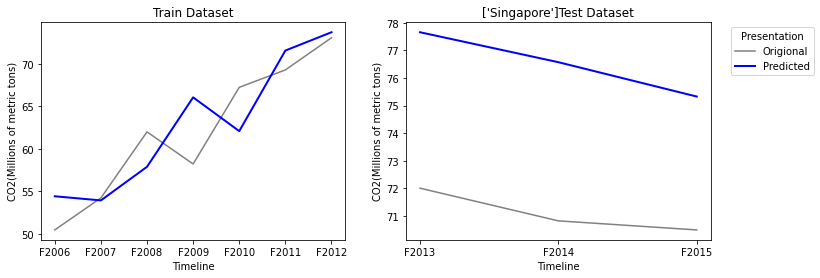

Origional Values:  [array([72.008], dtype=object), array([70.825], dtype=object), array([70.497], dtype=object)]
Predicted Values:  [77.65559916 76.57085211 75.32738724]
Explained Variance Score: 0.6001352684199652
        Maximam Error   : 5.745852113128393
    Mean Absolute Error : 5.407946168814457
    Mean Squared Error  : 29.414277865511213
         r2 score       : -68.84563343976664


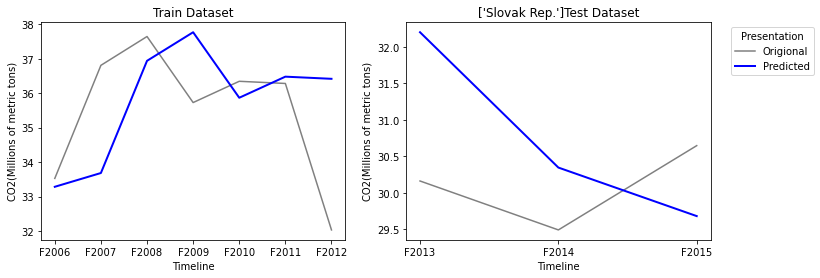

Origional Values:  [array([30.164], dtype=object), array([29.494], dtype=object), array([30.648], dtype=object)]
Predicted Values:  [32.20088608 30.34788724 29.68326774]
Explained Variance Score: -5.807666062753835
        Maximam Error   : 2.0368860759639986
    Mean Absolute Error : 1.2851685242596471
    Mean Squared Error  : 1.9362455441383357
         r2 score       : -7.648792527388846


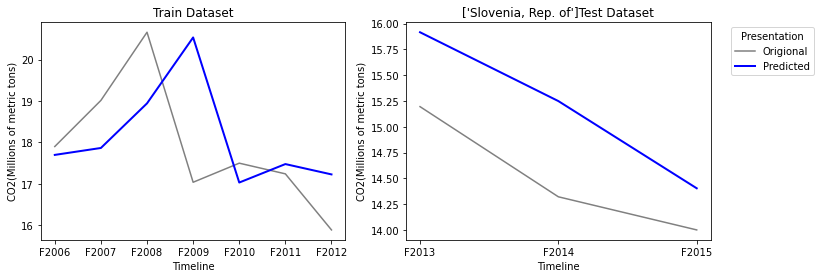

Origional Values:  [array([15.195], dtype=object), array([14.321], dtype=object), array([14.0], dtype=object)]
Predicted Values:  [15.91619536 15.2488679  14.40358645]
Explained Variance Score: 0.8176598818874089
        Maximam Error   : 0.9278679025676588
    Mean Absolute Error : 0.6842165728220237
    Mean Squared Error  : 0.5146478735622654
         r2 score       : -1.0182779617351483


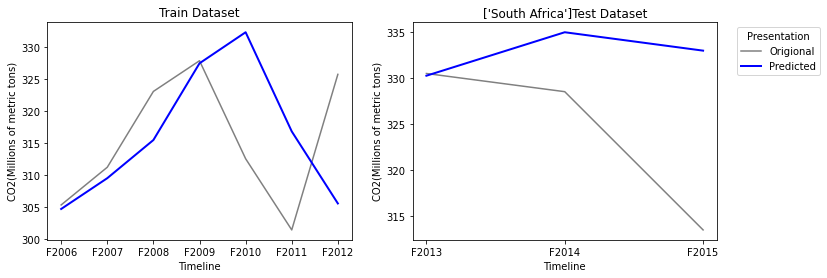

Origional Values:  [array([330.458], dtype=object), array([328.481], dtype=object), array([313.451], dtype=object)]
Predicted Values:  [330.21689906 334.94361466 332.94303304]
Explained Variance Score: -0.16386679178546837
        Maximam Error   : 19.492033043456786
    Mean Absolute Error : 8.731916215588228
    Mean Squared Error  : 140.58762337355088
         r2 score       : -1.437712664046427


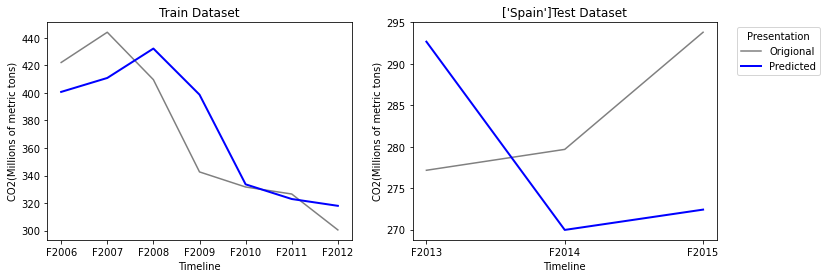

Origional Values:  [array([277.159], dtype=object), array([279.68], dtype=object), array([293.817], dtype=object)]
Predicted Values:  [292.6801947  269.96167209 272.41249992]
Explained Variance Score: -3.4182565767730715
        Maximam Error   : 21.40450007814951
    Mean Absolute Error : 15.548007562436965
    Mean Squared Error  : 264.50200196770606
         r2 score       : -3.921484562446972


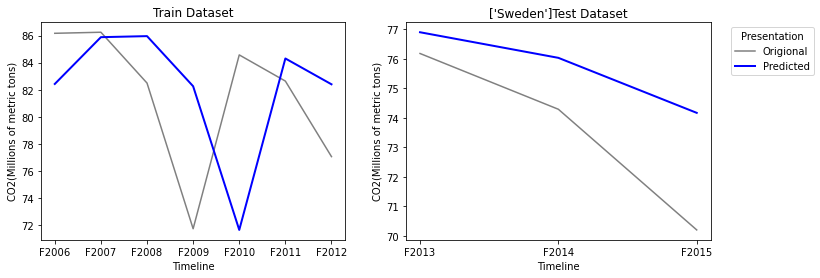

Origional Values:  [array([76.184], dtype=object), array([74.291], dtype=object), array([70.196], dtype=object)]
Predicted Values:  [76.90509107 76.03625092 74.16937873]
Explained Variance Score: 0.7048347295233084
        Maximam Error   : 3.973378728045276
    Mean Absolute Error : 2.1465735730478457
    Mean Squared Error  : 6.451203875073065
         r2 score       : -0.03295254253818514


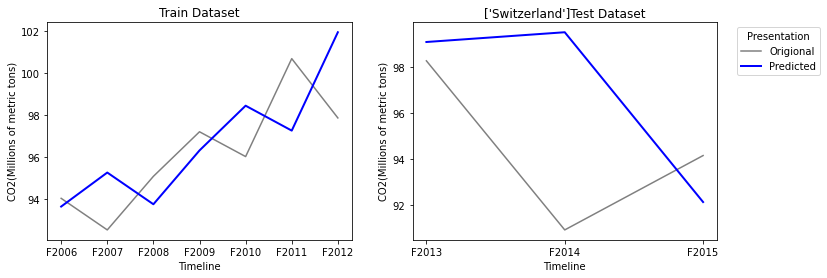

Origional Values:  [array([98.287], dtype=object), array([90.92], dtype=object), array([94.16], dtype=object)]
Predicted Values:  [99.10789701 99.53269039 92.13445678]
Explained Variance Score: -1.2247053938734962
        Maximam Error   : 8.612690391530805
    Mean Absolute Error : 3.8197102097700935
    Mean Squared Error  : 26.31837768059708
         r2 score       : -1.895579432937709


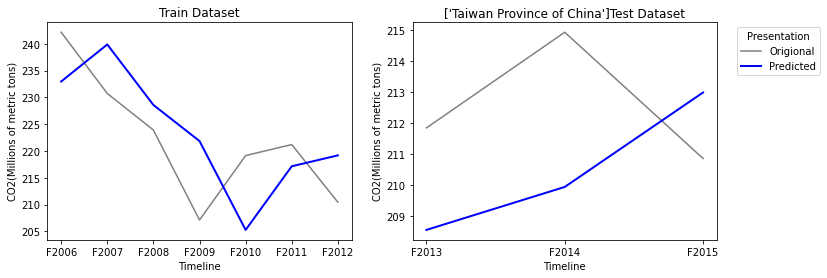

Origional Values:  [array([211.848], dtype=object), array([214.94], dtype=object), array([210.858], dtype=object)]
Predicted Values:  [208.55067901 209.93954097 212.99384078]
Explained Variance Score: -2.0638465835492505
        Maximam Error   : 5.000459028068548
    Mean Absolute Error : 3.477873601032788
    Mean Squared Error  : 13.479577357011323
         r2 score       : -3.4596151837639066


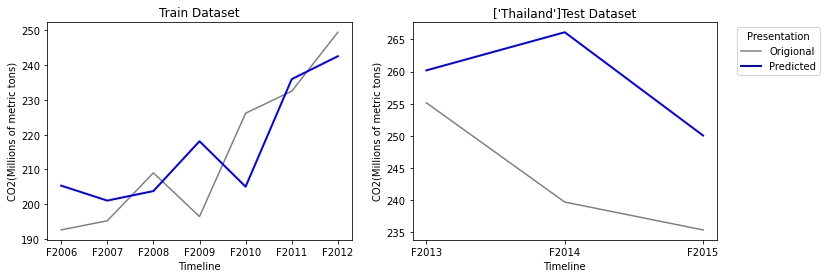

Origional Values:  [array([255.149], dtype=object), array([239.72], dtype=object), array([235.388], dtype=object)]
Predicted Values:  [260.19359503 266.11907322 250.06283805]
Explained Variance Score: -0.06008740807594126
        Maximam Error   : 26.399073220737904
    Mean Absolute Error : 15.37283543343085
    Mean Squared Error  : 312.5699592552619
         r2 score       : -3.3458274011156526


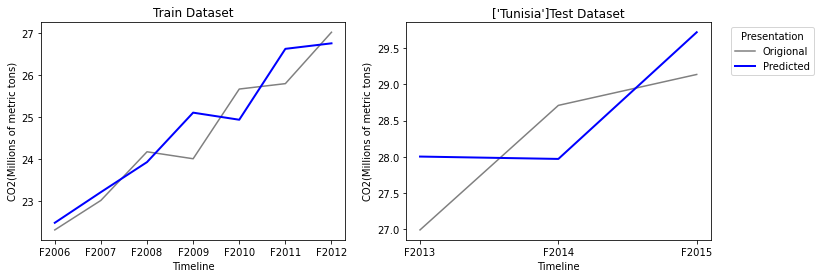

Origional Values:  [array([26.991], dtype=object), array([28.711], dtype=object), array([29.138], dtype=object)]
Predicted Values:  [28.00401903 27.97146791 29.72109073]
Explained Variance Score: 0.35414366358474025
        Maximam Error   : 1.0130190332958335
    Mean Absolute Error : 0.7785472847133962
    Mean Squared Error  : 0.6377033580094102
         r2 score       : 0.25947355817453555


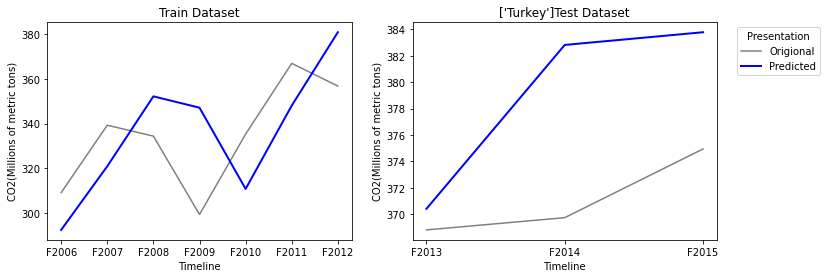

Origional Values:  [array([368.813], dtype=object), array([369.74], dtype=object), array([374.947], dtype=object)]
Predicted Values:  [370.41022861 382.82437138 383.78560679]
Explained Variance Score: -2.0857360018092854
        Maximam Error   : 13.084371377038508
    Mean Absolute Error : 7.840068925800172
    Mean Squared Error  : 83.9576278429986
         r2 score       : -10.518904647302708


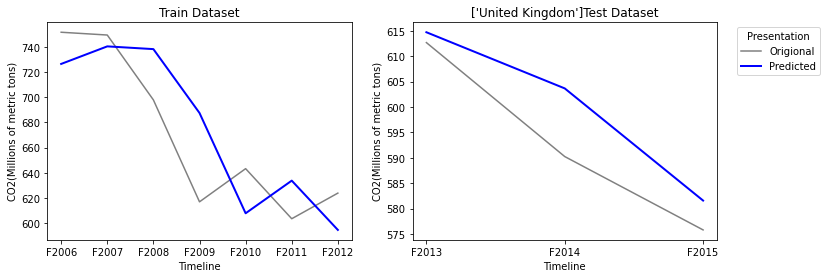

Origional Values:  [array([612.671], dtype=object), array([590.239], dtype=object), array([575.797], dtype=object)]
Predicted Values:  [614.70934025 603.65367379 581.57580412]
Explained Variance Score: 0.9026200127376491
        Maximam Error   : 13.414673793986026
    Mean Absolute Error : 7.077272723128924
    Mean Squared Error  : 72.50096035430211
         r2 score       : 0.685000281913184


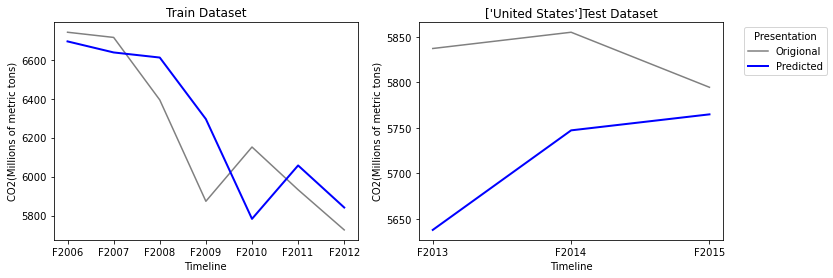

Origional Values:  [array([5837.047], dtype=object), array([5854.868], dtype=object), array([5794.513], dtype=object)]
Predicted Values:  [5638.13245242 5747.29172273 5764.83726904]
Explained Variance Score: -6.462221324667852
        Maximam Error   : 198.91454758174677
    Mean Absolute Error : 112.05551860574694
    Mean Squared Error  : 17340.10055992791
         r2 score       : -26.049504508547106


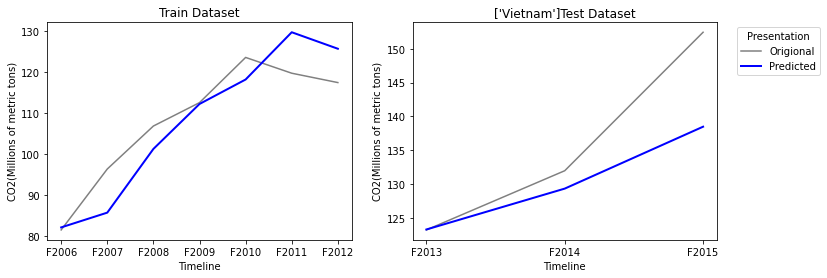

Origional Values:  [array([123.209], dtype=object), array([131.967], dtype=object), array([152.455], dtype=object)]
Predicted Values:  [123.27191637 129.32110014 138.48063531]
Explained Variance Score: 0.7538691282819695
        Maximam Error   : 13.974364689337023
    Mean Absolute Error : 5.561060306608293
    Mean Squared Error  : 67.42920434429276
         r2 score       : 0.5510669649348865


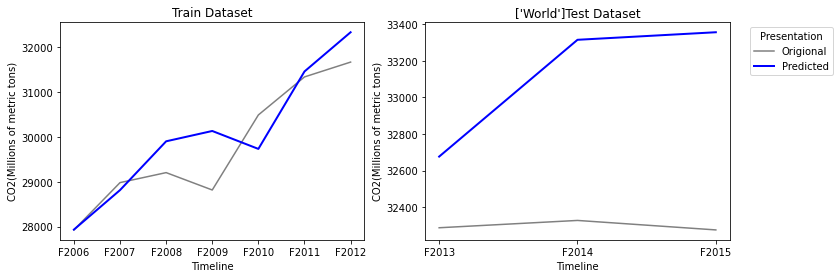

Origional Values:  [array([32287.8], dtype=object), array([32327.8], dtype=object), array([32276.0], dtype=object)]
Predicted Values:  [32676.67222409 33314.92505903 33356.1958534 ]
Explained Variance Score: -189.95552443762853
        Maximam Error   : 1080.1958533956931
    Mean Absolute Error : 818.731045502951
    Mean Squared Error  : 764153.5235053449
         r2 score       : -1554.0961703723356


In [19]:
i=0
VVIP3=list()
VVIP4=list()
while i<len(CO2_FINAL_DF_FINAL.T):
    series=CO2_FINAL_DF_FINAL[CO2_FINAL_DF_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    # Splitting the data into Train & Test
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=3,shuffle=False)
    # Fitting the model on Train dataset
    Model = MLPRegressor ()
    Model = Model.fit(X_train, y_train)
    # Predicting and storing results for Test dataset
    train_fit = Model.predict(X_train)
    test_pred = Model.predict(X_test)
    plt.figure(figsize=(12,4))
    # Plotting Regression line on Train Dataset
    plt.subplot(1,2,1)
    plt.plot(y_train, color='gray')
    plt.plot(y_train.index,train_fit, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title("Train Dataset")
    # Plotting Regression line on Test Dataset
    plt.subplot(1,2,2)
    plt.plot(y_test, color='gray')
    plt.plot(y_test.index,test_pred, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title(str(X.columns.values)+"Test Dataset")
    plt.legend(['Origional','Predicted'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()
    pre=test_pred
    y_test=y_test
    y_test=np.array(y_test)
    VVIP3.append(pre)
    VVIP4.append(y_test)
    exp_rf=explained_variance_score(y_test,pre)
    mxer_rf=max_error(y_test,pre)
    mae_rf=mean_absolute_error(y_test,pre)
    mse_rf=mean_squared_error(y_test,pre)
    r2_rf=r2_score(y_test,pre)
    print("Origional Values: " , list(y_test))
    print("Predicted Values: " , pre)
    print("Explained Variance Score:",exp_rf)
    print("        Maximam Error   :",mxer_rf)
    print("    Mean Absolute Error :",mae_rf)
    print("    Mean Squared Error  :",mse_rf)
    print("         r2 score       :",r2_rf)
    i=i+1

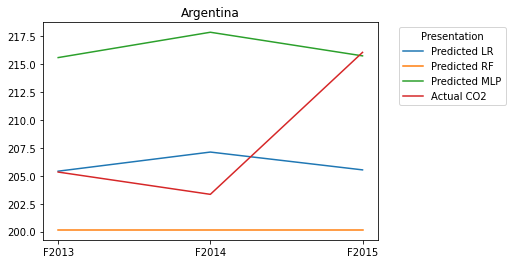

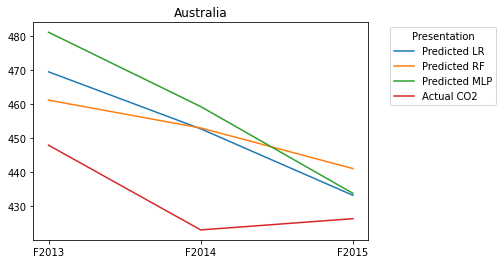

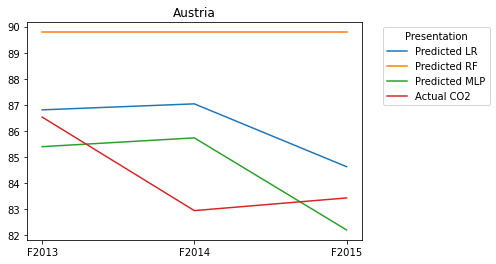

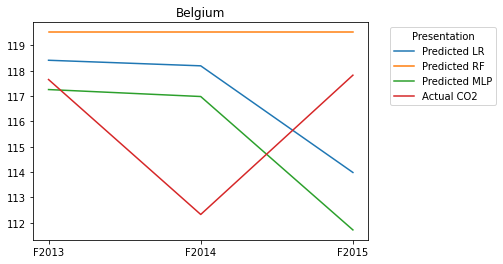

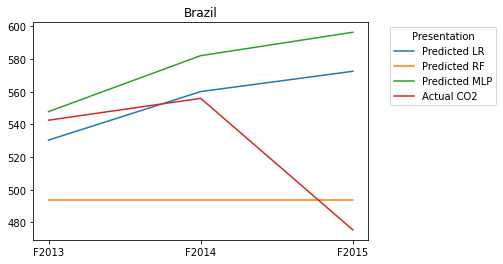

...

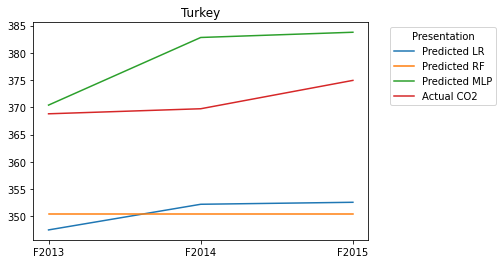

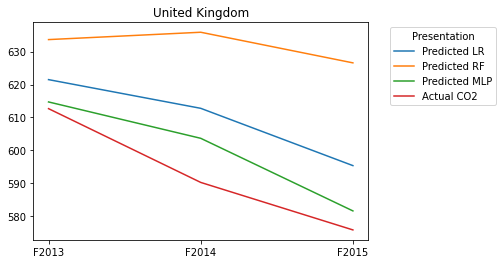

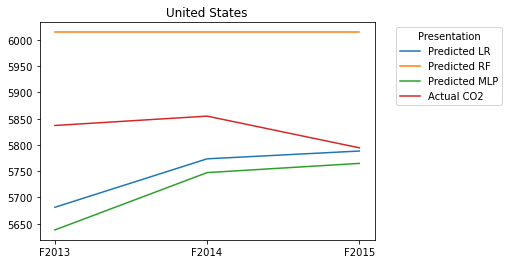

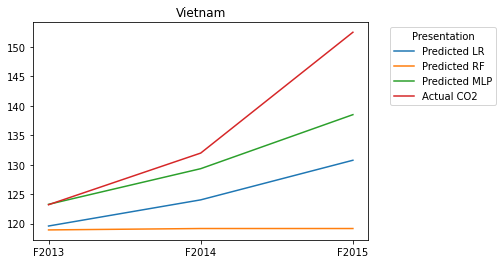

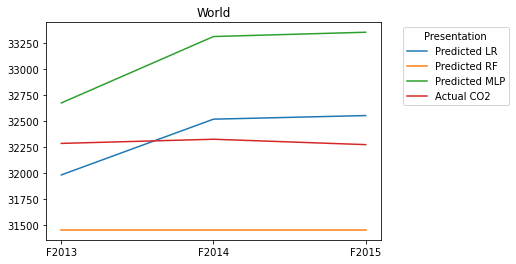

In [20]:
seeno=Y.index[-3:]
i=0
while i<len(VVIP1):
    plt.plot(seeno,VVIP1[i])
    plt.plot(seeno,VVIP2[i])
    plt.plot(seeno,VVIP3[i])
    plt.plot(seeno,VVIP4[i])
    plt.legend(['Predicted LR','Predicted RF','Predicted MLP'
               ,'Actual CO2'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.title(str(CO2_FINAL_DF_FINAL.columns[i]))
    i=i+1
    plt.show()

### The above analysis show that MLP Regression has reletively closer results to the Actual CO2 when it comes accuracy and error calculations

### USING MLP to predict 2016,2017,2018 and 2019

In [21]:
i=0
list_2016=list()
list_2017=list()
list_2018=list()
list_2019=list()
while i<len(CO2_FINAL_DF_FINAL.T):
    series=CO2_FINAL_DF_FINAL[CO2_FINAL_DF_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    Model = MLPRegressor()
    Model = Model.fit(X, Y)
    train_fit = Model.predict(Y[-1:]) 
    list_2016.append(train_fit[0])
    train_fit=Model.predict(pd.DataFrame(train_fit)) 
    list_2017.append(train_fit[0])
    train_fit=Model.predict(pd.DataFrame(train_fit)) 
    list_2018.append(train_fit[0])
    train_fit=Model.predict(pd.DataFrame(train_fit)) 
    list_2019.append(train_fit[0])
    i=i+1

In [22]:
CO2_FINAL_DF['F2016']=list_2016
CO2_FINAL_DF['F2017']=list_2017
CO2_FINAL_DF['F2018']=list_2018
CO2_FINAL_DF['F2019']=list_2019

In [23]:
CO2_FINAL_DF.head()

,ObjectId,Country,ISO2,ISO3,Indicator,Code,Unit,F2005,F2006,F2007,...,F2010,F2011,F2012,F2013,F2014,F2015,F2016,F2017,F2018,F2019
1,2,Argentina,AR,ARG,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,141.18,153.44,166.89,...,183.06,198.55,203.19,205.33,203.33,216.03,225.07,234.45,244.17,254.25
7,8,Australia,AU,AUS,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,418.42,420.98,444.59,...,446.21,450.35,469.37,448.02,423.10,426.40,432.60,438.87,445.21,451.64
13,14,Austria,AT,AUT,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,95.26,95.39,94.53,...,89.74,90.34,86.19,86.53,82.95,83.44,82.90,82.36,81.84,81.31
19,20,Belgium,BE,BEL,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,131.71,129.89,129.69,...,127.70,122.48,117.93,117.66,112.33,117.83,116.80,115.79,114.79,113.81
25,26,Brazil,BR,BRA,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,312.82,330.87,363.68,...,458.99,486.29,510.59,542.57,555.96,475.38,492.11,509.40,527.29,545.78


### Working for C02 Emissions Embodied in Gross Exports

In [24]:
CO2_Grass_Exp=Actual_df[Actual_df['Indicator']=='C02 Emissions Embodied in Gross Exports']

In [25]:
CO2_Grass_Exp.isnull().sum()

ObjectId     0
Country      0
ISO2         2
ISO3         0
Indicator    0
Code         0
Unit         0
F2005        0
F2006        0
F2007        0
F2008        0
F2009        0
F2010        0
F2011        0
F2012        0
F2013        0
F2014        0
F2015        0
F2016        9
F2017        9
F2018        9
F2019        9
dtype: int64

## C02 Emissions Embodied in Gross Exports is not available for 9 countries

In [26]:
CO2_Grass_ExpNOTAV=CO2_Grass_Exp[CO2_Grass_Exp['F2019'].isna()]
CO2_Grass_ExpAV=CO2_Grass_Exp[~CO2_Grass_Exp['F2019'].isna()]

## Working for not available data

In [27]:
CO2_Grass_ExpNOTAV_FINAL=CO2_Grass_ExpNOTAV[['Country','F2005', 'F2006', 'F2007', 'F2008', 'F2009', 'F2010', 'F2011', 'F2012',
       'F2013', 'F2014', 'F2015']]

In [28]:
CO2_Grass_ExpNOTAV_FINAL=CO2_Grass_ExpNOTAV_FINAL.T
CO2_Grass_ExpNOTAV_FINAL.columns=CO2_Grass_ExpNOTAV_FINAL.iloc[0]
CO2_Grass_ExpNOTAV_FINAL=CO2_Grass_ExpNOTAV_FINAL.iloc[1:]

## Linear Regression

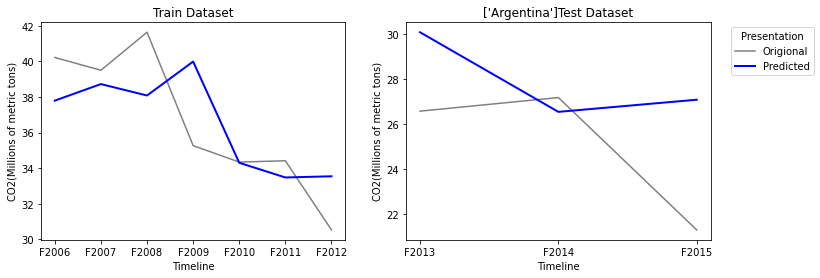

Origional Values:  [array([26.565], dtype=object), array([27.168], dtype=object), array([21.294], dtype=object)]
Predicted Values:  [[30.06672165]
 [26.53360493]
 [27.0718741 ]]
Explained Variance Score: -0.012044537165450286
        Maximam Error   : 5.777874104082496
    Mean Absolute Error : 3.3046636064030785
    Mean Squared Error  : 15.349446921503024
         r2 score       : -1.2049956978054444


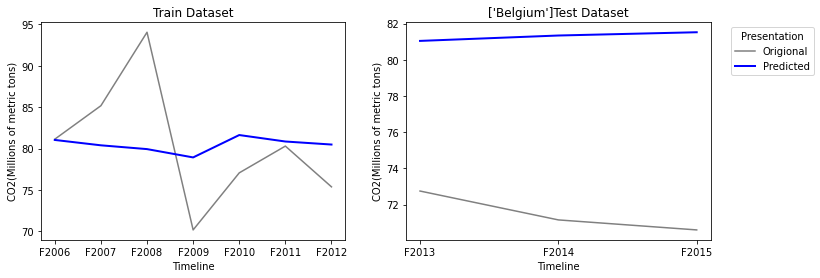

Origional Values:  [array([72.751], dtype=object), array([71.156], dtype=object), array([70.603], dtype=object)]
Predicted Values:  [[81.0455358 ]
 [81.34331351]
 [81.5238363 ]]
Explained Variance Score: -0.4762197552203944
        Maximam Error   : 10.920836297306764
    Mean Absolute Error : 9.800895200711755
    Mean Squared Error  : 97.28178201126684
         r2 score       : -116.30530172701606


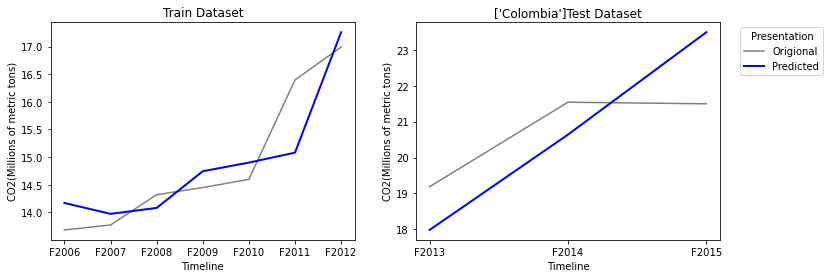

Origional Values:  [array([19.187], dtype=object), array([21.543], dtype=object), array([21.498], dtype=object)]
Predicted Values:  [[17.98096526]
 [20.63961073]
 [23.49326392]]
Explained Variance Score: -0.7204873282894697
        Maximam Error   : 1.9952639224286024
    Mean Absolute Error : 1.3682293106786279
    Mean Squared Error  : 2.08390336305045
         r2 score       : -0.7216836882324742


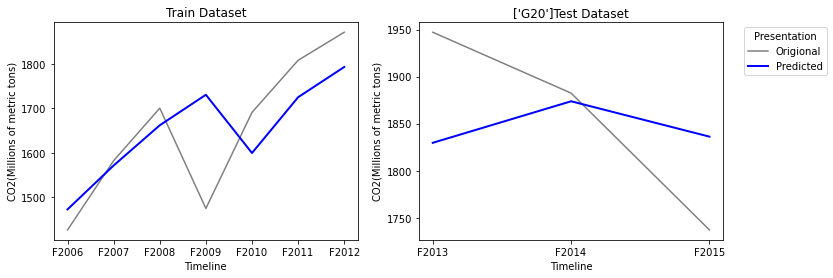

Origional Values:  [array([1947.098], dtype=object), array([1882.403], dtype=object), array([1737.099], dtype=object)]
Predicted Values:  [[1829.63769809]
 [1873.75859455]
 [1836.18931179]]
Explained Variance Score: -0.013596324473839738
        Maximam Error   : 117.46030191141517
    Mean Absolute Error : 75.06500638364226
    Mean Squared Error  : 7896.846053490374
         r2 score       : -0.02411211271109792


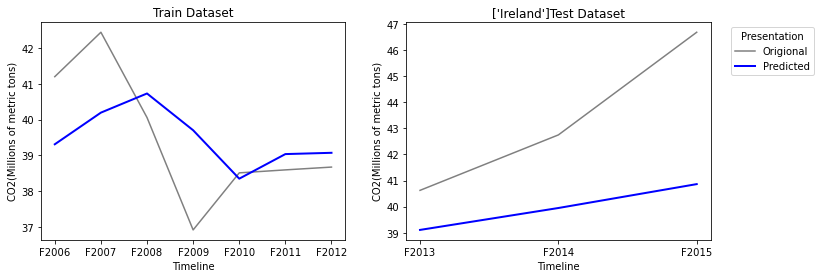

Origional Values:  [array([40.624], dtype=object), array([42.747], dtype=object), array([46.679], dtype=object)]
Predicted Values:  [[39.10871383]
 [39.9478078 ]
 [40.86275208]]
Explained Variance Score: 0.48350856223652494
        Maximam Error   : 5.816247921313888
    Mean Absolute Error : 3.376908761405796
    Mean Squared Error  : 14.65343633295747
         r2 score       : -1.3287853646760288


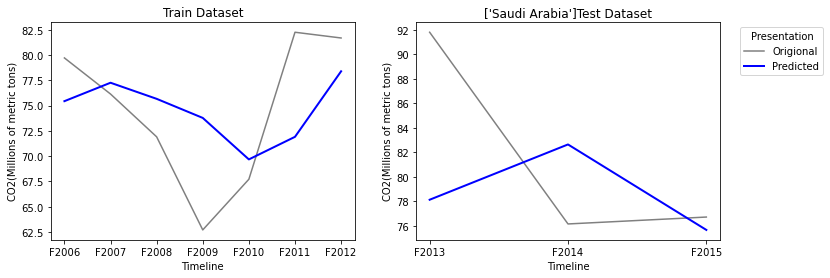

Origional Values:  [array([91.796], dtype=object), array([76.162], dtype=object), array([76.725], dtype=object)]
Predicted Values:  [[78.13698946]
 [82.64537551]
 [75.67572185]]
Explained Variance Score: -0.3170083163569706
        Maximam Error   : 13.659010536990891
    Mean Absolute Error : 7.0638880633322385
    Mean Squared Error  : 76.5679038096462
         r2 score       : -0.4603711667509438


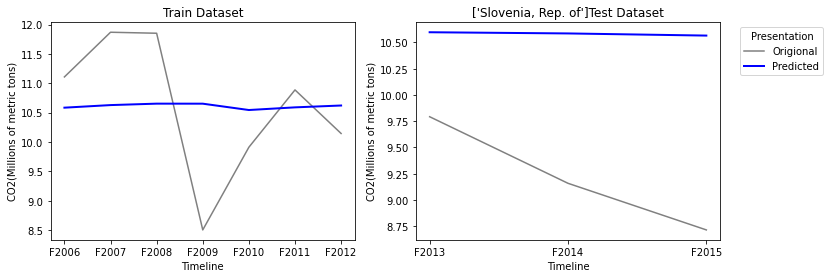

Origional Values:  [array([9.793], dtype=object), array([9.159], dtype=object), array([8.715], dtype=object)]
Predicted Values:  [[10.59753952]
 [10.58618895]
 [10.56574504]]
Explained Variance Score: 0.05651788765872312
        Maximam Error   : 1.850745036728318
    Mean Absolute Error : 1.3608245041701281
    Mean Squared Error  : 2.0364697814481816
         r2 score       : -9.406812285105895


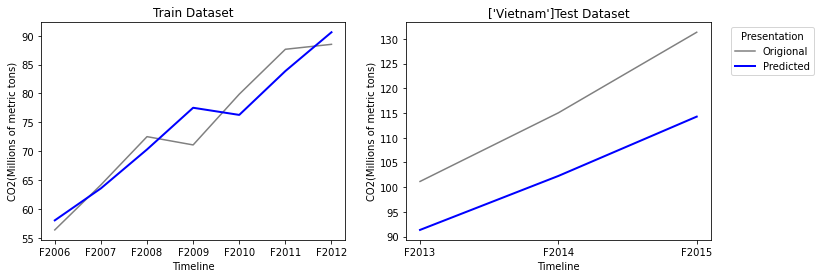

Origional Values:  [array([101.144], dtype=object), array([115.035], dtype=object), array([131.345], dtype=object)]
Predicted Values:  [[ 91.33749691]
 [102.26100912]
 [114.2675377 ]]
Explained Variance Score: 0.9415111376953299
        Maximam Error   : 17.077462295924732
    Mean Absolute Error : 13.219318755531583
    Mean Squared Error  : 183.66068810656944
         r2 score       : -0.20558286515588575


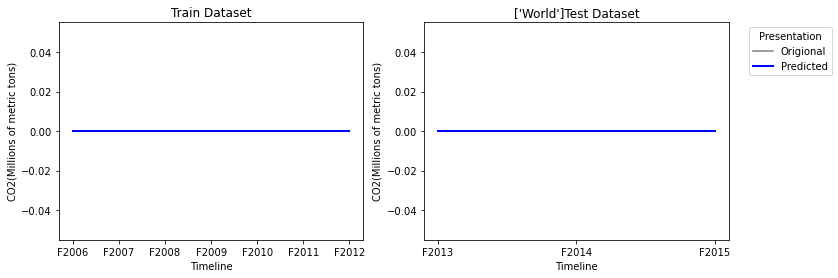

Origional Values:  [array([0.0], dtype=object), array([0.0], dtype=object), array([0.0], dtype=object)]
Predicted Values:  [[0.]
 [0.]
 [0.]]
Explained Variance Score: 1.0
        Maximam Error   : 0.0
    Mean Absolute Error : 0.0
    Mean Squared Error  : 0.0
         r2 score       : 1.0


In [29]:
i=0
VVIP1=list()
while i<len(CO2_Grass_ExpNOTAV_FINAL.T):
    series=CO2_Grass_ExpNOTAV_FINAL[CO2_Grass_ExpNOTAV_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    # Splitting the data into Train & Test
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=3,shuffle=False)
    # Fitting the model on Train dataset
    Model = LinearRegression()
    Model = Model.fit(X_train, y_train)
    # Predicting and storing results for Test dataset
    train_fit = Model.predict(X_train)
    test_pred = Model.predict(X_test)
    plt.figure(figsize=(12,4))
    # Plotting Regression line on Train Dataset
    plt.subplot(1,2,1)
    plt.plot(y_train, color='gray')
    plt.plot(y_train.index,train_fit, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title("Train Dataset")
    # Plotting Regression line on Test Dataset
    plt.subplot(1,2,2)
    plt.plot(y_test, color='gray')
    plt.plot(y_test.index,test_pred, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title(str(X.columns.values)+"Test Dataset")
    plt.legend(['Origional','Predicted'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()
    pre=test_pred
    y_test=y_test
    y_test=np.array(y_test)
    VVIP1.append(pre)
    exp_rf=explained_variance_score(y_test,pre)
    mxer_rf=max_error(y_test,pre)
    mae_rf=mean_absolute_error(y_test,pre)
    mse_rf=mean_squared_error(y_test,pre)
    r2_rf=r2_score(y_test,pre)
    print("Origional Values: " , list(y_test))
    print("Predicted Values: " , pre)
    print("Explained Variance Score:",exp_rf)
    print("        Maximam Error   :",mxer_rf)
    print("    Mean Absolute Error :",mae_rf)
    print("    Mean Squared Error  :",mse_rf)
    print("         r2 score       :",r2_rf)
    i=i+1

# Random Forest Regression

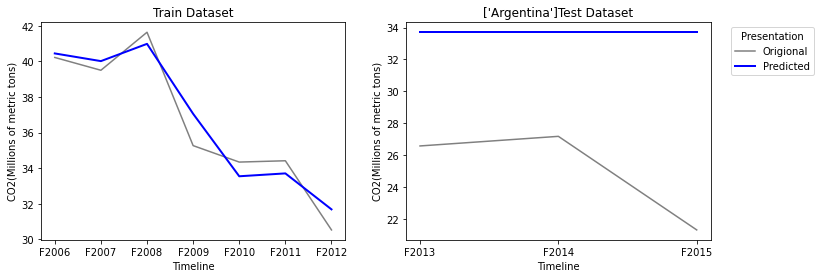

Origional Values:  [array([26.565], dtype=object), array([27.168], dtype=object), array([21.294], dtype=object)]
Predicted Values:  [33.70318 33.70318 33.70318]
Explained Variance Score: 0.0
        Maximam Error   : 12.409180000000067
    Mean Absolute Error : 8.694180000000067
    Mean Squared Error  : 82.54997987240117
         r2 score       : -10.858560859126179


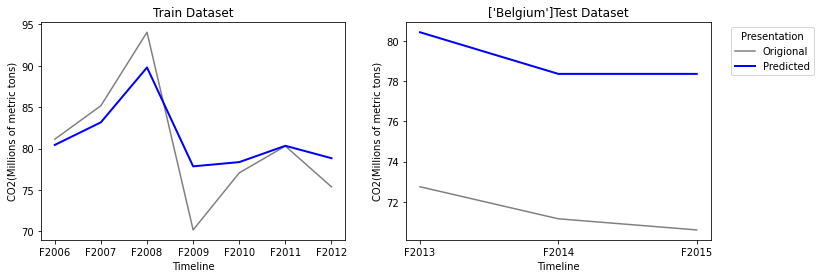

Origional Values:  [array([72.751], dtype=object), array([71.156], dtype=object), array([70.603], dtype=object)]
Predicted Values:  [80.44044 78.36798 78.36798]
Explained Variance Score: 0.9277194157672654
        Maximam Error   : 7.764979999999909
    Mean Absolute Error : 7.5554666666665895
    Mean Squared Error  : 57.145019144798844
         r2 score       : -67.90718461757177


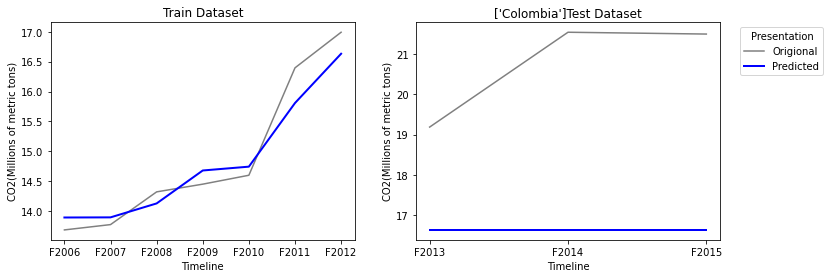

Origional Values:  [array([19.187], dtype=object), array([21.543], dtype=object), array([21.498], dtype=object)]
Predicted Values:  [16.63211 16.63211 16.63211]
Explained Variance Score: 0.0
        Maximam Error   : 4.910890000000023
    Mean Absolute Error : 4.1105566666666915
    Mean Squared Error  : 18.107062998766867
         r2 score       : -13.959731607295259


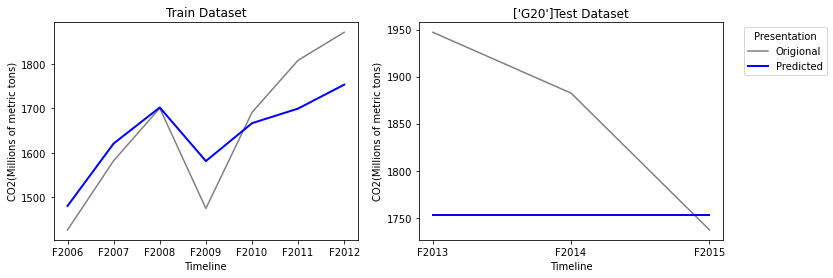

Origional Values:  [array([1947.098], dtype=object), array([1882.403], dtype=object), array([1737.099], dtype=object)]
Predicted Values:  [1753.31751 1753.31751 1753.31751]
Explained Variance Score: 2.220446049250313e-16
        Maximam Error   : 193.78048999999692
    Mean Absolute Error : 113.02816333333233
    Mean Squared Error  : 18158.994033266146
         r2 score       : -1.354971290835369


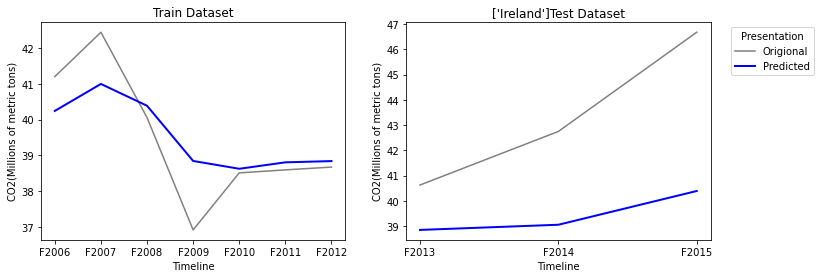

Origional Values:  [array([40.624], dtype=object), array([42.747], dtype=object), array([46.679], dtype=object)]
Predicted Values:  [38.84393 39.04881 40.38676]
Explained Variance Score: 0.45669194504442856
        Maximam Error   : 6.292240000000014
    Mean Absolute Error : 3.9234999999999993
    Mean Squared Error  : 18.812514232866747
         r2 score       : -1.9897634126764197


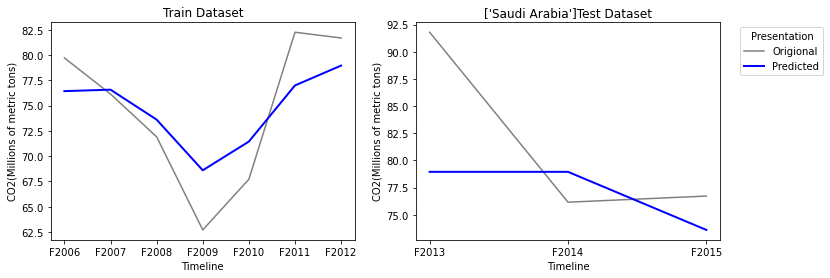

Origional Values:  [array([91.796], dtype=object), array([76.162], dtype=object), array([76.725], dtype=object)]
Predicted Values:  [78.9544  78.9544  73.61162]
Explained Variance Score: 0.20754590267690243
        Maximam Error   : 12.84160000000007
    Mean Absolute Error : 6.249126666666679
    Mean Squared Error  : 60.79910778146721
         r2 score       : -0.15961466293990134


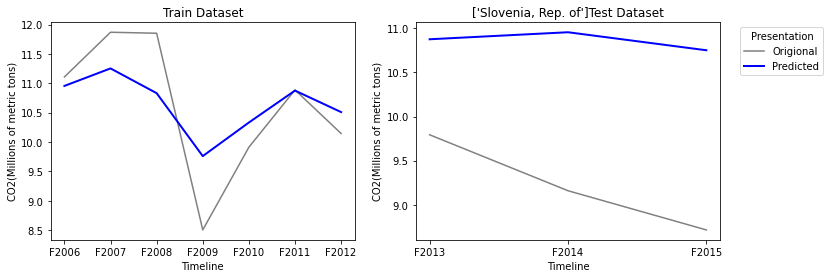

Origional Values:  [array([9.793], dtype=object), array([9.159], dtype=object), array([8.715], dtype=object)]
Predicted Values:  [10.87534 10.9549  10.75074]
Explained Variance Score: 0.16211516668408077
        Maximam Error   : 2.0357399999999757
    Mean Absolute Error : 1.6379933333333099
    Mean Squared Error  : 2.8469846777332557
         r2 score       : -13.548723182464066


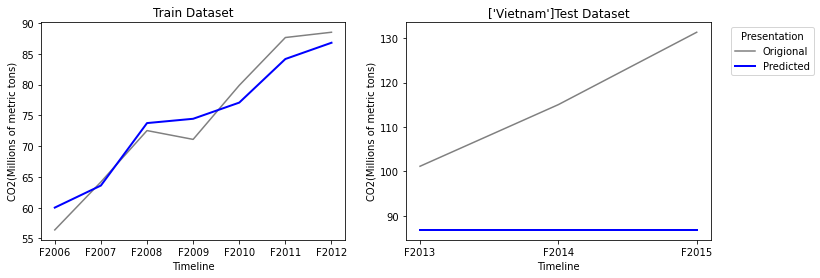

Origional Values:  [array([101.144], dtype=object), array([115.035], dtype=object), array([131.345], dtype=object)]
Predicted Values:  [86.79874 86.79874 86.79874]
Explained Variance Score: -2.220446049250313e-16
        Maximam Error   : 44.54625999999989
    Mean Absolute Error : 29.042593333333226
    Mean Squared Error  : 995.8140477475936
         r2 score       : -5.536708346368661


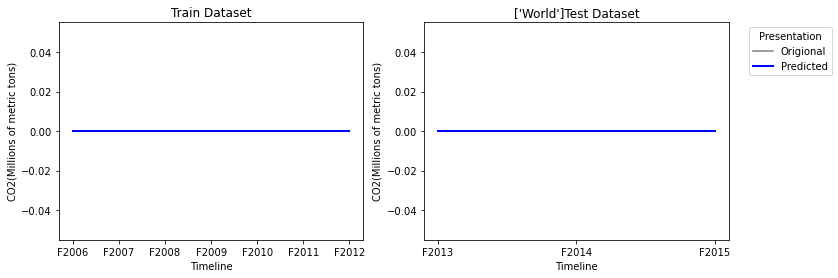

Origional Values:  [array([0.0], dtype=object), array([0.0], dtype=object), array([0.0], dtype=object)]
Predicted Values:  [0. 0. 0.]
Explained Variance Score: 1.0
        Maximam Error   : 0.0
    Mean Absolute Error : 0.0
    Mean Squared Error  : 0.0
         r2 score       : 1.0


In [30]:
i=0
VVIP2=list()
while i<len(CO2_Grass_ExpNOTAV_FINAL.T):
    series=CO2_Grass_ExpNOTAV_FINAL[CO2_Grass_ExpNOTAV_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    # Splitting the data into Train & Test
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=3,shuffle=False)
    # Fitting the model on Train dataset
    Model = RandomForestRegressor()
    Model = Model.fit(X_train, y_train)
    # Predicting and storing results for Test dataset
    train_fit = Model.predict(X_train)
    test_pred = Model.predict(X_test)
    plt.figure(figsize=(12,4))
    # Plotting Regression line on Train Dataset
    plt.subplot(1,2,1)
    plt.plot(y_train, color='gray')
    plt.plot(y_train.index,train_fit, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title("Train Dataset")
    # Plotting Regression line on Test Dataset
    plt.subplot(1,2,2)
    plt.plot(y_test, color='gray')
    plt.plot(y_test.index,test_pred, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title(str(X.columns.values)+"Test Dataset")
    plt.legend(['Origional','Predicted'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()
    pre=test_pred
    y_test=y_test
    y_test=np.array(y_test)
    VVIP2.append(pre)
    exp_rf=explained_variance_score(y_test,pre)
    mxer_rf=max_error(y_test,pre)
    mae_rf=mean_absolute_error(y_test,pre)
    mse_rf=mean_squared_error(y_test,pre)
    r2_rf=r2_score(y_test,pre)
    print("Origional Values: " , list(y_test))
    print("Predicted Values: " , pre)
    print("Explained Variance Score:",exp_rf)
    print("        Maximam Error   :",mxer_rf)
    print("    Mean Absolute Error :",mae_rf)
    print("    Mean Squared Error  :",mse_rf)
    print("         r2 score       :",r2_rf)
    i=i+1

# MLP

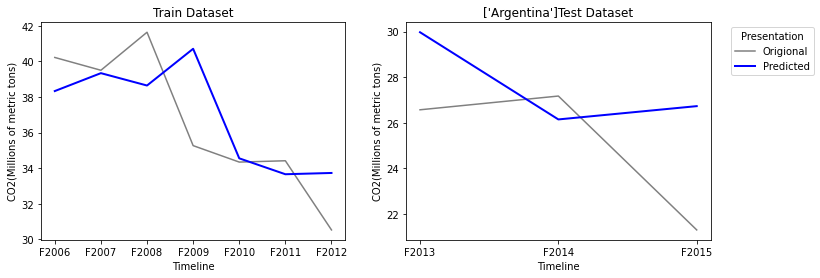

Origional Values:  [array([26.565], dtype=object), array([27.168], dtype=object), array([21.294], dtype=object)]
Predicted Values:  [29.96770163 26.14220591 26.72503345]
Explained Variance Score: -0.04413981202872508
        Maximam Error   : 5.431033448281557
    Mean Absolute Error : 3.286509722707038
    Mean Squared Error  : 14.0422520774339
         r2 score       : -1.0172131006795517


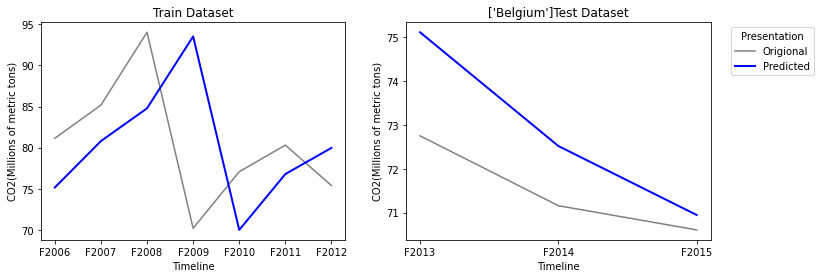

Origional Values:  [array([72.751], dtype=object), array([71.156], dtype=object), array([70.603], dtype=object)]
Predicted Values:  [75.11473119 72.51786975 70.94356568]
Explained Variance Score: 0.1773576454242024
        Maximam Error   : 2.363731186496608
    Mean Absolute Error : 1.3553888713275721
    Mean Squared Error  : 2.5192997705471734
         r2 score       : -2.037847514867805


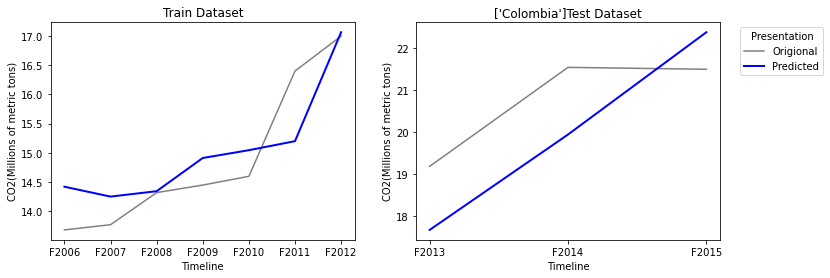

Origional Values:  [array([19.187], dtype=object), array([21.543], dtype=object), array([21.498], dtype=object)]
Predicted Values:  [17.67483812 19.9446891  22.37901335]
Explained Variance Score: -0.09072177863859854
        Maximam Error   : 1.5983108993804507
    Mean Absolute Error : 1.3304953761065452
    Mean Squared Error  : 1.8724719341138298
         r2 score       : -0.5470028230665351


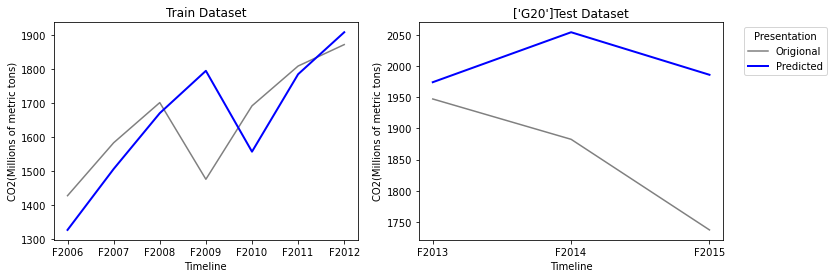

Origional Values:  [array([1947.098], dtype=object), array([1882.403], dtype=object), array([1737.099], dtype=object)]
Predicted Values:  [1973.99872974 2054.12371864 1985.89667418]
Explained Variance Score: -0.09731747260193768
        Maximam Error   : 248.7976741842965
    Mean Absolute Error : 149.1397075221906
    Mean Squared Error  : 30703.97904990995
         r2 score       : -2.981882974601273


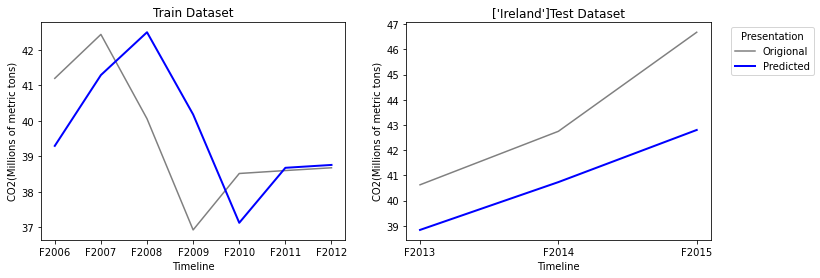

Origional Values:  [array([40.624], dtype=object), array([42.747], dtype=object), array([46.679], dtype=object)]
Predicted Values:  [38.83309786 40.73089465 42.80024368]
Explained Variance Score: 0.860865054530912
        Maximam Error   : 3.878756319707037
    Mean Absolute Error : 2.5619212693116205
    Mean Squared Error  : 7.438920613362601
         r2 score       : -0.18222436428938704


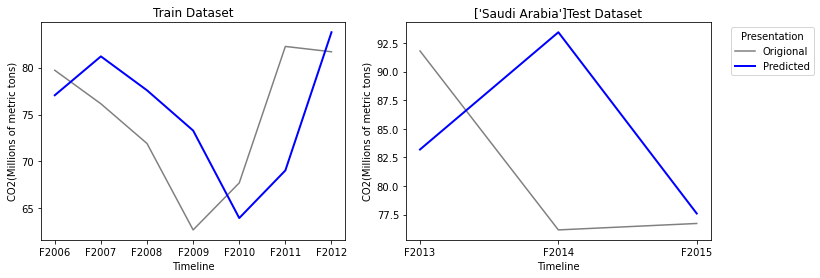

Origional Values:  [array([91.796], dtype=object), array([76.162], dtype=object), array([76.725], dtype=object)]
Predicted Values:  [83.18858754 93.43132963 77.59675732]
Explained Variance Score: -1.1792700849087265
        Maximam Error   : 17.269329626444275
    Mean Absolute Error : 8.916166468104516
    Mean Squared Error  : 124.35908525352482
         r2 score       : -1.371887088345371


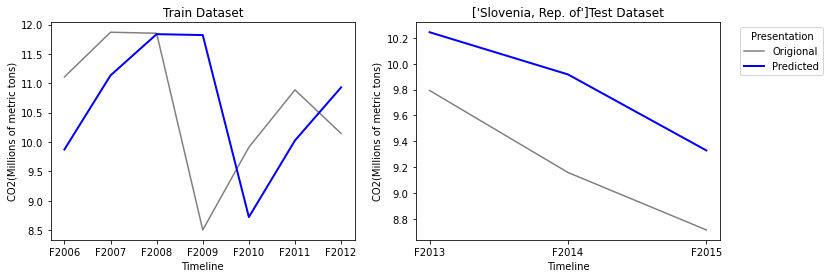

Origional Values:  [array([9.793], dtype=object), array([9.159], dtype=object), array([8.715], dtype=object)]
Predicted Values:  [10.24334701  9.9171779   9.32970284]
Explained Variance Score: 0.9191689070672328
        Maximam Error   : 0.7581778965211985
    Mean Absolute Error : 0.6077425827893533
    Mean Squared Error  : 0.3851685781495806
         r2 score       : -0.9682968671763807


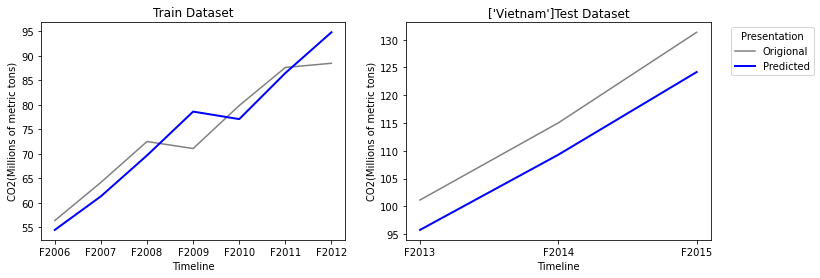

Origional Values:  [array([101.144], dtype=object), array([115.035], dtype=object), array([131.345], dtype=object)]
Predicted Values:  [ 95.75858916 109.30113146 124.18635501]
Explained Variance Score: 0.9961375090869726
        Maximam Error   : 7.158644994211556
    Mean Absolute Error : 6.0926414588294096
    Mean Squared Error  : 37.708698842129344
         r2 score       : 0.7524730977539629


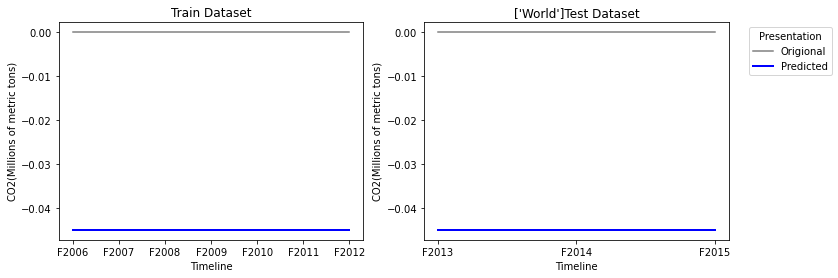

Origional Values:  [array([0.0], dtype=object), array([0.0], dtype=object), array([0.0], dtype=object)]
Predicted Values:  [-0.04506452 -0.04506452 -0.04506452]
Explained Variance Score: 1.0
        Maximam Error   : 0.04506451745651352
    Mean Absolute Error : 0.04506451745651352
    Mean Squared Error  : 0.002030810733588412
         r2 score       : 0.0


In [31]:
i=0
VVIP3=list()
VVIP4=list()
while i<len(CO2_Grass_ExpNOTAV_FINAL.T):
    series=CO2_Grass_ExpNOTAV_FINAL[CO2_Grass_ExpNOTAV_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    # Splitting the data into Train & Test
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=3,shuffle=False)
    # Fitting the model on Train dataset
    Model = MLPRegressor ()
    Model = Model.fit(X_train, y_train)
    # Predicting and storing results for Test dataset
    train_fit = Model.predict(X_train)
    test_pred = Model.predict(X_test)
    plt.figure(figsize=(12,4))
    # Plotting Regression line on Train Dataset
    plt.subplot(1,2,1)
    plt.plot(y_train, color='gray')
    plt.plot(y_train.index,train_fit, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title("Train Dataset")
    # Plotting Regression line on Test Dataset
    plt.subplot(1,2,2)
    plt.plot(y_test, color='gray')
    plt.plot(y_test.index,test_pred, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title(str(X.columns.values)+"Test Dataset")
    plt.legend(['Origional','Predicted'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()
    pre=test_pred
    y_test=y_test
    y_test=np.array(y_test)
    VVIP3.append(pre)
    VVIP4.append(y_test)
    exp_rf=explained_variance_score(y_test,pre)
    mxer_rf=max_error(y_test,pre)
    mae_rf=mean_absolute_error(y_test,pre)
    mse_rf=mean_squared_error(y_test,pre)
    r2_rf=r2_score(y_test,pre)
    print("Origional Values: " , list(y_test))
    print("Predicted Values: " , pre)
    print("Explained Variance Score:",exp_rf)
    print("        Maximam Error   :",mxer_rf)
    print("    Mean Absolute Error :",mae_rf)
    print("    Mean Squared Error  :",mse_rf)
    print("         r2 score       :",r2_rf)
    i=i+1

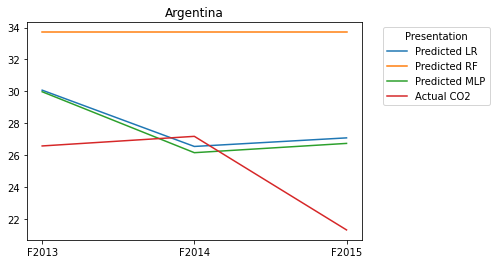

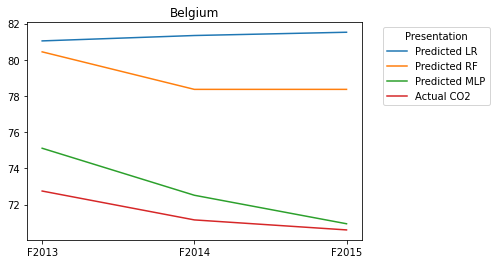

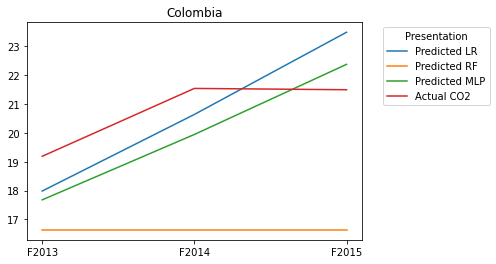

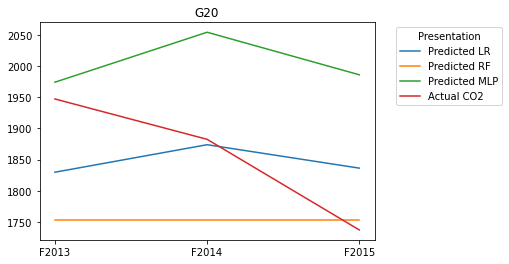

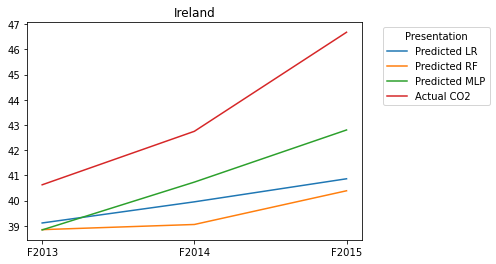

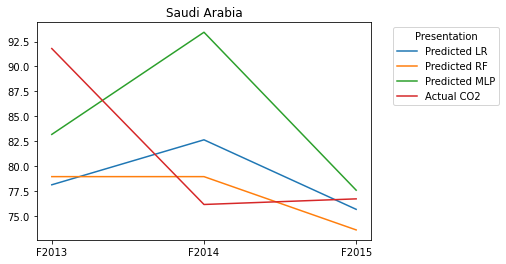

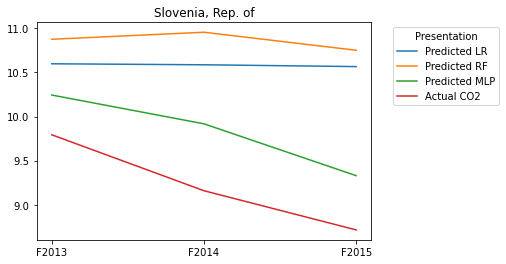

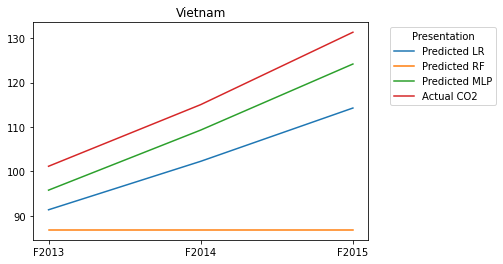

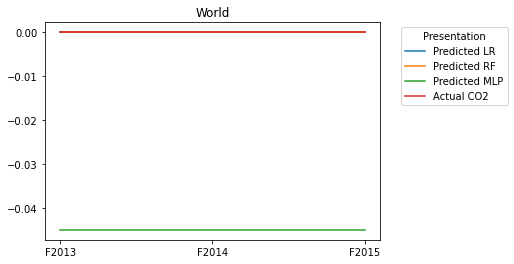

In [32]:
seeno=Y.index[-3:]
i=0
while i<len(VVIP1):
    plt.plot(seeno,VVIP1[i])
    plt.plot(seeno,VVIP2[i])
    plt.plot(seeno,VVIP3[i])
    plt.plot(seeno,VVIP4[i])
    plt.legend(['Predicted LR','Predicted RF','Predicted MLP'
               ,'Actual CO2'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.title(str(CO2_Grass_ExpNOTAV_FINAL.columns[i]))
    i=i+1
    plt.show()

### the above figure shows that in most of the cases MLP is better then RF and LR

# MLP to predict missing data

In [33]:
i=0
list_2016=list()
list_2017=list()
list_2018=list()
list_2019=list()
while i<len(CO2_Grass_ExpNOTAV_FINAL.T):
    series=CO2_Grass_ExpNOTAV_FINAL[CO2_Grass_ExpNOTAV_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    Model = MLPRegressor()
    Model = Model.fit(X, Y)
    train_fit = Model.predict(Y[-1:]) 
    list_2016.append(train_fit[0])
    train_fit=Model.predict(pd.DataFrame(train_fit)) 
    list_2017.append(train_fit[0])
    train_fit=Model.predict(pd.DataFrame(train_fit)) 
    list_2018.append(train_fit[0])
    train_fit=Model.predict(pd.DataFrame(train_fit)) 
    list_2019.append(train_fit[0])
    i=i+1

In [34]:
CO2_Grass_ExpNOTAV['F2016']=list_2016
CO2_Grass_ExpNOTAV['F2017']=list_2017
CO2_Grass_ExpNOTAV['F2018']=list_2018
CO2_Grass_ExpNOTAV['F2019']=list_2019

In [35]:
CO2_Grass_Exp=pd.concat([CO2_Grass_ExpNOTAV,CO2_Grass_ExpAV])

## Working for C02 Emissions Embodied in Gross Imports

In [36]:
CO2_Grass_IMP=Actual_df[Actual_df['Indicator']=='C02 Emissions Embodied in Gross Imports']

In [37]:
CO2_Grass_IMP.isnull().sum()

ObjectId     0
Country      0
ISO2         2
ISO3         0
Indicator    0
Code         0
Unit         0
F2005        0
F2006        0
F2007        0
F2008        0
F2009        0
F2010        0
F2011        0
F2012        0
F2013        0
F2014        0
F2015        0
F2016        9
F2017        9
F2018        9
F2019        9
dtype: int64

In [38]:
CO2_Grass_IMPNOTAV=CO2_Grass_IMP[CO2_Grass_IMP['F2019'].isna()]
CO2_Grass_IMPAV=CO2_Grass_IMP[~CO2_Grass_IMP['F2019'].isna()]

In [39]:
CO2_Grass_IMPNOTAV_FINAL=CO2_Grass_IMPNOTAV[['Country','F2005', 'F2006', 'F2007', 'F2008', 'F2009', 'F2010', 'F2011', 'F2012',
       'F2013', 'F2014', 'F2015']]

In [40]:
CO2_Grass_IMPNOTAV_FINAL=CO2_Grass_IMPNOTAV_FINAL.T
CO2_Grass_IMPNOTAV_FINAL.columns=CO2_Grass_IMPNOTAV_FINAL.iloc[0]
CO2_Grass_IMPNOTAV_FINAL=CO2_Grass_IMPNOTAV_FINAL.iloc[1:]

In [41]:
CO2_Grass_IMPNOTAV_FINAL

Country,Argentina,Belgium,Colombia,G20,Ireland,Saudi Arabia,"Slovenia, Rep. of",Vietnam,World
F2005,28.14,87.83,21.1,1484.69,41.17,55.03,11.79,46.01,0.0
F2006,32.24,92.67,23.54,1600.61,45.02,70.23,13.27,53.52,0.0
F2007,37.97,99.73,27.97,1629.4,48.96,87.93,14.91,67.43,0.0
F2008,41.69,113.26,31.17,1719.69,45.76,104.24,15.52,75.26,0.0
F2009,30.43,90.02,24.33,1383.64,39.46,90.07,10.65,68.95,0.0
F2010,40.14,89.81,29.22,1558.79,38.46,94.8,11.94,74.46,0.0
F2011,47.78,99.17,36.18,1708.0,34.98,102.58,12.45,78.4,0.0
F2012,44.06,90.75,39.56,1667.58,34.71,112.94,11.03,77.21,0.0
F2013,47.05,88.39,39.71,1643.66,36.59,118.3,10.59,90.8,0.0
F2014,41.76,87.94,42.57,1605.44,39.88,130.3,10.68,99.28,0.0


# Linear Regression

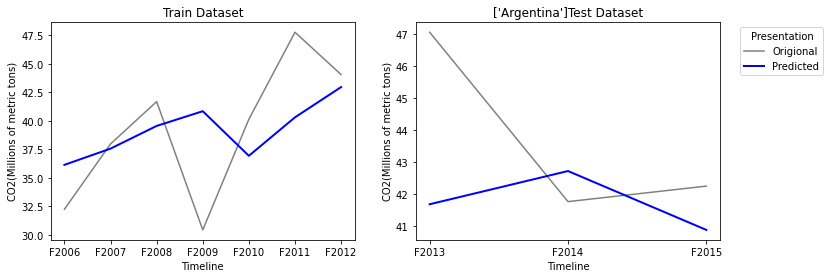

Origional Values:  [array([47.053], dtype=object), array([41.757], dtype=object), array([42.242], dtype=object)]
Predicted Values:  [[41.67489363]
 [42.7136682 ]
 [40.87252022]]
Explained Variance Score: -0.19796117542287583
        Maximam Error   : 5.3781063748623055
    Mean Absolute Error : 2.5680847851954547
    Mean Squared Error  : 10.571572363747398
         r2 score       : -0.8500255028271373


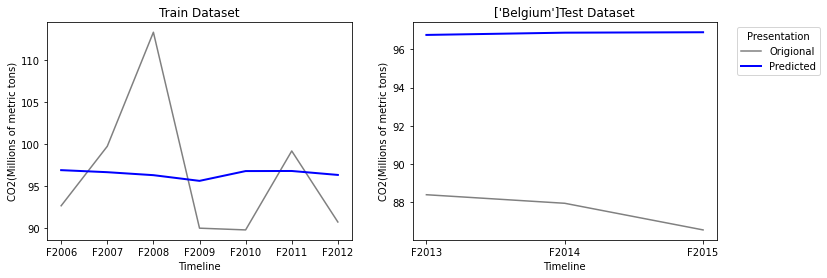

Origional Values:  [array([88.389], dtype=object), array([87.941], dtype=object), array([86.547], dtype=object)]
Predicted Values:  [[96.75316741]
 [96.87107764]
 [96.89347008]]
Explained Variance Score: -0.12986351987760503
        Maximam Error   : 10.346470084693337
    Mean Absolute Error : 9.213571710914016
    Mean Squared Error  : 85.58500876578438
         r2 score       : -138.11476140674623


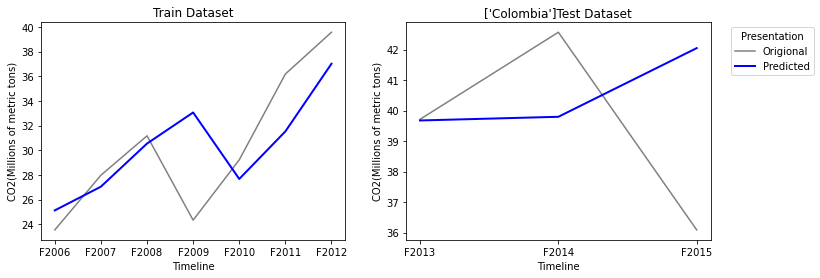

Origional Values:  [array([39.714], dtype=object), array([42.571], dtype=object), array([36.086], dtype=object)]
Predicted Values:  [[39.67676232]
 [39.79739064]
 [42.04990769]]
Explained Variance Score: -0.8909051802002568
        Maximam Error   : 5.963907693104048
    Mean Absolute Error : 2.924918243839123
    Mean Squared Error  : 14.420830165083494
         r2 score       : -1.04776511068752


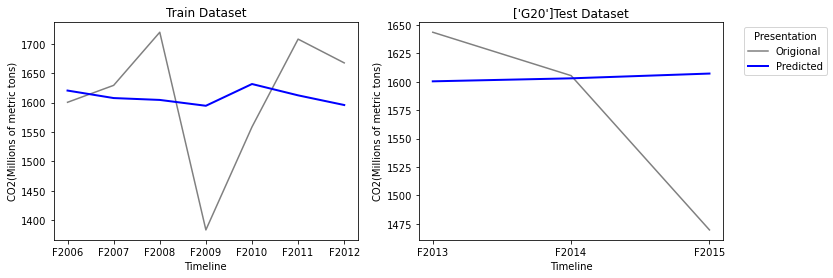

Origional Values:  [array([1643.656], dtype=object), array([1605.442], dtype=object), array([1469.532], dtype=object)]
Predicted Values:  [[1600.42234761]
 [1603.05588092]
 [1607.26226928]]
Explained Variance Score: -0.07558175049371241
        Maximam Error   : 137.73026928490413
    Mean Absolute Error : 61.11668025287986
    Mean Squared Error  : 6948.156446838652
         r2 score       : -0.24442103562038842


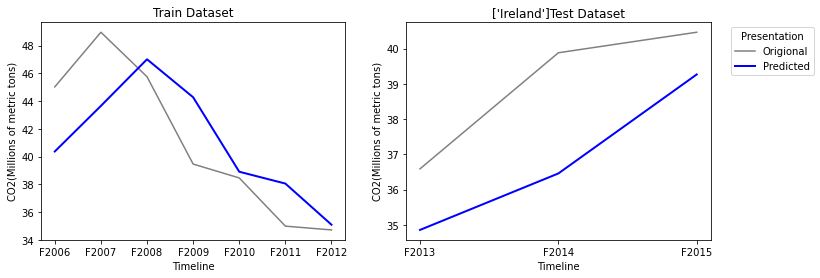

Origional Values:  [array([36.589], dtype=object), array([39.88], dtype=object), array([40.462], dtype=object)]
Predicted Values:  [[34.85641202]
 [36.45756173]
 [39.2649052 ]]
Explained Variance Score: 0.6906899258749328
        Maximam Error   : 3.422438267619789
    Mean Absolute Error : 2.1173736809890187
    Mean Squared Error  : 5.382660249540375
         r2 score       : -0.8511580009740813


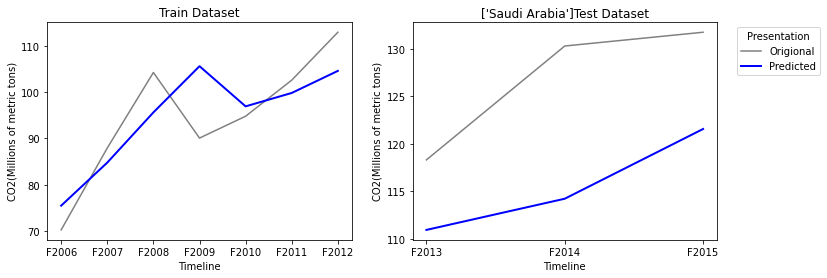

Origional Values:  [array([118.302], dtype=object), array([130.301], dtype=object), array([131.752], dtype=object)]
Predicted Values:  [[110.92484801]
 [114.21124004]
 [121.55862553]]
Explained Variance Score: 0.6372665202068613
        Maximam Error   : 16.089759964757093
    Mean Absolute Error : 11.220095476157937
    Mean Squared Error  : 139.06921011729963
         r2 score       : -2.827781378227293


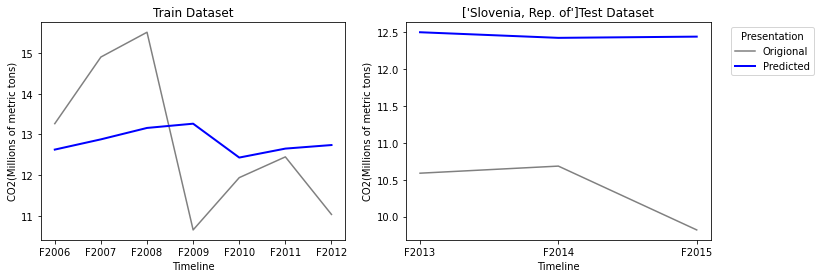

Origional Values:  [array([10.588], dtype=object), array([10.684], dtype=object), array([9.82], dtype=object)]
Predicted Values:  [[12.49644351]
 [12.42053745]
 [12.43698662]]
Explained Variance Score: 0.02880653729103655
        Maximam Error   : 2.6169866152368044
    Mean Absolute Error : 2.087322523792741
    Mean Squared Error  : 4.502112625781339
         r2 score       : -29.113660007634245


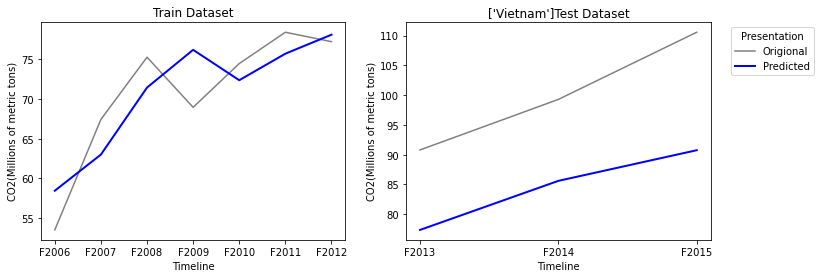

Origional Values:  [array([90.799], dtype=object), array([99.284], dtype=object), array([110.562], dtype=object)]
Predicted Values:  [[77.36814969]
 [85.60710033]
 [90.75189694]]
Explained Variance Score: 0.867113795050057
        Maximam Error   : 19.810103062888786
    Mean Absolute Error : 15.639284346402746
    Mean Squared Error  : 253.29516929796523
         r2 score       : -2.8653663210425253


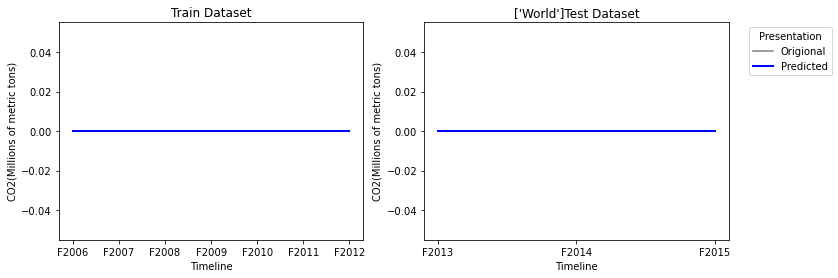

Origional Values:  [array([0.0], dtype=object), array([0.0], dtype=object), array([0.0], dtype=object)]
Predicted Values:  [[0.]
 [0.]
 [0.]]
Explained Variance Score: 1.0
        Maximam Error   : 0.0
    Mean Absolute Error : 0.0
    Mean Squared Error  : 0.0
         r2 score       : 1.0


In [42]:
i=0
VVIP1=list()
while i<len(CO2_Grass_IMPNOTAV_FINAL.T):
    series=CO2_Grass_IMPNOTAV_FINAL[CO2_Grass_IMPNOTAV_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    # Splitting the data into Train & Test
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=3,shuffle=False)
    # Fitting the model on Train dataset
    Model = LinearRegression()
    Model = Model.fit(X_train, y_train)
    # Predicting and storing results for Test dataset
    train_fit = Model.predict(X_train)
    test_pred = Model.predict(X_test)
    plt.figure(figsize=(12,4))
    # Plotting Regression line on Train Dataset
    plt.subplot(1,2,1)
    plt.plot(y_train, color='gray')
    plt.plot(y_train.index,train_fit, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title("Train Dataset")
    # Plotting Regression line on Test Dataset
    plt.subplot(1,2,2)
    plt.plot(y_test, color='gray')
    plt.plot(y_test.index,test_pred, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title(str(X.columns.values)+"Test Dataset")
    plt.legend(['Origional','Predicted'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()
    pre=test_pred
    y_test=y_test
    y_test=np.array(y_test)
    VVIP1.append(pre)
    exp_rf=explained_variance_score(y_test,pre)
    mxer_rf=max_error(y_test,pre)
    mae_rf=mean_absolute_error(y_test,pre)
    mse_rf=mean_squared_error(y_test,pre)
    r2_rf=r2_score(y_test,pre)
    print("Origional Values: " , list(y_test))
    print("Predicted Values: " , pre)
    print("Explained Variance Score:",exp_rf)
    print("        Maximam Error   :",mxer_rf)
    print("    Mean Absolute Error :",mae_rf)
    print("    Mean Squared Error  :",mse_rf)
    print("         r2 score       :",r2_rf)
    i=i+1

# Random Forest

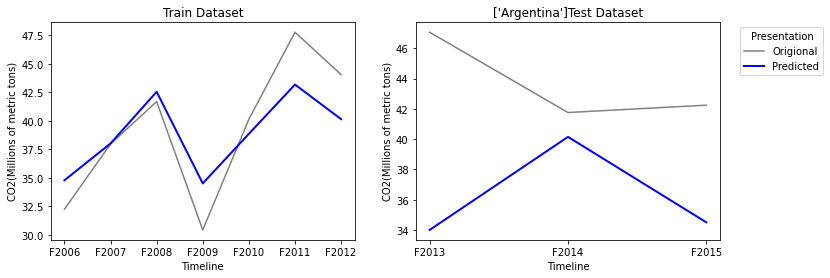

Origional Values:  [array([47.053], dtype=object), array([41.757], dtype=object), array([42.242], dtype=object)]
Predicted Values:  [34.01317 40.15027 34.51293]
Explained Variance Score: -2.818947814702663
        Maximam Error   : 13.039829999999974
    Mean Absolute Error : 7.458543333333303
    Mean Squared Error  : 77.45242359556626
         r2 score       : -12.554176614156477


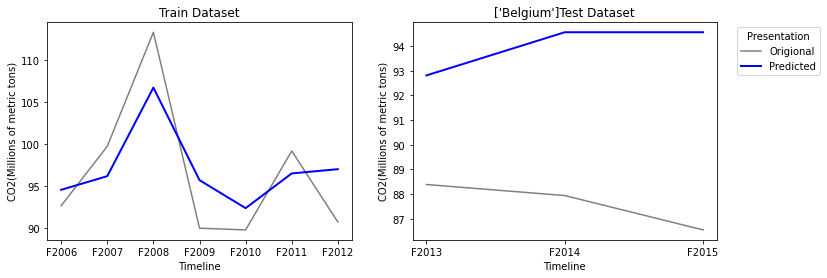

Origional Values:  [array([88.389], dtype=object), array([87.941], dtype=object), array([86.547], dtype=object)]
Predicted Values:  [92.81341 94.56478 94.56478]
Explained Variance Score: -2.5566396588780576
        Maximam Error   : 8.017780000000073
    Mean Absolute Error : 6.355323333333388
    Mean Squared Error  : 42.57822048830076
         r2 score       : -68.20907142235201


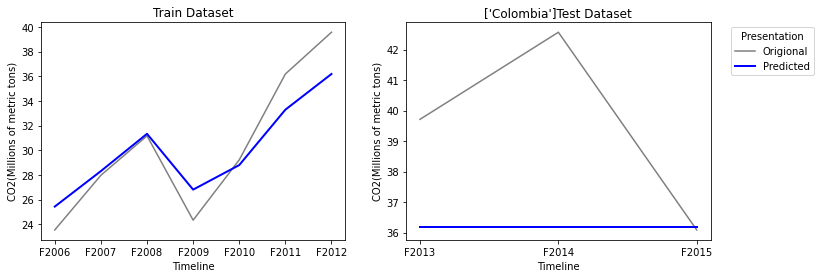

Origional Values:  [array([39.714], dtype=object), array([42.571], dtype=object), array([36.086], dtype=object)]
Predicted Values:  [36.1785 36.1785 36.1785]
Explained Variance Score: 1.1102230246251565e-16
        Maximam Error   : 6.39249999999997
    Mean Absolute Error : 3.3401666666666565
    Mean Squared Error  : 17.79079091666647
         r2 score       : -1.5263012263257667


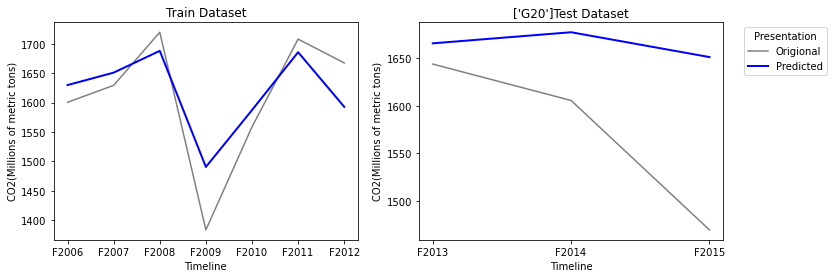

Origional Values:  [array([1643.656], dtype=object), array([1605.442], dtype=object), array([1469.532], dtype=object)]
Predicted Values:  [1665.44546 1677.08846 1651.01477]
Explained Variance Score: 0.2029674135794991
        Maximam Error   : 181.48276999999985
    Mean Absolute Error : 91.63956333333287
    Mean Squared Error  : 12847.99720149864
         r2 score       : -1.3010877929225857


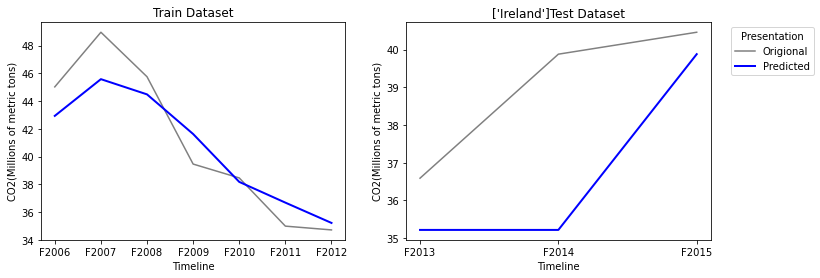

Origional Values:  [array([36.589], dtype=object), array([39.88], dtype=object), array([40.462], dtype=object)]
Predicted Values:  [35.21609 35.21609 39.88045]
Explained Variance Score: -0.07463108892959158
        Maximam Error   : 4.663910000000001
    Mean Absolute Error : 2.2061233333333328
    Mean Squared Error  : 7.991712919566669
         r2 score       : -1.7484408501924356


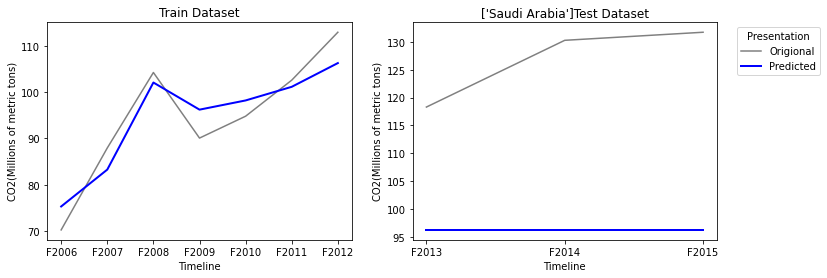

Origional Values:  [array([118.302], dtype=object), array([130.301], dtype=object), array([131.752], dtype=object)]
Predicted Values:  [96.21319 96.21319 96.21319]
Explained Variance Score: -4.440892098500626e-16
        Maximam Error   : 35.538810000000026
    Mean Absolute Error : 30.571810000000017
    Mean Squared Error  : 970.9671113427677
         r2 score       : -25.725181113304224


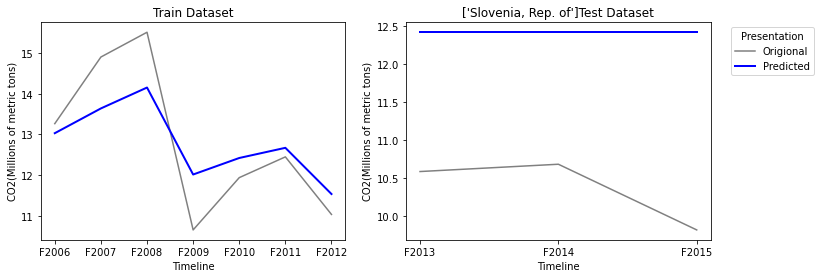

Origional Values:  [array([10.588], dtype=object), array([10.684], dtype=object), array([9.82], dtype=object)]
Predicted Values:  [12.42053 12.42053 12.42053]
Explained Variance Score: 0.0
        Maximam Error   : 2.600529999999994
    Mean Absolute Error : 2.0565299999999946
    Mean Squared Error  : 4.378819640899977
         r2 score       : -28.288979832646536


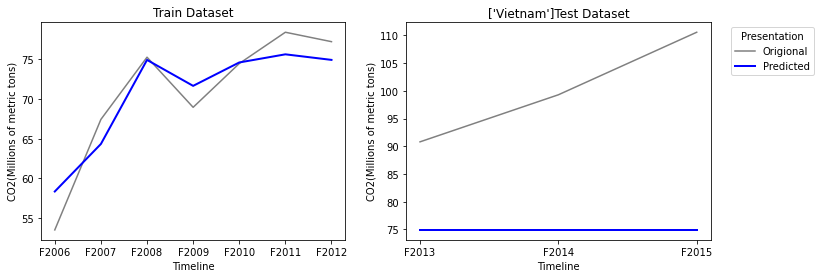

Origional Values:  [array([90.799], dtype=object), array([99.284], dtype=object), array([110.562], dtype=object)]
Predicted Values:  [74.91723 74.91723 74.91723]
Explained Variance Score: -2.220446049250313e-16
        Maximam Error   : 35.64476999999992
    Mean Absolute Error : 25.29776999999993
    Mean Squared Error  : 705.506575639563
         r2 score       : -9.76625884461001


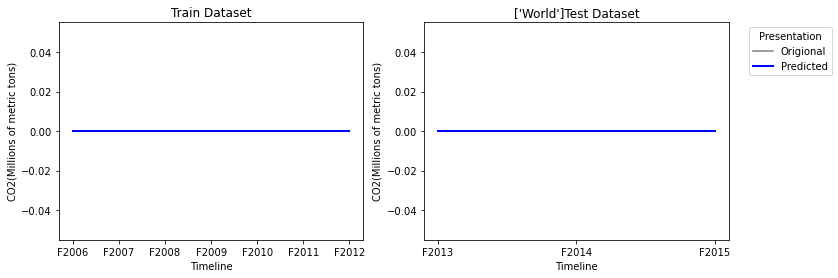

Origional Values:  [array([0.0], dtype=object), array([0.0], dtype=object), array([0.0], dtype=object)]
Predicted Values:  [0. 0. 0.]
Explained Variance Score: 1.0
        Maximam Error   : 0.0
    Mean Absolute Error : 0.0
    Mean Squared Error  : 0.0
         r2 score       : 1.0


In [43]:
i=0
VVIP2=list()
while i<len(CO2_Grass_IMPNOTAV_FINAL.T):
    series=CO2_Grass_IMPNOTAV_FINAL[CO2_Grass_IMPNOTAV_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    # Splitting the data into Train & Test
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=3,shuffle=False)
    # Fitting the model on Train dataset
    Model = RandomForestRegressor()
    Model = Model.fit(X_train, y_train)
    # Predicting and storing results for Test dataset
    train_fit = Model.predict(X_train)
    test_pred = Model.predict(X_test)
    plt.figure(figsize=(12,4))
    # Plotting Regression line on Train Dataset
    plt.subplot(1,2,1)
    plt.plot(y_train, color='gray')
    plt.plot(y_train.index,train_fit, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title("Train Dataset")
    # Plotting Regression line on Test Dataset
    plt.subplot(1,2,2)
    plt.plot(y_test, color='gray')
    plt.plot(y_test.index,test_pred, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title(str(X.columns.values)+"Test Dataset")
    plt.legend(['Origional','Predicted'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()
    pre=test_pred
    y_test=y_test
    y_test=np.array(y_test)
    VVIP2.append(pre)
    exp_rf=explained_variance_score(y_test,pre)
    mxer_rf=max_error(y_test,pre)
    mae_rf=mean_absolute_error(y_test,pre)
    mse_rf=mean_squared_error(y_test,pre)
    r2_rf=r2_score(y_test,pre)
    print("Origional Values: " , list(y_test))
    print("Predicted Values: " , pre)
    print("Explained Variance Score:",exp_rf)
    print("        Maximam Error   :",mxer_rf)
    print("    Mean Absolute Error :",mae_rf)
    print("    Mean Squared Error  :",mse_rf)
    print("         r2 score       :",r2_rf)
    i=i+1

# MLP

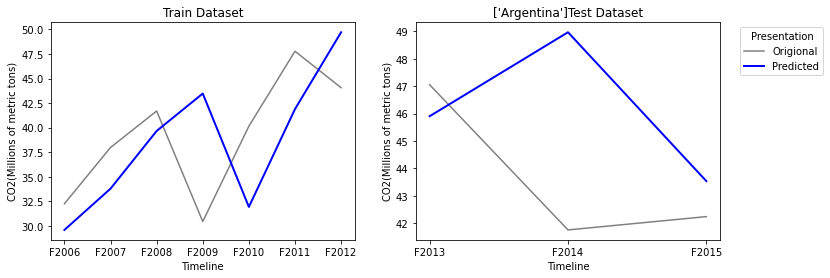

Origional Values:  [array([47.053], dtype=object), array([41.757], dtype=object), array([42.242], dtype=object)]
Predicted Values:  [45.90472983 48.96925918 43.53761679]
Explained Variance Score: -1.1559555117022091
        Maximam Error   : 7.212259179955403
    Mean Absolute Error : 3.218715381862019
    Mean Squared Error  : 18.33794324746315
         r2 score       : -2.209140656648506


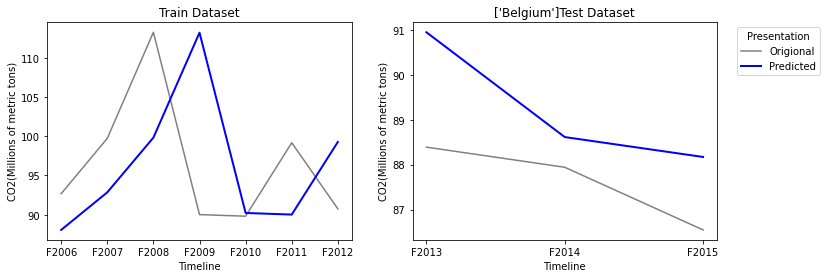

Origional Values:  [array([88.389], dtype=object), array([87.941], dtype=object), array([86.547], dtype=object)]
Predicted Values:  [90.94594334 88.61334169 88.17035503]
Explained Variance Score: 0.03777690621051699
        Maximam Error   : 2.556943343644818
    Mean Absolute Error : 1.6175466875354658
    Mean Squared Error  : 3.208428052678665
         r2 score       : -4.215162205107396


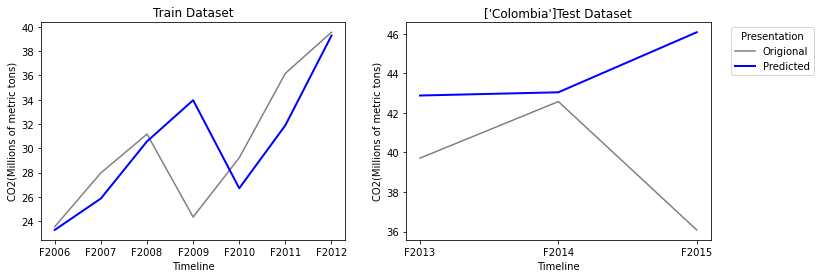

Origional Values:  [array([39.714], dtype=object), array([42.571], dtype=object), array([36.086], dtype=object)]
Predicted Values:  [42.8766813  43.03917671 46.07348658]
Explained Variance Score: -1.2791961204419726
        Maximam Error   : 9.987486576831685
    Mean Absolute Error : 4.53944819606285
    Mean Squared Error  : 36.65721018107017
         r2 score       : -4.205342217099762


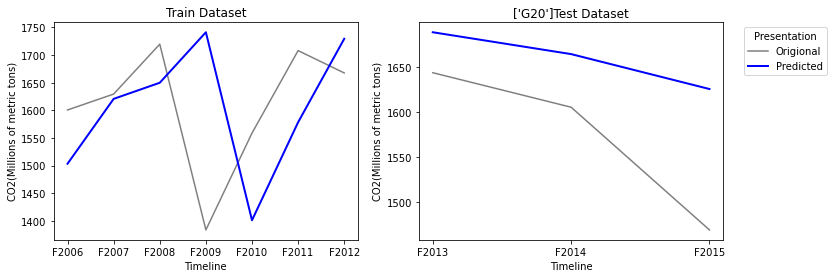

Origional Values:  [array([1643.656], dtype=object), array([1605.442], dtype=object), array([1469.532], dtype=object)]
Predicted Values:  [1688.4832267  1664.26976663 1625.59502626]
Explained Variance Score: 0.5617179433834214
        Maximam Error   : 156.0630262618747
    Mean Absolute Error : 86.5726731978338
    Mean Squared Error  : 9941.95151547034
         r2 score       : -0.7806124107349981


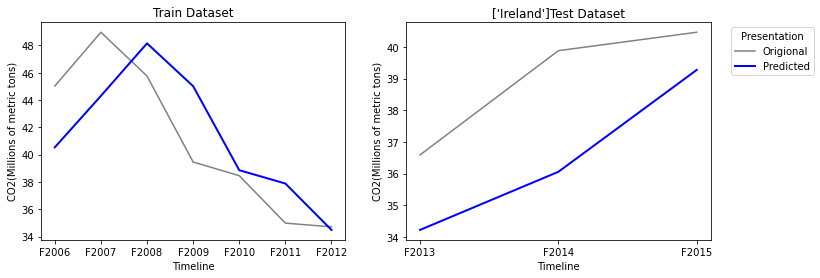

Origional Values:  [array([36.589], dtype=object), array([39.88], dtype=object), array([40.462], dtype=object)]
Predicted Values:  [34.22087261 36.05549406 39.27219047]
Explained Variance Score: 0.6006387939210931
        Maximam Error   : 3.8245059448453134
    Mean Absolute Error : 2.4608142879907198
    Mean Squared Error  : 7.216839922286272
         r2 score       : -1.4819532247145206


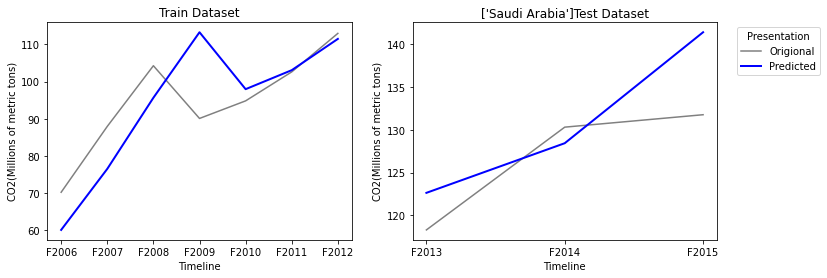

Origional Values:  [array([118.302], dtype=object), array([130.301], dtype=object), array([131.752], dtype=object)]
Predicted Values:  [122.63024308 128.42547585 141.38187568]
Explained Variance Score: 0.3915044122816692
        Maximam Error   : 9.629875684077973
    Mean Absolute Error : 5.277880973380931
    Mean Squared Error  : 38.328594905760944
         r2 score       : -0.05496739148904317


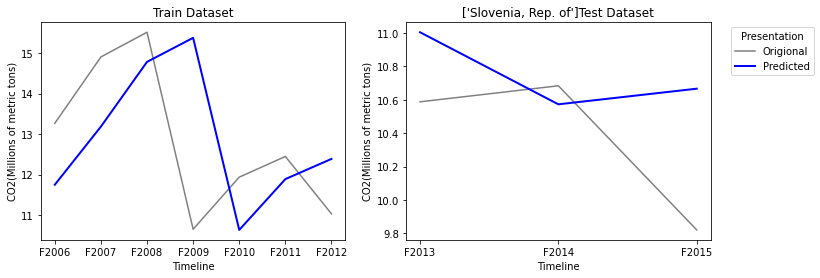

Origional Values:  [array([10.588], dtype=object), array([10.684], dtype=object), array([9.82], dtype=object)]
Predicted Values:  [11.00505095 10.57298479 10.66661538]
Explained Variance Score: -0.025937483281288864
        Maximam Error   : 0.8466153777181216
    Mean Absolute Error : 0.45822717999307905
    Mean Squared Error  : 0.30100448991309287
         r2 score       : -1.0133540902791474


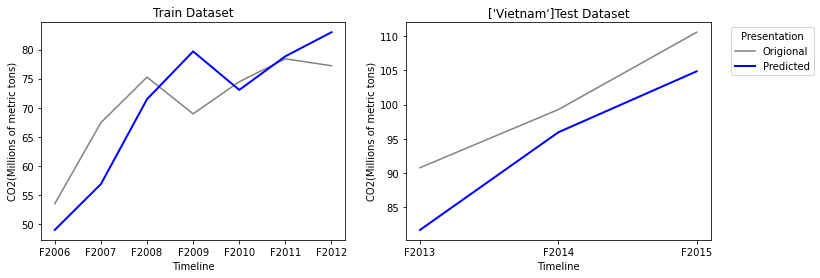

Origional Values:  [array([90.799], dtype=object), array([99.284], dtype=object), array([110.562], dtype=object)]
Predicted Values:  [ 81.72150024  95.96734313 104.86313183]
Explained Variance Score: 0.9147500779665544
        Maximam Error   : 9.077499755957405
    Mean Absolute Error : 6.031008265223136
    Mean Squared Error  : 41.959437674920906
         r2 score       : 0.35968539120566223


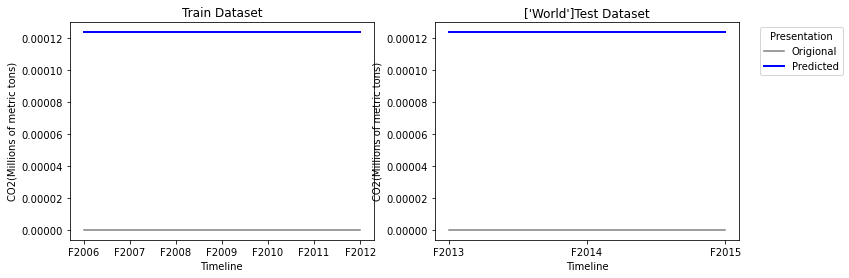

Origional Values:  [array([0.0], dtype=object), array([0.0], dtype=object), array([0.0], dtype=object)]
Predicted Values:  [0.00012388 0.00012388 0.00012388]
Explained Variance Score: 1.0
        Maximam Error   : 0.00012387792769983155
    Mean Absolute Error : 0.00012387792769983155
    Mean Squared Error  : 1.5345740971204692e-08
         r2 score       : 0.0


In [44]:
i=0
VVIP3=list()
VVIP4=list()
while i<len(CO2_Grass_IMPNOTAV_FINAL.T):
    series=CO2_Grass_IMPNOTAV_FINAL[CO2_Grass_IMPNOTAV_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    # Splitting the data into Train & Test
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=3,shuffle=False)
    # Fitting the model on Train dataset
    Model = MLPRegressor ()
    Model = Model.fit(X_train, y_train)
    # Predicting and storing results for Test dataset
    train_fit = Model.predict(X_train)
    test_pred = Model.predict(X_test)
    plt.figure(figsize=(12,4))
    # Plotting Regression line on Train Dataset
    plt.subplot(1,2,1)
    plt.plot(y_train, color='gray')
    plt.plot(y_train.index,train_fit, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title("Train Dataset")
    # Plotting Regression line on Test Dataset
    plt.subplot(1,2,2)
    plt.plot(y_test, color='gray')
    plt.plot(y_test.index,test_pred, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title(str(X.columns.values)+"Test Dataset")
    plt.legend(['Origional','Predicted'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()
    pre=test_pred
    y_test=y_test
    y_test=np.array(y_test)
    VVIP3.append(pre)
    VVIP4.append(y_test)
    exp_rf=explained_variance_score(y_test,pre)
    mxer_rf=max_error(y_test,pre)
    mae_rf=mean_absolute_error(y_test,pre)
    mse_rf=mean_squared_error(y_test,pre)
    r2_rf=r2_score(y_test,pre)
    print("Origional Values: " , list(y_test))
    print("Predicted Values: " , pre)
    print("Explained Variance Score:",exp_rf)
    print("        Maximam Error   :",mxer_rf)
    print("    Mean Absolute Error :",mae_rf)
    print("    Mean Squared Error  :",mse_rf)
    print("         r2 score       :",r2_rf)
    i=i+1

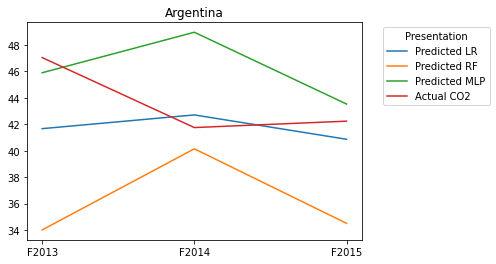

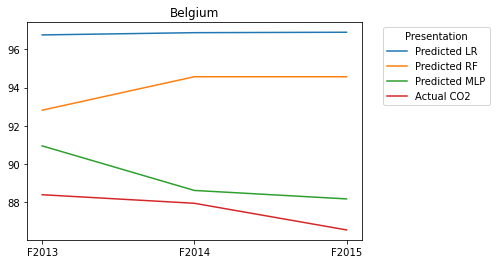

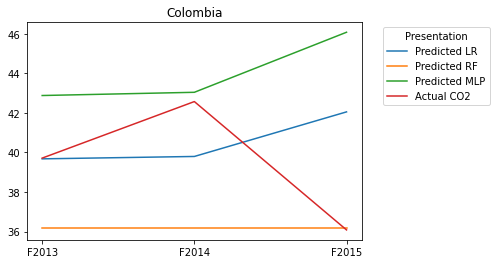

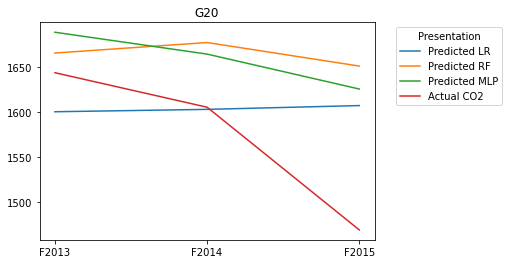

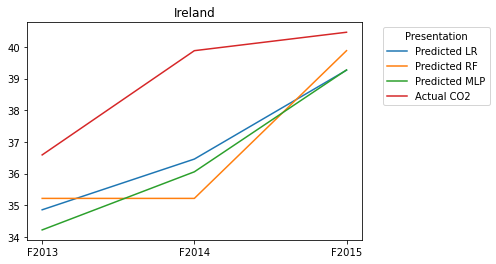

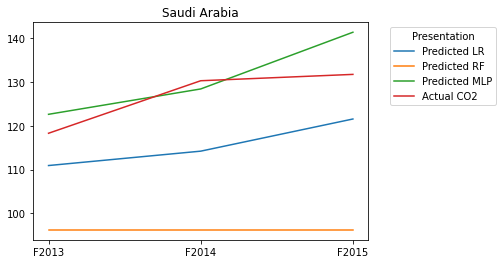

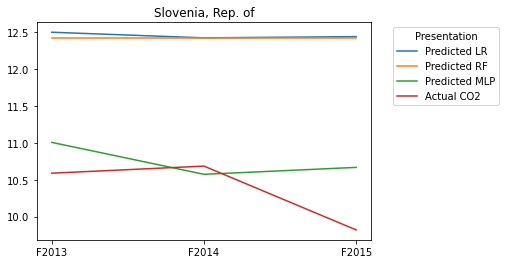

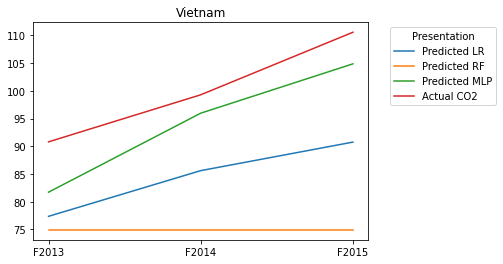

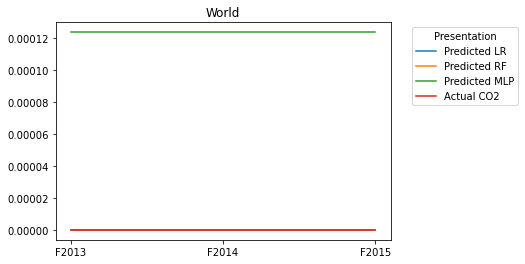

In [45]:
seeno=Y.index[-3:]
i=0
while i<len(VVIP1):
    plt.plot(seeno,VVIP1[i])
    plt.plot(seeno,VVIP2[i])
    plt.plot(seeno,VVIP3[i])
    plt.plot(seeno,VVIP4[i])
    plt.legend(['Predicted LR','Predicted RF','Predicted MLP'
               ,'Actual CO2'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.title(str(CO2_Grass_IMPNOTAV_FINAL.columns[i]))
    i=i+1
    plt.show()

## the above analysis shows that MLP is better then other 2 in most cases

In [46]:
i=0
list_2016=list()
list_2017=list()
list_2018=list()
list_2019=list()
while i<len(CO2_Grass_IMPNOTAV_FINAL.T):
    series=CO2_Grass_IMPNOTAV_FINAL[CO2_Grass_IMPNOTAV_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    Model = MLPRegressor()
    Model = Model.fit(X, Y)
    train_fit = Model.predict(Y[-1:]) 
    list_2016.append(train_fit[0])
    train_fit=Model.predict(pd.DataFrame(train_fit)) 
    list_2017.append(train_fit[0])
    train_fit=Model.predict(pd.DataFrame(train_fit)) 
    list_2018.append(train_fit[0])
    train_fit=Model.predict(pd.DataFrame(train_fit)) 
    list_2019.append(train_fit[0])
    i=i+1

In [47]:
CO2_Grass_IMPNOTAV['F2016']=list_2016
CO2_Grass_IMPNOTAV['F2017']=list_2017
CO2_Grass_IMPNOTAV['F2018']=list_2018
CO2_Grass_IMPNOTAV['F2019']=list_2019

In [48]:
CO2_Grass_IMP=pd.concat([CO2_Grass_IMPNOTAV,CO2_Grass_IMPAV])

# Working for C02 Emissions Embodied in Production

In [49]:
CO2_PROD=Actual_df[Actual_df['Indicator']=='C02 Emissions Embodied in Production']

In [50]:
CO2_PROD.isnull().sum()

ObjectId      0
Country       0
ISO2          2
ISO3          0
Indicator     0
Code          0
Unit          0
F2005         0
F2006         0
F2007         0
F2008         0
F2009         0
F2010         0
F2011         0
F2012         0
F2013         0
F2014         0
F2015         0
F2016        66
F2017        66
F2018        66
F2019        66
dtype: int64

In [51]:
CO2_PROD_FINAL=CO2_PROD[['Country','F2005', 'F2006', 'F2007', 'F2008', 'F2009', 'F2010', 'F2011', 'F2012',
       'F2013', 'F2014', 'F2015']]

In [52]:
CO2_PROD_FINAL=CO2_PROD_FINAL.T
CO2_PROD_FINAL.columns=CO2_PROD_FINAL.iloc[0]
CO2_PROD_FINAL=CO2_PROD_FINAL.iloc[1:]

In [53]:
CO2_PROD_FINAL

Country,Argentina,Australia,Austria,Belgium,Brazil,Brunei Darussalam,Bulgaria,Cambodia,Canada,Chile,...,Sweden,Switzerland,Taiwan Province of China,Thailand,Tunisia,Turkey,United Kingdom,United States,Vietnam,World
F2005,152.27,382.1,75.27,118.87,321.14,5.16,47.1,3.04,555.35,61.25,...,57.77,53.69,269.41,213.52,21.45,227.13,569.09,5833.58,82.13,27069.6
F2006,161.49,387.6,73.21,118.0,324.48,7.58,48.08,3.39,547.01,63.67,...,56.6,53.27,278.82,214.84,22.57,252.59,571.22,5723.61,84.46,27924.3
F2007,168.48,400.35,71.77,114.79,340.54,7.59,50.9,3.99,577.37,71.94,...,53.85,51.56,284.18,223.18,22.95,278.48,561.28,5822.52,93.13,28979.7
F2008,179.92,401.04,71.3,117.72,360.19,7.76,48.48,4.07,556.61,76.4,...,51.82,53.98,269.51,226.49,23.2,274.43,547.51,5630.65,104.09,29202.9
F2009,172.69,408.03,64.08,108.39,339.52,7.97,42.9,4.87,527.58,71.89,...,48.9,52.39,256.65,221.35,23.25,273.38,496.72,5216.52,114.7,28815.2
F2010,177.26,400.08,69.74,114.63,381.49,7.3,44.4,5.19,543.28,78.31,...,55.66,52.78,272.17,237.85,25.48,279.04,512.23,5463.63,129.01,30489.9
F2011,185.18,398.54,68.31,103.33,400.36,7.62,49.56,5.5,550.91,85.05,...,49.8,49.84,271.6,235.28,24.54,298.52,476.07,5248.63,128.95,31338.3
F2012,189.64,397.91,65.61,102.29,431.96,7.61,44.58,5.72,546.84,85.3,...,45.73,49.87,263.36,252.4,25.65,309.64,496.99,5012.73,128.72,31669.2
F2013,184.82,395.4,66.58,101.64,460.64,7.43,39.5,6.0,555.89,89.44,...,45.0,50.45,264.26,262.58,25.55,297.81,482.46,5146.64,133.6,32287.8
F2014,188.74,385.99,62.77,95.11,484.94,7.28,41.43,6.97,557.95,82.26,...,45.37,46.05,266.81,259.15,26.99,321.67,444.99,5155.53,147.78,32327.8


# Linear Regression

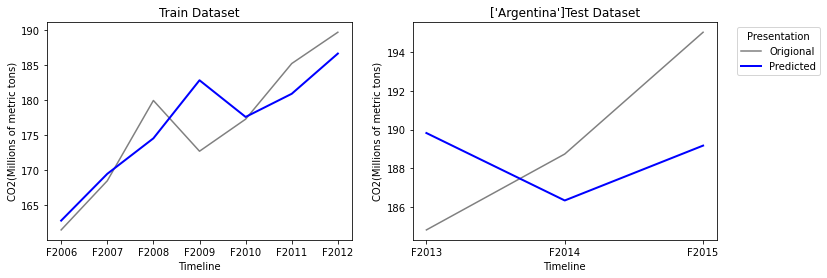

Origional Values:  [array([184.817], dtype=object), array([188.737], dtype=object), array([195.027], dtype=object)]
Predicted Values:  [[189.82196526]
 [186.3380373 ]
 [189.17202725]]
Explained Variance Score: -0.16036357598370654
        Maximam Error   : 5.854972745617658
    Mean Absolute Error : 4.419633568062362
    Mean Squared Error  : 21.69513503979154
         r2 score       : -0.22667947874927674


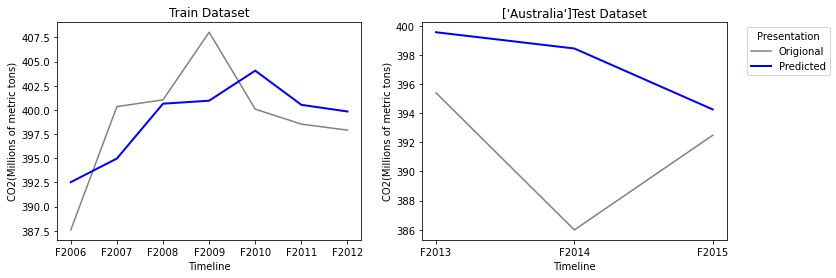

Origional Values:  [array([395.402], dtype=object), array([385.987], dtype=object), array([392.488], dtype=object)]
Predicted Values:  [[399.56414699]
 [398.44836329]
 [394.26306309]]
Explained Variance Score: -0.3542090915215812
        Maximam Error   : 12.461363293776287
    Mean Absolute Error : 6.132857791597473
    Mean Squared Error  : 58.58663056304625
         r2 score       : -2.782585743486814


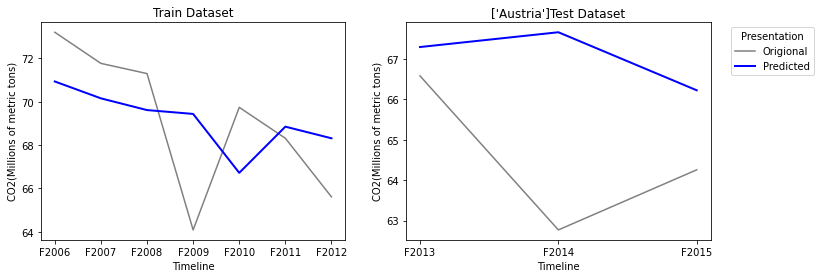

Origional Values:  [array([66.578], dtype=object), array([62.77], dtype=object), array([64.256], dtype=object)]
Predicted Values:  [[67.29218576]
 [67.65774089]
 [66.22265435]]
Explained Variance Score: -0.2452063402322029
        Maximam Error   : 4.887740888452534
    Mean Absolute Error : 2.5228603336629547
    Mean Squared Error  : 9.422600546797602
         r2 score       : -2.8371289636755406


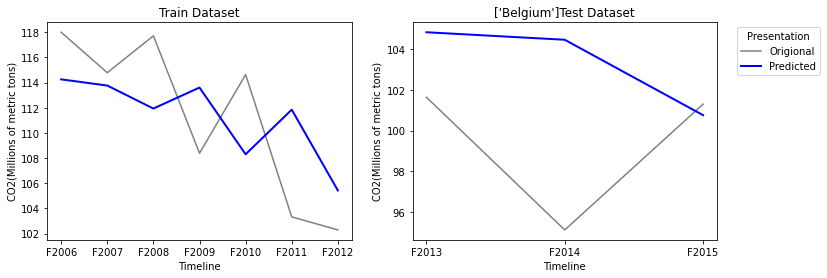

Origional Values:  [array([101.642], dtype=object), array([95.113], dtype=object), array([101.301], dtype=object)]
Predicted Values:  [[104.83909936]
 [104.46911935]
 [100.75852103]]
Explained Variance Score: -0.8498100797703569
        Maximam Error   : 9.356119346831207
    Mean Absolute Error : 4.365232557515711
    Mean Squared Error  : 32.684232324923435
         r2 score       : -2.629991970729347


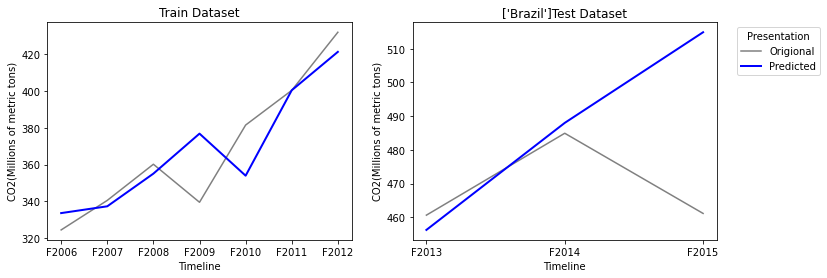

Origional Values:  [array([460.643], dtype=object), array([484.935], dtype=object), array([461.154], dtype=object)]
Predicted Values:  [[456.26572719]
 [488.01077761]
 [514.89513003]]
Explained Variance Score: -4.191005477367883
        Maximam Error   : 53.741130029898045
    Mean Absolute Error : 20.398060150371805
    Mean Squared Error  : 972.2433273540706
         r2 score       : -6.570034143977071


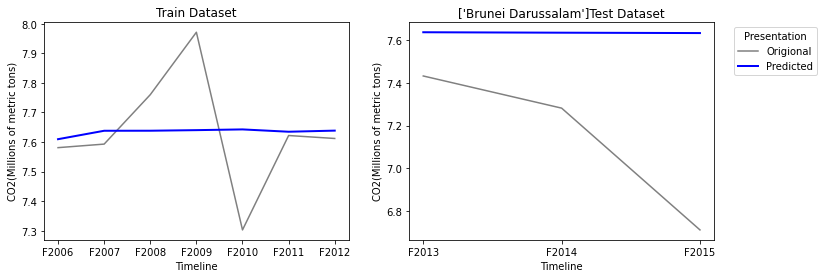

Origional Values:  [array([7.433], dtype=object), array([7.282], dtype=object), array([6.71], dtype=object)]
Predicted Values:  [[7.63842522]
 [7.636323  ]
 [7.63454962]]
Explained Variance Score: 0.009447708628705032
        Maximam Error   : 0.92454961784399
    Mean Absolute Error : 0.4947659439795012
    Mean Squared Error  : 0.3408454340343501
         r2 score       : -2.515021996105427


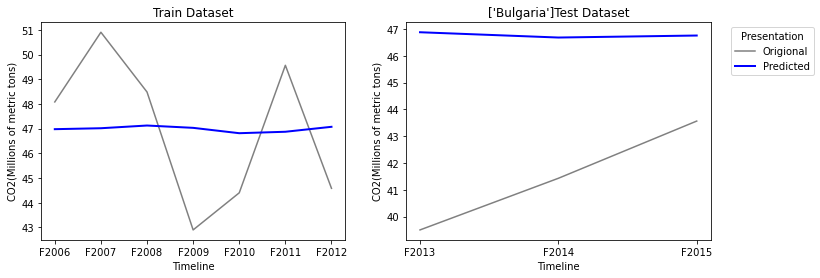

Origional Values:  [array([39.502], dtype=object), array([41.429], dtype=object), array([43.564], dtype=object)]
Predicted Values:  [[46.87900442]
 [46.68170867]
 [46.75656374]]
Explained Variance Score: -0.06035086449543847
        Maximam Error   : 7.3770044166506
    Mean Absolute Error : 5.274092278243702
    Mean Squared Error  : 30.734535279881015
         r2 score       : -10.166540439862517


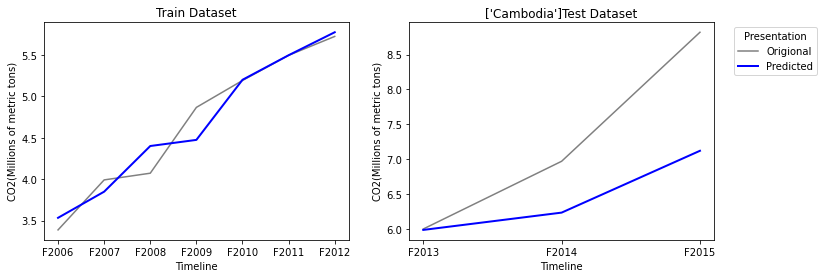

Origional Values:  [array([5.997], dtype=object), array([6.969], dtype=object), array([8.821], dtype=object)]
Predicted Values:  [[5.98381833]
 [6.23217176]
 [7.11967005]]
Explained Variance Score: 0.6515069155419373
        Maximam Error   : 1.7013299496056087
    Mean Absolute Error : 0.8171132886644775
    Mean Squared Error  : 1.1458710708877107
         r2 score       : 0.16492953670728216


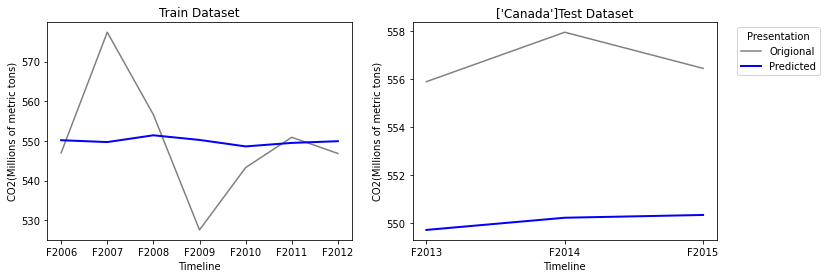

Origional Values:  [array([555.889], dtype=object), array([557.952], dtype=object), array([556.444], dtype=object)]
Predicted Values:  [[549.69893461]
 [550.20749659]
 [550.32340063]]
Explained Variance Score: 0.26029182265858897
        Maximam Error   : 7.744503410490665
    Mean Absolute Error : 6.6850560568097235
    Mean Squared Error  : 45.25199308488113
         r2 score       : -58.559006045858276


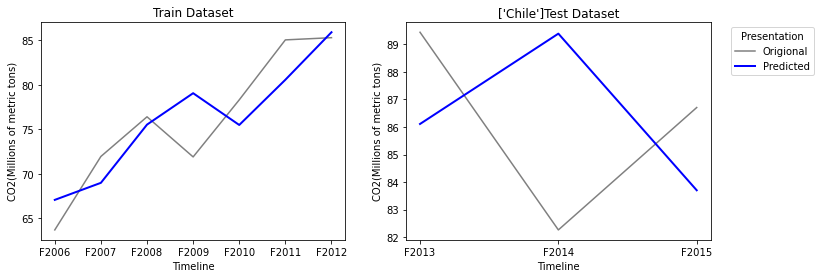

Origional Values:  [array([89.437], dtype=object), array([82.263], dtype=object), array([86.705], dtype=object)]
Predicted Values:  [[86.10818943]
 [89.38637849]
 [83.70164842]]
Explained Variance Score: -1.693883775891495
        Maximam Error   : 7.123378489901313
    Mean Absolute Error : 4.4851802141797394
    Mean Squared Error  : 23.614540549980546
         r2 score       : -1.7018422254361476


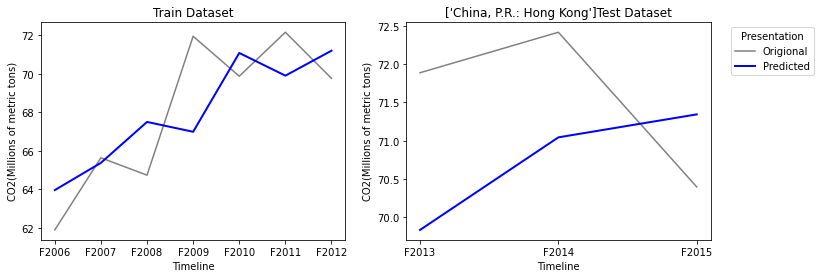

Origional Values:  [array([71.888], dtype=object), array([72.416], dtype=object), array([70.399], dtype=object)]
Predicted Values:  [[69.8378918 ]
 [71.04518595]
 [71.34474013]]
Explained Variance Score: -1.2551087136579993
        Maximam Error   : 2.05010820245937
    Mean Absolute Error : 1.455554129847125
    Mean Squared Error  : 2.325499737400513
         r2 score       : -2.1884337416908544


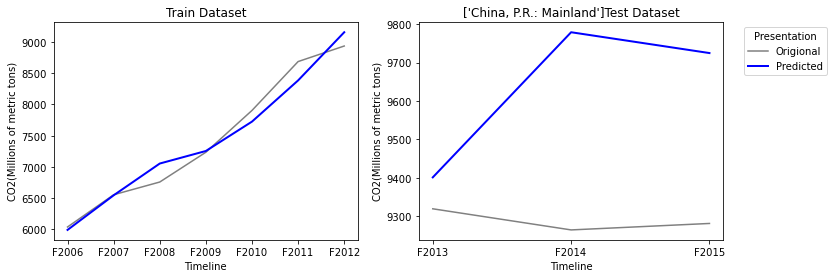

Origional Values:  [array([9319.037], dtype=object), array([9264.018], dtype=object), array([9280.847], dtype=object)]
Predicted Values:  [[9400.93603009]
 [9779.06677877]
 [9724.83490896]]
Explained Variance Score: -66.89505757202821
        Maximam Error   : 515.048778766668
    Mean Absolute Error : 346.9785726059278
    Mean Squared Error  : 156369.31964828356
         r2 score       : -294.11182620171354


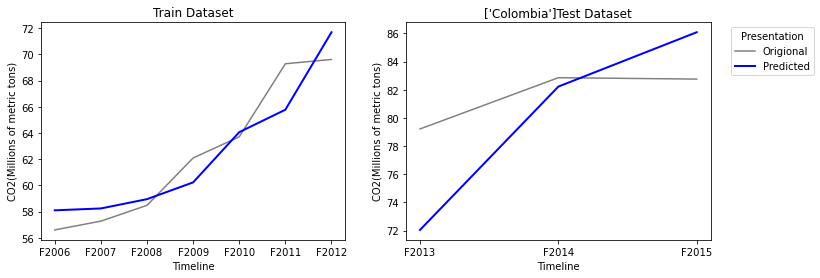

Origional Values:  [array([79.214], dtype=object), array([82.854], dtype=object), array([82.755], dtype=object)]
Predicted Values:  [[72.04220267]
 [82.22183118]
 [86.0820091 ]]
Explained Variance Score: -5.537957639437621
        Maximam Error   : 7.171797331085017
    Mean Absolute Error : 3.7103250816236275
    Mean Squared Error  : 20.967767968707175
         r2 score       : -6.314881459728854


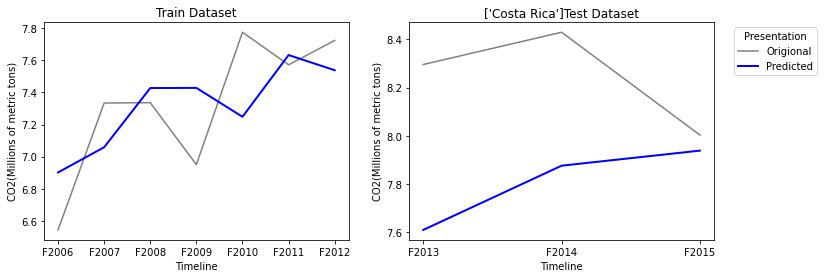

Origional Values:  [array([8.296], dtype=object), array([8.43], dtype=object), array([8.003], dtype=object)]
Predicted Values:  [[7.60909428]
 [7.87586025]
 [7.93835437]]
Explained Variance Score: -1.252227721849
        Maximam Error   : 0.686905719954666
    Mean Absolute Error : 0.4352303653831635
    Mean Squared Error  : 0.26102979616973315
         r2 score       : -7.210377534748069


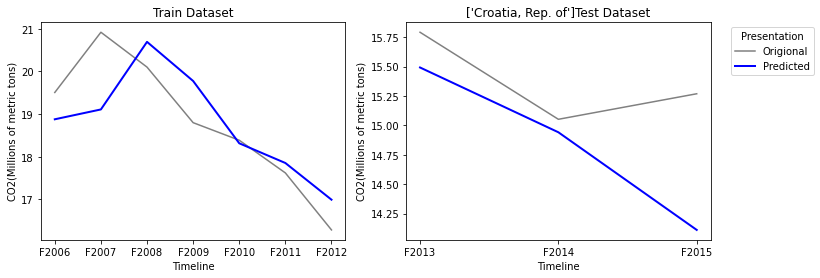

Origional Values:  [array([15.792], dtype=object), array([15.052], dtype=object), array([15.269], dtype=object)]
Predicted Values:  [[15.49246523]
 [14.94166227]
 [14.11153155]]
Explained Variance Score: -1.151911705285523
        Maximam Error   : 1.15746845444278
    Mean Absolute Error : 0.5224469860777082
    Mean Squared Error  : 0.4805429062549685
         r2 score       : -3.9813366646334387


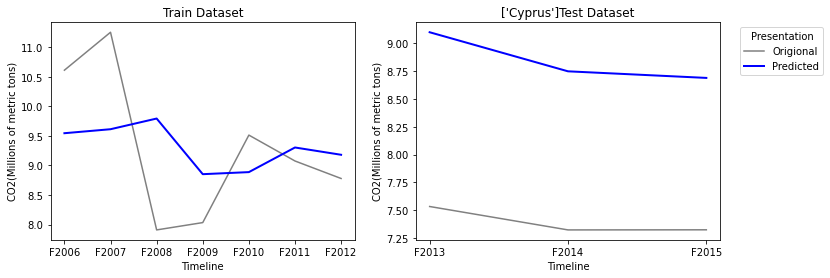

Origional Values:  [array([7.534], dtype=object), array([7.324], dtype=object), array([7.325], dtype=object)]
Predicted Values:  [[9.09682601]
 [8.7463843 ]
 [8.68727365]]
Explained Variance Score: 0.27595167482364813
        Maximam Error   : 1.5628260077948477
    Mean Absolute Error : 1.4491613207543523
    Mean Squared Error  : 2.1071305791350134
         r2 score       : -215.0371740472438


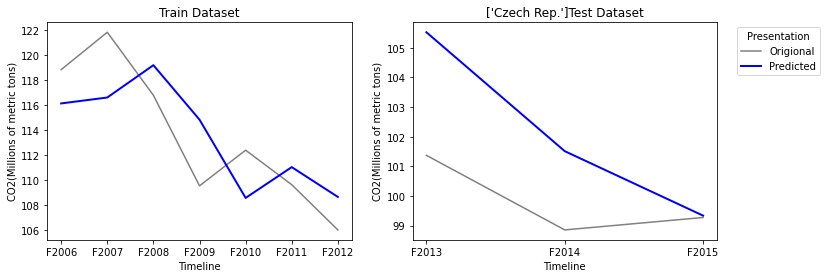

Origional Values:  [array([101.372], dtype=object), array([98.856], dtype=object), array([99.275], dtype=object)]
Predicted Values:  [[105.5238336 ]
 [101.51245767]
 [ 99.33779233]]
Explained Variance Score: -1.355587923964484
        Maximam Error   : 4.151833595635523
    Mean Absolute Error : 2.2903611990321053
    Mean Squared Error  : 8.099477477349074
         r2 score       : -5.685663242800028


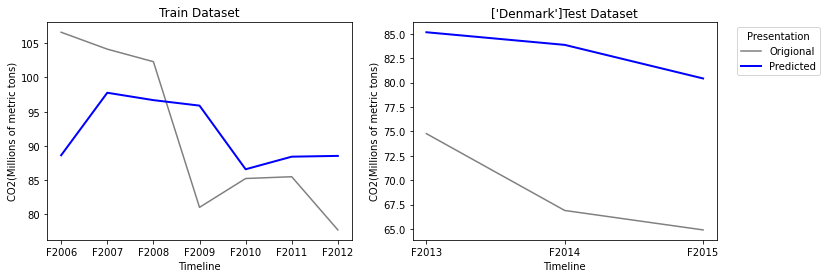

Origional Values:  [array([74.767], dtype=object), array([66.902], dtype=object), array([64.912], dtype=object)]
Predicted Values:  [[85.14786465]
 [83.85391525]
 [80.41693047]]
Explained Variance Score: 0.5610113724607776
        Maximam Error   : 16.9519152547727
    Mean Absolute Error : 14.279236788970659
    Mean Squared Error  : 211.8442167897856
         r2 score       : -10.701273824328341


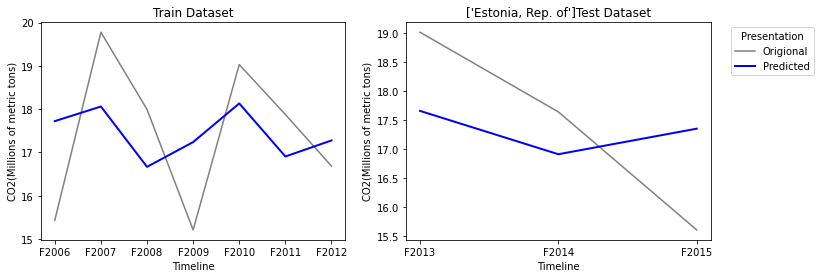

Origional Values:  [array([19.019], dtype=object), array([17.642], dtype=object), array([15.602], dtype=object)]
Predicted Values:  [[17.65908268]
 [16.91031221]
 [17.35206754]]
Explained Variance Score: 0.0850266609292305
        Maximam Error   : 1.7500675386616429
    Mean Absolute Error : 1.2805575495801556
    Mean Squared Error  : 1.8158261764394474
         r2 score       : 0.07844887670665701


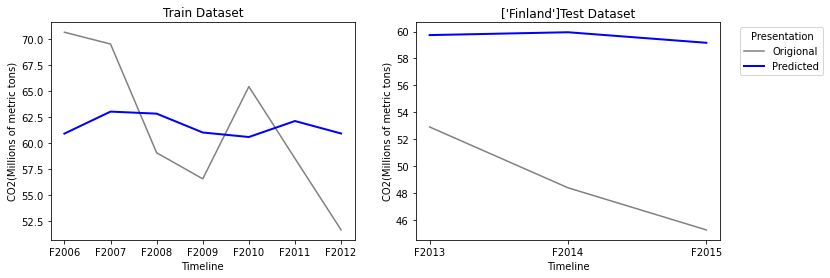

Origional Values:  [array([52.903], dtype=object), array([48.379], dtype=object), array([45.243], dtype=object)]
Predicted Values:  [[59.74034455]
 [59.952366  ]
 [59.16807732]]
Explained Variance Score: 0.12115839489635294
        Maximam Error   : 13.925077322369624
    Mean Absolute Error : 10.778595956573726
    Mean Squared Error  : 124.86661982142978
         r2 score       : -11.630272105399367


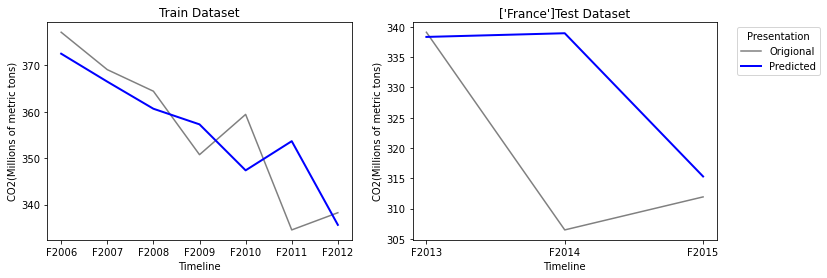

Origional Values:  [array([339.101], dtype=object), array([306.48], dtype=object), array([311.928], dtype=object)]
Predicted Values:  [[338.32853426]
 [338.93718224]
 [315.3006275 ]]
Explained Variance Score: -0.07374831424310835
        Maximam Error   : 32.45718224316715
    Mean Absolute Error : 12.200758494763837
    Mean Squared Error  : 355.14666624220695
         r2 score       : -0.7445425826556515


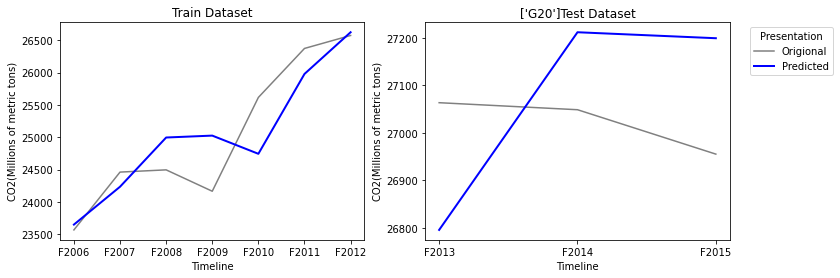

Origional Values:  [array([27063.36], dtype=object), array([27048.59], dtype=object), array([26955.193], dtype=object)]
Predicted Values:  [[26795.71519377]
 [27211.58840464]
 [27199.01461459]]
Explained Variance Score: -20.974629117999267
        Maximam Error   : 267.64480623442796
    Mean Absolute Error : 224.82160849067077
    Mean Squared Error  : 52550.4006546163
         r2 score       : -21.913028568817


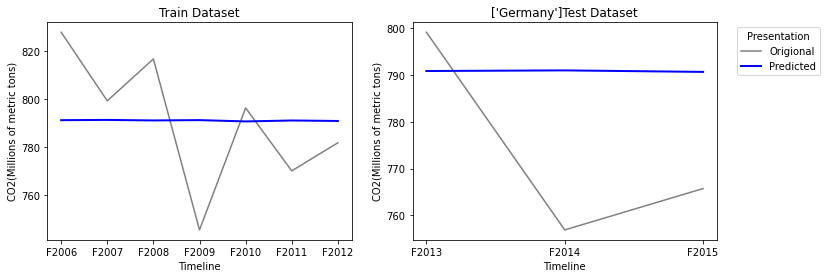

Origional Values:  [array([799.195], dtype=object), array([756.875], dtype=object), array([765.729], dtype=object)]
Predicted Values:  [[790.89539127]
 [791.02934619]
 [790.70481148]]
Explained Variance Score: -0.0015014996406306214
        Maximam Error   : 34.15434619021107
    Mean Absolute Error : 22.476588801192975
    Mean Squared Error  : 619.7313426521844
         r2 score       : -0.8658183847701963


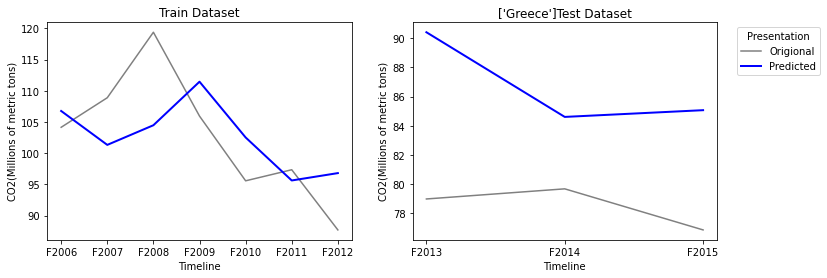

Origional Values:  [array([78.992], dtype=object), array([79.685], dtype=object), array([76.874], dtype=object)]
Predicted Values:  [[90.40272775]
 [84.60813707]
 [85.06880603]]
Explained Variance Score: -3.9063819732520075
        Maximam Error   : 11.410727748807929
    Mean Absolute Error : 8.17622361510334
    Mean Squared Error  : 73.86561073254218
         r2 score       : -50.662727140344465


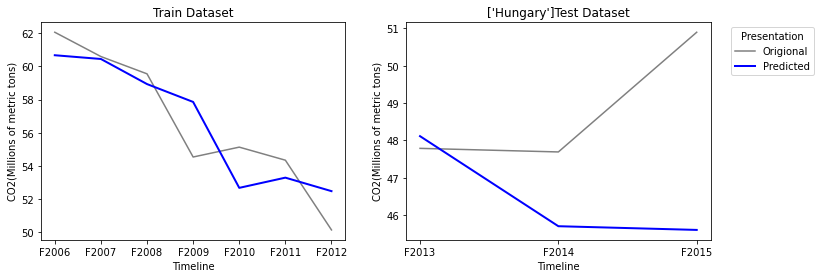

Origional Values:  [array([47.789], dtype=object), array([47.693], dtype=object), array([50.899], dtype=object)]
Predicted Values:  [[48.11547175]
 [45.7036284 ]
 [45.60446911]]
Explained Variance Score: -1.3989716444479656
        Maximam Error   : 5.294530893613185
    Mean Absolute Error : 2.5367914124625486
    Mean Squared Error  : 10.698746843652986
         r2 score       : -3.824144187406577


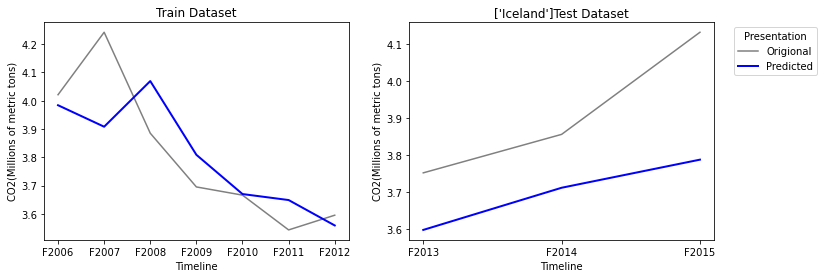

Origional Values:  [array([3.751], dtype=object), array([3.855], dtype=object), array([4.131], dtype=object)]
Predicted Values:  [[3.59677167]
 [3.71071667]
 [3.78668   ]]
Explained Variance Score: 0.6704794688110258
        Maximam Error   : 0.3443199996044739
    Mean Absolute Error : 0.21427722007703887
    Mean Squared Error  : 0.054386773127596995
         r2 score       : -1.1153754587382974


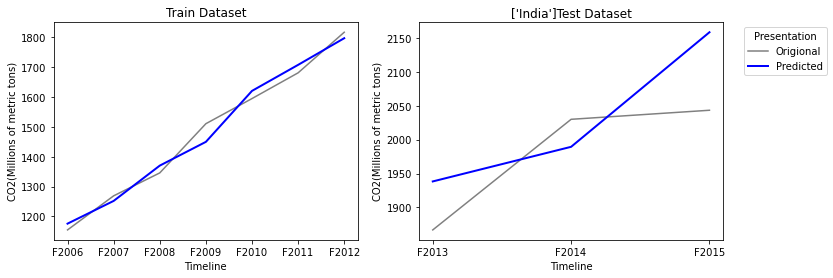

Origional Values:  [array([1866.712], dtype=object), array([2030.043], dtype=object), array([2043.407], dtype=object)]
Predicted Values:  [[1938.30715753]
 [1989.42580163]
 [2158.60010227]]
Explained Variance Score: 0.33244795296285656
        Maximam Error   : 115.19310227121628
    Mean Absolute Error : 75.80181939000363
    Mean Squared Error  : 6681.69139856066
         r2 score       : -0.03544427044908027


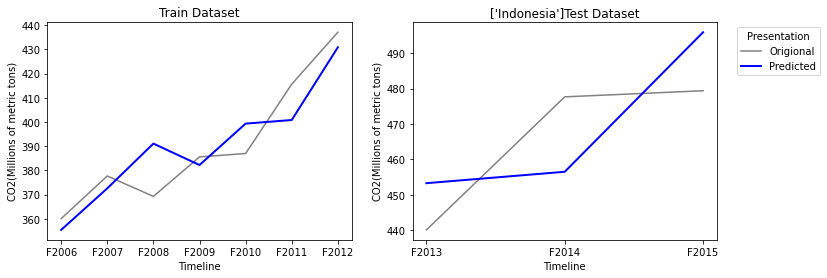

Origional Values:  [array([440.104], dtype=object), array([477.653], dtype=object), array([479.376], dtype=object)]
Predicted Values:  [[453.29179683]
 [456.50903277]
 [495.88451923]]
Explained Variance Score: 0.11768434988705423
        Maximam Error   : 21.143967230450244
    Mean Absolute Error : 16.946761096290288
    Mean Squared Error  : 297.83884753932756
         r2 score       : 0.09293373599888732


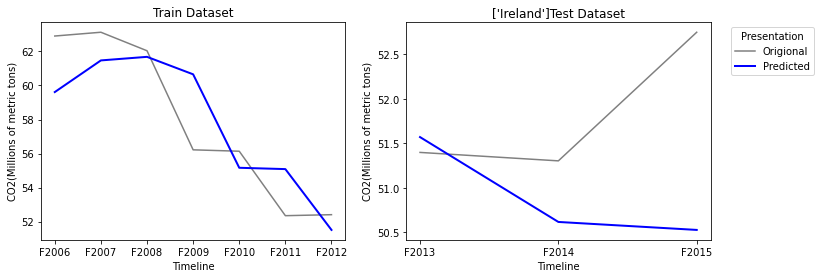

Origional Values:  [array([51.398], dtype=object), array([51.303], dtype=object), array([52.75], dtype=object)]
Predicted Values:  [[51.5704614 ]
 [50.61566787]
 [50.52603804]]
Explained Variance Score: -1.249786444796546
        Maximam Error   : 2.223961959463338
    Mean Absolute Error : 1.0279184974855606
    Mean Squared Error  : 1.8160583971355153
         r2 score       : -3.1581315198875206


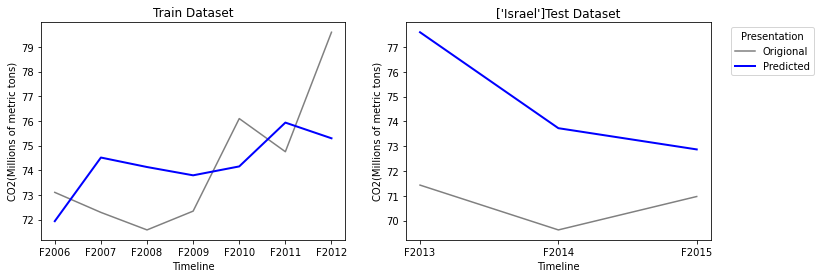

Origional Values:  [array([71.43], dtype=object), array([69.624], dtype=object), array([70.97], dtype=object)]
Predicted Values:  [[77.5897621 ]
 [73.72325097]
 [72.86802511]]
Explained Variance Score: -4.1568119355111595
        Maximam Error   : 6.159762099575204
    Mean Absolute Error : 4.052346059084779
    Mean Squared Error  : 19.449675643935922
         r2 score       : -32.12179198513466


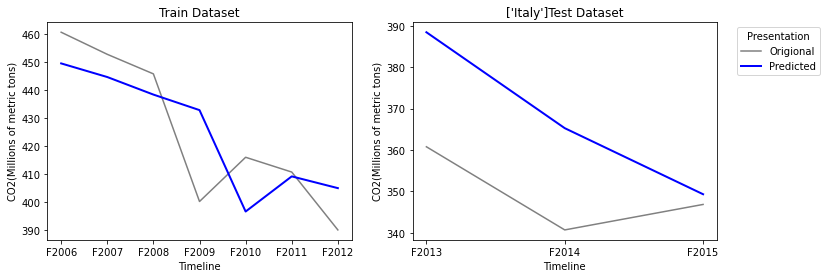

Origional Values:  [array([360.773], dtype=object), array([340.683], dtype=object), array([346.837], dtype=object)]
Predicted Values:  [[388.44266265]
 [365.26772988]
 [349.30447131]]
Explained Variance Score: -0.7836319195243817
        Maximam Error   : 27.66966264846684
    Mean Absolute Error : 18.240621276877693
    Mean Squared Error  : 458.70252959167084
         r2 score       : -5.494219429875369


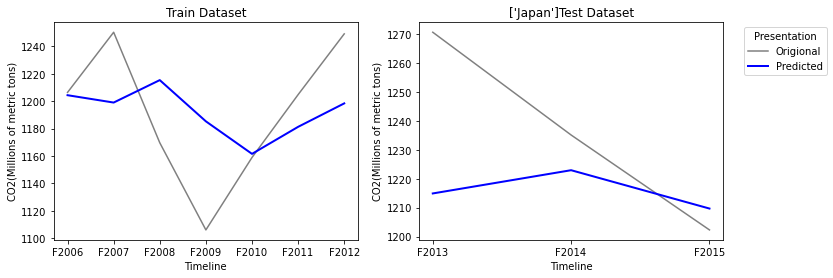

Origional Values:  [array([1270.62], dtype=object), array([1235.109], dtype=object), array([1202.308], dtype=object)]
Predicted Values:  [[1214.91070582]
 [1222.94164957]
 [1209.69193561]]
Explained Variance Score: 0.10631261201742104
        Maximam Error   : 55.709294176236654
    Mean Absolute Error : 25.08686007260606
    Mean Squared Error  : 1102.0307930841122
         r2 score       : -0.41619550152569285


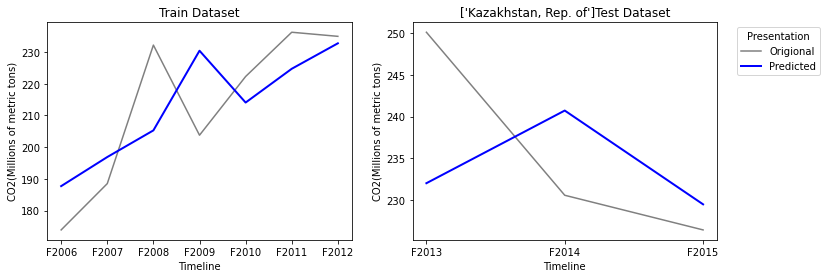

Origional Values:  [array([250.07], dtype=object), array([230.596], dtype=object), array([226.456], dtype=object)]
Predicted Values:  [[232.03566357]
 [240.71455977]
 [229.5120129 ]]
Explained Variance Score: -0.3493413509969223
        Maximam Error   : 18.034336428156934
    Mean Absolute Error : 10.402969701988306
    Mean Squared Error  : 145.65391906189598
         r2 score       : -0.3740975053407323


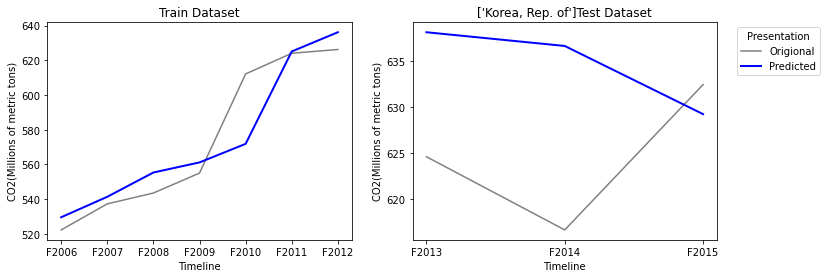

Origional Values:  [array([624.611], dtype=object), array([616.627], dtype=object), array([632.478], dtype=object)]
Predicted Values:  [[638.18741659]
 [636.69141811]
 [629.25427497]]
Explained Variance Score: -1.299559012406109
        Maximam Error   : 20.064418109431926
    Mean Absolute Error : 12.288186575687329
    Mean Squared Error  : 199.09745485636645
         r2 score       : -3.754400245072442


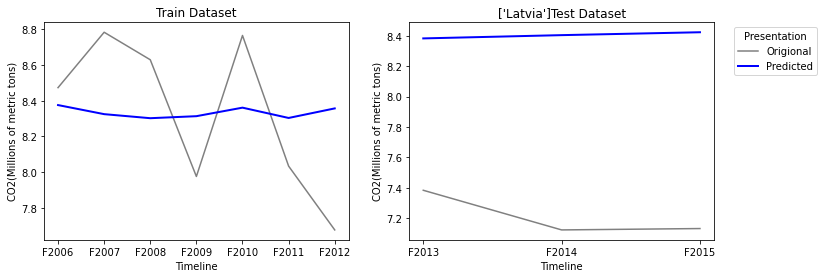

Origional Values:  [array([7.383], dtype=object), array([7.122], dtype=object), array([7.131], dtype=object)]
Predicted Values:  [[8.38291526]
 [8.40440103]
 [8.42347512]]
Explained Variance Score: -0.25651806305133174
        Maximam Error   : 1.292475124757324
    Mean Absolute Error : 1.191597138091674
    Mean Squared Error  : 1.438291624842961
         r2 score       : -97.28424387337442


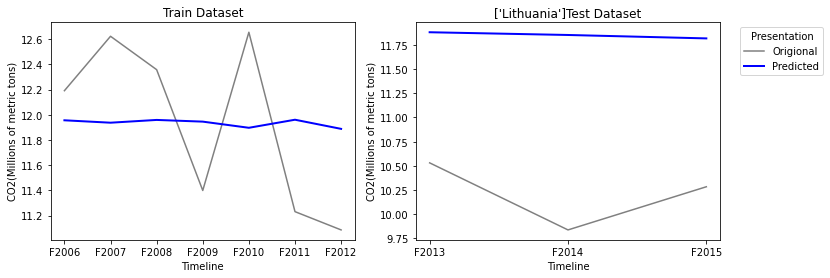

Origional Values:  [array([10.531], dtype=object), array([9.838], dtype=object), array([10.284], dtype=object)]
Predicted Values:  [[11.8806911 ]
 [11.85240918]
 [11.81709501]]
Explained Variance Score: 0.044615910733157405
        Maximam Error   : 2.0144091846837338
    Mean Absolute Error : 1.6323984314672835
    Mean Squared Error  : 2.7432969127111804
         r2 score       : -32.35657860773347


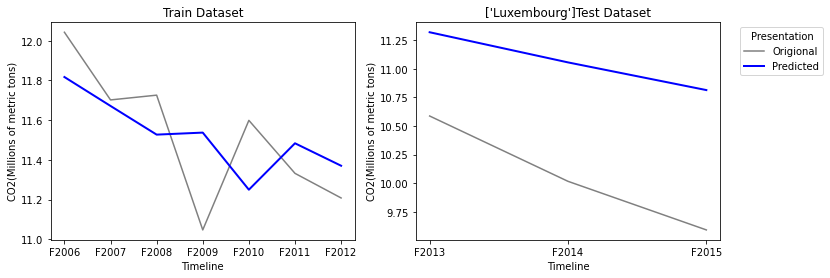

Origional Values:  [array([10.587], dtype=object), array([10.017], dtype=object), array([9.593], dtype=object)]
Predicted Values:  [[11.31784978]
 [11.05474208]
 [10.81324226]]
Explained Variance Score: 0.7541426557505558
        Maximam Error   : 1.22024226448152
    Mean Absolute Error : 0.9962780417207545
    Mean Squared Error  : 1.0333470706426386
         r2 score       : -5.230353635385629


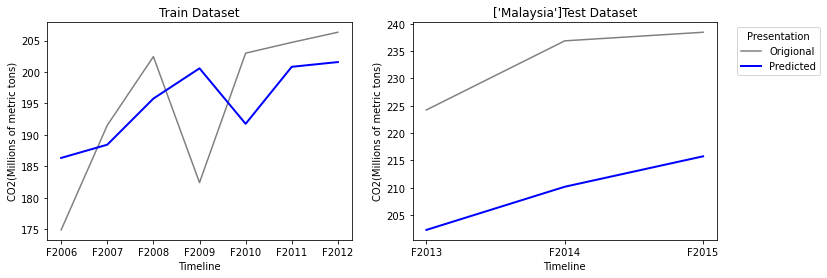

Origional Values:  [array([224.23], dtype=object), array([236.862], dtype=object), array([238.435], dtype=object)]
Predicted Values:  [[202.29272772]
 [210.18340781]
 [215.75029254]]
Explained Variance Score: 0.8928330380462017
        Maximam Error   : 26.678592186916234
    Mean Absolute Error : 23.766857310964223
    Mean Squared Error  : 569.1957163258238
         r2 score       : -13.080337121155413


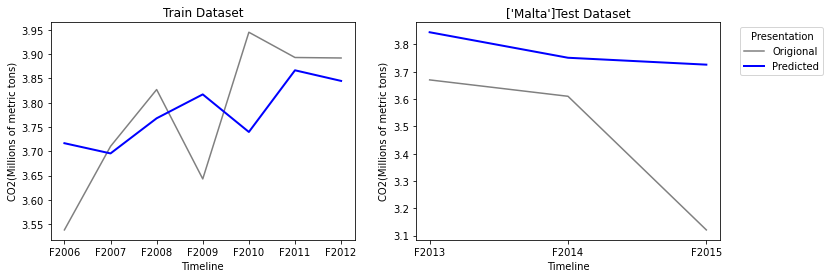

Origional Values:  [array([3.67], dtype=object), array([3.61], dtype=object), array([3.121], dtype=object)]
Predicted Values:  [[3.84436549]
 [3.75101279]
 [3.72578233]]
Explained Variance Score: 0.2621999451740453
        Maximam Error   : 0.6047823276113342
    Mean Absolute Error : 0.30672020240098546
    Mean Squared Error  : 0.13868319827556905
         r2 score       : -1.293876712355174


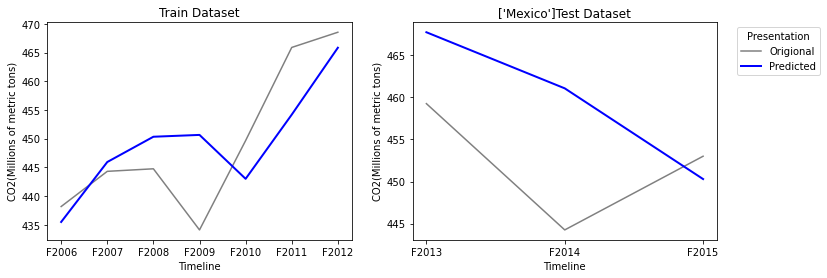

Origional Values:  [array([459.256], dtype=object), array([444.256], dtype=object), array([453.009], dtype=object)]
Predicted Values:  [[467.73641643]
 [461.07199619]
 [450.29628167]]
Explained Variance Score: -0.691342226633396
        Maximam Error   : 16.815996187515623
    Mean Absolute Error : 9.336376982793658
    Mean Squared Error  : 120.68467710783074
         r2 score       : -2.188592169374756


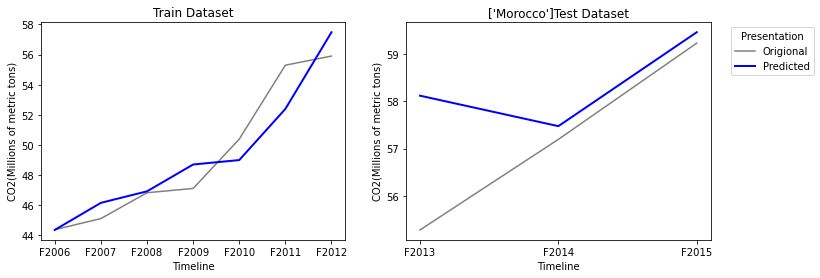

Origional Values:  [array([55.286], dtype=object), array([57.194], dtype=object), array([59.222], dtype=object)]
Predicted Values:  [[58.11444453]
 [57.47246855]
 [59.45128952]]
Explained Variance Score: 0.4295458525531851
        Maximam Error   : 2.8284445322112504
    Mean Absolute Error : 1.1120675321500666
    Mean Squared Error  : 2.7100722953543315
         r2 score       : -0.049270368216060234


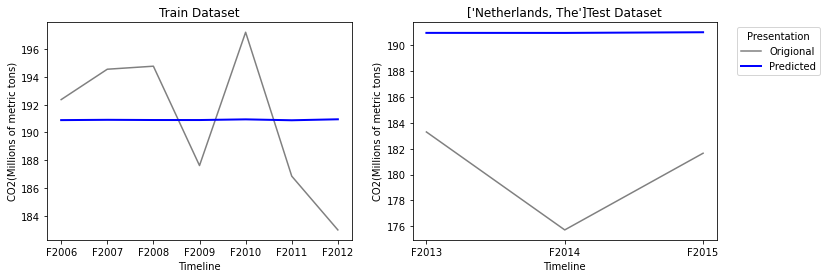

Origional Values:  [array([183.301], dtype=object), array([175.71], dtype=object), array([181.652], dtype=object)]
Predicted Values:  [[190.97735506]
 [190.9752015 ]
 [191.02660934]]
Explained Variance Score: 0.004977657571040628
        Maximam Error   : 15.265201500413752
    Mean Absolute Error : 10.772055301941966
    Mean Squared Error  : 126.61203474141699
         r2 score       : -10.913331388664854


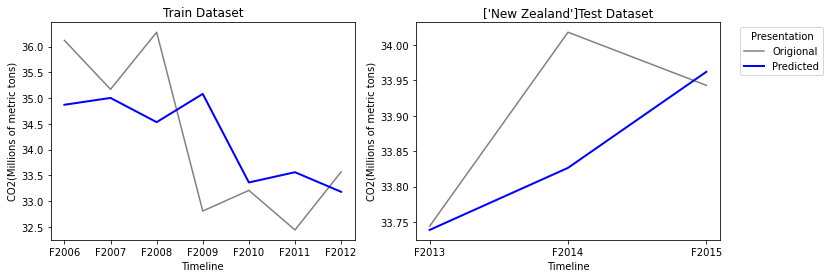

Origional Values:  [array([33.744], dtype=object), array([34.018], dtype=object), array([33.943], dtype=object)]
Predicted Values:  [[33.7387176 ]
 [33.82638415]
 [33.96209396]]
Explained Variance Score: 0.33739270324211423
        Maximam Error   : 0.191615845138827
    Mean Absolute Error : 0.07199740257293523
    Mean Squared Error  : 0.01236970508968619
         r2 score       : 0.07460103899207338


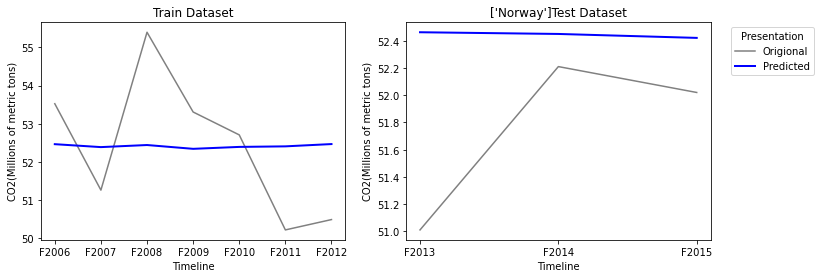

Origional Values:  [array([51.011], dtype=object), array([52.21], dtype=object), array([52.02], dtype=object)]
Predicted Values:  [[52.46217022]
 [52.44961746]
 [52.42072926]]
Explained Variance Score: -0.04232364557258328
        Maximam Error   : 1.4511702176579035
    Mean Absolute Error : 0.6971723129145863
    Mean Squared Error  : 0.774631822584911
         r2 score       : -1.7978717252408973


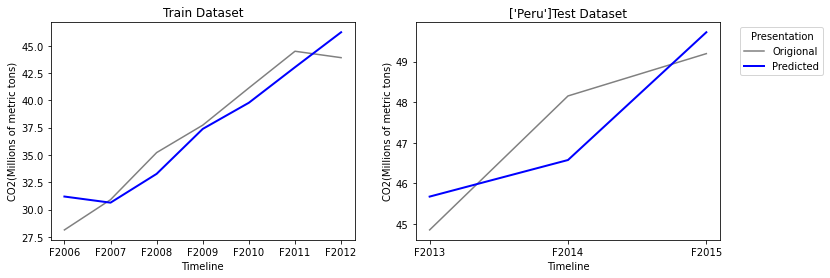

Origional Values:  [array([44.85], dtype=object), array([48.151], dtype=object), array([49.194], dtype=object)]
Predicted Values:  [[45.67102387]
 [46.57239653]
 [49.72100093]]
Explained Variance Score: 0.6668837454525647
        Maximam Error   : 1.5786034711702257
    Mean Absolute Error : 0.9755427566490363
    Mean Squared Error  : 1.147933030149481
         r2 score       : 0.665160624632259


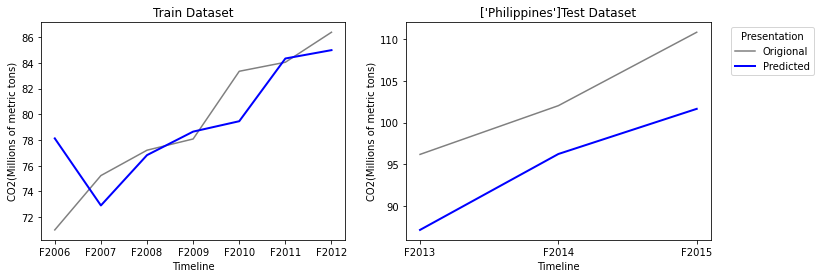

Origional Values:  [array([96.2], dtype=object), array([102.035], dtype=object), array([110.825], dtype=object)]
Predicted Values:  [[ 87.15872385]
 [ 96.24851043]
 [101.65402456]]
Explained Variance Score: 0.9321492317134044
        Maximam Error   : 9.170975439174882
    Mean Absolute Error : 7.999580389549801
    Mean Squared Error  : 66.44497553729185
         r2 score       : -0.8388720603785638


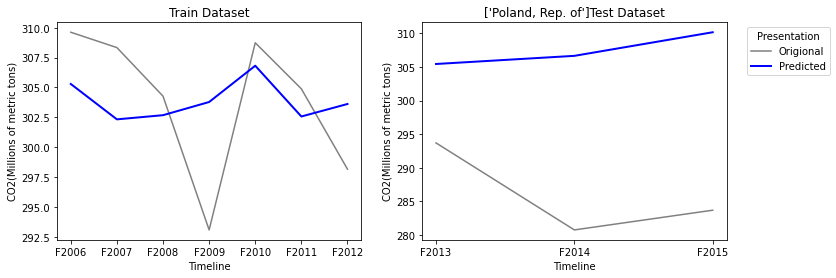

Origional Values:  [array([293.7], dtype=object), array([280.762], dtype=object), array([283.693], dtype=object)]
Predicted Values:  [[305.43680974]
 [306.64722926]
 [310.1569576 ]]
Explained Variance Score: -0.511652809688615
        Maximam Error   : 26.463957597421143
    Mean Absolute Error : 21.361998864815877
    Mean Squared Error  : 502.712949471259
         r2 score       : -15.38553186310217


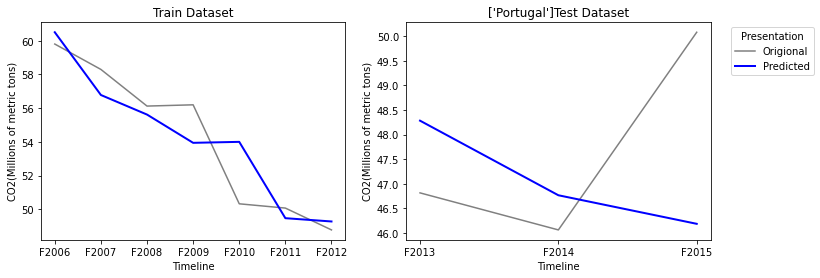

Origional Values:  [array([46.816], dtype=object), array([46.064], dtype=object), array([50.077], dtype=object)]
Predicted Values:  [[48.28193024]
 [46.76756376]
 [46.18772487]]
Explained Variance Score: -0.8441977816420694
        Maximam Error   : 3.8892751341628227
    Mean Absolute Error : 2.0195897106330896
    Mean Squared Error  : 5.923471498046663
         r2 score       : -0.9525214511367923


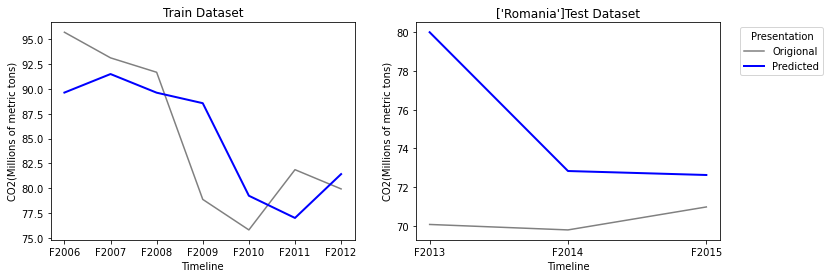

Origional Values:  [array([70.074], dtype=object), array([69.792], dtype=object), array([70.978], dtype=object)]
Predicted Values:  [[80.00211036]
 [72.83406039]
 [72.62875975]]
Explained Variance Score: -50.17270547313776
        Maximam Error   : 9.928110358370915
    Mean Absolute Error : 4.873643499318149
    Mean Squared Error  : 36.848838151076485
         r2 score       : -142.9822689176447


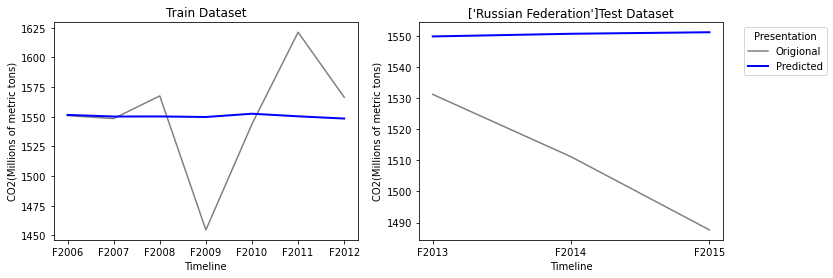

Origional Values:  [array([1531.207], dtype=object), array([1511.148], dtype=object), array([1487.625], dtype=object)]
Predicted Values:  [[1549.85289832]
 [1550.71232455]
 [1551.20139461]]
Explained Variance Score: -0.06228318342390016
        Maximam Error   : 63.57639461499775
    Mean Absolute Error : 40.59553916015807
    Mean Squared Error  : 1984.9877510885601
         r2 score       : -5.257216568683594


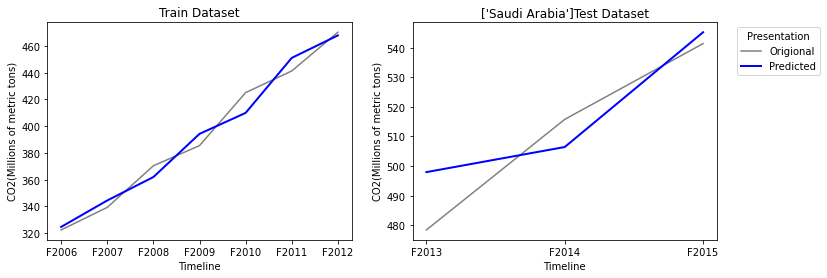

Origional Values:  [array([478.436], dtype=object), array([515.782], dtype=object), array([541.376], dtype=object)]
Predicted Values:  [[497.96448129]
 [506.43996154]
 [545.21556917]]
Explained Variance Score: 0.7914893111694813
        Maximam Error   : 19.528481294697542
    Mean Absolute Error : 10.903362975501807
    Mean Squared Error  : 161.1258519108654
         r2 score       : 0.7587623426642738


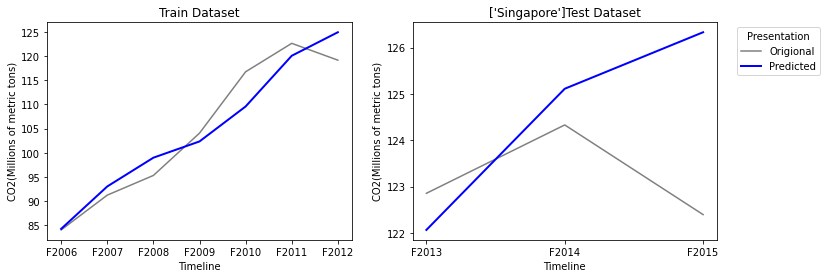

Origional Values:  [array([122.854], dtype=object), array([124.33], dtype=object), array([122.394], dtype=object)]
Predicted Values:  [[122.06335331]
 [125.11127208]
 [126.33110073]]
Explained Variance Score: -4.666379526809391
        Maximam Error   : 3.9371007342474797
    Mean Absolute Error : 1.8363398321160578
    Mean Squared Error  : 5.578756810199242
         r2 score       : -7.179632849732544


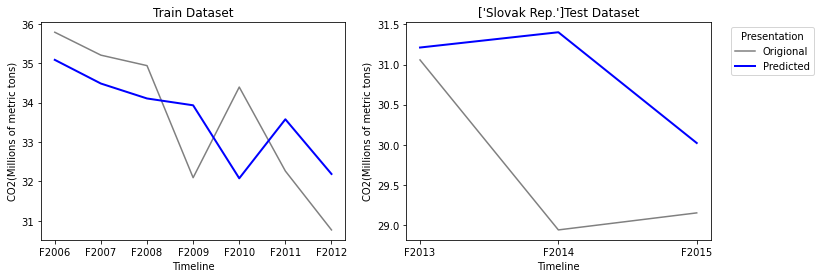

Origional Values:  [array([31.057], dtype=object), array([28.94], dtype=object), array([29.152], dtype=object)]
Predicted Values:  [[31.21144785]
 [31.40170507]
 [30.02234019]]
Explained Variance Score: -0.026082743970809785
        Maximam Error   : 2.461705071920388
    Mean Absolute Error : 1.1621643692358496
    Mean Squared Error  : 2.2804460144021896
         r2 score       : -1.5165368790132883


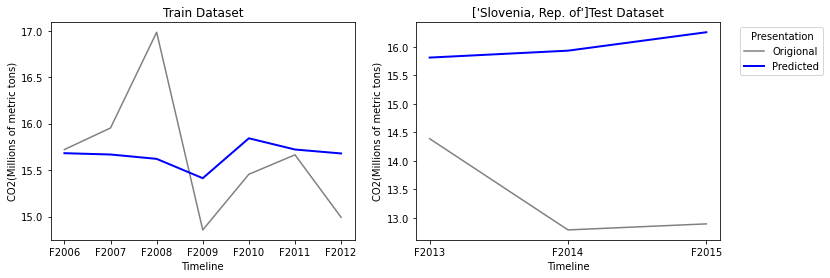

Origional Values:  [array([14.389], dtype=object), array([12.786], dtype=object), array([12.892], dtype=object)]
Predicted Values:  [[15.81455319]
 [15.93629078]
 [16.25991493]]
Explained Variance Score: -0.40917771017434035
        Maximam Error   : 3.367914932422689
    Mean Absolute Error : 2.6479196347439427
    Mean Squared Error  : 7.766461634119715
         r2 score       : -13.496115956036299


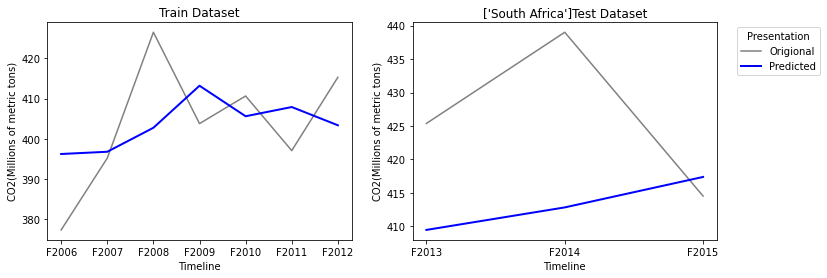

Origional Values:  [array([425.375], dtype=object), array([439.015], dtype=object), array([414.513], dtype=object)]
Predicted Values:  [[409.45126884]
 [412.81770051]
 [417.37397437]]
Explained Variance Score: -0.4405379534613527
        Maximam Error   : 26.197299486561406
    Mean Absolute Error : 14.994001671964705
    Mean Squared Error  : 316.0162962232546
         r2 score       : -2.1448557333673617


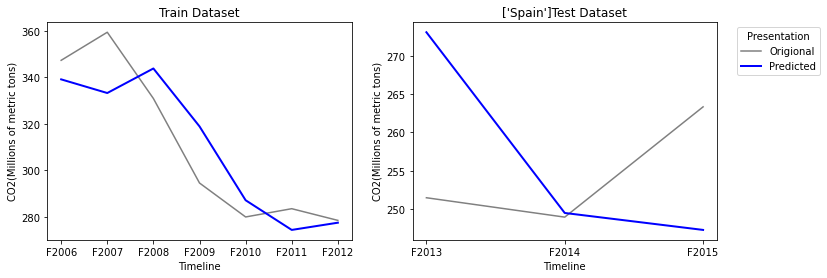

Origional Values:  [array([251.47], dtype=object), array([248.941], dtype=object), array([263.328], dtype=object)]
Predicted Values:  [[273.05942974]
 [249.48293458]
 [247.27263816]]
Explained Variance Score: -5.032867779536096
        Maximam Error   : 21.589429735248785
    Mean Absolute Error : 12.728908718617362
    Mean Squared Error  : 241.39060438278224
         r2 score       : -5.137157201654763


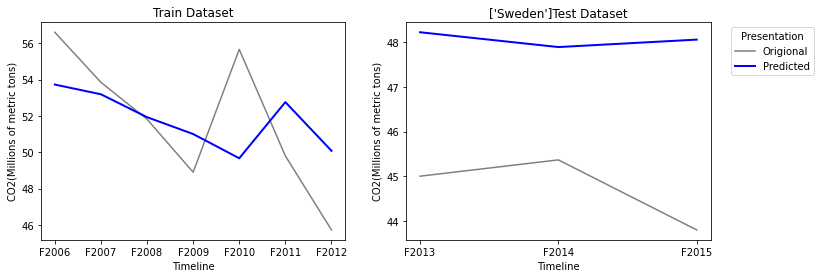

Origional Values:  [array([45.003], dtype=object), array([45.367], dtype=object), array([43.803], dtype=object)]
Predicted Values:  [[48.21799266]
 [47.88698399]
 [48.05340272]]
Explained Variance Score: -0.13210298534890597
        Maximam Error   : 4.250402715056659
    Mean Absolute Error : 3.328459789319846
    Mean Squared Error  : 11.584140124685698
         r2 score       : -24.943728828945847


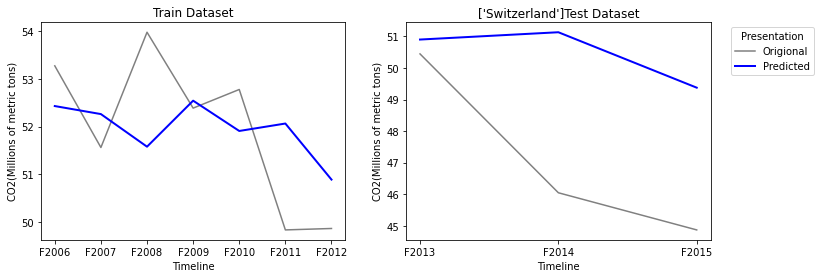

Origional Values:  [array([50.448], dtype=object), array([46.045], dtype=object), array([44.867], dtype=object)]
Predicted Values:  [[50.90337232]
 [51.13489375]
 [49.37732677]]
Explained Variance Score: 0.2631717325678813
        Maximam Error   : 5.089893746285718
    Mean Absolute Error : 3.351864279243062
    Mean Squared Error  : 15.485809964135607
         r2 score       : -1.6842806216693398


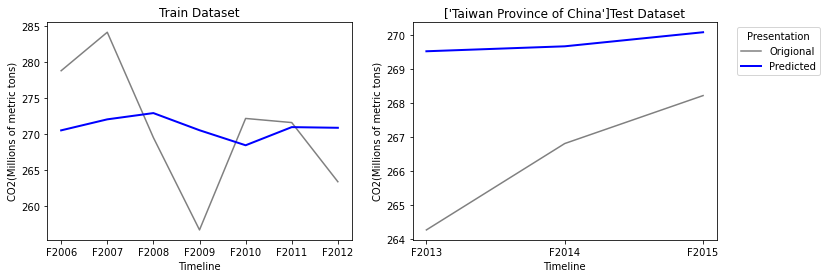

Origional Values:  [array([264.26], dtype=object), array([266.809], dtype=object), array([268.224], dtype=object)]
Predicted Values:  [[269.53152801]
 [269.67775598]
 [270.09282849]]
Explained Variance Score: 0.242076917891339
        Maximam Error   : 5.271528010417455
    Mean Absolute Error : 3.3363708267842944
    Mean Squared Error  : 13.170429457050275
         r2 score       : -3.895479575470163


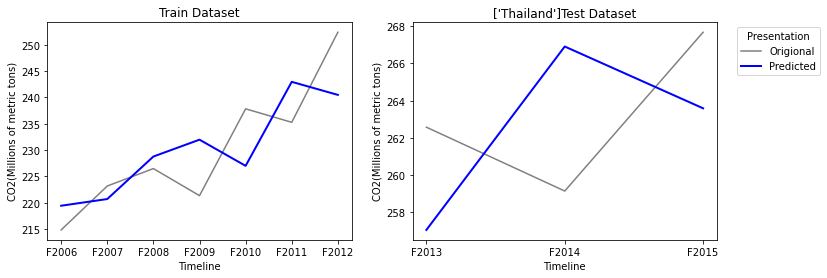

Origional Values:  [array([262.577], dtype=object), array([259.148], dtype=object), array([267.676], dtype=object)]
Predicted Values:  [[257.06035784]
 [266.90959242]
 [263.59102846]]
Explained Variance Score: -1.8845847900605395
        Maximam Error   : 7.761592415372263
    Mean Absolute Error : 5.7877353709863355
    Mean Squared Error  : 35.787550001569635
         r2 score       : -1.9152286763782809


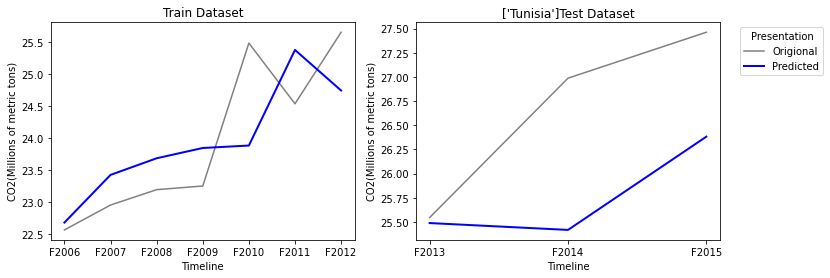

Origional Values:  [array([25.545], dtype=object), array([26.987], dtype=object), array([27.462], dtype=object)]
Predicted Values:  [[25.48821598]
 [25.41730916]
 [26.38190944]]
Explained Variance Score: 0.40203600496841607
        Maximam Error   : 1.5696908366376903
    Mean Absolute Error : 0.9021884712980727
    Mean Squared Error  : 1.2112497864855385
         r2 score       : -0.8229883750755242


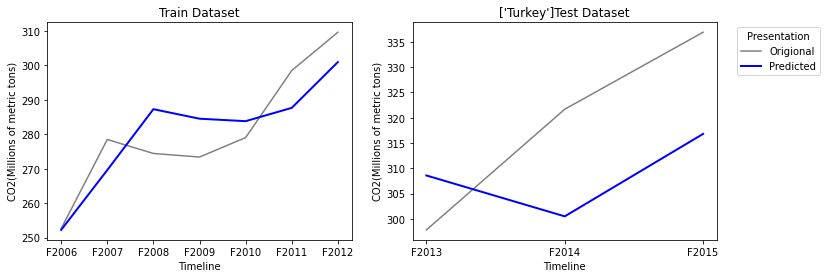

Origional Values:  [array([297.813], dtype=object), array([321.668], dtype=object), array([336.883], dtype=object)]
Predicted Values:  [[308.57543712]
 [300.49437361]
 [316.78832762]]
Explained Variance Score: 0.1520332110954965
        Maximam Error   : 21.17362638989482
    Mean Absolute Error : 17.343578627402866
    Mean Squared Error  : 322.64945502789277
         r2 score       : -0.24788029853993243


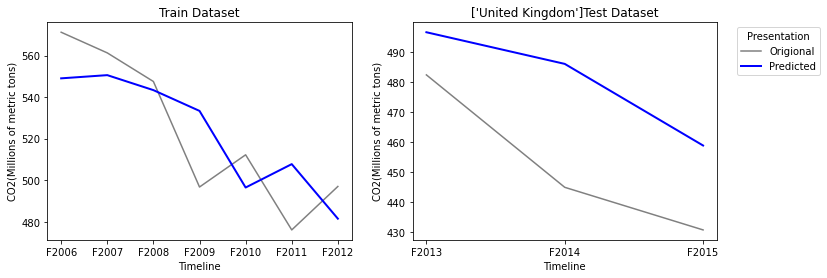

Origional Values:  [array([482.462], dtype=object), array([444.989], dtype=object), array([430.787], dtype=object)]
Predicted Values:  [[496.67572084]
 [486.12736729]
 [458.91932403]]
Explained Variance Score: 0.7456119686417608
        Maximam Error   : 41.13836729125137
    Mean Absolute Error : 27.828137387289832
    Mean Squared Error  : 895.274259640577
         r2 score       : -0.8842465928042724


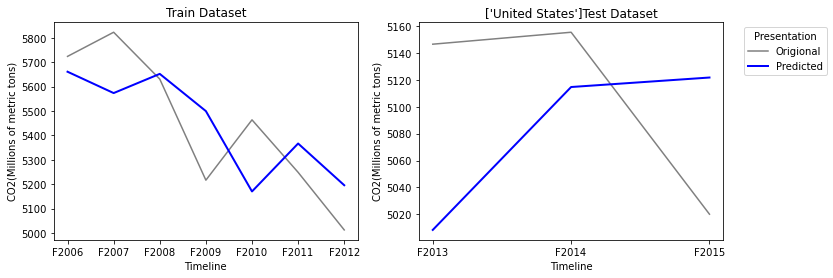

Origional Values:  [array([5146.637], dtype=object), array([5155.535], dtype=object), array([5020.004], dtype=object)]
Predicted Values:  [[5008.29827799]
 [5114.73565636]
 [5121.80821902]]
Explained Variance Score: -1.537959362484603
        Maximam Error   : 138.3387220059949
    Mean Absolute Error : 93.64742822067667
    Mean Squared Error  : 10388.762485753005
         r2 score       : -1.7113896024965198


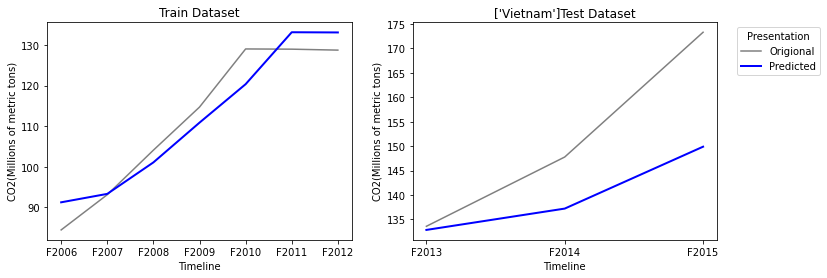

Origional Values:  [array([133.605], dtype=object), array([147.779], dtype=object), array([173.294], dtype=object)]
Predicted Values:  [[132.86359085]
 [137.22667452]
 [149.88631589]]
Explained Variance Score: 0.6805803575562507
        Maximam Error   : 23.407684113929378
    Mean Absolute Error : 11.567139581216756
    Mean Squared Error  : 219.94031201959896
         r2 score       : 0.18444444059411047


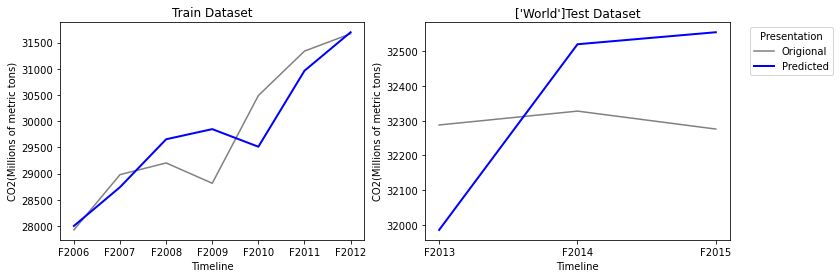

Origional Values:  [array([32287.8], dtype=object), array([32327.8], dtype=object), array([32276.0], dtype=object)]
Predicted Values:  [[31984.90600637]
 [32520.7585233 ]
 [32555.40789394]]
Explained Variance Score: -132.9562192489812
        Maximam Error   : 302.8939936349161
    Mean Absolute Error : 258.4201369571929
    Mean Squared Error  : 69015.51142951909
         r2 score       : -139.45051710028866


In [54]:
i=0
VVIP1=list()
while i<len(CO2_PROD_FINAL.T):
    series=CO2_PROD_FINAL[CO2_PROD_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    # Splitting the data into Train & Test
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=3,shuffle=False)
    # Fitting the model on Train dataset
    Model = LinearRegression()
    Model = Model.fit(X_train, y_train)
    # Predicting and storing results for Test dataset
    train_fit = Model.predict(X_train)
    test_pred = Model.predict(X_test)
    plt.figure(figsize=(12,4))
    # Plotting Regression line on Train Dataset
    plt.subplot(1,2,1)
    plt.plot(y_train, color='gray')
    plt.plot(y_train.index,train_fit, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title("Train Dataset")
    # Plotting Regression line on Test Dataset
    plt.subplot(1,2,2)
    plt.plot(y_test, color='gray')
    plt.plot(y_test.index,test_pred, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title(str(X.columns.values)+"Test Dataset")
    plt.legend(['Origional','Predicted'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()
    pre=test_pred
    y_test=y_test
    y_test=np.array(y_test)
    VVIP1.append(pre)
    exp_rf=explained_variance_score(y_test,pre)
    mxer_rf=max_error(y_test,pre)
    mae_rf=mean_absolute_error(y_test,pre)
    mse_rf=mean_squared_error(y_test,pre)
    r2_rf=r2_score(y_test,pre)
    print("Origional Values: " , list(y_test))
    print("Predicted Values: " , pre)
    print("Explained Variance Score:",exp_rf)
    print("        Maximam Error   :",mxer_rf)
    print("    Mean Absolute Error :",mae_rf)
    print("    Mean Squared Error  :",mse_rf)
    print("         r2 score       :",r2_rf)
    i=i+1

# Random Forest Regression

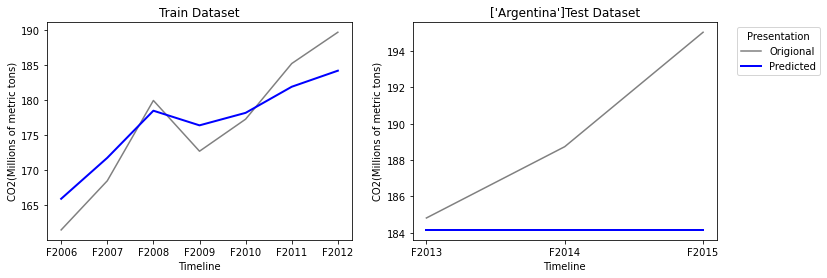

Origional Values:  [array([184.817], dtype=object), array([188.737], dtype=object), array([195.027], dtype=object)]
Predicted Values:  [184.16118 184.16118 184.16118]
Explained Variance Score: 0.0
        Maximam Error   : 10.865819999999957
    Mean Absolute Error : 5.3658199999999665
    Mean Squared Error  : 46.47809093906623
         r2 score       : -1.6279495500638776


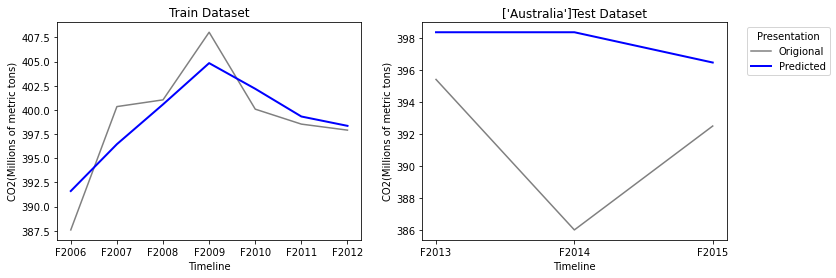

Origional Values:  [array([395.402], dtype=object), array([385.987], dtype=object), array([392.488], dtype=object)]
Predicted Values:  [398.35561 398.35561 396.46035]
Explained Variance Score: -0.14907546450578746
        Maximam Error   : 12.36860999999982
    Mean Absolute Error : 6.4315233333334545
    Mean Squared Error  : 59.161963295566714
         r2 score       : -2.8197315115720993


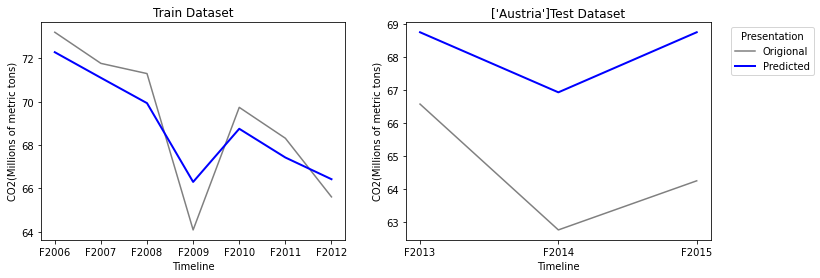

Origional Values:  [array([66.578], dtype=object), array([62.77], dtype=object), array([64.256], dtype=object)]
Predicted Values:  [68.75184 66.93376 68.75184]
Explained Variance Score: 0.5718812573549377
        Maximam Error   : 4.49583999999993
    Mean Absolute Error : 3.6111466666666345
    Mean Squared Error  : 14.09168499626648
         r2 score       : -4.7385020597676855


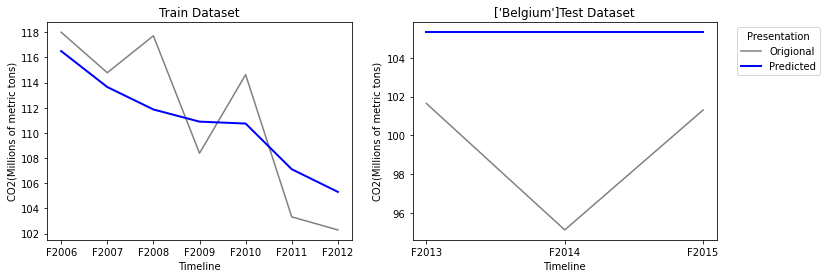

Origional Values:  [array([101.642], dtype=object), array([95.113], dtype=object), array([101.301], dtype=object)]
Predicted Values:  [105.31712 105.31712 105.31712]
Explained Variance Score: 0.0
        Maximam Error   : 10.204119999999875
    Mean Absolute Error : 5.965119999999875
    Mean Squared Error  : 44.586597281065174
         r2 score       : -3.9518981667802926


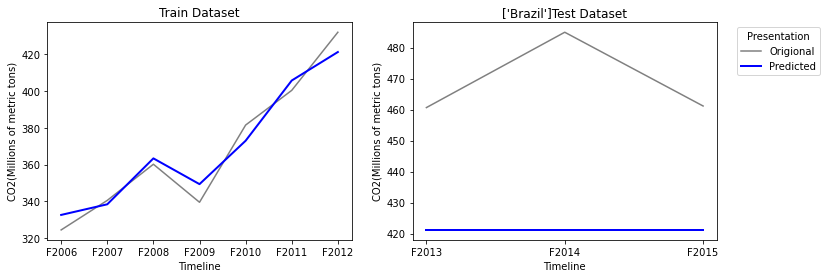

Origional Values:  [array([460.643], dtype=object), array([484.935], dtype=object), array([461.154], dtype=object)]
Predicted Values:  [421.20008 421.20008 421.20008]
Explained Variance Score: 0.0
        Maximam Error   : 63.73491999999993
    Mean Absolute Error : 47.710586666666586
    Mean Squared Error  : 2404.733229633059
         r2 score       : -17.723617990796484


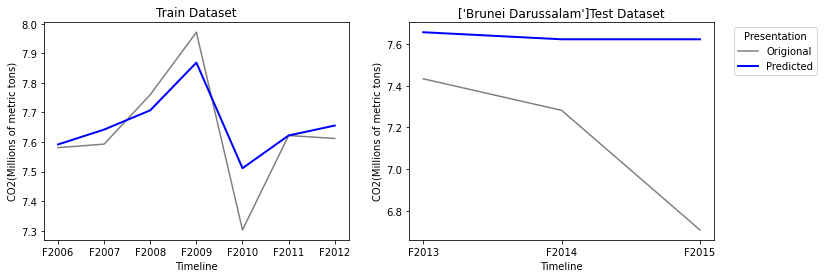

Origional Values:  [array([7.433], dtype=object), array([7.282], dtype=object), array([6.71], dtype=object)]
Predicted Values:  [7.6557  7.62205 7.62205]
Explained Variance Score: 0.06480422566843302
        Maximam Error   : 0.9120499999999927
    Mean Absolute Error : 0.49159999999999293
    Mean Squared Error  : 0.3323548316666596
         r2 score       : -2.427461327536784


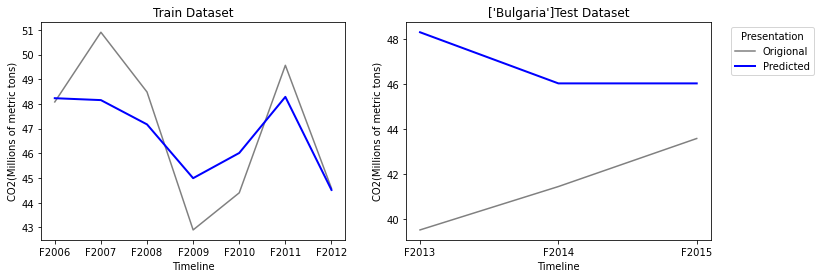

Origional Values:  [array([39.502], dtype=object), array([41.429], dtype=object), array([43.564], dtype=object)]
Predicted Values:  [48.28556 46.01296 46.01296]
Explained Variance Score: -1.5158863589370521
        Maximam Error   : 8.783560000000001
    Mean Absolute Error : 5.272159999999985
    Mean Squared Error  : 34.72034021226657
         r2 score       : -11.61467204678555


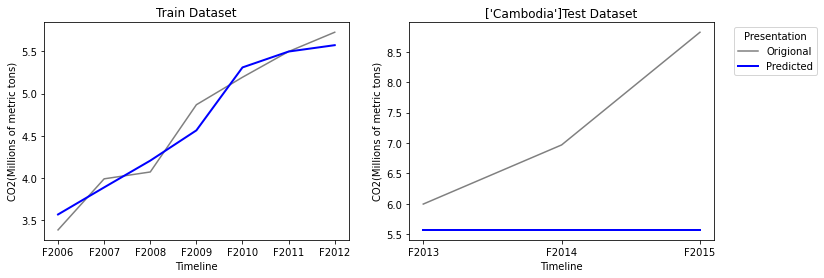

Origional Values:  [array([5.997], dtype=object), array([6.969], dtype=object), array([8.821], dtype=object)]
Predicted Values:  [5.57216 5.57216 5.57216]
Explained Variance Score: 0.0
        Maximam Error   : 3.248839999999994
    Mean Absolute Error : 1.6901733333333278
    Mean Squared Error  : 4.228870785599981
         r2 score       : -2.081852030176678


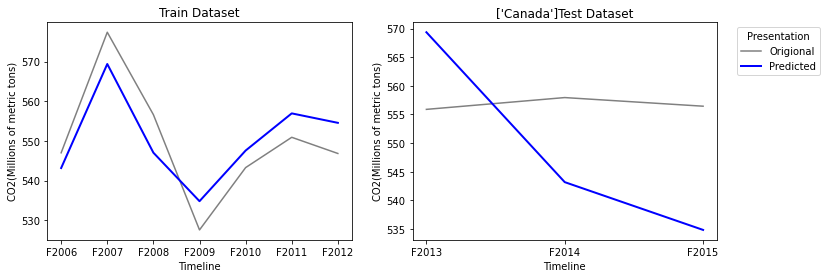

Origional Values:  [array([555.889], dtype=object), array([557.952], dtype=object), array([556.444], dtype=object)]
Predicted Values:  [569.37147 543.16961 534.81729]
Explained Variance Score: -302.94617117232826
        Maximam Error   : 21.626709999999548
    Mean Absolute Error : 16.630523333332917
    Mean Squared Error  : 289.3368789456858
         r2 score       : -379.81453981688486


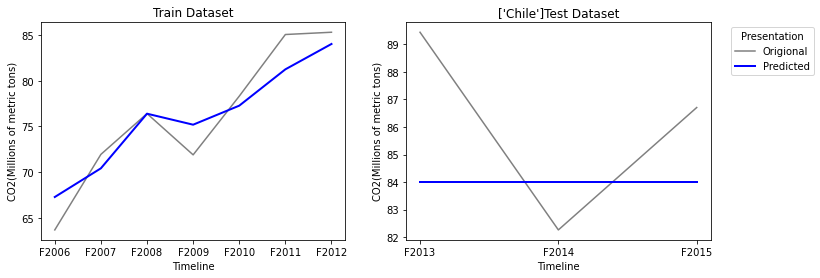

Origional Values:  [array([89.437], dtype=object), array([82.263], dtype=object), array([86.705], dtype=object)]
Predicted Values:  [84.01711 84.01711 84.01711]
Explained Variance Score: 0.0
        Maximam Error   : 5.419889999999967
    Mean Absolute Error : 3.2872966666666534
    Mean Squared Error  : 13.22562071876652
         r2 score       : -0.5132007518814923


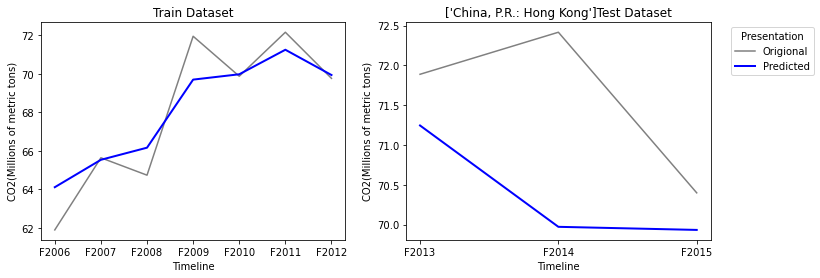

Origional Values:  [array([71.888], dtype=object), array([72.416], dtype=object), array([70.399], dtype=object)]
Predicted Values:  [71.24511 69.97225 69.9334 ]
Explained Variance Score: -0.09497158466067379
        Maximam Error   : 2.443749999999909
    Mean Absolute Error : 1.1840799999999045
    Mean Squared Error  : 2.2006683248664487
         r2 score       : -2.0172805562721146


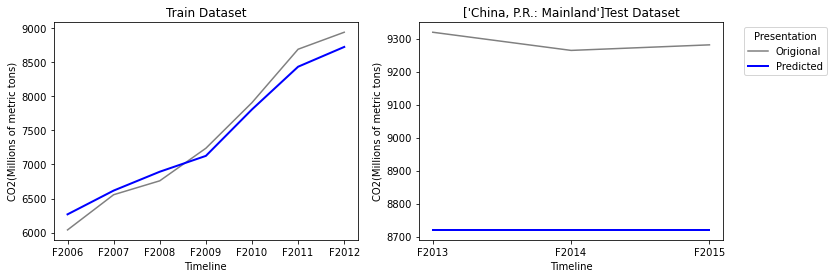

Origional Values:  [array([9319.037], dtype=object), array([9264.018], dtype=object), array([9280.847], dtype=object)]
Predicted Values:  [8720.16832 8720.16832 8720.16832]
Explained Variance Score: 0.0
        Maximam Error   : 598.8686800000105
    Mean Absolute Error : 567.7990133333436
    Mean Squared Error  : 322925.584175874
         r2 score       : -608.449213488622


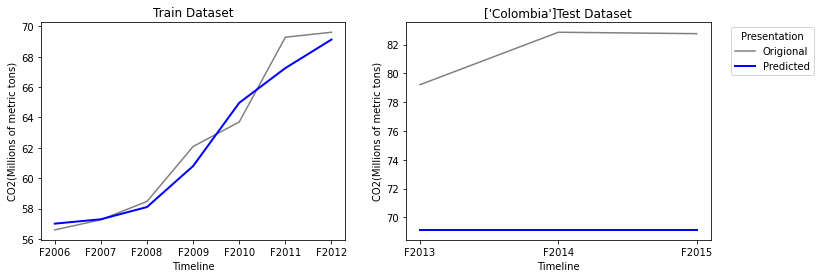

Origional Values:  [array([79.214], dtype=object), array([82.854], dtype=object), array([82.755], dtype=object)]
Predicted Values:  [69.13308 69.13308 69.13308]
Explained Variance Score: 1.1102230246251565e-16
        Maximam Error   : 13.720920000000078
    Mean Absolute Error : 12.474586666666744
    Mean Squared Error  : 158.48176605973524
         r2 score       : -54.28844720074996


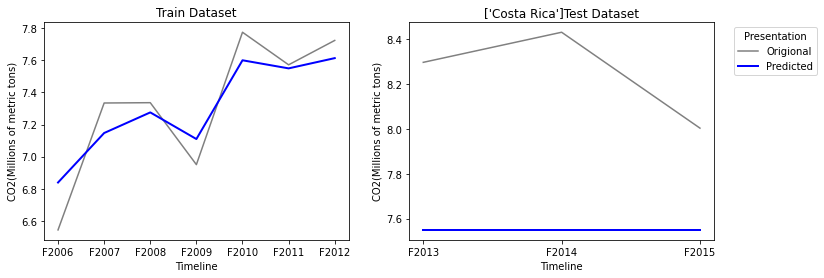

Origional Values:  [array([8.296], dtype=object), array([8.43], dtype=object), array([8.003], dtype=object)]
Predicted Values:  [7.54981 7.54981 7.54981]
Explained Variance Score: 0.0
        Maximam Error   : 0.8801899999999945
    Mean Absolute Error : 0.6931899999999945
    Mean Squared Error  : 0.5123050427666589
         r2 score       : -15.113937473001954


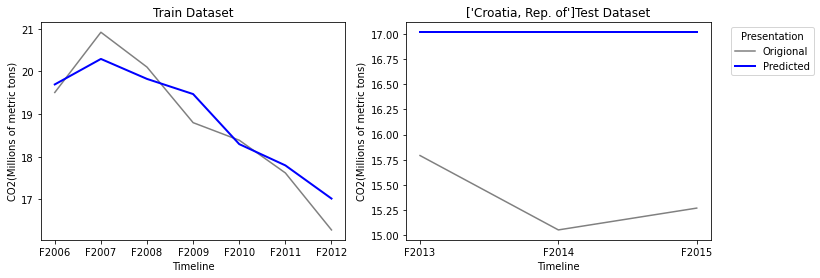

Origional Values:  [array([15.792], dtype=object), array([15.052], dtype=object), array([15.269], dtype=object)]
Predicted Values:  [17.01857 17.01857 17.01857]
Explained Variance Score: 1.1102230246251565e-16
        Maximam Error   : 1.9665699999999653
    Mean Absolute Error : 1.6475699999999651
    Mean Squared Error  : 2.8109555715665517
         r2 score       : -28.138534497210326


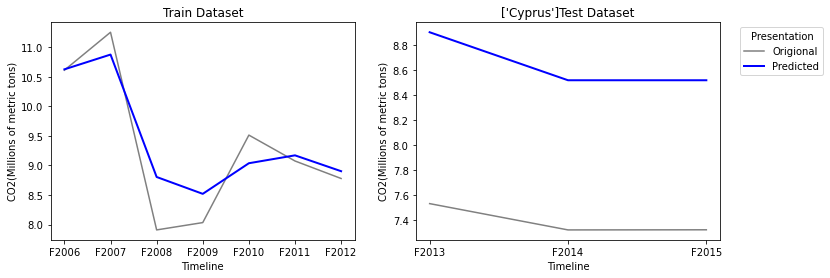

Origional Values:  [array([7.534], dtype=object), array([7.324], dtype=object), array([7.325], dtype=object)]
Predicted Values:  [8.90242 8.5191  8.5191 ]
Explained Variance Score: 0.31160961472742255
        Maximam Error   : 1.368420000000003
    Mean Absolute Error : 1.2525400000000058
    Mean Squared Error  : 1.5755707054666805
         r2 score       : -160.53808695632534


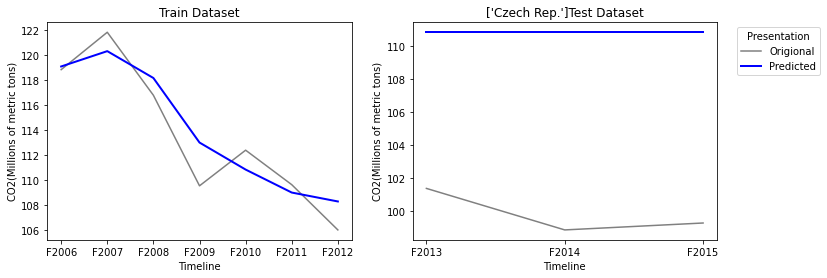

Origional Values:  [array([101.372], dtype=object), array([98.856], dtype=object), array([99.275], dtype=object)]
Predicted Values:  [110.83714 110.83714 110.83714]
Explained Variance Score: 0.0
        Maximam Error   : 11.981140000000082
    Mean Absolute Error : 11.002806666666743
    Mean Squared Error  : 122.27322409960168
         r2 score       : -99.92967135565326


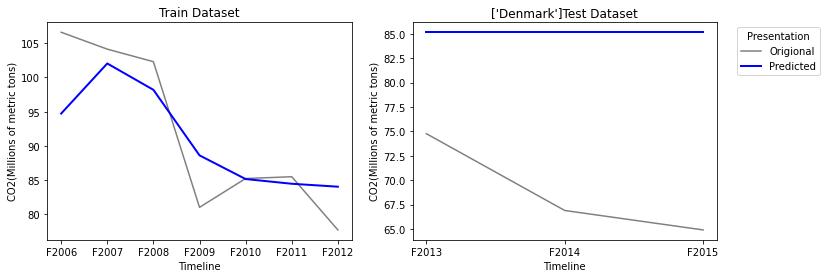

Origional Values:  [array([74.767], dtype=object), array([66.902], dtype=object), array([64.912], dtype=object)]
Predicted Values:  [85.15941 85.15941 85.15941]
Explained Variance Score: 0.0
        Maximam Error   : 20.247409999999988
    Mean Absolute Error : 16.29907666666666
    Mean Squared Error  : 283.76427240809977
         r2 score       : -14.673797960240435


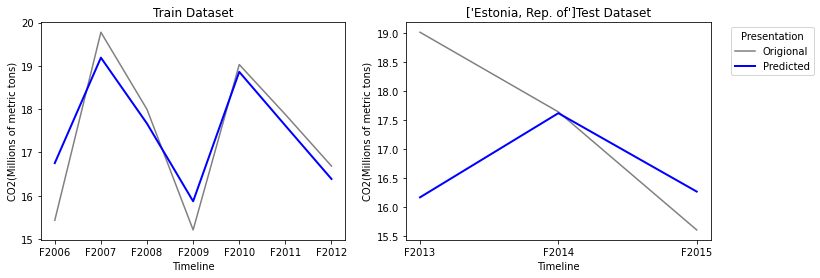

Origional Values:  [array([19.019], dtype=object), array([17.642], dtype=object), array([15.602], dtype=object)]
Predicted Values:  [16.16509 17.62018 16.26461]
Explained Variance Score: -0.17602009377892625
        Maximam Error   : 2.8539099999999955
    Mean Absolute Error : 1.179446666666666
    Mean Squared Error  : 2.861443470866648
         r2 score       : -0.4522130361553891


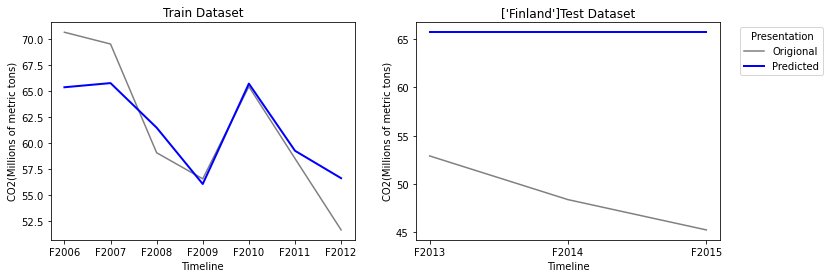

Origional Values:  [array([52.903], dtype=object), array([48.379], dtype=object), array([45.243], dtype=object)]
Predicted Values:  [65.71041 65.71041 65.71041]
Explained Variance Score: 0.0
        Maximam Error   : 20.46741000000008
    Mean Absolute Error : 16.868743333333416
    Mean Squared Error  : 294.4407985347694
         r2 score       : -28.78271863003515


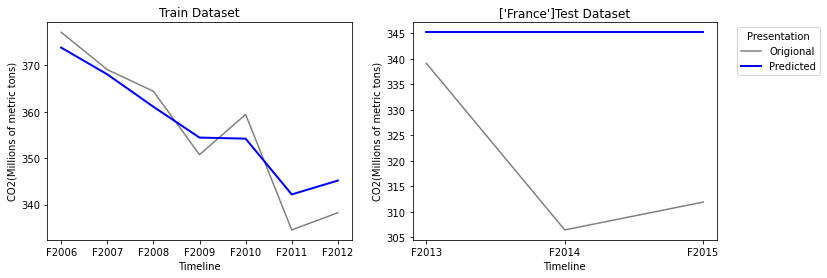

Origional Values:  [array([339.101], dtype=object), array([306.48], dtype=object), array([311.928], dtype=object)]
Predicted Values:  [345.18539 345.18539 345.18539]
Explained Variance Score: 0.0
        Maximam Error   : 38.70538999999968
    Mean Absolute Error : 26.015723333333028
    Mean Squared Error  : 880.3936687787506
         r2 score       : -3.3246477882957404


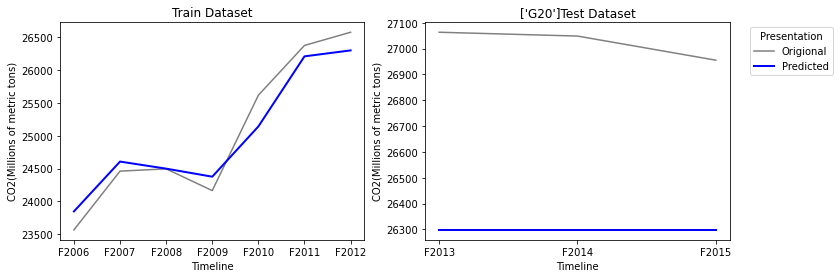

Origional Values:  [array([27063.36], dtype=object), array([27048.59], dtype=object), array([26955.193], dtype=object)]
Predicted Values:  [26298.18549 26298.18549 26298.18549]
Explained Variance Score: 0.0
        Maximam Error   : 765.1745099999753
    Mean Absolute Error : 724.1955099999747
    Mean Squared Error  : 526752.6091927901
         r2 score       : -228.67470148247196


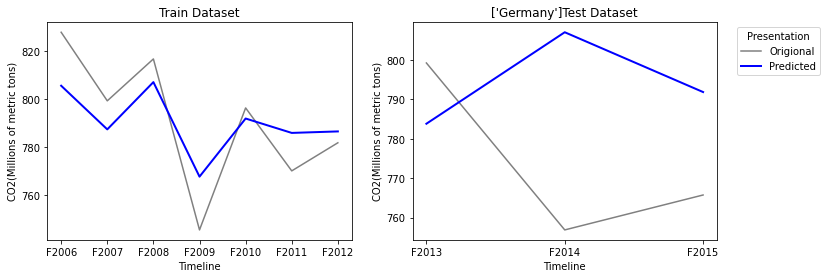

Origional Values:  [array([799.195], dtype=object), array([756.875], dtype=object), array([765.729], dtype=object)]
Predicted Values:  [783.79406 806.98524 791.82525]
Explained Variance Score: -1.204628325699332
        Maximam Error   : 50.110239999999294
    Mean Absolute Error : 30.535809999999817
    Mean Squared Error  : 1143.0797899345425
         r2 score       : -2.441457839120647


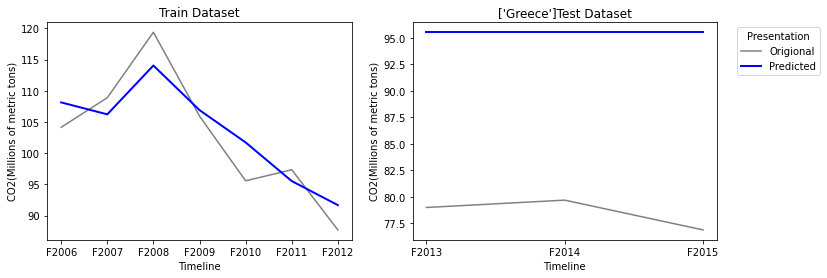

Origional Values:  [array([78.992], dtype=object), array([79.685], dtype=object), array([76.874], dtype=object)]
Predicted Values:  [95.53924 95.53924 95.53924]
Explained Variance Score: 0.0
        Maximam Error   : 18.665239999999955
    Mean Absolute Error : 17.02223999999995
    Mean Squared Error  : 291.1864206175983
         r2 score       : -202.6601937782802


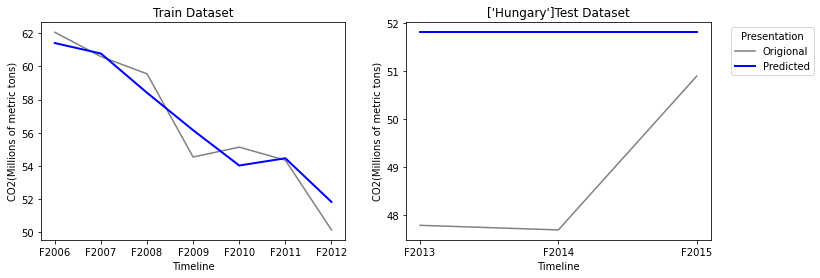

Origional Values:  [array([47.789], dtype=object), array([47.693], dtype=object), array([50.899], dtype=object)]
Predicted Values:  [51.81429 51.81429 51.81429]
Explained Variance Score: 0.0
        Maximam Error   : 4.1212899999999735
    Mean Absolute Error : 3.0206233333333046
    Mean Squared Error  : 11.341915544099828
         r2 score       : -4.114153717786593


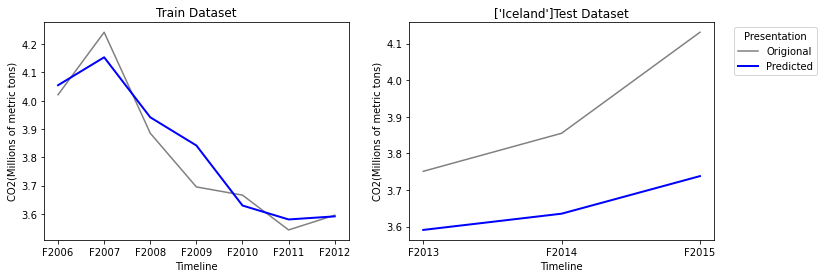

Origional Values:  [array([3.751], dtype=object), array([3.855], dtype=object), array([4.131], dtype=object)]
Predicted Values:  [3.59087 3.63521 3.73789]
Explained Variance Score: 0.6202166954777797
        Maximam Error   : 0.3931100000000036
    Mean Absolute Error : 0.2576766666666665
    Mean Squared Error  : 0.07616157770000054
         r2 score       : -1.9623072504667558


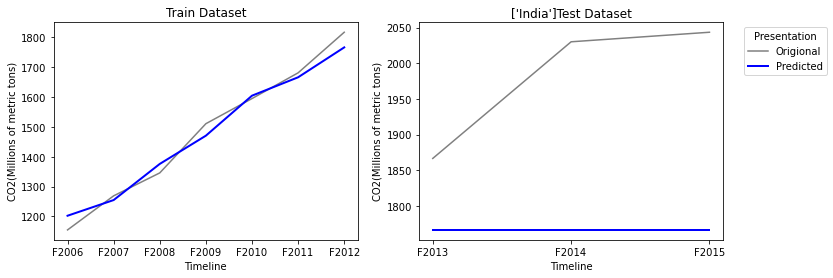

Origional Values:  [array([1866.712], dtype=object), array([2030.043], dtype=object), array([2043.407], dtype=object)]
Predicted Values:  [1766.59244 1766.59244 1766.59244]
Explained Variance Score: 0.0
        Maximam Error   : 276.81456000000094
    Mean Absolute Error : 213.46156000000096
    Mean Squared Error  : 52018.808162300666
         r2 score       : -7.061218882219988


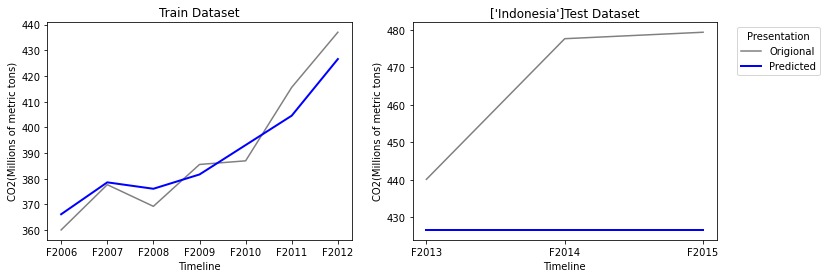

Origional Values:  [array([440.104], dtype=object), array([477.653], dtype=object), array([479.376], dtype=object)]
Predicted Values:  [426.59976 426.59976 426.59976]
Explained Variance Score: 2.220446049250313e-16
        Maximam Error   : 52.77624000000014
    Mean Absolute Error : 39.11124000000016
    Mean Squared Error  : 1858.0431070042796
         r2 score       : -4.658658141298543


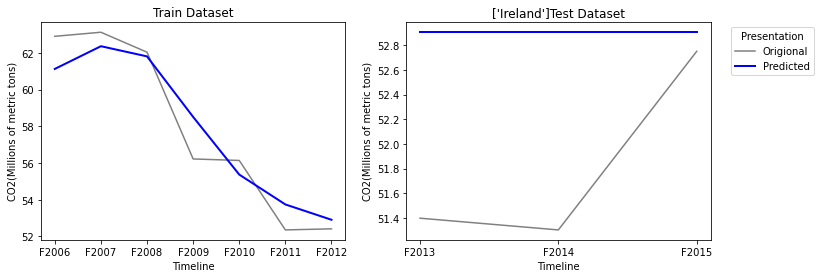

Origional Values:  [array([51.398], dtype=object), array([51.303], dtype=object), array([52.75], dtype=object)]
Predicted Values:  [52.90482 52.90482 52.90482]
Explained Variance Score: 0.0
        Maximam Error   : 1.6018199999999467
    Mean Absolute Error : 1.0878199999999438
    Mean Squared Error  : 1.6201010190665446
         r2 score       : -2.7094584201742515


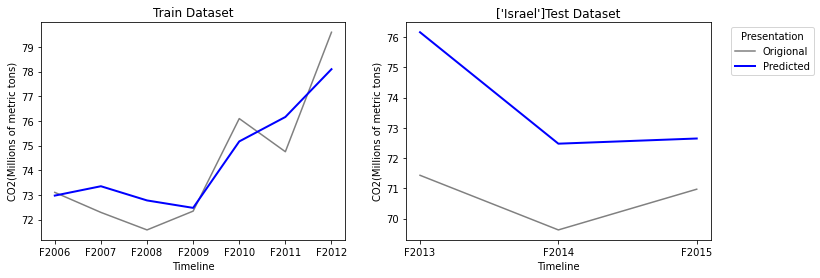

Origional Values:  [array([71.43], dtype=object), array([69.624], dtype=object), array([70.97], dtype=object)]
Predicted Values:  [76.16022 72.4754  72.64649]
Explained Variance Score: -1.6936186011529912
        Maximam Error   : 4.730220000000131
    Mean Absolute Error : 3.0860366666667383
    Mean Squared Error  : 11.105360642833872
         r2 score       : -17.911854977207692


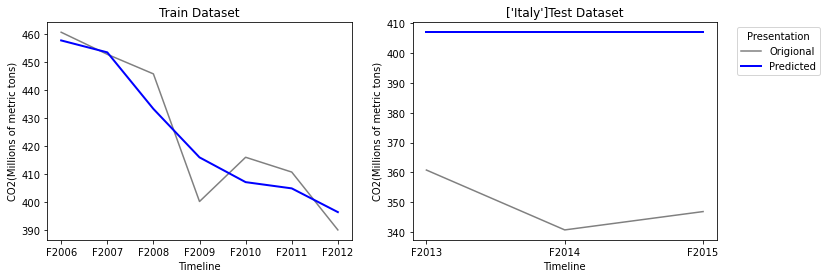

Origional Values:  [array([360.773], dtype=object), array([340.683], dtype=object), array([346.837], dtype=object)]
Predicted Values:  [407.00657 407.00657 407.00657]
Explained Variance Score: 0.0
        Maximam Error   : 66.32356999999928
    Mean Absolute Error : 57.57556999999927
    Mean Squared Error  : 3385.5786954914824
         r2 score       : -46.932351638010516


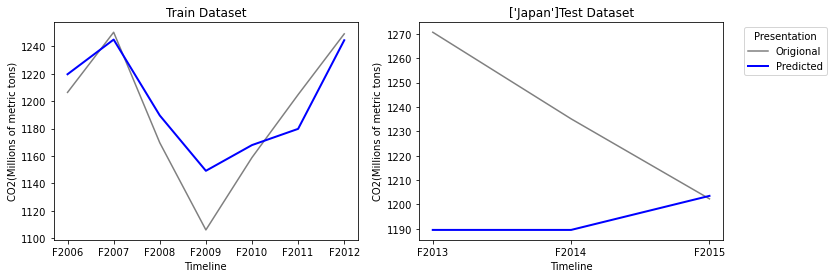

Origional Values:  [array([1270.62], dtype=object), array([1235.109], dtype=object), array([1202.308], dtype=object)]
Predicted Values:  [1189.57125 1189.57125 1203.52941]
Explained Variance Score: -0.45868192907030503
        Maximam Error   : 81.04875000000197
    Mean Absolute Error : 42.60263666666742
    Mean Squared Error  : 2881.3594646711995
         r2 score       : -2.7027715901894793


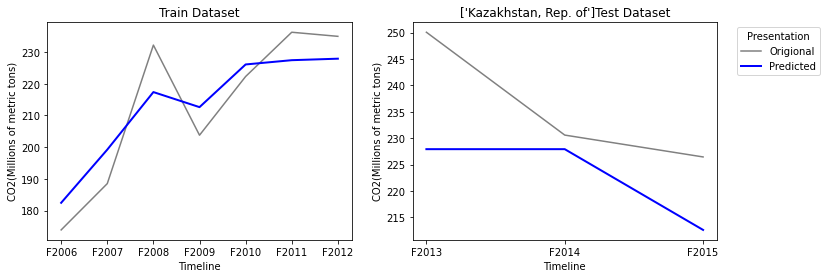

Origional Values:  [array([250.07], dtype=object), array([230.596], dtype=object), array([226.456], dtype=object)]
Predicted Values:  [227.92826 227.92826 212.63634]
Explained Variance Score: 0.39951713906703923
        Maximam Error   : 22.14173999999977
    Mean Absolute Error : 12.876379999999804
    Mean Squared Error  : 229.4521631502616
         r2 score       : -1.1646492384858251


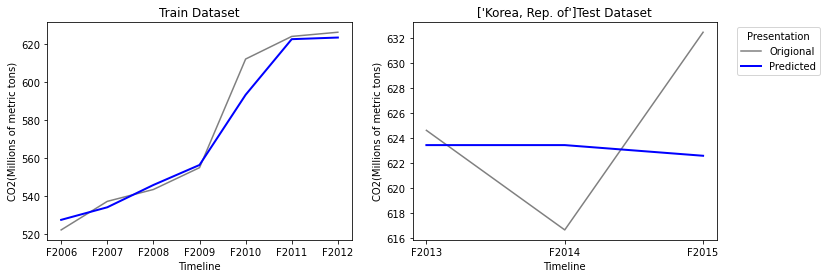

Origional Values:  [array([624.611], dtype=object), array([616.627], dtype=object), array([632.478], dtype=object)]
Predicted Values:  [623.42825 623.42825 622.57337]
Explained Variance Score: -0.11147532166946528
        Maximam Error   : 9.904629999999429
    Mean Absolute Error : 5.962876666666489
    Mean Squared Error  : 48.585864853962015
         r2 score       : -0.16021898891364472


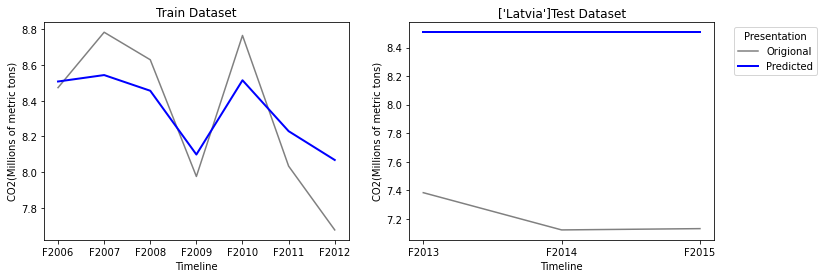

Origional Values:  [array([7.383], dtype=object), array([7.122], dtype=object), array([7.131], dtype=object)]
Predicted Values:  [8.50743 8.50743 8.50743]
Explained Variance Score: 1.1102230246251565e-16
        Maximam Error   : 1.3854299999999906
    Mean Absolute Error : 1.2954299999999905
    Mean Squared Error  : 1.6927728848999752
         r2 score       : -114.67397054120374


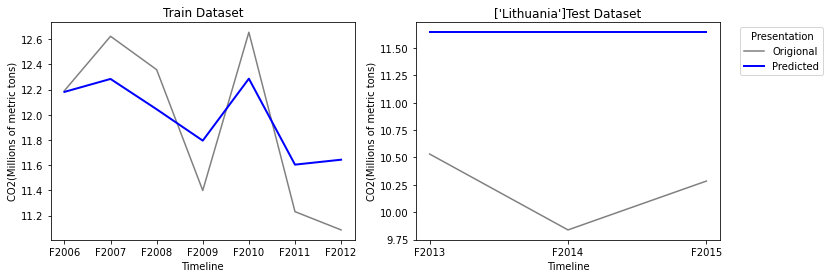

Origional Values:  [array([10.531], dtype=object), array([9.838], dtype=object), array([10.284], dtype=object)]
Predicted Values:  [11.64332 11.64332 11.64332]
Explained Variance Score: 0.0
        Maximam Error   : 1.8053200000000071
    Mean Absolute Error : 1.4256533333333394
    Mean Squared Error  : 2.114728982400018
         r2 score       : -24.71363063495891


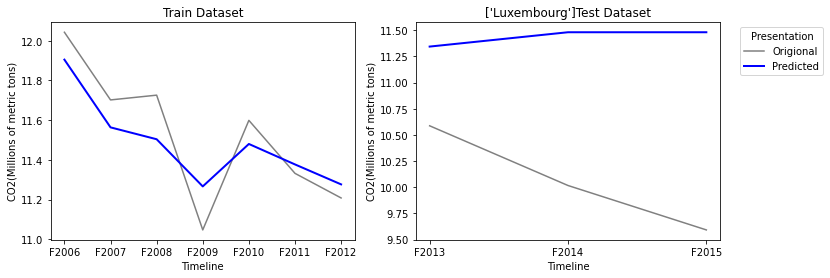

Origional Values:  [array([10.587], dtype=object), array([10.017], dtype=object), array([9.593], dtype=object)]
Predicted Values:  [11.34323 11.48008 11.48008]
Explained Variance Score: -0.3118636716258665
        Maximam Error   : 1.887080000000001
    Mean Absolute Error : 1.3687966666666689
    Mean Squared Error  : 2.091185941900005
         r2 score       : -11.608375545383202


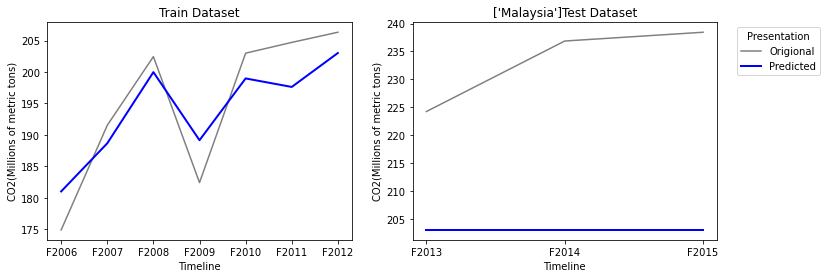

Origional Values:  [array([224.23], dtype=object), array([236.862], dtype=object), array([238.435], dtype=object)]
Predicted Values:  [203.02042 203.02042 203.02042]
Explained Variance Score: 2.220446049250313e-16
        Maximam Error   : 35.4145799999998
    Mean Absolute Error : 30.15524666666646
    Mean Squared Error  : 949.7637657497211
         r2 score       : -22.494544360834702


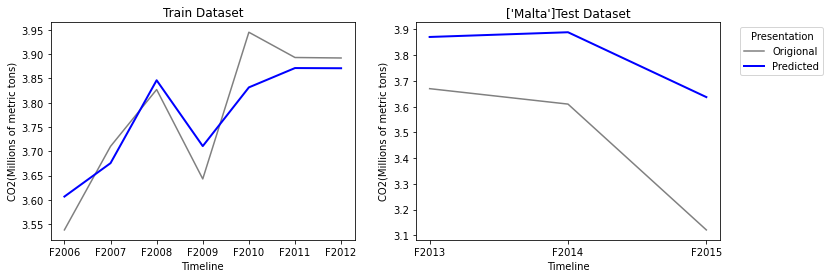

Origional Values:  [array([3.67], dtype=object), array([3.61], dtype=object), array([3.121], dtype=object)]
Predicted Values:  [3.87089 3.88925 3.63721]
Explained Variance Score: 0.7027926942854601
        Maximam Error   : 0.5162100000000027
    Mean Absolute Error : 0.33211666666666523
    Mean Squared Error  : 0.12827003956666647
         r2 score       : -1.1216388164786548


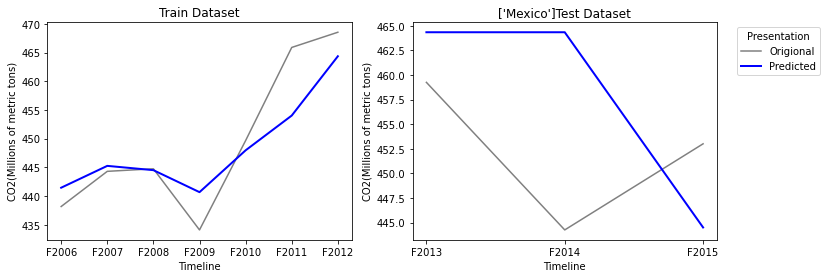

Origional Values:  [array([459.256], dtype=object), array([444.256], dtype=object), array([453.009], dtype=object)]
Predicted Values:  [464.34972 464.34972 444.50713]
Explained Variance Score: -2.6036512741618623
        Maximam Error   : 20.09372000000053
    Mean Absolute Error : 11.229770000000258
    Mean Squared Error  : 167.32845345790727
         r2 score       : -3.420960549389016


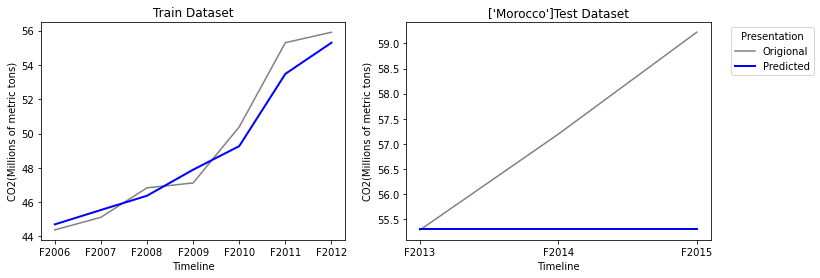

Origional Values:  [array([55.286], dtype=object), array([57.194], dtype=object), array([59.222], dtype=object)]
Predicted Values:  [55.29574 55.29574 55.29574]
Explained Variance Score: 0.0
        Maximam Error   : 3.9262600000000347
    Mean Absolute Error : 1.9447533333333453
    Mean Squared Error  : 6.3396678276001355
         r2 score       : -1.454556510258623


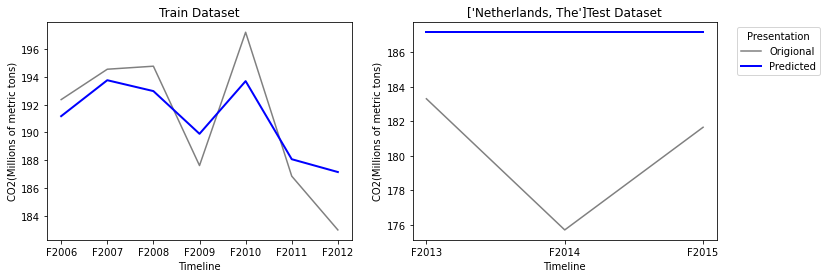

Origional Values:  [array([183.301], dtype=object), array([175.71], dtype=object), array([181.652], dtype=object)]
Predicted Values:  [187.15228 187.15228 187.15228]
Explained Variance Score: 0.0
        Maximam Error   : 11.442280000000096
    Mean Absolute Error : 6.93128000000011
    Mean Squared Error  : 58.67040310506814
         r2 score       : -4.520485918457373


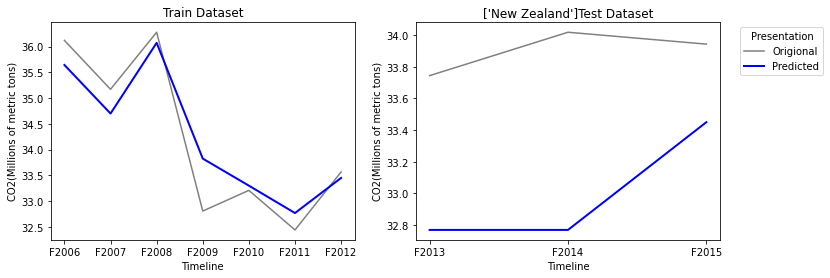

Origional Values:  [array([33.744], dtype=object), array([34.018], dtype=object), array([33.943], dtype=object)]
Predicted Values:  [32.76926 32.76926 33.44984]
Explained Variance Score: -6.297438386727057
        Maximam Error   : 1.248740000000005
    Mean Absolute Error : 0.9055466666666661
    Mean Squared Error  : 0.9175588136000034
         r2 score       : -67.64415655932586


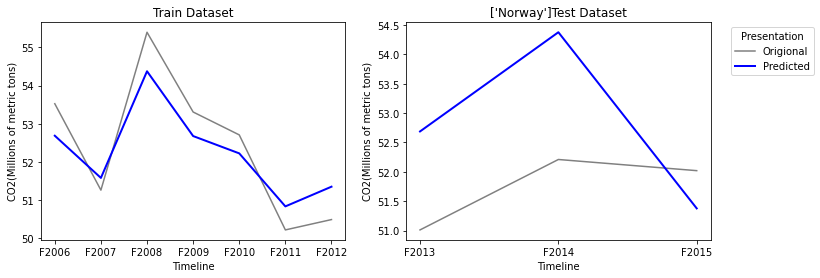

Origional Values:  [array([51.011], dtype=object), array([52.21], dtype=object), array([52.02], dtype=object)]
Predicted Values:  [52.68741 54.37642 51.3775 ]
Explained Variance Score: -4.420813279251311
        Maximam Error   : 2.166419999999981
    Mean Absolute Error : 1.4951099999999566
    Mean Squared Error  : 2.6388441181665256
         r2 score       : -8.531169686392623


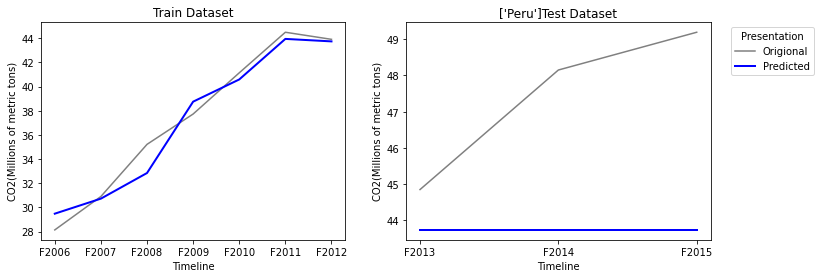

Origional Values:  [array([44.85], dtype=object), array([48.151], dtype=object), array([49.194], dtype=object)]
Predicted Values:  [43.73543 43.73543 43.73543]
Explained Variance Score: 0.0
        Maximam Error   : 5.458569999999931
    Mean Absolute Error : 3.6629033333332637
    Mean Squared Error  : 16.845170384899493
         r2 score       : -3.91354999072414


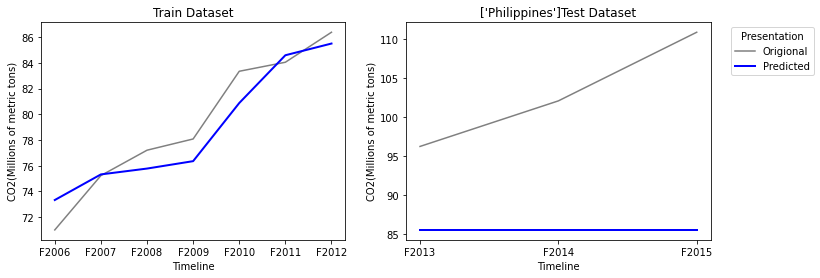

Origional Values:  [array([96.2], dtype=object), array([102.035], dtype=object), array([110.825], dtype=object)]
Predicted Values:  [85.50861 85.50861 85.50861]
Explained Variance Score: 0.0
        Maximam Error   : 25.31639000000007
    Mean Absolute Error : 17.511390000000066
    Mean Squared Error  : 342.78232973210237
         r2 score       : -8.48653895706628


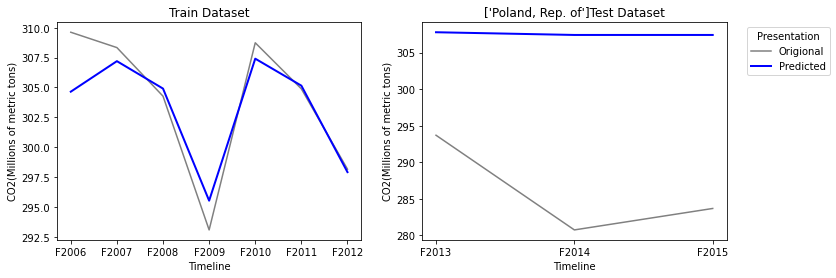

Origional Values:  [array([293.7], dtype=object), array([280.762], dtype=object), array([283.693], dtype=object)]
Predicted Values:  [307.77616 307.40614 307.40614]
Explained Variance Score: 0.060503504356338444
        Maximam Error   : 26.64414000000039
    Mean Absolute Error : 21.47781333333353
    Mean Squared Error  : 490.12049511494473
         r2 score       : -14.975090750918637


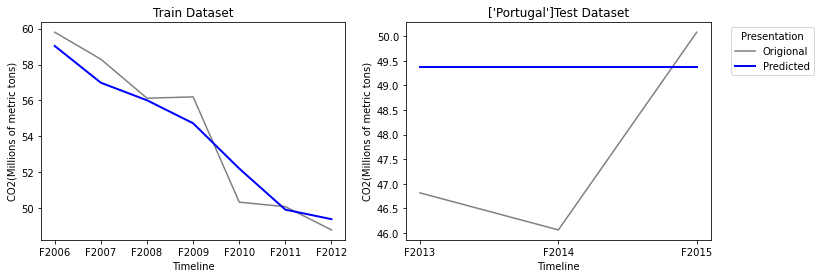

Origional Values:  [array([46.816], dtype=object), array([46.064], dtype=object), array([50.077], dtype=object)]
Predicted Values:  [49.37959 49.37959 49.37959]
Explained Variance Score: 0.0
        Maximam Error   : 3.3155900000000145
    Mean Absolute Error : 2.19219666666667
    Mean Squared Error  : 6.017170481433378
         r2 score       : -0.9834069335895399


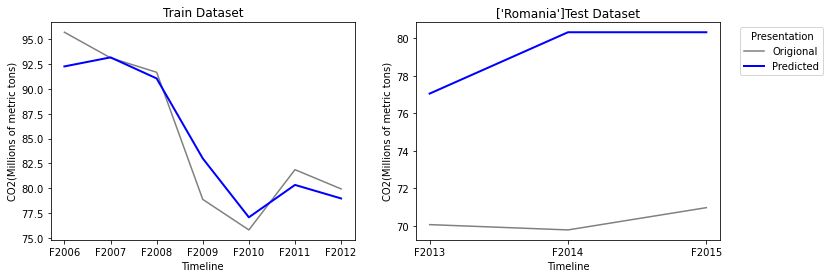

Origional Values:  [array([70.074], dtype=object), array([69.792], dtype=object), array([70.978], dtype=object)]
Predicted Values:  [77.05527 80.32464 80.32464]
Explained Variance Score: -7.515388164730977
        Maximam Error   : 10.53264
    Mean Absolute Error : 8.95351666666671
    Mean Squared Error  : 82.34477182403396
         r2 score       : -320.75199207424095


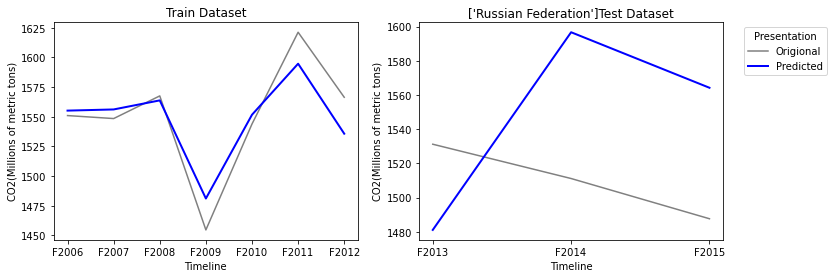

Origional Values:  [array([1531.207], dtype=object), array([1511.148], dtype=object), array([1487.625], dtype=object)]
Predicted Values:  [1481.09284 1596.68923 1564.21943]
Explained Variance Score: -11.096833532804009
        Maximam Error   : 85.54123000000186
    Mean Absolute Error : 70.74994000000167
    Mean Squared Error  : 5231.81258981472
         r2 score       : -15.492083844488949


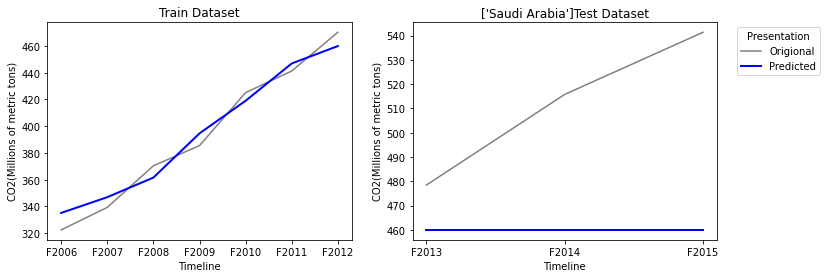

Origional Values:  [array([478.436], dtype=object), array([515.782], dtype=object), array([541.376], dtype=object)]
Predicted Values:  [459.95027 459.95027 459.95027]
Explained Variance Score: 0.0
        Maximam Error   : 81.42572999999959
    Mean Absolute Error : 51.91439666666628
    Mean Squared Error  : 3363.017931486193
         r2 score       : -4.035111111893899


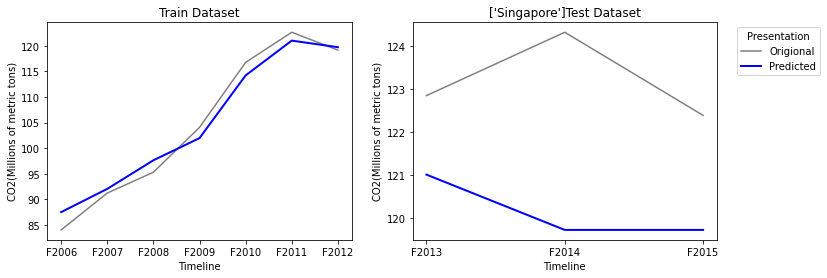

Origional Values:  [array([122.854], dtype=object), array([124.33], dtype=object), array([122.394], dtype=object)]
Predicted Values:  [121.01575 119.72778 119.72778]
Explained Variance Score: -0.9668663235844024
        Maximam Error   : 4.602220000000031
    Mean Absolute Error : 3.0355633333333194
    Mean Squared Error  : 10.55610702643336
         r2 score       : -14.477476924760062


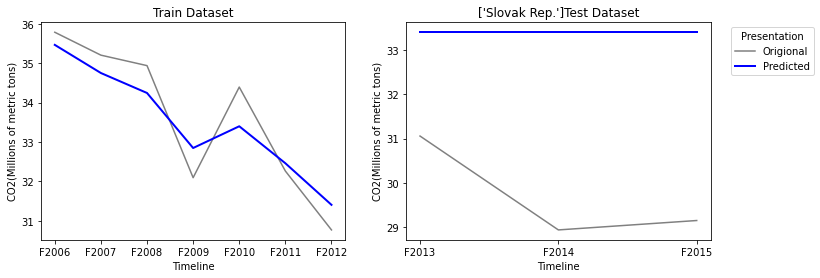

Origional Values:  [array([31.057], dtype=object), array([28.94], dtype=object), array([29.152], dtype=object)]
Predicted Values:  [33.39805 33.39805 33.39805]
Explained Variance Score: 0.0
        Maximam Error   : 4.45804999999994
    Mean Absolute Error : 3.6817166666666075
    Mean Squared Error  : 14.461221835832893
         r2 score       : -14.958368597910352


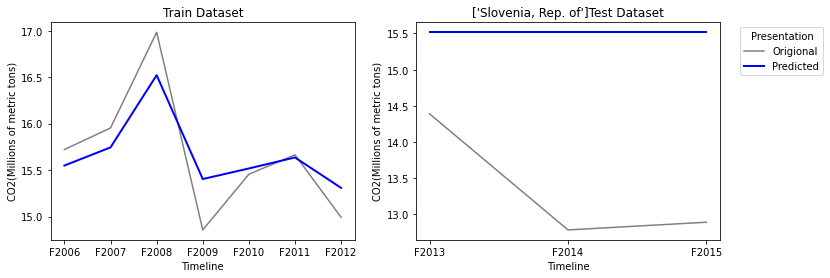

Origional Values:  [array([14.389], dtype=object), array([12.786], dtype=object), array([12.892], dtype=object)]
Predicted Values:  [15.51729 15.51729 15.51729]
Explained Variance Score: 0.0
        Maximam Error   : 2.731289999999987
    Mean Absolute Error : 2.1616233333333206
    Mean Squared Error  : 5.208376990766612
         r2 score       : -8.721445924513583


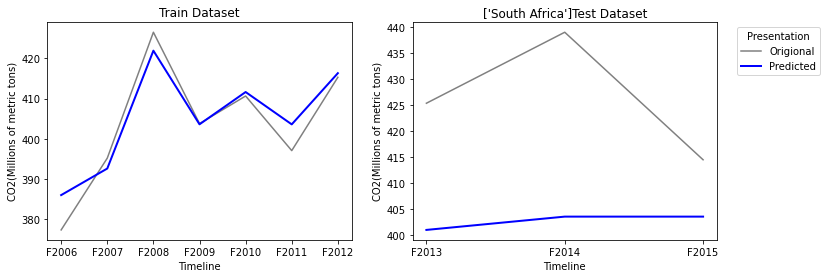

Origional Values:  [array([425.375], dtype=object), array([439.015], dtype=object), array([414.513], dtype=object)]
Predicted Values:  [401.03619 403.59093 403.59093]
Explained Variance Score: 0.001261352183199893
        Maximam Error   : 35.424070000000256
    Mean Absolute Error : 23.561650000000345
    Mean Squared Error  : 655.5113402219832
         r2 score       : -5.5233616785637425


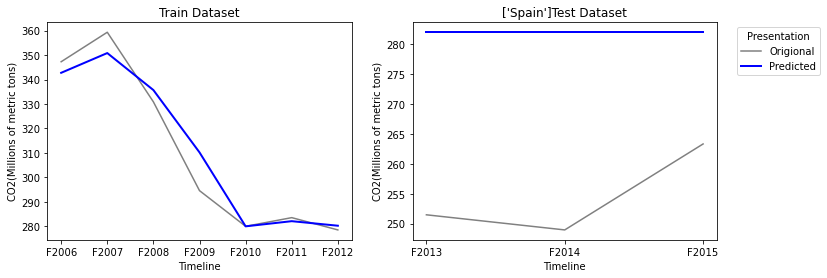

Origional Values:  [array([251.47], dtype=object), array([248.941], dtype=object), array([263.328], dtype=object)]
Predicted Values:  [282.02405 282.02405 282.02405]
Explained Variance Score: 0.0
        Maximam Error   : 33.08305000000021
    Mean Absolute Error : 27.44438333333356
    Mean Squared Error  : 792.5268181025122
         r2 score       : -19.149341278874125


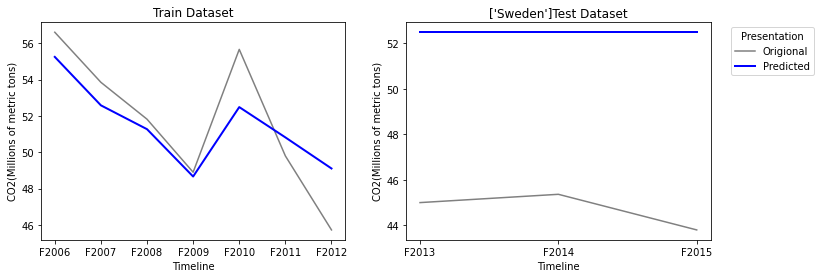

Origional Values:  [array([45.003], dtype=object), array([45.367], dtype=object), array([43.803], dtype=object)]
Predicted Values:  [52.48505 52.48505 52.48505]
Explained Variance Score: 0.0
        Maximam Error   : 8.68204999999994
    Mean Absolute Error : 7.760716666666606
    Mean Squared Error  : 60.67523340249905
         r2 score       : -134.88766926886103


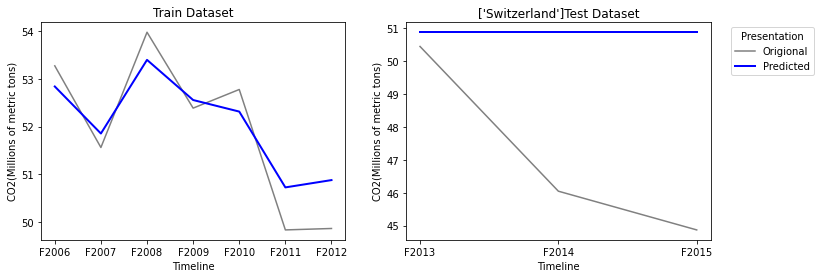

Origional Values:  [array([50.448], dtype=object), array([46.045], dtype=object), array([44.867], dtype=object)]
Predicted Values:  [50.88075 50.88075 50.88075]
Explained Variance Score: 1.1102230246251565e-16
        Maximam Error   : 6.013750000000044
    Mean Absolute Error : 3.760750000000042
    Mean Squared Error  : 19.912313229166983
         r2 score       : -2.451562214533896


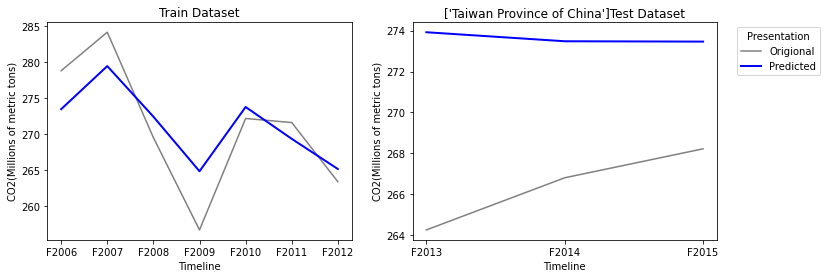

Origional Values:  [array([264.26], dtype=object), array([266.809], dtype=object), array([268.224], dtype=object)]
Predicted Values:  [273.92216 273.48156 273.4644 ]
Explained Variance Score: -0.26134102786934
        Maximam Error   : 9.662160000000029
    Mean Absolute Error : 7.191706666666676
    Mean Squared Error  : 55.11406165973349
         r2 score       : -19.486026219289027


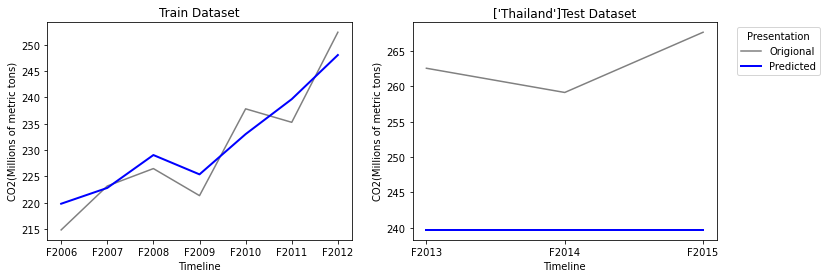

Origional Values:  [array([262.577], dtype=object), array([259.148], dtype=object), array([267.676], dtype=object)]
Predicted Values:  [239.68409 239.68409 239.68409]
Explained Variance Score: 0.0
        Maximam Error   : 27.991910000000132
    Mean Absolute Error : 23.449576666666815
    Mean Squared Error  : 562.1587154014402
         r2 score       : -44.79305394592188


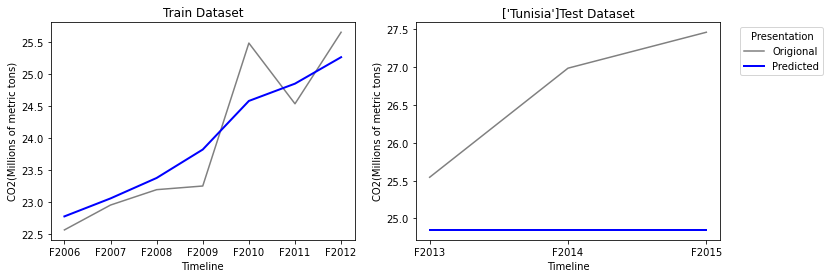

Origional Values:  [array([25.545], dtype=object), array([26.987], dtype=object), array([27.462], dtype=object)]
Predicted Values:  [24.84903 24.84903 24.84903]
Explained Variance Score: 0.0
        Maximam Error   : 2.6129700000000007
    Mean Absolute Error : 1.8156366666666675
    Mean Squared Error  : 3.9609673942333345
         r2 score       : -4.961443786662556


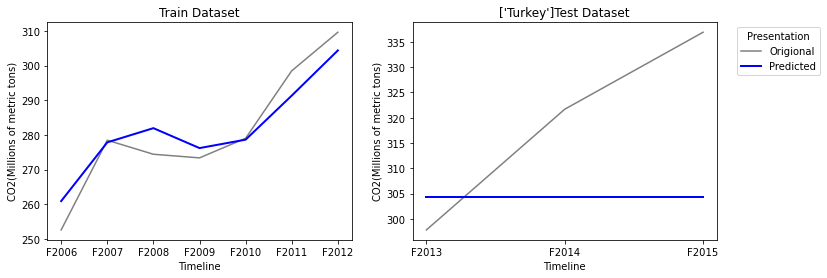

Origional Values:  [array([297.813], dtype=object), array([321.668], dtype=object), array([336.883], dtype=object)]
Predicted Values:  [304.39369 304.39369 304.39369]
Explained Variance Score: 0.0
        Maximam Error   : 32.489309999999875
    Mean Absolute Error : 18.781436666666632
    Mean Squared Error  : 465.75417704276333
         r2 score       : -0.8013526830352133


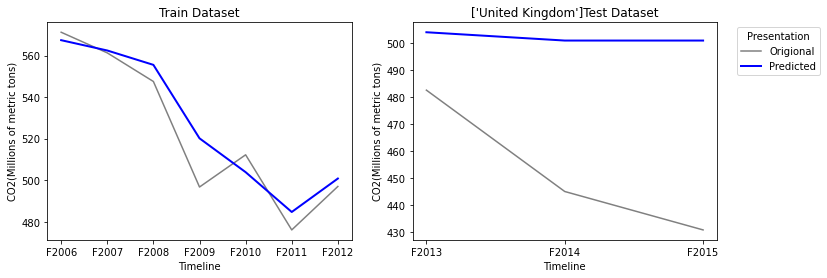

Origional Values:  [array([482.462], dtype=object), array([444.989], dtype=object), array([430.787], dtype=object)]
Predicted Values:  [503.86969 500.7991  500.7991 ]
Explained Variance Score: 0.12361755481985637
        Maximam Error   : 70.01209999999986
    Mean Absolute Error : 49.07662999999982
    Mean Squared Error  : 2824.9168665186844
         r2 score       : -4.945485334103201


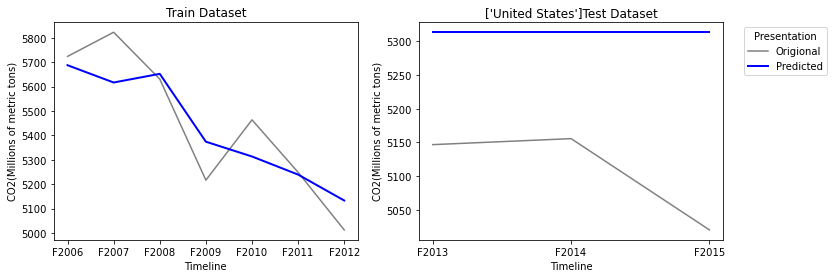

Origional Values:  [array([5146.637], dtype=object), array([5155.535], dtype=object), array([5020.004], dtype=object)]
Predicted Values:  [5313.52099 5313.52099 5313.52099]
Explained Variance Score: 0.0
        Maximam Error   : 293.5169900000037
    Mean Absolute Error : 206.1289900000038
    Mean Squared Error  : 46320.687524421664
         r2 score       : -11.089354310144653


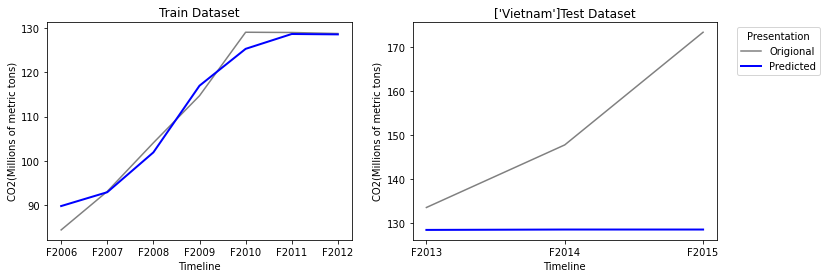

Origional Values:  [array([133.605], dtype=object), array([147.779], dtype=object), array([173.294], dtype=object)]
Predicted Values:  [128.52725 128.61346 128.61346]
Explained Variance Score: 0.0038202230629690304
        Maximam Error   : 44.68054000000009
    Mean Absolute Error : 22.974610000000098
    Mean Squared Error  : 796.4840410819041
         r2 score       : -1.9534239617907416


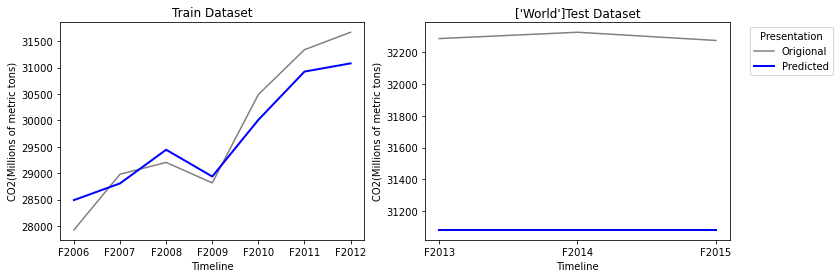

Origional Values:  [array([32287.8], dtype=object), array([32327.8], dtype=object), array([32276.0], dtype=object)]
Predicted Values:  [31079.577 31079.577 31079.577]
Explained Variance Score: 0.0
        Maximam Error   : 1248.2229999999836
    Mean Absolute Error : 1217.622999999984
    Mean Squared Error  : 1483097.1567956274
         r2 score       : -3017.1876257577023


In [55]:
i=0
VVIP2=list()
while i<len(CO2_PROD_FINAL.T):
    series=CO2_PROD_FINAL[CO2_PROD_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    # Splitting the data into Train & Test
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=3,shuffle=False)
    # Fitting the model on Train dataset
    Model = RandomForestRegressor()
    Model = Model.fit(X_train, y_train)
    # Predicting and storing results for Test dataset
    train_fit = Model.predict(X_train)
    test_pred = Model.predict(X_test)
    plt.figure(figsize=(12,4))
    # Plotting Regression line on Train Dataset
    plt.subplot(1,2,1)
    plt.plot(y_train, color='gray')
    plt.plot(y_train.index,train_fit, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title("Train Dataset")
    # Plotting Regression line on Test Dataset
    plt.subplot(1,2,2)
    plt.plot(y_test, color='gray')
    plt.plot(y_test.index,test_pred, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title(str(X.columns.values)+"Test Dataset")
    plt.legend(['Origional','Predicted'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()
    pre=test_pred
    y_test=y_test
    y_test=np.array(y_test)
    VVIP2.append(pre)
    exp_rf=explained_variance_score(y_test,pre)
    mxer_rf=max_error(y_test,pre)
    mae_rf=mean_absolute_error(y_test,pre)
    mse_rf=mean_squared_error(y_test,pre)
    r2_rf=r2_score(y_test,pre)
    print("Origional Values: " , list(y_test))
    print("Predicted Values: " , pre)
    print("Explained Variance Score:",exp_rf)
    print("        Maximam Error   :",mxer_rf)
    print("    Mean Absolute Error :",mae_rf)
    print("    Mean Squared Error  :",mse_rf)
    print("         r2 score       :",r2_rf)
    i=i+1

# MLP

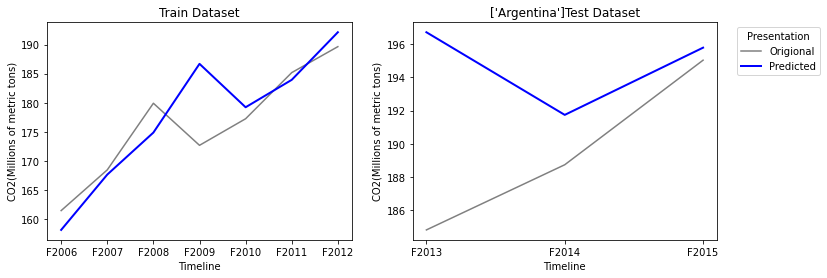

Origional Values:  [array([184.817], dtype=object), array([188.737], dtype=object), array([195.027], dtype=object)]
Predicted Values:  [196.70730806 191.73655909 195.7799988 ]
Explained Variance Score: -0.3075711065051856
        Maximam Error   : 11.890308056113355
    Mean Absolute Error : 5.2142886480114425
    Mean Squared Error  : 50.31459586583872
         r2 score       : -1.84487200088802


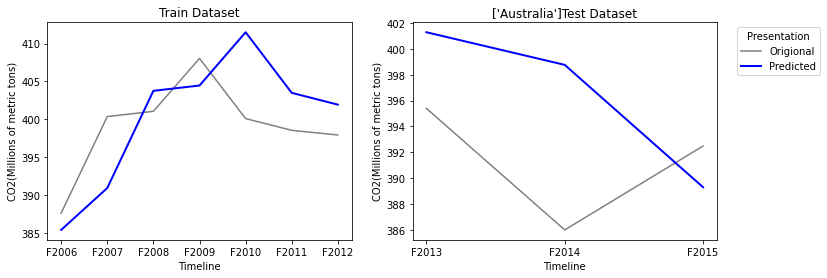

Origional Values:  [array([395.402], dtype=object), array([385.987], dtype=object), array([392.488], dtype=object)]
Predicted Values:  [401.29880924 398.77156068 389.2918614 ]
Explained Variance Score: -1.7655302127213544
        Maximam Error   : 12.78456068040606
    Mean Absolute Error : 7.292502839278673
    Mean Squared Error  : 69.477550979123
         r2 score       : -3.4857468555594684


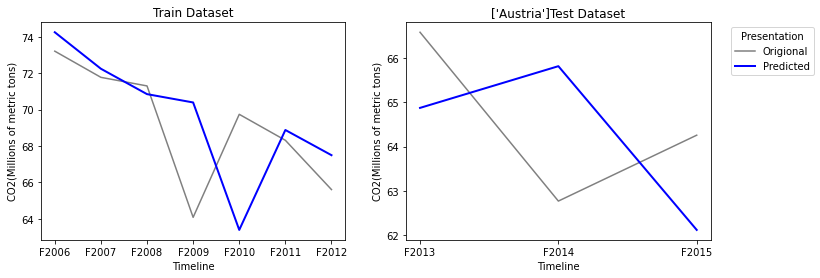

Origional Values:  [array([66.578], dtype=object), array([62.77], dtype=object), array([64.256], dtype=object)]
Predicted Values:  [64.8717628  65.81249532 62.11939282]
Explained Variance Score: -1.2424033131171508
        Maximam Error   : 3.042495319234895
    Mean Absolute Error : 2.295113233283722
    Mean Squared Error  : 5.577704465334226
         r2 score       : -1.271386890324056


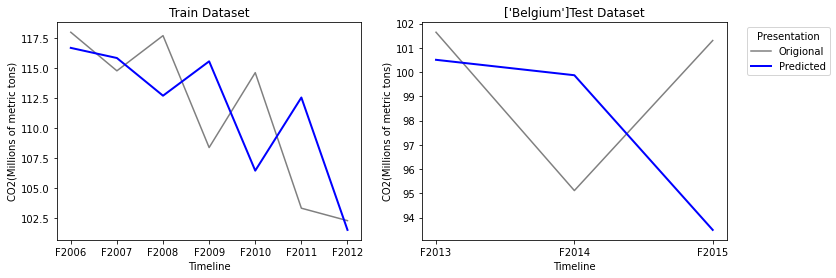

Origional Values:  [array([101.642], dtype=object), array([95.113], dtype=object), array([101.301], dtype=object)]
Predicted Values:  [100.50539799  99.86938106  93.49064907]
Explained Variance Score: -1.9269767767031403
        Maximam Error   : 7.810350934096874
    Mean Absolute Error : 4.567778001853507
    Mean Squared Error  : 28.305535538250453
         r2 score       : -2.1436830368107485


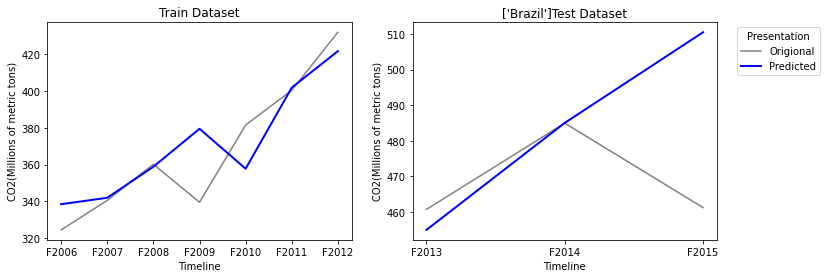

Origional Values:  [array([460.643], dtype=object), array([484.935], dtype=object), array([461.154], dtype=object)]
Predicted Values:  [454.87422943 485.00806161 510.52790023]
Explained Variance Score: -3.762887544748253
        Maximam Error   : 49.37390023361655
    Mean Absolute Error : 18.405244135493508
    Mean Squared Error  : 823.6886920367069
         r2 score       : -5.413365201173452


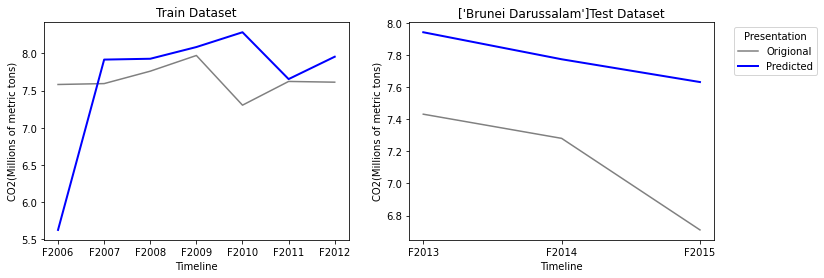

Origional Values:  [array([7.433], dtype=object), array([7.282], dtype=object), array([6.71], dtype=object)]
Predicted Values:  [7.94493271 7.77615388 7.6337762 ]
Explained Variance Score: 0.5937884589542702
        Maximam Error   : 0.9237762035440804
    Mean Absolute Error : 0.6432875946809261
    Mean Squared Error  : 0.45320854045172504
         r2 score       : -3.673784153875756


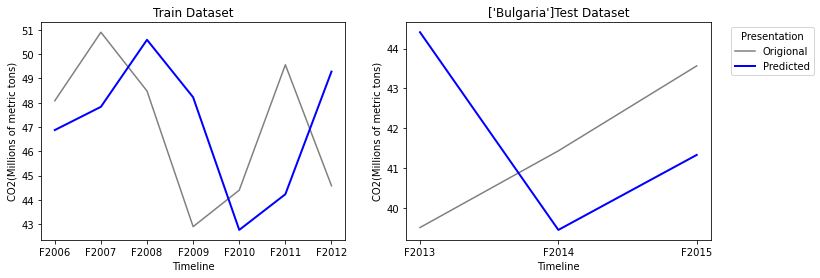

Origional Values:  [array([39.502], dtype=object), array([41.429], dtype=object), array([43.564], dtype=object)]
Predicted Values:  [44.40911154 39.44200412 41.32643168]
Explained Variance Score: -2.981929238112657
        Maximam Error   : 4.907111540868726
    Mean Absolute Error : 3.0438919128900346
    Mean Squared Error  : 11.011536093405953
         r2 score       : -3.000736044072026


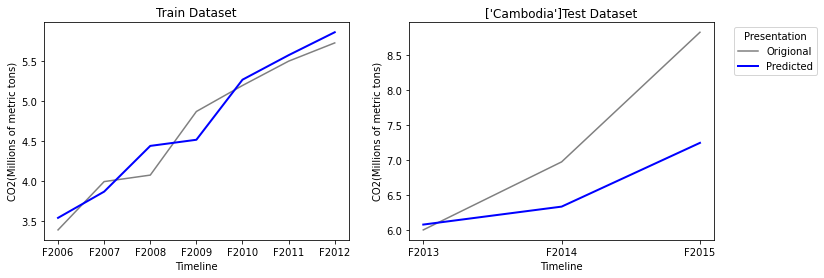

Origional Values:  [array([5.997], dtype=object), array([6.969], dtype=object), array([8.821], dtype=object)]
Predicted Values:  [6.07339047 6.32983017 7.24073044]
Explained Variance Score: 0.6645886324661465
        Maximam Error   : 1.5802695617033145
    Mean Absolute Error : 0.76527661794587
    Mean Squared Error  : 0.9705418192326195
         r2 score       : 0.29270331783167725


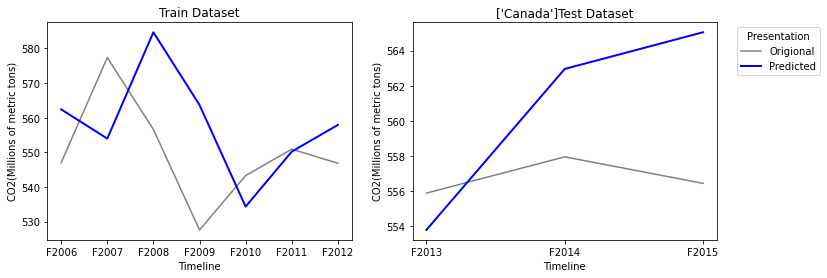

Origional Values:  [array([555.889], dtype=object), array([557.952], dtype=object), array([556.444], dtype=object)]
Predicted Values:  [553.79559866 562.95254733 565.03946571]
Explained Variance Score: -24.957578142493205
        Maximam Error   : 8.59546570904422
    Mean Absolute Error : 5.229804796130982
    Mean Squared Error  : 34.42327786370252
         r2 score       : -44.306650042061975


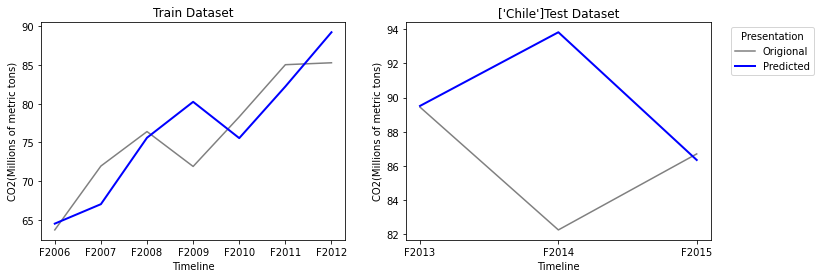

Origional Values:  [array([89.437], dtype=object), array([82.263], dtype=object), array([86.705], dtype=object)]
Predicted Values:  [89.50871453 93.81357914 86.34848396]
Explained Variance Score: -2.479805943230146
        Maximam Error   : 11.550579142109328
    Mean Absolute Error : 3.9929365685049967
    Mean Squared Error  : 44.51604172553798
         r2 score       : -4.093273823760041


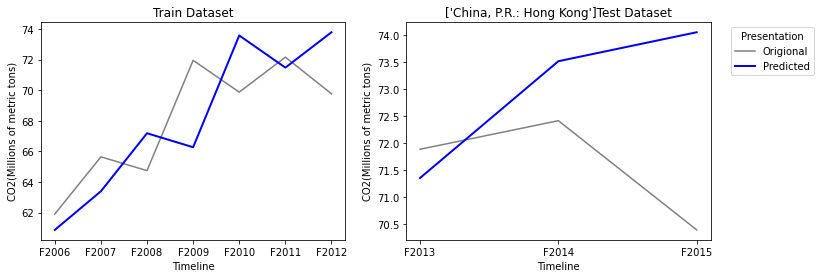

Origional Values:  [array([71.888], dtype=object), array([72.416], dtype=object), array([70.399], dtype=object)]
Predicted Values:  [71.35736145 73.51398892 74.04909198]
Explained Variance Score: -3.0590155169902946
        Maximam Error   : 3.650091983068137
    Mean Absolute Error : 1.7595731537131674
    Mean Squared Error  : 4.936776145943987
         r2 score       : -5.768688633135457


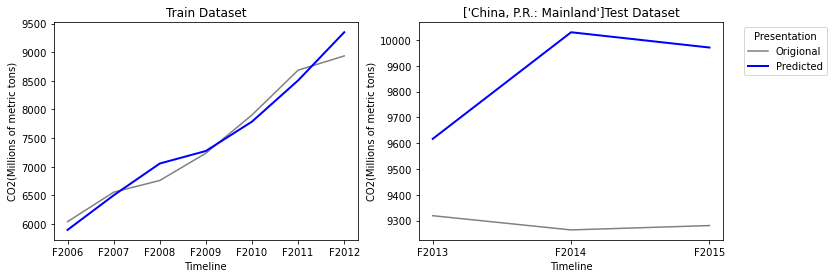

Origional Values:  [array([9319.037], dtype=object), array([9264.018], dtype=object), array([9280.847], dtype=object)]
Predicted Values:  [ 9616.90158233 10029.75851695  9970.5461847 ]
Explained Variance Score: -78.31261140679975
        Maximam Error   : 765.74051694851
    Mean Absolute Error : 584.4347613262004
    Mean Squared Error  : 383588.93802581145
         r2 score       : -722.9376129933538


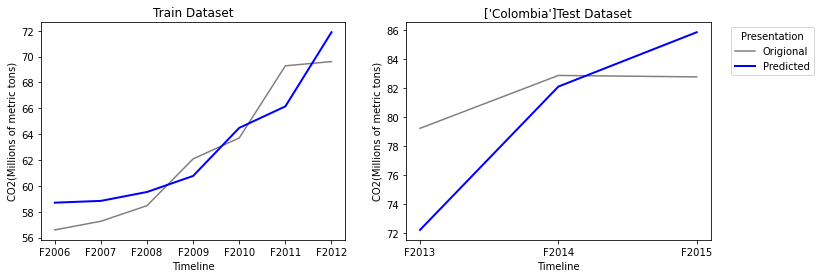

Origional Values:  [array([79.214], dtype=object), array([82.854], dtype=object), array([82.755], dtype=object)]
Predicted Values:  [72.22158482 82.08688606 85.82786913]
Explained Variance Score: -5.00082570374328
        Maximam Error   : 6.992415175666423
    Mean Absolute Error : 3.610799415356771
    Mean Squared Error  : 19.64161949068755
         r2 score       : -5.852237132054547


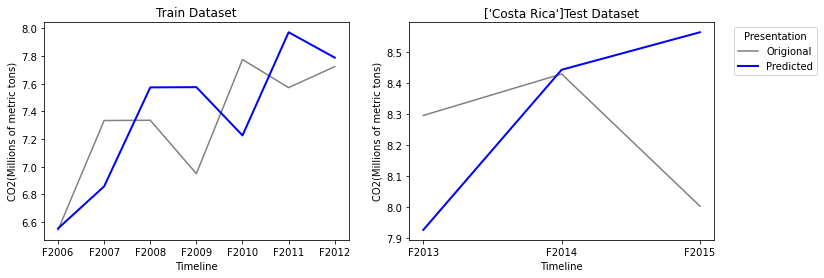

Origional Values:  [array([8.296], dtype=object), array([8.43], dtype=object), array([8.003], dtype=object)]
Predicted Values:  [7.92628808 8.44364348 8.56485715]
Explained Variance Score: -3.5968690875008162
        Maximam Error   : 0.5618571520669207
    Mean Absolute Error : 0.31507085251313277
    Mean Squared Error  : 0.15085217025854533
         r2 score       : -3.7448731444949264


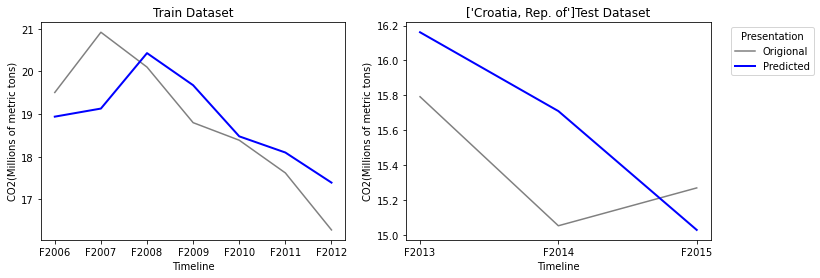

Origional Values:  [array([15.792], dtype=object), array([15.052], dtype=object), array([15.269], dtype=object)]
Predicted Values:  [16.16170382 15.70957374 15.0281557 ]
Explained Variance Score: -0.4544654413364235
        Maximam Error   : 0.6575737377826911
    Mean Absolute Error : 0.4227072861312333
    Mean Squared Error  : 0.2090300371485552
         r2 score       : -1.1668179355150392


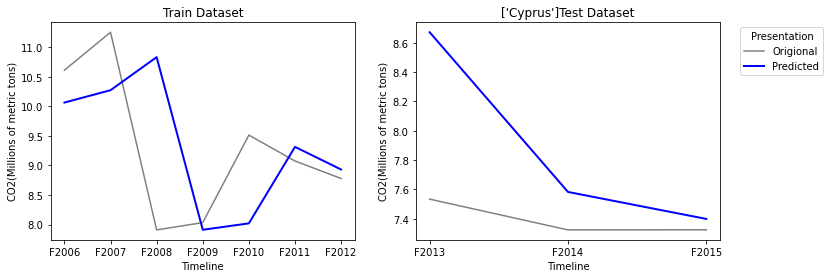

Origional Values:  [array([7.534], dtype=object), array([7.324], dtype=object), array([7.325], dtype=object)]
Predicted Values:  [8.67210903 7.58290104 7.39893767]
Explained Variance Score: -21.096543927748286
        Maximam Error   : 1.1381090313987245
    Mean Absolute Error : 0.4903159152973764
    Mean Squared Error  : 0.4559295655789703
         r2 score       : -45.74496013090087


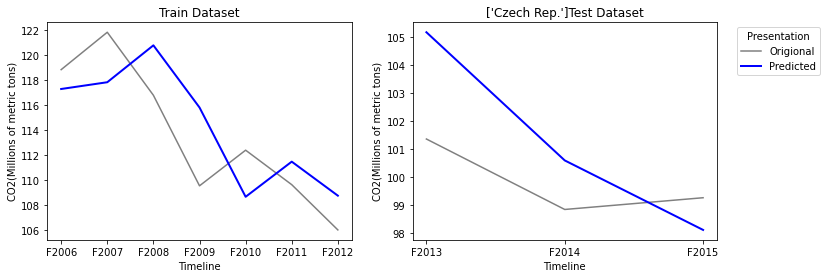

Origional Values:  [array([101.372], dtype=object), array([98.856], dtype=object), array([99.275], dtype=object)]
Predicted Values:  [105.1840778  100.60716091  98.12590193]
Explained Variance Score: -2.4184512451475406
        Maximam Error   : 3.812077797538066
    Mean Absolute Error : 2.2374455903626633
    Mean Squared Error  : 6.306309341134455
         r2 score       : -4.205503772022154


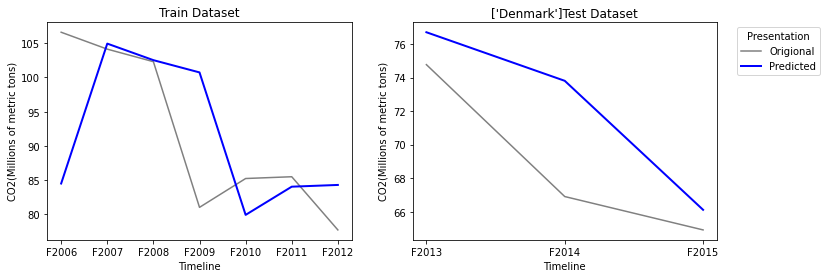

Origional Values:  [array([74.767], dtype=object), array([66.902], dtype=object), array([64.912], dtype=object)]
Predicted Values:  [76.69928348 73.80320221 66.11063917]
Explained Variance Score: 0.6455882969275224
        Maximam Error   : 6.9012022103180755
    Mean Absolute Error : 3.344041620076775
    Mean Squared Error  : 17.599015749141525
         r2 score       : 0.027913504366661512


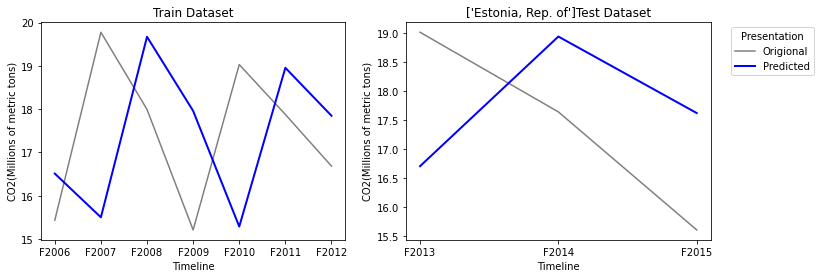

Origional Values:  [array([19.019], dtype=object), array([17.642], dtype=object), array([15.602], dtype=object)]
Predicted Values:  [16.70346607 18.94453851 17.62236338]
Explained Variance Score: -0.8273612473009049
        Maximam Error   : 2.315533933960573
    Mean Absolute Error : 1.87947860983925
    Mean Squared Error  : 3.71339072418767
         r2 score       : -0.8845853405486159


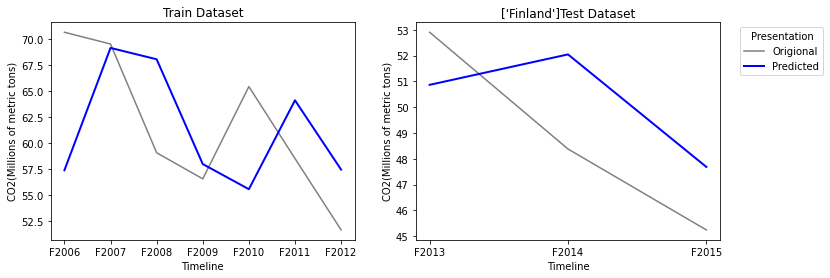

Origional Values:  [array([52.903], dtype=object), array([48.379], dtype=object), array([45.243], dtype=object)]
Predicted Values:  [50.86533259 52.04383983 47.68442304]
Explained Variance Score: 0.3922273397704775
        Maximam Error   : 3.664839827564407
    Mean Absolute Error : 2.7146434254746175
    Mean Squared Error  : 7.847895297545446
         r2 score       : 0.2061845415177017


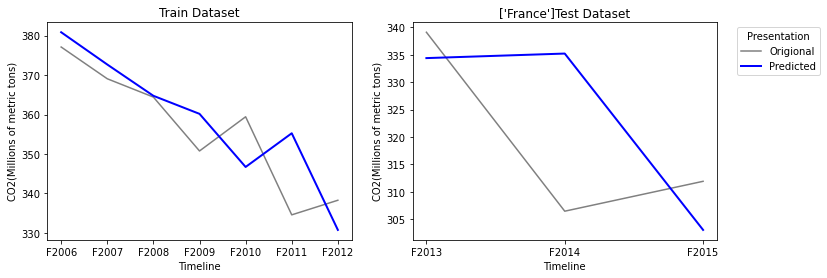

Origional Values:  [array([339.101], dtype=object), array([306.48], dtype=object), array([311.928], dtype=object)]
Predicted Values:  [334.38732364 335.21515138 303.06685538]
Explained Variance Score: -0.3915138678987824
        Maximam Error   : 28.735151380901414
    Mean Absolute Error : 14.103324118381371
    Mean Squared Error  : 308.81585120315395
         r2 score       : -0.5169575103248638


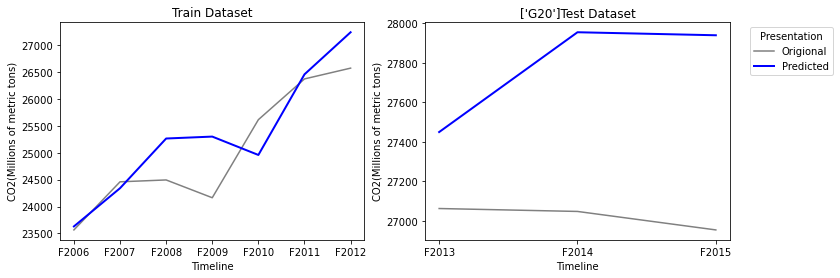

Origional Values:  [array([27063.36], dtype=object), array([27048.59], dtype=object), array([26955.193], dtype=object)]
Predicted Values:  [27449.94796047 27954.53594723 27939.27989505]
Explained Variance Score: -29.659171777547503
        Maximam Error   : 984.0868950489312
    Mean Absolute Error : 758.8736009156904
    Mean Squared Error  : 646205.1091638588
         r2 score       : -280.7583870559191


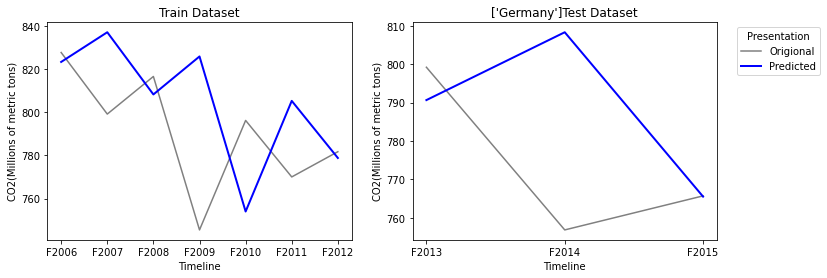

Origional Values:  [array([799.195], dtype=object), array([756.875], dtype=object), array([765.729], dtype=object)]
Predicted Values:  [790.64797662 808.29823325 765.53667724]
Explained Variance Score: -1.117651232611101
        Maximam Error   : 51.4232332457168
    Mean Absolute Error : 20.05419312721972
    Mean Squared Error  : 905.8125046994875
         r2 score       : -1.7271198148381832


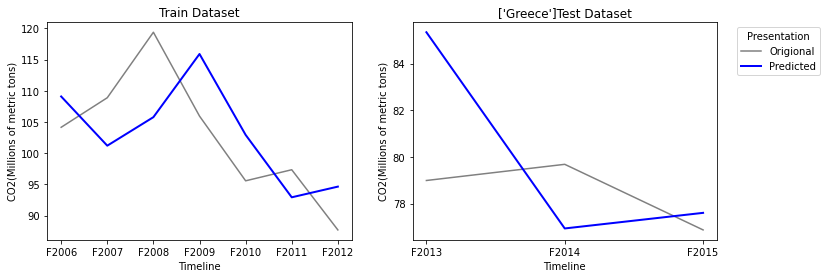

Origional Values:  [array([78.992], dtype=object), array([79.685], dtype=object), array([76.874], dtype=object)]
Predicted Values:  [85.34510979 76.93674279 77.60520652]
Explained Variance Score: -8.834347842575763
        Maximam Error   : 6.353109790527014
    Mean Absolute Error : 3.277524506804274
    Mean Squared Error  : 16.149861563153255
         r2 score       : -10.295457832367786


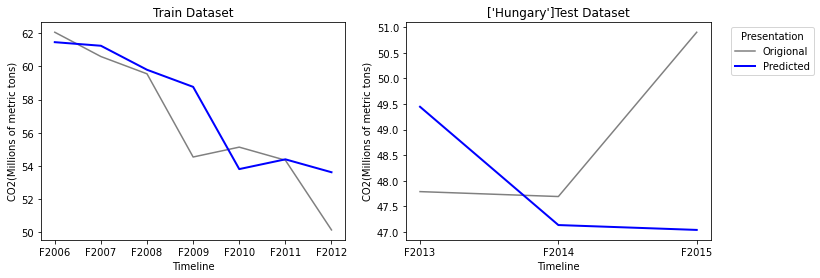

Origional Values:  [array([47.789], dtype=object), array([47.693], dtype=object), array([50.899], dtype=object)]
Predicted Values:  [49.44470034 47.13647741 47.04157831]
Explained Variance Score: -1.3138754245579745
        Maximam Error   : 3.85742168817454
    Mean Absolute Error : 2.0232148713650537
    Mean Squared Error  : 5.976921027402976
         r2 score       : -1.695037956715431


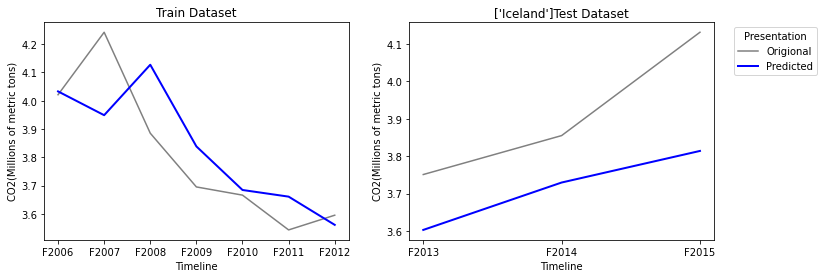

Origional Values:  [array([3.751], dtype=object), array([3.855], dtype=object), array([4.131], dtype=object)]
Predicted Values:  [3.60306998 3.72963552 3.81401254]
Explained Variance Score: 0.7155952448490572
        Maximam Error   : 0.31698745729922173
    Mean Absolute Error : 0.1967606532337546
    Mean Squared Error  : 0.04602686411696128
         r2 score       : -0.7902165029588353


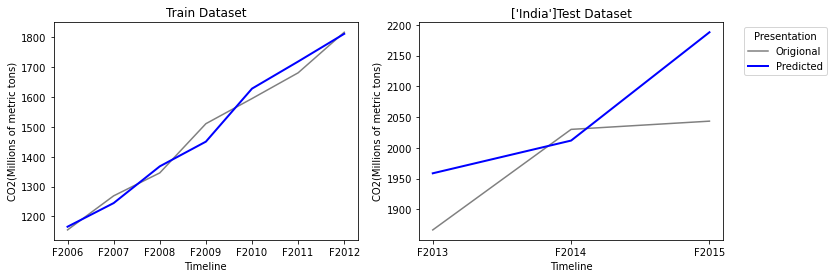

Origional Values:  [array([1866.712], dtype=object), array([2030.043], dtype=object), array([2043.407], dtype=object)]
Predicted Values:  [1958.69511344 2011.87257783 2187.86042936]
Explained Variance Score: 0.2882958643212693
        Maximam Error   : 144.45342935683107
    Mean Absolute Error : 84.868988322172
    Mean Squared Error  : 9885.950217683256
         r2 score       : -0.531999893477576


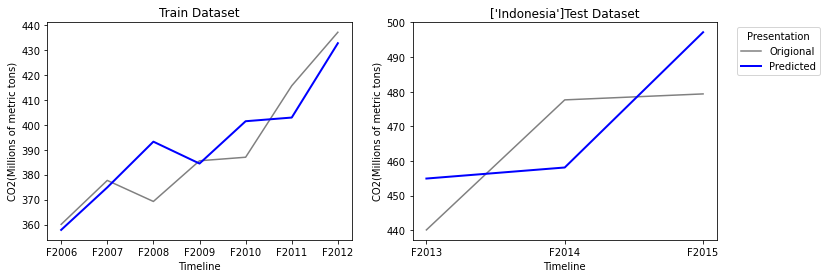

Origional Values:  [array([440.104], dtype=object), array([477.653], dtype=object), array([479.376], dtype=object)]
Predicted Values:  [454.93769461 458.12873928 497.18367279]
Explained Variance Score: 0.12594780787751292
        Maximam Error   : 19.52426072382724
    Mean Absolute Error : 17.388542709288345
    Mean Squared Error  : 306.11615430351776
         r2 score       : 0.06772525233527205


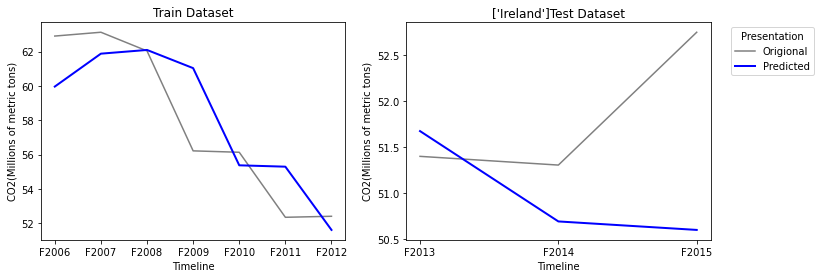

Origional Values:  [array([51.398], dtype=object), array([51.303], dtype=object), array([52.75], dtype=object)]
Predicted Values:  [51.67315943 50.68899117 50.59660384]
Explained Variance Score: -1.304456783399393
        Maximam Error   : 2.1533961628928324
    Mean Absolute Error : 1.014188140735553
    Mean Squared Error  : 1.6966115289034776
         r2 score       : -2.884640431423131


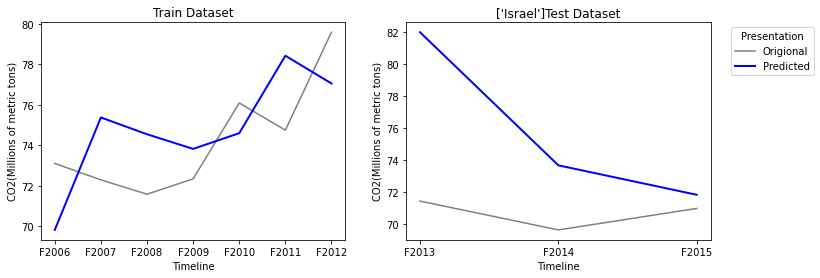

Origional Values:  [array([71.43], dtype=object), array([69.624], dtype=object), array([70.97], dtype=object)]
Predicted Values:  [82.007132   73.66918718 71.82493386]
Explained Variance Score: -26.88391570761987
        Maximam Error   : 10.577131998748797
    Mean Absolute Error : 5.159084344452741
    Mean Squared Error  : 42.99005750504612
         r2 score       : -72.20984515004314


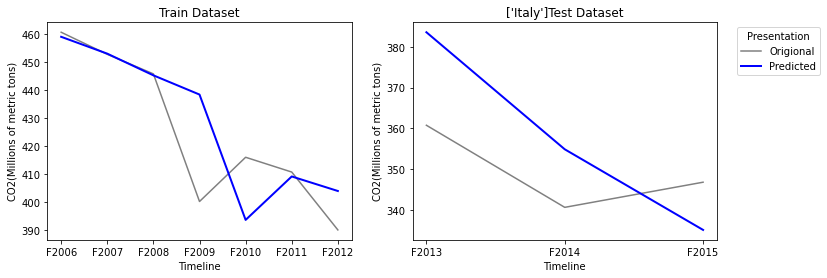

Origional Values:  [array([360.773], dtype=object), array([340.683], dtype=object), array([346.837], dtype=object)]
Predicted Values:  [383.54235639 354.89292626 335.15874773]
Explained Variance Score: -2.0362182343340596
        Maximam Error   : 22.769356388388474
    Mean Absolute Error : 16.21917830857035
    Mean Squared Error  : 285.5823903079802
         r2 score       : -3.0432188364413433


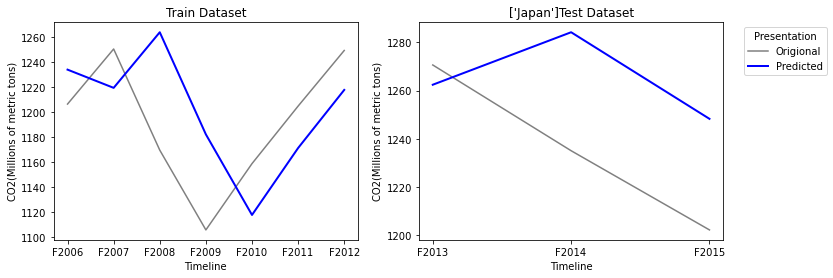

Origional Values:  [array([1270.62], dtype=object), array([1235.109], dtype=object), array([1202.308], dtype=object)]
Predicted Values:  [1262.44118542 1284.17881968 1248.31535888]
Explained Variance Score: 0.1114505122493693
        Maximam Error   : 49.06981967967249
    Mean Absolute Error : 34.41866438009932
    Mean Squared Error  : 1530.4724274217333
         r2 score       : -0.9667764099930518


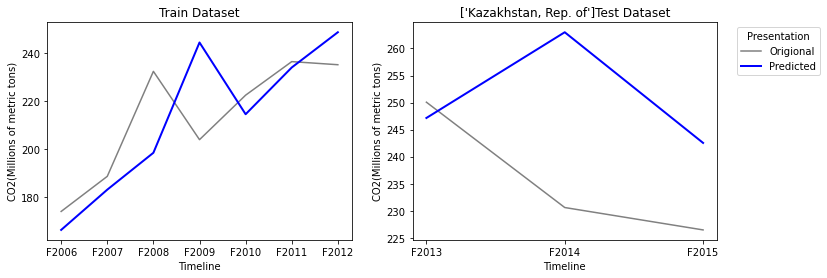

Origional Values:  [array([250.07], dtype=object), array([230.596], dtype=object), array([226.456], dtype=object)]
Predicted Values:  [247.15149121 263.00168042 242.54257094]
Explained Variance Score: -0.9657338524744523
        Maximam Error   : 32.405680415537404
    Mean Absolute Error : 17.136920049968314
    Mean Squared Error  : 439.14119382732883
         r2 score       : -3.1428532978508974


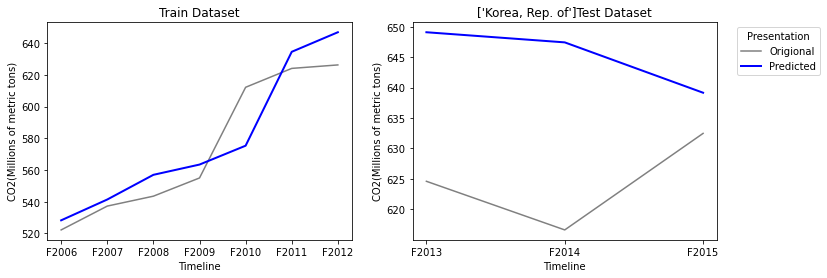

Origional Values:  [array([624.611], dtype=object), array([616.627], dtype=object), array([632.478], dtype=object)]
Predicted Values:  [649.08504474 647.42192308 639.15395088]
Explained Variance Score: -1.4899973052461997
        Maximam Error   : 30.794923076238206
    Mean Absolute Error : 20.64830623087937
    Mean Squared Error  : 530.6248244174203
         r2 score       : -11.671195606552144


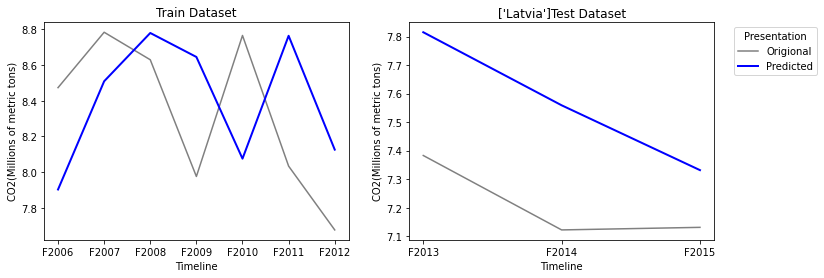

Origional Values:  [array([7.383], dtype=object), array([7.122], dtype=object), array([7.131], dtype=object)]
Predicted Values:  [7.81521983 7.5590592  7.3316513 ]
Explained Variance Score: 0.16832870468837546
        Maximam Error   : 0.43705920065160964
    Mean Absolute Error : 0.3566434417651472
    Mean Squared Error  : 0.1393652222896802
         r2 score       : -8.523385423649053


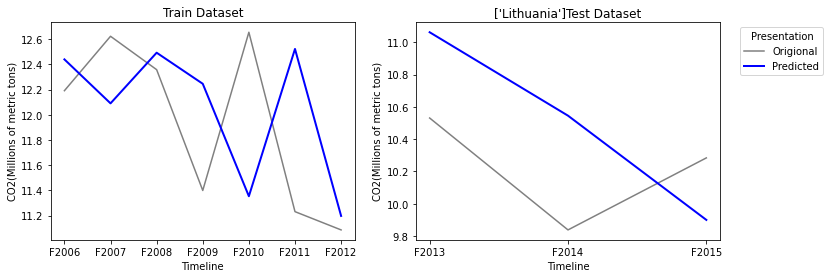

Origional Values:  [array([10.531], dtype=object), array([9.838], dtype=object), array([10.284], dtype=object)]
Predicted Values:  [11.06205879 10.54547569  9.89999841]
Explained Variance Score: -1.7828335921842453
        Maximam Error   : 0.7074756896407077
    Mean Absolute Error : 0.5408453554888103
    Mean Squared Error  : 0.31000083577842513
         r2 score       : -2.7693941181476434


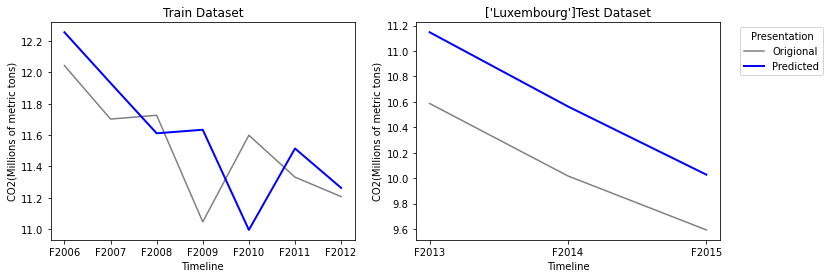

Origional Values:  [array([10.587], dtype=object), array([10.017], dtype=object), array([9.593], dtype=object)]
Predicted Values:  [11.14700019 10.56328896 10.02752719]
Explained Variance Score: 0.9809593781679855
        Maximam Error   : 0.5600001863363708
    Mean Absolute Error : 0.5136054426212583
    Mean Squared Error  : 0.2669485689897464
         r2 score       : -0.6095114937829391


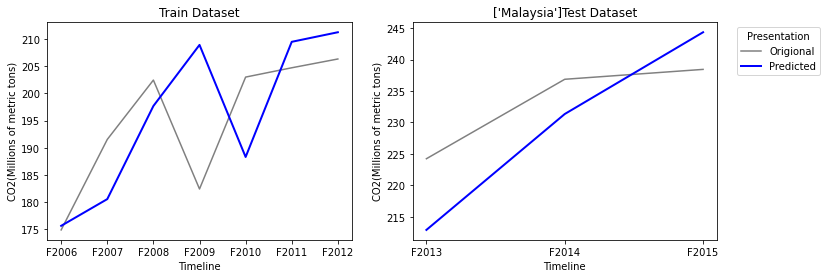

Origional Values:  [array([224.23], dtype=object), array([236.862], dtype=object), array([238.435], dtype=object)]
Predicted Values:  [212.91266679 231.3395463  244.33973295]
Explained Variance Score: -0.2664394532106906
        Maximam Error   : 11.317333213144195
    Mean Absolute Error : 7.581506622120126
    Mean Squared Error  : 64.4817990585779
         r2 score       : -0.5951024276571617


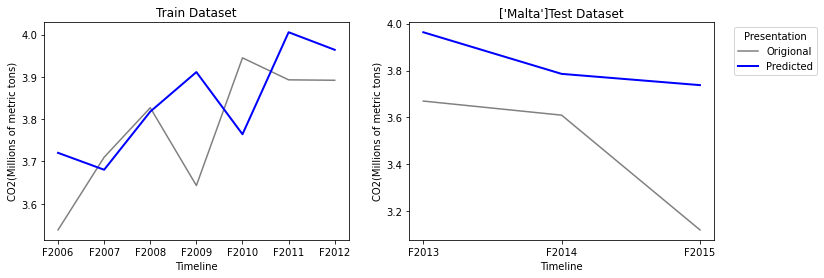

Origional Values:  [array([3.67], dtype=object), array([3.61], dtype=object), array([3.121], dtype=object)]
Predicted Values:  [3.96325708 3.78586884 3.73790874]
Explained Variance Score: 0.42467574301144284
        Maximam Error   : 0.616908741293626
    Mean Absolute Error : 0.3620115562427258
    Mean Squared Error  : 0.1658353207822944
         r2 score       : -1.7429839025818663


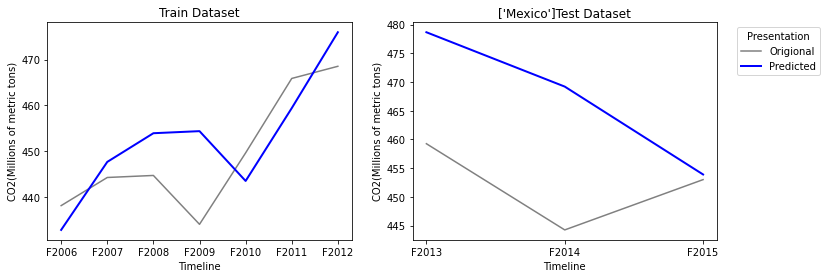

Origional Values:  [array([459.256], dtype=object), array([444.256], dtype=object), array([453.009], dtype=object)]
Predicted Values:  [478.65391843 469.19575539 453.90283251]
Explained Variance Score: -1.7927416316185885
        Maximam Error   : 24.93975539399929
    Mean Absolute Error : 15.077168779777537
    Mean Squared Error  : 333.02319170988795
         r2 score       : -7.798756948718191


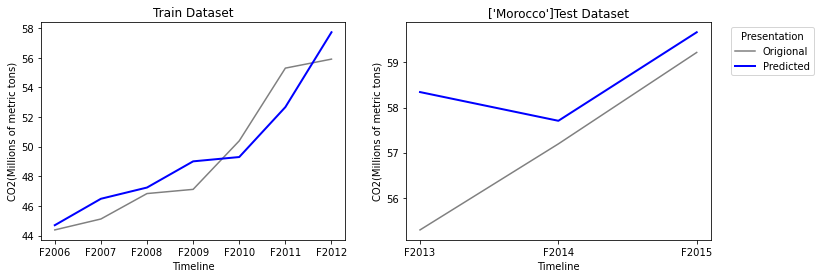

Origional Values:  [array([55.286], dtype=object), array([57.194], dtype=object), array([59.222], dtype=object)]
Predicted Values:  [58.34323884 57.7061659  59.66987377]
Explained Variance Score: 0.4282590170336281
        Maximam Error   : 3.057238840262542
    Mean Absolute Error : 1.3390928361886125
    Mean Squared Error  : 3.269871382592935
         r2 score       : -0.26601019298042705


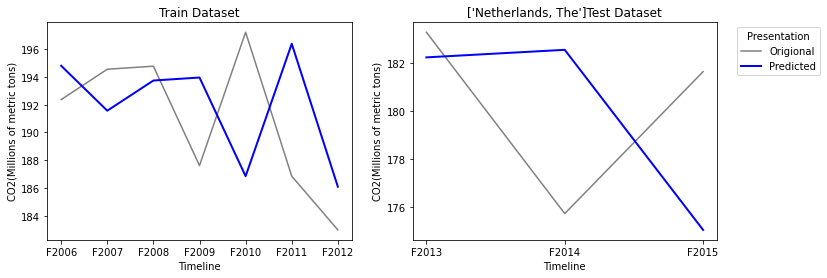

Origional Values:  [array([183.301], dtype=object), array([175.71], dtype=object), array([181.652], dtype=object)]
Predicted Values:  [182.24943599 182.56523639 175.02674311]
Explained Variance Score: -1.8782821453804157
        Maximam Error   : 6.8552363916759305
    Mean Absolute Error : 4.844019097057327
    Mean Squared Error  : 30.664693894852757
         r2 score       : -1.8853391468468899


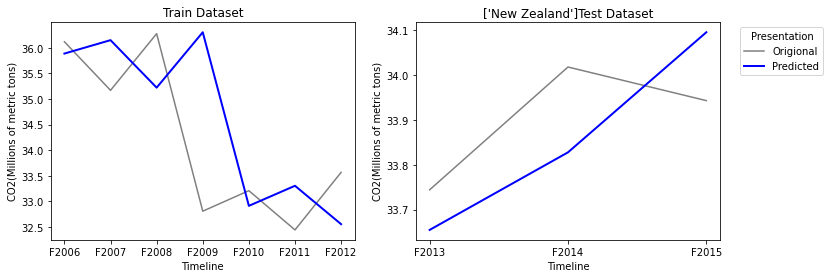

Origional Values:  [array([33.744], dtype=object), array([34.018], dtype=object), array([33.943], dtype=object)]
Predicted Values:  [33.65450559 33.8276075  34.09557316]
Explained Variance Score: -0.5494553125308614
        Maximam Error   : 0.19039250275898212
    Mean Absolute Error : 0.14415335477318555
    Mean Squared Error  : 0.02251237386672569
         r2 score       : -0.6841894964383881


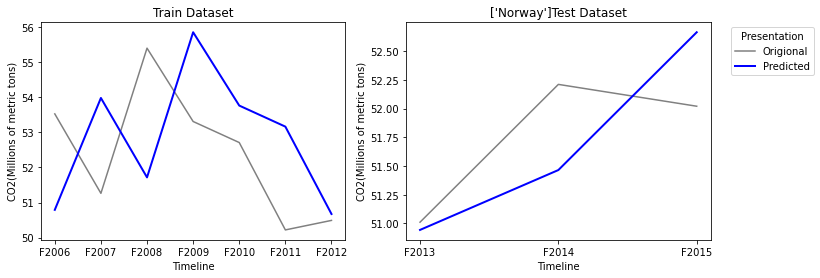

Origional Values:  [array([51.011], dtype=object), array([52.21], dtype=object), array([52.02], dtype=object)]
Predicted Values:  [50.94378268 51.46476354 52.6637195 ]
Explained Variance Score: -0.16155416493510777
        Maximam Error   : 0.745236459882193
    Mean Absolute Error : 0.48539109270767256
    Mean Squared Error  : 0.3247567799055184
         r2 score       : -0.17298022826622517


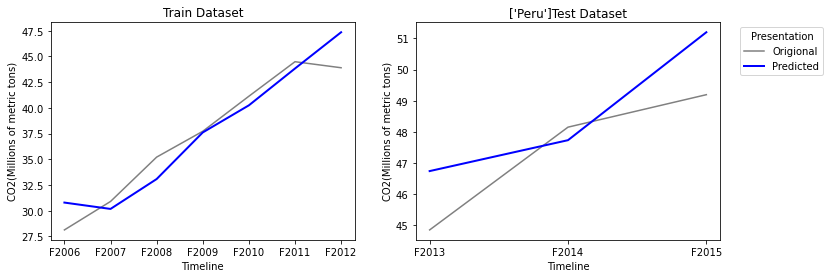

Origional Values:  [array([44.85], dtype=object), array([48.151], dtype=object), array([49.194], dtype=object)]
Predicted Values:  [46.73989804 47.73251155 51.19983134]
Explained Variance Score: 0.6363800690789846
        Maximam Error   : 2.0058313386496494
    Mean Absolute Error : 1.4380726090621916
    Mean Squared Error  : 2.590068844879793
         r2 score       : 0.24450554919038758


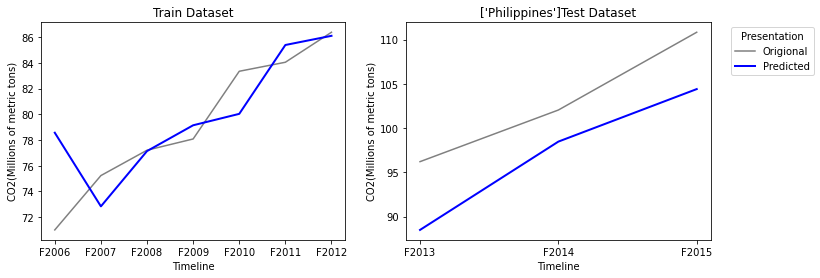

Origional Values:  [array([96.2], dtype=object), array([102.035], dtype=object), array([110.825], dtype=object)]
Predicted Values:  [ 88.48496921  98.46562912 104.4009278 ]
Explained Variance Score: 0.9169673187592176
        Maximam Error   : 7.715030788661892
    Mean Absolute Error : 5.902824621321244
    Mean Squared Error  : 37.84360404932416
         r2 score       : -0.04732593529625939


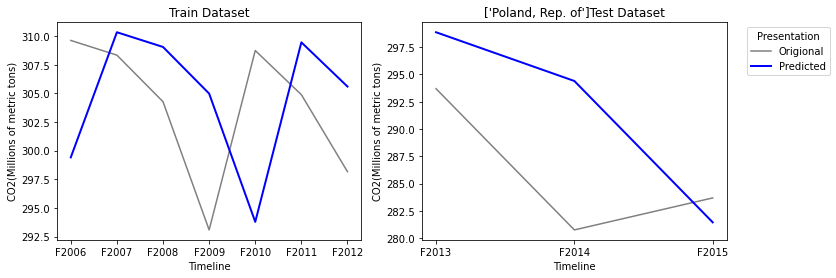

Origional Values:  [array([293.7], dtype=object), array([280.762], dtype=object), array([283.693], dtype=object)]
Predicted Values:  [298.86890044 294.40385428 281.45702166]
Explained Variance Score: -0.3715960642522713
        Maximam Error   : 13.64185428455039
    Mean Absolute Error : 7.01557768875053
    Mean Squared Error  : 72.60577307684775
         r2 score       : -1.3665278752957026


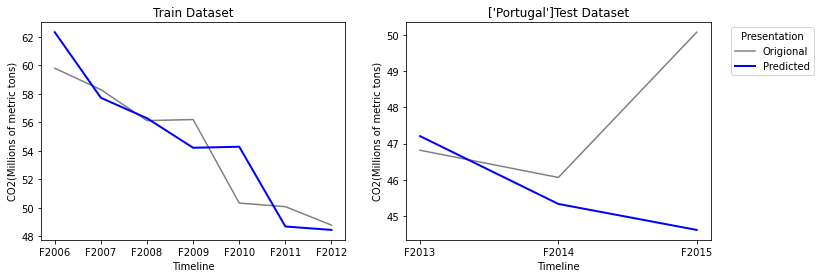

Origional Values:  [array([46.816], dtype=object), array([46.064], dtype=object), array([50.077], dtype=object)]
Predicted Values:  [47.20667728 45.33214862 44.61440649]
Explained Variance Score: -1.1206126421258595
        Maximam Error   : 5.462593511278875
    Mean Absolute Error : 2.1950407238087735
    Mean Squared Error  : 10.176054348934878
         r2 score       : -2.3542770334560115


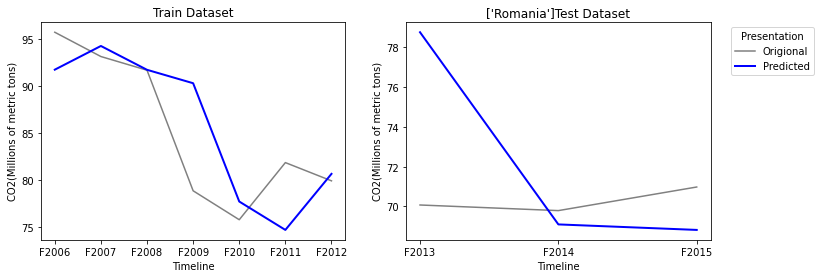

Origional Values:  [array([70.074], dtype=object), array([69.792], dtype=object), array([70.978], dtype=object)]
Predicted Values:  [78.75779547 69.09779138 68.8211185 ]
Explained Variance Score: -89.13302875913998
        Maximam Error   : 8.683795470890033
    Mean Absolute Error : 3.8449618644596533
    Mean Squared Error  : 26.847455734580777
         r2 score       : -103.90310645569281


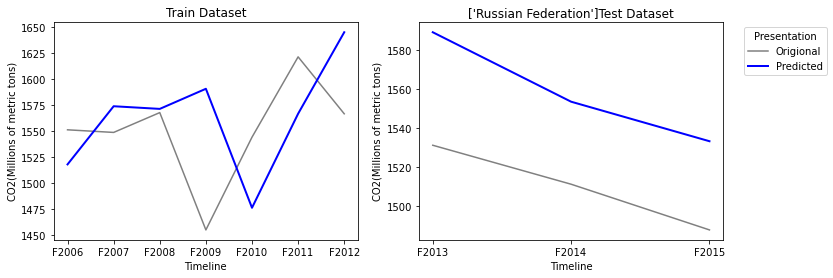

Origional Values:  [array([1531.207], dtype=object), array([1511.148], dtype=object), array([1487.625], dtype=object)]
Predicted Values:  [1589.37850092 1553.62500348 1533.27891124]
Explained Variance Score: 0.8553108091314257
        Maximam Error   : 58.171500924319844
    Mean Absolute Error : 48.76747187844186
    Mean Squared Error  : 2424.166318382715
         r2 score       : -6.641625820769253


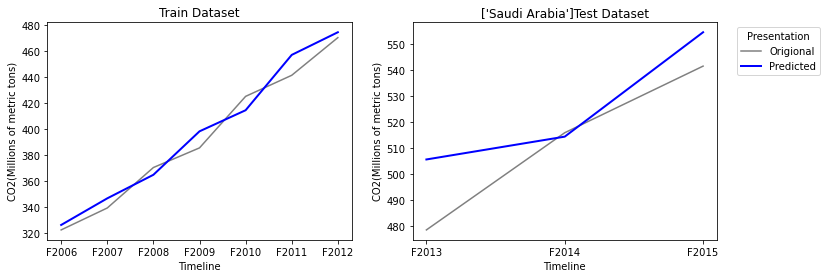

Origional Values:  [array([478.436], dtype=object), array([515.782], dtype=object), array([541.376], dtype=object)]
Predicted Values:  [505.50773637 514.27615634 554.39197307]
Explained Variance Score: 0.7961935026604271
        Maximam Error   : 27.07173637463262
    Mean Absolute Error : 13.864517702887781
    Mean Squared Error  : 301.52067683779586
         r2 score       : 0.5485631830274442


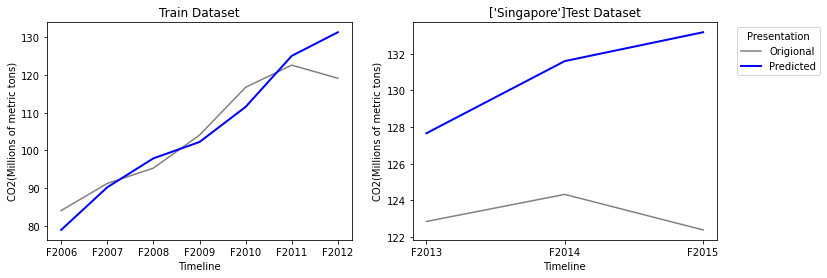

Origional Values:  [array([122.854], dtype=object), array([124.33], dtype=object), array([122.394], dtype=object)]
Predicted Values:  [127.66251437 131.59390867 133.16731919]
Explained Variance Score: -7.784853428096245
        Maximam Error   : 10.773319187526596
    Mean Absolute Error : 7.615247410219321
    Mean Squared Error  : 63.98352865460617
         r2 score       : -92.81333344163616


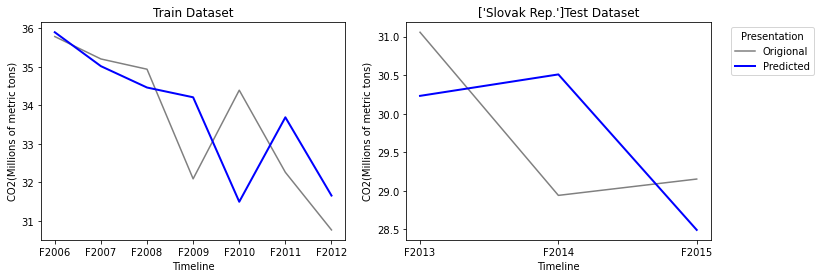

Origional Values:  [array([31.057], dtype=object), array([28.94], dtype=object), array([29.152], dtype=object)]
Predicted Values:  [30.23140936 30.50972802 28.49191774]
Explained Variance Score: -0.31650915192046525
        Maximam Error   : 1.5697280170695933
    Mean Absolute Error : 1.0184669747766861
    Mean Squared Error  : 1.193784850935373
         r2 score       : -0.31737545375472864


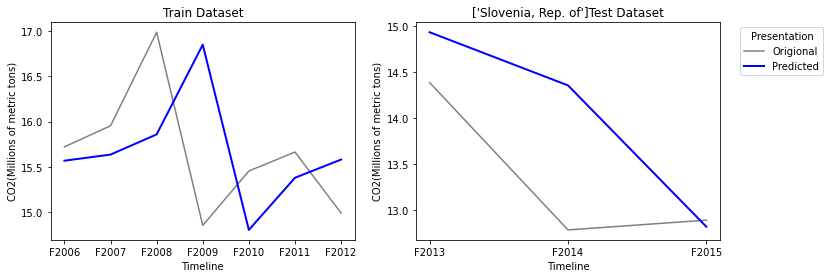

Origional Values:  [array([14.389], dtype=object), array([12.786], dtype=object), array([12.892], dtype=object)]
Predicted Values:  [14.9365645  14.35833494 12.82118403]
Explained Variance Score: 0.14296580842358542
        Maximam Error   : 1.5723349378500302
    Mean Absolute Error : 0.7302384698668375
    Mean Squared Error  : 0.9256929815927123
         r2 score       : -0.7278077756677024


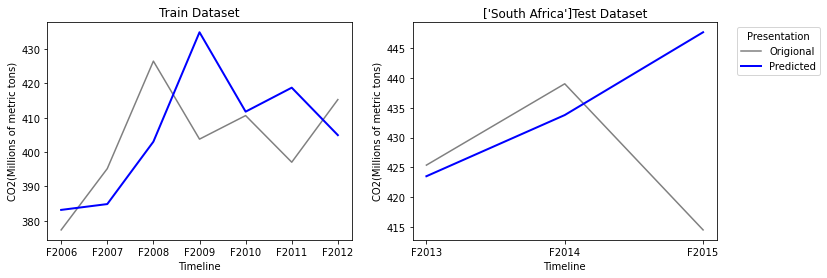

Origional Values:  [array([425.375], dtype=object), array([439.015], dtype=object), array([414.513], dtype=object)]
Predicted Values:  [423.51344293 433.77315114 447.65908286]
Explained Variance Score: -1.9971832483639038
        Maximam Error   : 33.146082860498495
    Mean Absolute Error : 13.416496265416393
    Mean Squared Error  : 376.53506108187617
         r2 score       : -2.747111967987271


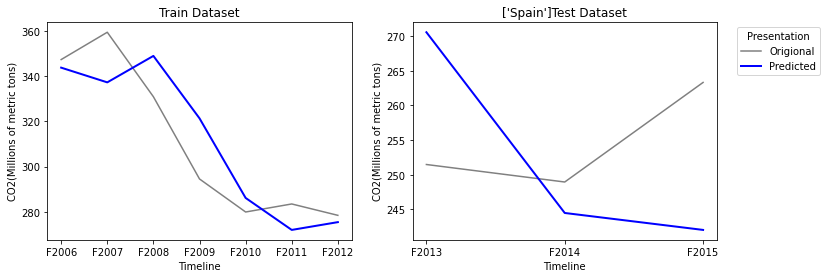

Origional Values:  [array([251.47], dtype=object), array([248.941], dtype=object), array([263.328], dtype=object)]
Predicted Values:  [270.57843753 244.46688619 242.01892825]
Explained Variance Score: -5.98635901159501
        Maximam Error   : 21.309071746319887
    Mean Absolute Error : 14.96387436283687
    Mean Squared Error  : 279.74220601837305
         r2 score       : -6.112215070102808


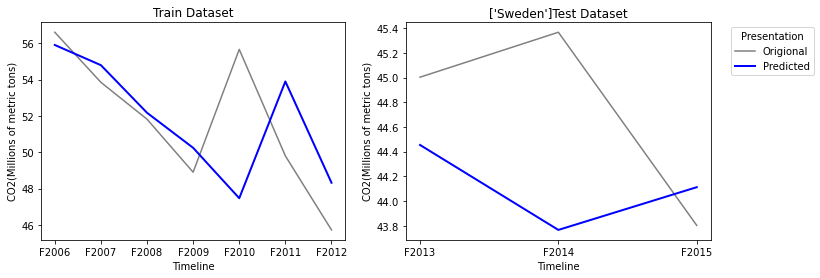

Origional Values:  [array([45.003], dtype=object), array([45.367], dtype=object), array([43.803], dtype=object)]
Predicted Values:  [44.45425229 43.76613809 44.11209606]
Explained Variance Score: -0.36634414782943026
        Maximam Error   : 1.6008619129699042
    Mean Absolute Error : 0.8195685601886803
    Mean Squared Error  : 0.9864744291753921
         r2 score       : -1.2092986455401586


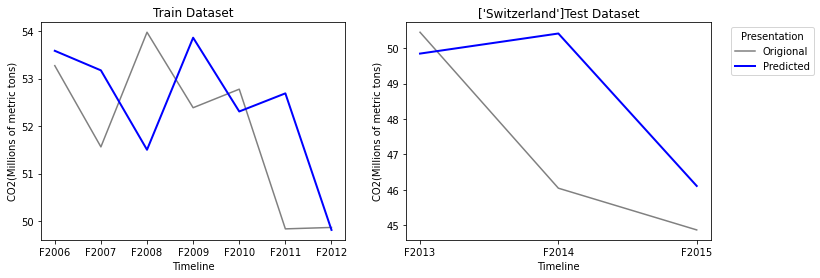

Origional Values:  [array([50.448], dtype=object), array([46.045], dtype=object), array([44.867], dtype=object)]
Predicted Values:  [49.84537896 50.41237631 46.10808439]
Explained Variance Score: 0.270558205292989
        Maximam Error   : 4.36737631015923
    Mean Absolute Error : 2.0703605790317234
    Mean Squared Error  : 6.992472804553052
         r2 score       : -0.2120618353370911


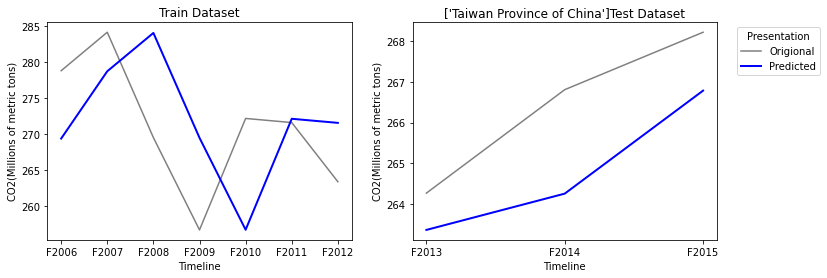

Origional Values:  [array([264.26], dtype=object), array([266.809], dtype=object), array([268.224], dtype=object)]
Predicted Values:  [263.35332303 264.24750827 266.78567996]
Explained Variance Score: 0.8231287042277498
        Maximam Error   : 2.5614917302979165
    Mean Absolute Error : 1.6354962477032966
    Mean Squared Error  : 3.150689186092945
         r2 score       : -0.17111857357969562


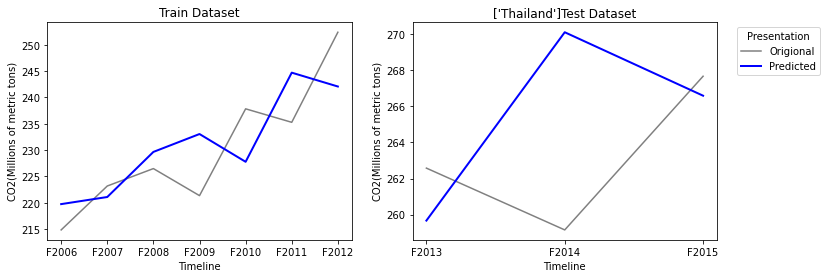

Origional Values:  [array([262.577], dtype=object), array([259.148], dtype=object), array([267.676], dtype=object)]
Predicted Values:  [259.66573746 270.11685787 266.59549677]
Explained Variance Score: -2.0881810215622565
        Maximam Error   : 10.968857867779548
    Mean Absolute Error : 4.986874547393995
    Mean Squared Error  : 43.31959325189627
         r2 score       : -2.5287836270276163


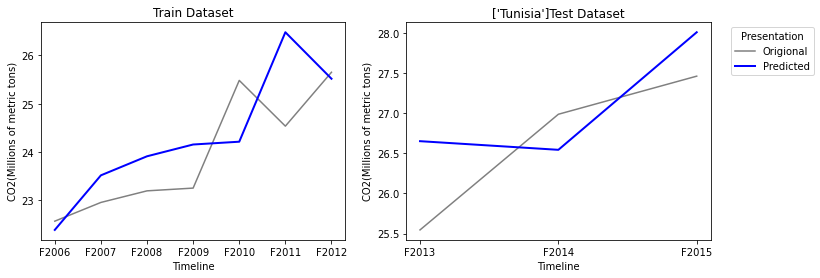

Origional Values:  [array([25.545], dtype=object), array([26.987], dtype=object), array([27.462], dtype=object)]
Predicted Values:  [26.65142063 26.54366459 28.0095533 ]
Explained Variance Score: 0.38193774368568645
        Maximam Error   : 1.1064206251921753
    Mean Absolute Error : 0.6991031106736662
    Mean Squared Error  : 0.5735091661510267
         r2 score       : 0.13684150490039193


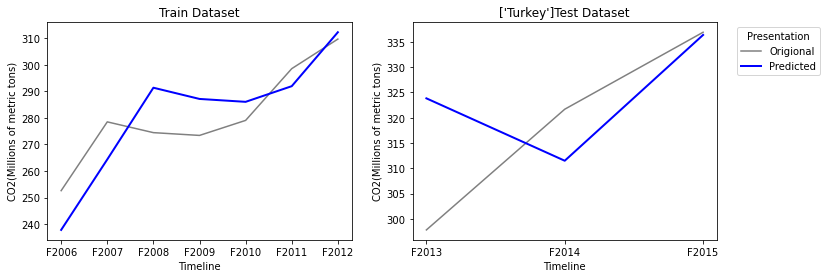

Origional Values:  [array([297.813], dtype=object), array([321.668], dtype=object), array([336.883], dtype=object)]
Predicted Values:  [323.81804935 311.4869143  336.35034313]
Explained Variance Score: 0.09464617710542522
        Maximam Error   : 26.00504934810158
    Mean Absolute Error : 12.239597303667475
    Mean Squared Error  : 260.06694029577534
         r2 score       : -0.005835918949881336


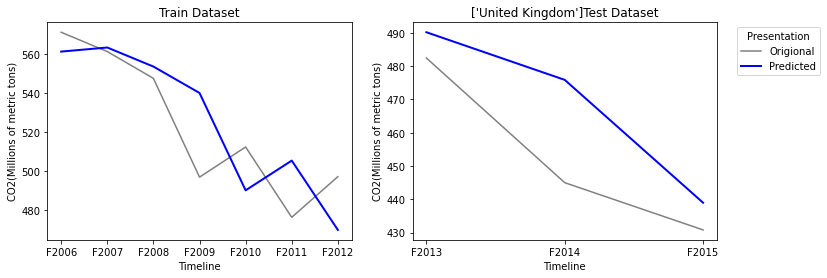

Origional Values:  [array([482.462], dtype=object), array([444.989], dtype=object), array([430.787], dtype=object)]
Predicted Values:  [490.21160275 475.89337991 438.96147157]
Explained Variance Score: 0.7537612790532463
        Maximam Error   : 30.904379909806778
    Mean Absolute Error : 15.609484742358367
    Mean Squared Error  : 360.65300859996455
         r2 score       : 0.24094857489601718


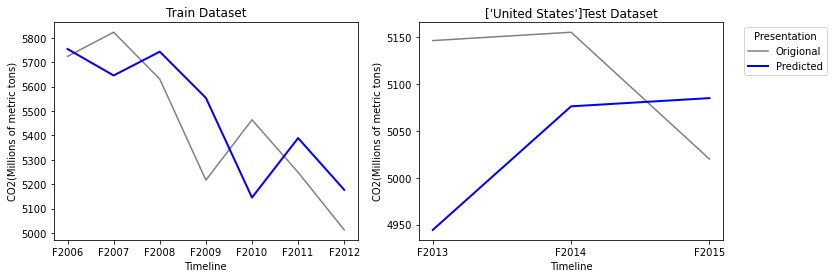

Origional Values:  [array([5146.637], dtype=object), array([5155.535], dtype=object), array([5020.004], dtype=object)]
Predicted Values:  [4944.30270442 5076.36681507 5085.14222566]
Explained Variance Score: -2.118448609285483
        Maximam Error   : 202.3342955784983
    Mean Absolute Error : 115.5469020558897
    Mean Squared Error  : 17149.919038090982
         r2 score       : -3.4760010855293473


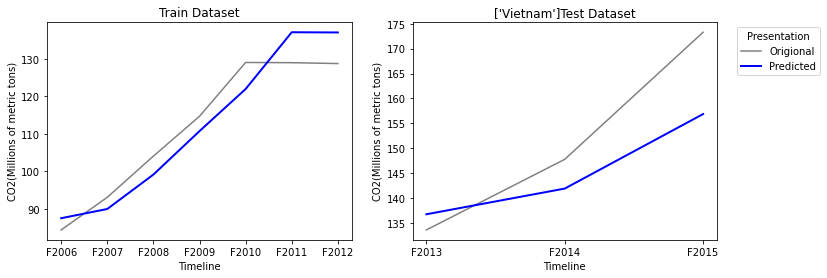

Origional Values:  [array([133.605], dtype=object), array([147.779], dtype=object), array([173.294], dtype=object)]
Predicted Values:  [136.74778032 141.90433883 156.86627542]
Explained Variance Score: 0.7628124332772477
        Maximam Error   : 16.427724576112126
    Mean Absolute Error : 8.481722023176795
    Mean Squared Error  : 104.75294892821252
         r2 score       : 0.6115680246240985


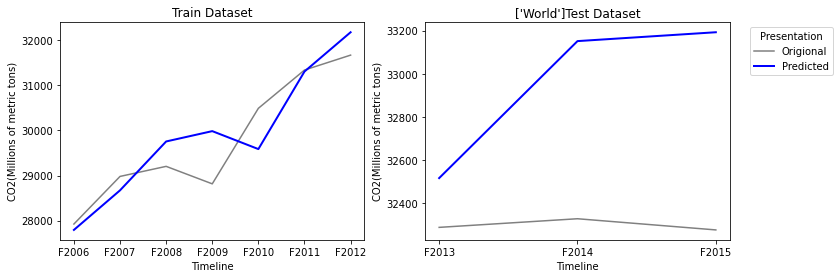

Origional Values:  [array([32287.8], dtype=object), array([32327.8], dtype=object), array([32276.0], dtype=object)]
Predicted Values:  [32516.17664955 33151.3054829  33192.37427264]
Explained Variance Score: -188.0666932979837
        Maximam Error   : 916.3742726448181
    Mean Absolute Error : 656.0854683666063
    Mean Squared Error  : 523352.9939992125
         r2 score       : -1064.0533062881032


In [56]:
i=0
VVIP3=list()
VVIP4=list()
while i<len(CO2_PROD_FINAL.T):
    series=CO2_PROD_FINAL[CO2_PROD_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    # Splitting the data into Train & Test
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=3,shuffle=False)
    # Fitting the model on Train dataset
    Model = MLPRegressor ()
    Model = Model.fit(X_train, y_train)
    # Predicting and storing results for Test dataset
    train_fit = Model.predict(X_train)
    test_pred = Model.predict(X_test)
    plt.figure(figsize=(12,4))
    # Plotting Regression line on Train Dataset
    plt.subplot(1,2,1)
    plt.plot(y_train, color='gray')
    plt.plot(y_train.index,train_fit, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title("Train Dataset")
    # Plotting Regression line on Test Dataset
    plt.subplot(1,2,2)
    plt.plot(y_test, color='gray')
    plt.plot(y_test.index,test_pred, color='blue', linewidth=2)
    plt.xlabel('Timeline')
    plt.ylabel('CO2(Millions of metric tons)')
    plt.title(str(X.columns.values)+"Test Dataset")
    plt.legend(['Origional','Predicted'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()
    pre=test_pred
    y_test=y_test
    y_test=np.array(y_test)
    VVIP3.append(pre)
    VVIP4.append(y_test)
    exp_rf=explained_variance_score(y_test,pre)
    mxer_rf=max_error(y_test,pre)
    mae_rf=mean_absolute_error(y_test,pre)
    mse_rf=mean_squared_error(y_test,pre)
    r2_rf=r2_score(y_test,pre)
    print("Origional Values: " , list(y_test))
    print("Predicted Values: " , pre)
    print("Explained Variance Score:",exp_rf)
    print("        Maximam Error   :",mxer_rf)
    print("    Mean Absolute Error :",mae_rf)
    print("    Mean Squared Error  :",mse_rf)
    print("         r2 score       :",r2_rf)
    i=i+1

# Combined

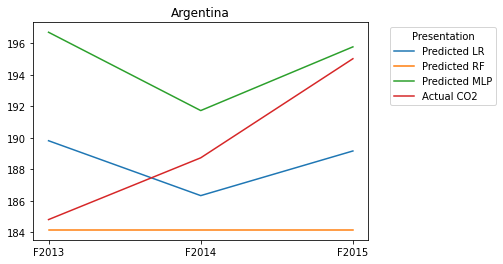

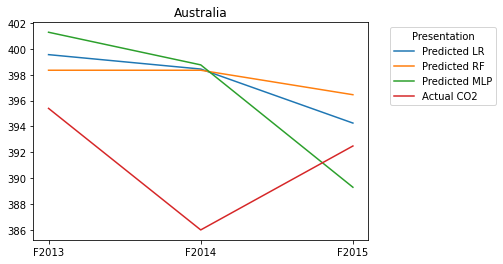

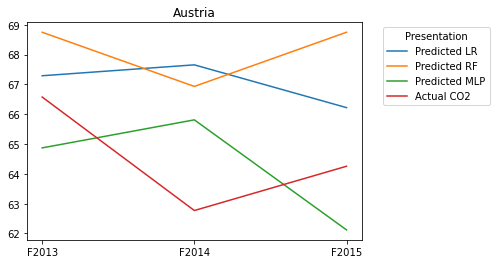

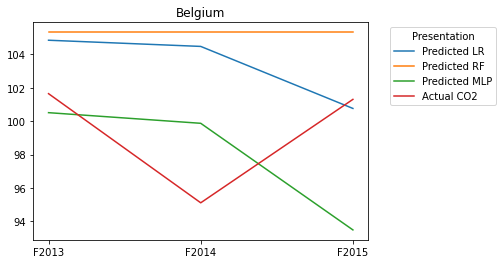

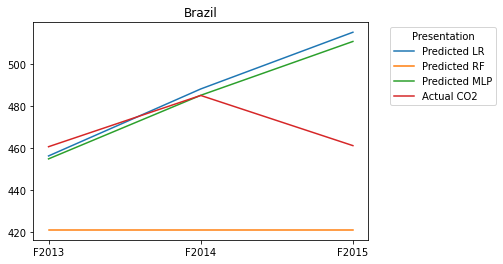

...

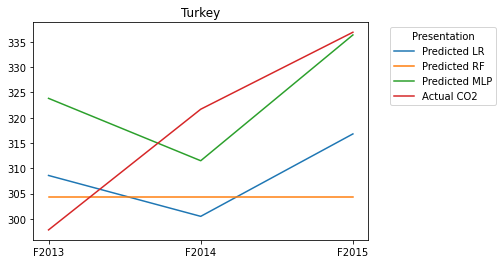

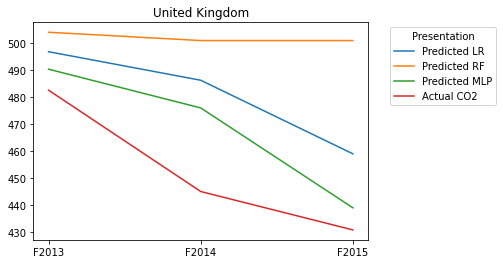

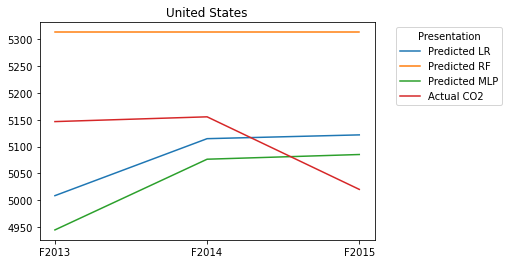

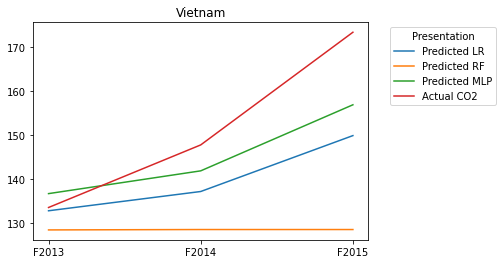

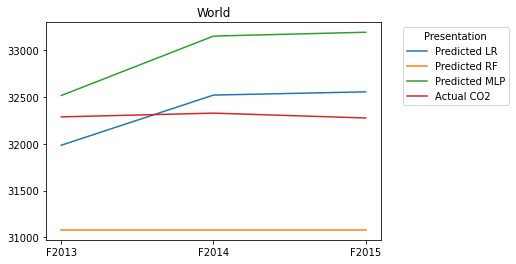

In [57]:
seeno=Y.index[-3:]
i=0
while i<len(VVIP1):
    plt.plot(seeno,VVIP1[i])
    plt.plot(seeno,VVIP2[i])
    plt.plot(seeno,VVIP3[i])
    plt.plot(seeno,VVIP4[i])
    plt.legend(['Predicted LR','Predicted RF','Predicted MLP'
               ,'Actual CO2'], title='Presentation',
            bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.title(str(CO2_PROD_FINAL.columns[i]))
    i=i+1
    plt.show()

# MLP and LR has better accurcies but MLP is slightly less error prone then LR

In [58]:
i=0
list_2016=list()
list_2017=list()
list_2018=list()
list_2019=list()
while i<len(CO2_PROD_FINAL.T):
    series=CO2_PROD_FINAL[CO2_PROD_FINAL.columns[i]]
    X = pd.DataFrame(series[:10])
    Y = pd.DataFrame(series[-10:])
    Model = MLPRegressor()
    Model = Model.fit(X, Y)
    train_fit = Model.predict(Y[-1:]) 
    list_2016.append(train_fit[0])
    train_fit=Model.predict(pd.DataFrame(train_fit)) 
    list_2017.append(train_fit[0])
    train_fit=Model.predict(pd.DataFrame(train_fit)) 
    list_2018.append(train_fit[0])
    train_fit=Model.predict(pd.DataFrame(train_fit)) 
    list_2019.append(train_fit[0])
    i=i+1

In [59]:
CO2_PROD['F2016']=list_2016
CO2_PROD['F2017']=list_2017
CO2_PROD['F2018']=list_2018
CO2_PROD['F2019']=list_2019

In [60]:
CO2_PROD.head()

,ObjectId,Country,ISO2,ISO3,Indicator,Code,Unit,F2005,F2006,F2007,...,F2010,F2011,F2012,F2013,F2014,F2015,F2016,F2017,F2018,F2019
5,6,Argentina,AR,ARG,C02 Emissions Embodied in Production,ECBPDTCEVA,Millions of metric tons,152.27,161.49,168.48,...,177.26,185.18,189.64,184.82,188.74,195.03,201.95,209.09,216.48,224.11
11,12,Australia,AU,AUS,C02 Emissions Embodied in Production,ECBPDTCEVA,Millions of metric tons,382.10,387.60,400.35,...,400.08,398.54,397.91,395.40,385.99,392.49,394.15,395.81,397.48,399.16
17,18,Austria,AT,AUT,C02 Emissions Embodied in Production,ECBPDTCEVA,Millions of metric tons,75.27,73.21,71.77,...,69.74,68.31,65.61,66.58,62.77,64.26,63.97,63.69,63.41,63.13
23,24,Belgium,BE,BEL,C02 Emissions Embodied in Production,ECBPDTCEVA,Millions of metric tons,118.87,118.00,114.79,...,114.63,103.33,102.29,101.64,95.11,101.30,99.92,98.56,97.25,95.96
29,30,Brazil,BR,BRA,C02 Emissions Embodied in Production,ECBPDTCEVA,Millions of metric tons,321.14,324.48,340.54,...,381.49,400.36,431.96,460.64,484.94,461.15,478.78,497.04,515.98,535.61


In [61]:
CO2_Grass_IMP.head()

,ObjectId,Country,ISO2,ISO3,Indicator,Code,Unit,F2005,F2006,F2007,...,F2010,F2011,F2012,F2013,F2014,F2015,F2016,F2017,F2018,F2019
4,5,Argentina,AR,ARG,C02 Emissions Embodied in Gross Imports,ECBPDTCETM,Millions of metric tons,28.14,32.24,37.97,...,40.14,47.78,44.06,47.05,41.76,42.24,43.46,44.70,45.97,47.26
22,23,Belgium,BE,BEL,C02 Emissions Embodied in Gross Imports,ECBPDTCETM,Millions of metric tons,87.83,92.67,99.73,...,89.81,99.17,90.75,88.39,87.94,86.55,86.68,86.82,86.96,87.09
76,77,Colombia,CO,COL,C02 Emissions Embodied in Gross Imports,ECBPDTCETM,Millions of metric tons,21.10,23.54,27.97,...,29.22,36.18,39.56,39.71,42.57,36.09,37.32,38.55,39.80,41.05
130,131,G20,None,G20,C02 Emissions Embodied in Gross Imports,ECBPDTCETM,Millions of metric tons,1484.69,1600.61,1629.40,...,1558.79,1708.00,1667.58,1643.66,1605.44,1469.53,1469.83,1470.12,1470.41,1470.70
172,173,Ireland,IE,IRL,C02 Emissions Embodied in Gross Imports,ECBPDTCETM,Millions of metric tons,41.17,45.02,48.96,...,38.46,34.98,34.71,36.59,39.88,40.46,40.54,40.62,40.69,40.77


In [62]:
CO2_Grass_Exp.head()

,ObjectId,Country,ISO2,ISO3,Indicator,Code,Unit,F2005,F2006,F2007,...,F2010,F2011,F2012,F2013,F2014,F2015,F2016,F2017,F2018,F2019
2,3,Argentina,AR,ARG,C02 Emissions Embodied in Gross Exports,ECBPDTCETX,Millions of metric tons,39.18,40.23,39.51,...,34.34,34.41,30.52,26.57,27.17,21.29,20.84,20.42,20.02,19.65
20,21,Belgium,BE,BEL,C02 Emissions Embodied in Gross Exports,ECBPDTCETX,Millions of metric tons,75.41,81.13,85.17,...,77.07,80.30,75.38,72.75,71.16,70.60,70.37,70.14,69.91,69.69
74,75,Colombia,CO,COL,C02 Emissions Embodied in Gross Exports,ECBPDTCETX,Millions of metric tons,13.85,13.68,13.77,...,14.60,16.40,16.99,19.19,21.54,21.50,22.42,23.34,24.25,25.15
128,129,G20,None,G20,C02 Emissions Embodied in Gross Exports,ECBPDTCETX,Millions of metric tons,1256.47,1426.53,1582.22,...,1690.87,1808.02,1871.12,1947.10,1882.40,1737.10,1791.39,1847.37,1905.08,1964.59
170,171,Ireland,IE,IRL,C02 Emissions Embodied in Gross Exports,ECBPDTCETX,Millions of metric tons,39.15,41.20,42.44,...,38.52,38.60,38.68,40.62,42.75,46.68,47.75,48.83,49.92,51.01


In [63]:
CO2_FINAL_DF.head()

,ObjectId,Country,ISO2,ISO3,Indicator,Code,Unit,F2005,F2006,F2007,...,F2010,F2011,F2012,F2013,F2014,F2015,F2016,F2017,F2018,F2019
1,2,Argentina,AR,ARG,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,141.18,153.44,166.89,...,183.06,198.55,203.19,205.33,203.33,216.03,225.07,234.45,244.17,254.25
7,8,Australia,AU,AUS,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,418.42,420.98,444.59,...,446.21,450.35,469.37,448.02,423.10,426.40,432.60,438.87,445.21,451.64
13,14,Austria,AT,AUT,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,95.26,95.39,94.53,...,89.74,90.34,86.19,86.53,82.95,83.44,82.90,82.36,81.84,81.31
19,20,Belgium,BE,BEL,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,131.71,129.89,129.69,...,127.70,122.48,117.93,117.66,112.33,117.83,116.80,115.79,114.79,113.81
25,26,Brazil,BR,BRA,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,312.82,330.87,363.68,...,458.99,486.29,510.59,542.57,555.96,475.38,492.11,509.40,527.29,545.78


In [64]:
Combined4Cases=pd.concat([CO2_FINAL_DF,CO2_Grass_Exp,CO2_Grass_IMP,CO2_PROD])

In [65]:
Combined4Cases.to_csv("Fully_Populated_Dataset_CO2.csv")

In [66]:
Combined4Cases

,ObjectId,Country,ISO2,ISO3,Indicator,Code,Unit,F2005,F2006,F2007,...,F2010,F2011,F2012,F2013,F2014,F2015,F2016,F2017,F2018,F2019
1,2,Argentina,AR,ARG,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,141.18,153.44,166.89,...,183.06,198.55,203.19,205.33,203.33,216.03,225.07,234.45,244.17,254.25
7,8,Australia,AU,AUS,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,418.42,420.98,444.59,...,446.21,450.35,469.37,448.02,423.10,426.40,432.60,438.87,445.21,451.64
13,14,Austria,AT,AUT,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,95.26,95.39,94.53,...,89.74,90.34,86.19,86.53,82.95,83.44,82.90,82.36,81.84,81.31
19,20,Belgium,BE,BEL,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,131.71,129.89,129.69,...,127.70,122.48,117.93,117.66,112.33,117.83,116.80,115.79,114.79,113.81
25,26,Brazil,BR,BRA,C02 Emissions Embodied in Final Domestic Demand,ECBPDTCEFDD,Millions of metric tons,312.82,330.87,363.68,...,458.99,486.29,510.59,542.57,555.96,475.38,492.11,509.40,527.29,545.78
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
371,372,Turkey,TR,TUR,C02 Emissions Embodied in Production,ECBPDTCEVA,Millions of metric tons,227.13,252.59,278.48,...,279.04,298.52,309.64,297.81,321.67,336.88,351.84,367.41,383.63,400.53
377,378,United Kingdom,GB,GBR,C02 Emissions Embodied in Production,ECBPDTCEVA,Millions of metric tons,569.09,571.22,561.28,...,512.23,476.07,496.99,482.46,444.99,430.79,419.84,409.20,398.84,388.77
383,384,United States,US,USA,C02 Emissions Embodied in Production,ECBPDTCEVA,Millions of metric tons,5833.58,5723.61,5822.52,...,5463.63,5248.63,5012.73,5146.64,5155.53,5020.00,4989.98,4960.14,4930.48,4901.01
389,390,Vietnam,VN,VNM,C02 Emissions Embodied in Production,ECBPDTCEVA,Millions of metric tons,82.13,84.46,93.13,...,129.01,128.95,128.72,133.60,147.78,173.29,190.72,209.84,230.82,253.85


# Major Exporters and importersof CO2

In [67]:
Major_Exp=CO2_Grass_Exp.sort_values("F2019",ascending =False)

In [68]:
Major_IMP=CO2_Grass_IMP.sort_values("F2019",ascending =False)

In [69]:
See=Major_IMP[['Country','F2019']]
See.columns=['Country','IMPORTS']
See.index=See['Country']
See1=Major_Exp[['Country','F2019']]
See1.columns=['Country','Exports']
See1.index=See1['Country']
See['Exports']=See1['Exports']

In [70]:
See

,Country,IMPORTS,Exports
Country,,,
United States,United States,1973.55,585.82
G20,G20,1470.70,1964.59
"China, P.R.: Mainland","China, P.R.: Mainland",676.24,2212.07
Germany,Germany,490.40,324.40
France,France,411.94,155.99
...,...,...,...
Brunei Darussalam,Brunei Darussalam,3.51,3.07
Malta,Malta,3.16,2.54
Iceland,Iceland,2.52,3.91


In [71]:
Case10=See.head(10)
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10.Exports,
    name="Exports"       # this sets its legend entry
))


fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10.IMPORTS,
    name="Imports"
))

fig.update_layout(
    title="Top 10 Importers",
    xaxis_title="Countries",
    yaxis_title="CO2(Millions of metric tons)",
    legend_title="Type",
    font=dict(
        family="Courier New, monospace",
        size=12,
        color="RebeccaPurple"
    )
)

In [72]:
Case10=See.tail(10)
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10.Exports,
    name="Exports"       # this sets its legend entry
))


fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10.IMPORTS,
    name="Imports"
))

fig.update_layout(
    title="Least 10 Importers",
    xaxis_title="Countries",
    yaxis_title="CO2(Millions of metric tons)",
    legend_title="Type",
    font=dict(
        family="Courier New, monospace",
        size=12,
        color="RebeccaPurple"
    )
)

In [73]:
See=See.sort_values("Exports")
Case10=See.tail(10)
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10.Exports,
    name="Exports"       # this sets its legend entry
))


fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10.IMPORTS,
    name="Imports"
))

fig.update_layout(
    title="Top 10 Exporters",
    xaxis_title="Countries",
    yaxis_title="CO2(Millions of metric tons)",
    legend_title="Type",
    font=dict(
        family="Courier New, monospace",
        size=12,
        color="RebeccaPurple"
    )
)

In [74]:
See=See.sort_values("Exports")
Case10=See.head(10)
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10.Exports,
    name="Exports"       # this sets its legend entry
))


fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10.IMPORTS,
    name="Imports"
))

fig.update_layout(
    title="Least 10 Exporters",
    xaxis_title="Countries",
    yaxis_title="CO2(Millions of metric tons)",
    legend_title="Type",
    font=dict(
        family="Courier New, monospace",
        size=12,
        color="RebeccaPurple"
    )
)

## C02 Emissions Embodied in Final Domestic Demand relations with Exports/imports
## C02 Emissions Embodied in Production relations with Exports/imports

In [75]:
See1=CO2_FINAL_DF[['Country','F2019']]
See1.columns=['Country','C02 Emissions Embodied in Final Domestic Demand']
See1.index=See1['Country']
See['C02 Emissions Embodied in Final Domestic Demand']=See1['C02 Emissions Embodied in Final Domestic Demand']

In [76]:
See1=CO2_PROD[['Country','F2019']]
See1.columns=['Country','C02 Emissions Embodied in Production']
See1.index=See1['Country']
See['C02 Emissions Embodied in Production']=See1['C02 Emissions Embodied in Production']

In [77]:
See

,Country,IMPORTS,Exports,C02 Emissions Embodied in Final Domestic Demand,C02 Emissions Embodied in Production
Country,,,,,
World,World,0.00,0.03,35604.86,35888.74
Malta,Malta,3.16,2.54,2.90,3.30
Brunei Darussalam,Brunei Darussalam,3.51,3.07,7.21,7.41
Costa Rica,Costa Rica,8.89,3.70,15.64,8.72
Iceland,Iceland,2.52,3.91,2.69,4.10
...,...,...,...,...,...
Russian Federation,Russian Federation,174.05,395.08,1240.29,1556.81
India,India,-447.79,455.37,2494.62,2662.76
United States,United States,1973.55,585.82,5537.58,4901.01


In [78]:
See['C02 Emissions Embodied in Final Domestic Demand']

Country
World                   35604.86
Malta                       2.90
Brunei Darussalam           7.21
Costa Rica                 15.64
Iceland                     2.69
                          ...   
Russian Federation       1240.29
India                    2494.62
United States            5537.58
G20                     29266.84
China, P.R.: Mainland   10159.84
Name: C02 Emissions Embodied in Final Domestic Demand, Length: 66, dtype: float64

In [79]:
See=See.sort_values("Exports")
Case10=See.tail(10)
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10.Exports,
    name="Exports"       # this sets its legend entry
))


fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10['C02 Emissions Embodied in Production'],
    name="C02 Emissions Embodied in Production"
))

fig.update_layout(
    title="Top 10 Exporters and C02 Emissions Embodied in Production",
    xaxis_title="Countries",
    yaxis_title="CO2(Millions of metric tons)",
    legend_title="Type",
    font=dict(
        family="Courier New, monospace",
        size=12,
        color="RebeccaPurple"
    )
)

In [80]:
See=See.sort_values("Exports")
Case10=See.tail(10)
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10.Exports,
    name="Exports"       # this sets its legend entry
))


fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10['C02 Emissions Embodied in Final Domestic Demand'],
    name="C02 Emissions Embodied in Final Domestic Demand"
))

fig.update_layout(
    title="Top 10 Exporters and C02 Emissions Embodied in Final Domestic Demand",
    xaxis_title="Countries",
    yaxis_title="CO2(Millions of metric tons)",
    legend_title="Type",
    font=dict(
        family="Courier New, monospace",
        size=12,
        color="RebeccaPurple"
    )
)

In [81]:
See=See.sort_values("C02 Emissions Embodied in Final Domestic Demand")
Case10=See.tail(10)
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10.IMPORTS,
    name="IMPORTS"       # this sets its legend entry
))


fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10['C02 Emissions Embodied in Final Domestic Demand'],
    name="C02 Emissions Embodied in Final Domestic Demand"
))

fig.update_layout(
    title="Top Countires with High C02 Emissions Embodied in Final Domestic Demand",
    xaxis_title="Countries",
    yaxis_title="CO2(Millions of metric tons)",
    legend_title="Type",
    font=dict(
        family="Courier New, monospace",
        size=12,
        color="RebeccaPurple"
    )
)

In [82]:
See=See.sort_values("C02 Emissions Embodied in Production")
Case10=See.tail(10)
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10.IMPORTS,
    name="IMPORTS"       # this sets its legend entry
))


fig.add_trace(go.Scatter(
    x=Case10.index,
    y=Case10['C02 Emissions Embodied in Production'],
    name="C02 Emissions Embodied in Production"
))

fig.update_layout(
    title="Top Countires with High C02 Emissions Embodied in Production",
    xaxis_title="Countries",
    yaxis_title="CO2(Millions of metric tons)",
    legend_title="Type",
    font=dict(
        family="Courier New, monospace",
        size=12,
        color="RebeccaPurple"
    )
)